# Training Monitoring and Instructions

This notebook is for monitoring and visualising the training and testing performance of the GRACE model during various paramater adjusted training runs. 
This notebook does the following:

- Adjust hyperparameters for training 
- Save the training commands (with the hyperparams you set) to an executabe shell script
- Loads the training performance metrics and visualises them!


<br>
<br>


### To run your own training:

<b>Prep:</b>
1. You'll need the correct conda envrionment. Set it up using the environmen.yml file in this repo
2. Download this repo (in full)
3. Prepare training data (see other notebooks)
4. Prepare the training parameters here in this notebook so that you have a ```commands.sh``` with all the command prepared

<b>Run Training:</b>
1. Open git bash 
2. cd to the GRACE folder of this repo, e.g. ```cd "C:\Users\chris\Documents\PLUS SharePoint\Universität Salzburg\AG_Geosocial Analytics Lab - MA - Christina Zorenböhmer\1 - Code\ABEA Repo\GRACE"```
3. Activate your conda env for the training e.g. ```conda activate grace_abea_training```
4. Make the script for training executable. Run ```chmod +x commands.sh```
5. Run the script for training. Run ```./commands.sh```


<br>
<br>


### To visualise the training performance after training:

1. Create a new code cell at the bottom of this notebook, and use the code below to create a chart (you just need to change the "name" variable to the "name" parameter that was set in the hyperparameters (that's how the function checks the performance resulst).
<br>

```python
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'original_valid=test'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)
```

### Setup

In [1]:
import json
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.patches import Patch

## Training

### Set Training Hyperparameters

##### Previous Hyperparameter settings

In [ ]:
# ['orig_data_w_none', 'orig_data_wo_none']
name =                      ['orig_absa']
classification_head =       ["1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none', 'abea_wo_none']

batch_size_1 =              [32, 32]
batch_size_2 =              [32, 32]
batch_size_3 =              [32, 32]

epochs_1 =                  [5, 5]
epochs_2 =                  [3, 3]
epochs_3 =                  [10, 10]

lr_1 =                      [3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6]

decoder_shared_layer =      [9, 9]
num_decoder_layer =         [2, 2]

warmup_method =             ['linear', 'linear']
warmup_proportion=          [0.1, 0.1]

gradient_accumulation =     [2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat']                      # if NOT using vat: write empty string like ''


This is the first run, done with all orginal settings on the two available datasets: one with the 'none' class, and one without it. The one without the none class has also been double-checked entirely by me.

In [2]:
name =                      ['ABEA_with_0.2_Dropout_in_BERT']
classification_head =       ["1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [32]
batch_size_2 =              [32]
batch_size_3 =              [32]

epochs_1 =                  [5]
epochs_2 =                  [3]
epochs_3 =                  [10]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [9]
num_decoder_layer =         [2]

warmup_method =             ['linear']
warmup_proportion=          [0.1]

gradient_accumulation =     [2]                                # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat']                      # if NOT using vat: write empty string like ''


In [62]:
# nouns w none
name =                      ['dense4minConcat_SiLU']
classification_head =       ["dense4minConcat_SiLU"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [5]
num_decoder_layer =         [6]

warmup_method =             ['constant']
warmup_proportion=          [0.1]

gradient_accumulation =     [2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       [' ']                      # if NOT using vat: write empty string like ''


In [141]:
# ['batch_decrease1', 'batch_decrease2', 'batch_increase']
name =                      ['batch_decrease1', 'batch_decrease2', 'batch_increase']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['nouns_w_none', 'nouns_w_none', 'nouns_w_none']

batch_size_1 =              [8, 16, 64]
batch_size_2 =              [8, 16, 64]
batch_size_3 =              [8, 16, 64]

epochs_1 =                  [5, 5, 5]
epochs_2 =                  [3, 3, 3]
epochs_3 =                  [10, 10, 10]

lr_1 =                      [3e-5, 3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6, 3e-6]

decoder_shared_layer =      [9, 9, 9]
num_decoder_layer =         [2, 2, 2]

warmup_method =             ['linear', 'linear', 'linear']
warmup_proportion=          [0.1, 0.1, 0.1]

gradient_accumulation =     [2, 2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat']                      # if NOT using vat: write empty string like ''


In [ ]:
# ['epoch_increase1', 'epoch_increase2', 'epoch_incrase3']
name =                      ['epoch_increase1', 'epoch_increase2', 'epoch_incrase3']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['nouns_w_none', 'nouns_w_none', 'nouns_w_none']

batch_size_1 =              [16, 16, 16]
batch_size_2 =              [16, 16, 16]
batch_size_3 =              [16, 16, 16]

epochs_1 =                  [10, 15, 10]
epochs_2 =                  [6, 9, 9]
epochs_3 =                  [20, 30, 25]

lr_1 =                      [3e-5, 3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6, 3e-6]

decoder_shared_layer =      [9, 9, 9]
num_decoder_layer =         [2, 2, 2]

warmup_method =             ['linear', 'linear', 'linear']
warmup_proportion=          [0.1, 0.1, 0.1]

gradient_accumulation =     [2, 2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat']                      # if NOT using vat: write empty string like ''


In [26]:
# ['epoch_increase1_8btch', 'epoch_increase2_8btch', 'epoch_incrase3_8btch']
name =                      ['epoch_increase1_8btch', 'epoch_increase2_8btch', 'epoch_incrase3_8btch']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['nouns_w_none', 'nouns_w_none', 'nouns_w_none']

batch_size_1 =              [8, 8, 8]
batch_size_2 =              [8, 8, 8]
batch_size_3 =              [8, 8, 8]

epochs_1 =                  [10, 15, 10]
epochs_2 =                  [6, 9, 9]
epochs_3 =                  [20, 30, 25]

lr_1 =                      [3e-5, 3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6, 3e-6]

decoder_shared_layer =      [9, 9, 9]
num_decoder_layer =         [2, 2, 2]

warmup_method =             ['linear', 'linear', 'linear']
warmup_proportion=          [0.1, 0.1, 0.1]

gradient_accumulation =     [2, 2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat']                      # if NOT using vat: write empty string like ''


In [3]:
# ['epoch_increase3']
name =                      ['epoch_increase3']
classification_head =       ["1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['nouns_w_none']

batch_size_1 =              [16]
batch_size_2 =              [16]
batch_size_3 =              [16]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [9]
num_decoder_layer =         [2]

warmup_method =             ['linear']
warmup_proportion=          [0.1]

gradient_accumulation =     [2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat']                      # if NOT using vat: write empty string like ''


In [98]:
# ['cosine_warmup']  --> CHANGE CODE
name =                      ['cosine_warmup']
classification_head =       ["1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [9]
num_decoder_layer =         [2]

warmup_method =             ['cosine']
warmup_proportion=          [0.1]

gradient_accumulation =     [2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat']                      # if NOT using vat: write empty string like ''


In [10]:
# ['constant_warmup']  --> CHANGE CODE
name =                      ['constant_warmup']
classification_head =       ["1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [9]
num_decoder_layer =         [2]

warmup_method =             ['constant']
warmup_proportion=          [0.1]

gradient_accumulation =     [2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat']                      # if NOT using vat: write empty string like ''


In [15]:
# ['lower_WUP', 'higher_WUP1', 'higher_WUP2']
name =                      ['lower_WUP', 'higher_WUP1', 'higher_WUP2']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8, 8]
batch_size_2 =              [8, 8, 8]
batch_size_3 =              [8, 8, 8]

epochs_1 =                  [10, 10, 10]
epochs_2 =                  [9, 9, 9]
epochs_3 =                  [25, 25, 25]

lr_1 =                      [3e-5, 3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6, 3e-6]

decoder_shared_layer =      [9, 9, 9]
num_decoder_layer =         [2, 2, 2]

warmup_method =             ['constant', 'constant', 'constant']
warmup_proportion=          [0.05, 0.2, 0.15]

gradient_accumulation =     [2, 2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat']                      # if NOT using vat: write empty string like ''


In [34]:
# ['ts1_inc_lr1', 'ts1_inc_lr2', 'ts1_low_lr']
name =                      ['ts1_inc_lr1', 'ts1_inc_lr2', 'ts1_low_lr']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8, 8]
batch_size_2 =              [8, 8, 8]
batch_size_3 =              [8, 8, 8]

epochs_1 =                  [10, 10, 10]
epochs_2 =                  [9, 9, 9]
epochs_3 =                  [25, 25, 25]

warmup_method =             ['constant', 'constant', 'constant']
warmup_proportion=          [0.1, 0.1, 0.1]

lr_1 =                      [4e-5, 5e-5, 2.5e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6, 3e-6]

decoder_shared_layer =      [9, 9, 9]
num_decoder_layer =         [2, 2, 2]


gradient_accumulation =     [2, 2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat']                      # if NOT using vat: write empty string like ''


In [1]:
# ['ts2_inc_lr1', 'ts2_inc_lr2', 'ts2_low_lr']
name =                      ['ts3_inc_lr1', 'ts3_inc_lr2', 'ts3_low_lr']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8, 8]
batch_size_2 =              [8, 8, 8]
batch_size_3 =              [8, 8, 8]

epochs_1 =                  [10, 10, 10]
epochs_2 =                  [9, 9, 9]
epochs_3 =                  [25, 25, 25]

warmup_method =             ['constant', 'constant', 'constant']
warmup_proportion=          [0.1, 0.1, 0.1]

lr_1 =                      [3e-5, 3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5]
lr_3 =                      [4e-6, 5e-6, 2e-6]

decoder_shared_layer =      [9, 9, 9]
num_decoder_layer =         [2, 2, 2]


gradient_accumulation =     [2, 2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat']                      # if NOT using vat: write empty string like ''


In [21]:
# ['less_sh_lay1', 'less_sh_lay2', 'more_sh_lay']
name =                      ['less_sh_lay1', 'less_sh_lay2', 'more_sh_lay']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8, 8]
batch_size_2 =              [8, 8, 8]
batch_size_3 =              [8, 8, 8]

epochs_1 =                  [10, 10, 10]
epochs_2 =                  [9, 9, 9]
epochs_3 =                  [25, 25, 25]

warmup_method =             ['constant', 'constant', 'constant']
warmup_proportion=          [0.1, 0.1, 0.1]

lr_1 =                      [3e-5, 3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6, 3e-6]

decoder_shared_layer =      [7, 5, 11]
num_decoder_layer =         [2, 2, 2]


gradient_accumulation =     [2, 2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat']                      # if NOT using vat: write empty string like ''


In [54]:
# ['more_decoder1', 'more_decoder2']
name =                      ['more_decoder1', 'more_decoder2', 'more_decoder1_less_sh', 'more_decoder2_less_sh']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean', 'abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8, 8, 8]
batch_size_2 =              [8, 8, 8, 8]
batch_size_3 =              [8, 8, 8, 8]

epochs_1 =                  [10, 10, 10, 10]
epochs_2 =                  [9, 9, 9, 9]
epochs_3 =                  [25, 25, 25, 25]

warmup_method =             ['constant', 'constant', 'constant', 'constant']
warmup_proportion=          [0.1, 0.1, 0.1, 0.1]

lr_1 =                      [3e-5, 3e-5, 3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6, 3e-6, 3e-6]

decoder_shared_layer =      [9, 9, 5, 5]
num_decoder_layer =         [4, 6, 4, 6]


gradient_accumulation =     [2, 2, 2, 2]                                          # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl', '--use_ghl', '--use_ghl']              # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat', '--use_vat']              # if NOT using vat: write empty string like ''


In [3]:
# ['no_ghl', 'ghl_in2and3', 'ghl_in3']
name =                      ['no_ghl', 'ghl_in2and3', 'ghl_in3']
classification_head =       ["1x linear layer", "1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8, 8]
batch_size_2 =              [8, 8, 8]
batch_size_3 =              [8, 8, 8]

epochs_1 =                  [10, 10, 10]
epochs_2 =                  [9, 9, 9]
epochs_3 =                  [25, 25, 25]

warmup_method =             ['constant', 'constant', 'constant']
warmup_proportion=          [0.1, 0.1, 0.1]

lr_1 =                      [3e-5, 3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6, 3e-6]

decoder_shared_layer =      [5, 5, 5]
num_decoder_layer =         [6, 6, 6]


gradient_accumulation =     [2, 2, 2]                                            # original = 1, but causes my laptop to crash, so 2  
ghl1 =                      [' ', ' ', ' ']                      # if NOT using ghl: write empty string like ''
ghl2 =                      [' ', '--use_ghl', ' ']                      # if NOT using ghl: write empty string like ''
ghl3 =                      [' ', '--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat', '--use_vat']              # if NOT using vat: write empty string like ''


In [9]:
# ['no_vat', 'vat_in1and2']
name =                      ['no_vat', 'vat_in1and2']
classification_head =       ["1x linear layer", "1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8]
batch_size_2 =              [8, 8]
batch_size_3 =              [8, 8]

epochs_1 =                  [10, 10]
epochs_2 =                  [9, 9]
epochs_3 =                  [25, 25]

warmup_method =             ['constant', 'constant']
warmup_proportion=          [0.1, 0.1]

lr_1 =                      [3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6]

decoder_shared_layer =      [5, 5]
num_decoder_layer =         [6, 6]


gradient_accumulation =     [2, 2]                                            # original = 1, but causes my laptop to crash, so 2  
ghl =                      ['--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat1 =                       [' ', '--use_vat']              # if NOT using vat: write empty string like ''
vat2 =                       [' ', '--use_vat']              # if NOT using vat: write empty string like ''
vat3 =                       [' ', ' ', ]              # if NOT using vat: write empty string like ''


In [2]:
# ['no_vat', 'vat_in1and2']
name =                      ['no_vat2']
classification_head =       ["1x linear layer"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

warmup_method =             ['constant']
warmup_proportion=          [0.1]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [5]
num_decoder_layer =         [6]


gradient_accumulation =     [2]                                            # original = 1, but causes my laptop to crash, so 2  
ghl =                      ['--use_ghl']                      # if NOT using ghl: write empty string like ''
vat1 =                       [' ']              # if NOT using vat: write empty string like ''
vat2 =                       [' ']              # if NOT using vat: write empty string like ''
vat3 =                       [' ']              # if NOT using vat: write empty string like ''


In [35]:
# ['class_lay1']
name =                      ['class_head1']
classification_head =       ["MLP, ReLU, DO",]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

warmup_method =             ['constant']
warmup_proportion=          [0.1]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [5]
num_decoder_layer =         [6]


gradient_accumulation =     [2]                                 # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                       # if NOT using ghl: write empty string like ''
vat =                       [' ']                               # if NOT using vat: write empty string like ''


In [66]:
# ['class_lay2']
name =                      ['class_head2']
classification_head =       ["Dense_4_lay",]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

warmup_method =             ['constant']
warmup_proportion=          [0.1]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [5]
num_decoder_layer =         [6]


gradient_accumulation =     [2]                                 # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                       # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat']                               # if NOT using vat: write empty string like ''


In [55]:
# ['class_lay2']
name =                      ['class_head3']
classification_head =       ["Dense_4_lay_all_concat",]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

warmup_method =             ['constant']
warmup_proportion=          [0.1]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [5]
num_decoder_layer =         [6]


gradient_accumulation =     [2]                                 # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                       # if NOT using ghl: write empty string like ''
vat =                       [' ']                               # if NOT using vat: write empty string like ''


In [39]:
# ['class_lay2']
name =                      ['class_head5']
classification_head =       ["Dense 5layer, 1 concate, ReLU, DO"]
path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

warmup_method =             ['constant']
warmup_proportion=          [0.1]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [5]
num_decoder_layer =         [6]


gradient_accumulation =     [2]                                 # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                       # if NOT using ghl: write empty string like ''
vat =                       [' ']                               # if NOT using vat: write empty string like ''


In [60]:
# ['class_lay2']
name =                      ['ASC_in2and3', 'ASC_in_all']
classification_head =       ["1x linear layer", "1x linear layer"]
path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8]
batch_size_2 =              [8, 8]
batch_size_3 =              [8, 8]

epochs_1 =                  [10, 10]
epochs_2 =                  [9, 9]
epochs_3 =                  [25, 25]

warmup_method =             ['constant', 'constant']
warmup_proportion=          [0.1, 0.1]

lr_1 =                      [3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6]

decoder_shared_layer =      [5, 5]
num_decoder_layer =         [6, 6]


gradient_accumulation =     [2, 2]                                 # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl']                       # if NOT using ghl: write empty string like ''
vat =                       [' ', ' ']                               # if NOT using vat: write empty string like ''


In [77]:
# ['class_lay2']
name =                      ['decoder_2_shared_3_useVAT']
classification_head =       ["1x linear layer"]
path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean']

batch_size_1 =              [8]
batch_size_2 =              [8]
batch_size_3 =              [8]

epochs_1 =                  [10]
epochs_2 =                  [9]
epochs_3 =                  [25]

warmup_method =             ['constant']
warmup_proportion=          [0.1]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [5]
num_decoder_layer =         [6]


gradient_accumulation =     [2]                                 # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                       # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat']                               # if NOT using vat: write empty string like ''


In [97]:
# ['class_lay2']
name =                      ['cosine_warmup', 'constant_warmup']
classification_head =       ["1x linear", "1x linear"]

path = 'data/same_split_as_absa/'
data_name =                 ['abea_w_none_clean', 'abea_w_none_clean']

batch_size_1 =              [8, 8]
batch_size_2 =              [8, 8]
batch_size_3 =              [8, 8]

epochs_1 =                  [10, 10]
epochs_2 =                  [9, 9]
epochs_3 =                  [25, 25]

warmup_method =             ['cosine', 'constant']
warmup_proportion=          [0.1, 0.1]

lr_1 =                      [3e-5, 3e-5]
lr_2 =                      [1e-5, 1e-5]
lr_3 =                      [3e-6, 3e-6]

decoder_shared_layer =      [9, 9]
num_decoder_layer =         [2, 2]


gradient_accumulation =     [2, 2]                                            # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl', '--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       ['--use_vat', '--use_vat']              # if NOT using vat: write empty string like ''


In [25]:
# settings for 10-fold original hyperparameters 
name =                      'original_hyperparams_absa'
classification_head =       "1x linear layer"

path = 'data/'
data_name =                 'twitter'

batch_size_1 =              32
batch_size_2 =              32
batch_size_3 =              32

epochs_1 =                  5
epochs_2 =                  3
epochs_3 =                  10

warmup_method =             'linear'
warmup_proportion=          0.1

lr_1 =                      3e-5
lr_2 =                      1e-5
lr_3 =                      3e-6

decoder_shared_layer =      3
num_decoder_layer =         2


gradient_accumulation =     2                                            # original = 1, but causes my laptop to crash, so 2  
ghl =                       '--use_ghl'                      # if NOT using ghl: write empty string like ''
vat =                       [' ', '--use_vat', ' ']              # if NOT using vat: write empty string like ''


In [ ]:
# settings for 10-fold original hyperparameters 
name =                      ['original_hyperparams_10_fold_']
classification_head =       ["1x linear layer"]

path = 'data/same_split_as_absa/ten_fold_abea_w_none_clean/'
data_name =                 ['abea_w_none_clean_']

batch_size_1 =              [32]
batch_size_2 =              [32]
batch_size_3 =              [32]

epochs_1 =                  [5]
epochs_2 =                  [3]
epochs_3 =                  [10]

warmup_method =             ['linear']
warmup_proportion=          [0.1]

lr_1 =                      [3e-5]
lr_2 =                      [1e-5]
lr_3 =                      [3e-6]

decoder_shared_layer =      [3]
num_decoder_layer =         [2]


gradient_accumulation =     [2]                                            # original = 1, but causes my laptop to crash, so 2  
ghl =                       ['--use_ghl']                      # if NOT using ghl: write empty string like ''
vat =                       [' ']              # if NOT using vat: write empty string like ''



In [4]:
# settings for 10-fold original hyperparameters 
name =                      'original_hyperparams_10_fold'
classification_head =       "1x linear layer"

path = 'data/same_split_as_absa/ten_fold_abea_w_none_clean/'
data_name =                 'abea_w_none_clean'

batch_size_1 =              32
batch_size_2 =              32
batch_size_3 =              32

epochs_1 =                  5
epochs_2 =                  3
epochs_3 =                  10

warmup_method =             'linear'
warmup_proportion=          0.1

lr_1 =                      3e-5
lr_2 =                      1e-5
lr_3 =                      3e-6

decoder_shared_layer =      3
num_decoder_layer =         2


gradient_accumulation =     2                                            # original = 1, but causes my laptop to crash, so 2  
ghl =                       '--use_ghl'                      # if NOT using ghl: write empty string like ''
vat =                       [' ', '--use_vat', ' ']              # if NOT using vat: write empty string like ''



In [31]:
# settings for 10-fold original hyperparameters 
name =                      'optimal_hyperparams_more_training'
classification_head =       "1x linear layer"

path = 'data/same_split_as_absa/'
data_name =                 'abea_w_none_clean'

batch_size_1 =              8
batch_size_2 =              8
batch_size_3 =              8

epochs_1 =                  10
epochs_2 =                  9
epochs_3 =                  40

warmup_method =             'constant'
warmup_proportion=          0.1

lr_1 =                      3e-5
lr_2 =                      1e-5
lr_3 =                      3e-6

decoder_shared_layer =      5
num_decoder_layer =         10


gradient_accumulation =     2                                            # original = 1, but causes my laptop to crash, so 2  
ghl =                       '--use_ghl'                      # if NOT using ghl: write empty string like ''
vat =                       [' ', ' ', ' ']              # if NOT using vat: write empty string like ''



In [7]:
# settings for 10-fold original hyperparameters 
name =                      'original_hyperparams_checkemotions'
classification_head =       "1x linear layer"

path = 'data/same_split_as_absa/ten_fold_abea_w_none_clean/'
data_name =                 'abea_w_none_clean'

batch_size_1 =              32
batch_size_2 =              32
batch_size_3 =              32

epochs_1 =                  5
epochs_2 =                  3
epochs_3 =                  10

warmup_method =             'linear'
warmup_proportion=          0.1

lr_1 =                      3e-5
lr_2 =                      1e-5
lr_3 =                      3e-6

decoder_shared_layer =      3
num_decoder_layer =         2


gradient_accumulation =     2                                            # original = 1, but causes my laptop to crash, so 2  
ghl =                       '--use_ghl'                      # if NOT using ghl: write empty string like ''
vat =                       [' ', '--use_vat', ' ']              # if NOT using vat: write empty string like ''



### Save Training Commands in an Executable Shell Script File (for Git Bash)

In [35]:
# # THIS CODE IS SET UP TO NOT USE GHL, SEE CODE BELOW FOR USE OF GHL
# # add all the hyperparameter settings into a single shell file to be executed in one go

# for i in range(len(lr_1)):
#     f = open("GRACE/commands.sh", "a")

#     f.write("echo 'Starting new training iteration...'\n")

#     # Training Step 1
#     f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
#     --data_dir={path} --data_name={data_name} --output_dir={path}out_no_ghl\
#     --train_file={train_file} --valid_file={valid_file} --test_file={test_file} \
#     --bert_model=bert-base-uncased --do_lower_case \
#     --max_seq_length=128 --warmup_proportion=0.1 \
#     --train_batch_size {batch_size_1[i]} --num_train_epochs {epochs_1[i]} --learning_rate {lr_1[i]} \
#     --init_model pretrained_weight/pytorch_model.bin  --training_step=1 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

#     f.write("\necho 'Step 1 done...'\n")
#     f.write("sleep 300\n\n")

#     # Training Step 2
#     f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
#     --data_dir={path} --data_name={data_name} --output_dir={path}out_no_ghl \
#     --train_file={train_file} --valid_file={valid_file} --test_file={test_file} \
#     --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
#     --max_seq_length=128 --warmup_proportion=0.1 \
#     --train_batch_size {batch_size_2[i]} --num_train_epochs {epochs_2[i]} --learning_rate {lr_2[i]} \
#     --use_vat --init_model {path}out_no_ghl/pytorch_model.bin.{epochs_1[i]-1} --training_step=2 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

#     f.write("\necho 'Step 2 done...'\n")
#     f.write("sleep 300\n\n")

#     # Training Step 3
#     # check if this is the last command (don't use the && sign at the end, which indicates a next command is to follow)
#     if i < (len(lr_1)-1):
#         f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
#         --data_dir={path} --data_name={data_name} --output_dir={path}out_no_ghl_ateasc \
#         --train_file={train_file} --valid_file={valid_file} --test_file={test_file} \
#         --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
#         --max_seq_length=128 --warmup_proportion=0.1 \
#         --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
#         --use_ghl --init_model  {path}out_no_ghl/pytorch_model.bin.{epochs_2[i]-1} \
#         --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")
#     else:
#         f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
#         --data_dir={path} --data_name={data_name} --output_dir={path}out_no_ghl_ateasc \
#         --train_file={train_file} --valid_file={valid_file} --test_file={test_file} \
#         --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
#         --max_seq_length=128 --warmup_proportion=0.1 \
#         --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
#         --init_model  {path}out_no_ghl/pytorch_model.bin.{epochs_2[i]-1} \
#         --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}'")
    
#     f.write("\nsleep 600\n\n")

#     f.close()


In [3]:
# add all the hyperparameter settings into a single shell file to be executed in one go

for i in range(len(lr_1)):
    f = open("GRACE/commands.sh", "a")

    f.write("echo 'Starting new training iteration...'\n")

    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]} \
    --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case \
    --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
    --train_batch_size {batch_size_1[i]} --num_train_epochs {epochs_1[i]} --learning_rate {lr_1[i]} \
    {ghl[i]} --init_model pretrained_weight/pytorch_model.bin  --training_step=1 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

    f.write("\necho 'Step 1 done...'\n")
    f.write("sleep 60\n\n")

    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]} \
    --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
    --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
    --train_batch_size {batch_size_2[i]} --num_train_epochs {epochs_2[i]} --learning_rate {lr_2[i]} \
    {ghl[i]} {vat[i]} --init_model {path}out_{name[i]}/pytorch_model.bin.{epochs_1[i]-1} --training_step=2 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

    f.write("\necho 'Step 2 done...'\n")
    f.write("sleep 60\n\n")

    # check if this is the last command (don't use the && sign at the end, which indicates a next command is to follow)
    if i < (len(lr_1)-1):
        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]}_ateacs \
        --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
        --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
        --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
        {ghl[i]} --init_model  {path}out_{name[i]}/pytorch_model.bin.{epochs_2[i]-1} \
        --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")
    else:
        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]}_ateacs \
        --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
        --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
        --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
        {ghl[i]} --init_model  {path}out_{name[i]}/pytorch_model.bin.{epochs_2[i]-1} \
        --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}'")
    
    f.write("\nsleep 100\n\n")

    f.close()


In [61]:
# FOR ASC in all TRAINING STEPS - add all the hyperparameter settings into a single shell file to be executed in one go

for i in range(len(lr_1)):
    f = open("GRACE/commands.sh", "a")

    f.write("echo 'Starting new training iteration...'\n")

    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]} \
    --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case \
    --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
    --train_batch_size {batch_size_1[i]} --num_train_epochs {epochs_1[i]} --learning_rate {lr_1[i]} \
    {ghl[i]} --init_model pretrained_weight/pytorch_model.bin  --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=1 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

    f.write("\necho 'Step 1 done...'\n")
    f.write("sleep 60\n\n")

    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]} \
    --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
    --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
    --train_batch_size {batch_size_2[i]} --num_train_epochs {epochs_2[i]} --learning_rate {lr_2[i]} \
    {ghl[i]} {vat[i]} --init_model {path}out_{name[i]}/pytorch_model.bin.{epochs_1[i]-1} --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=2 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

    f.write("\necho 'Step 2 done...'\n")
    f.write("sleep 60\n\n")

    # check if this is the last command (don't use the && sign at the end, which indicates a next command is to follow)
    if i < (len(lr_1)-1):
        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]}_ateacs \
        --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
        --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
        --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
        {ghl[i]} --init_model  {path}out_{name[i]}/pytorch_model.bin.{epochs_2[i]-1} \
        --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")
    else:
        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]}_ateacs \
        --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
        --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
        --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
        {ghl[i]} --init_model  {path}out_{name[i]}/pytorch_model.bin.{epochs_2[i]-1} \
        --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}'")
    
    f.write("\nsleep 100\n\n")

    f.close()


In [4]:
# VAT and GHL adapted commands

for i in range(len(lr_1)):
    f = open("GRACE/commands.sh", "a")

    f.write("echo 'Starting new training iteration...'\n")

    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]} \
    --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case \
    --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
    --train_batch_size {batch_size_1[i]} --num_train_epochs {epochs_1[i]} --learning_rate {lr_1[i]} \
    {ghl[i]} {vat1[i]} --init_model pretrained_weight/pytorch_model.bin  --training_step=1 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

    f.write("\necho 'Step 1 done...'\n")
    f.write("sleep 60\n\n")

    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]} \
    --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
    --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
    --train_batch_size {batch_size_2[i]} --num_train_epochs {epochs_2[i]} --learning_rate {lr_2[i]} \
    {ghl[i]} {vat2[i]} --init_model {path}out_{name[i]}/pytorch_model.bin.{epochs_1[i]-1} --training_step=2 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

    f.write("\necho 'Step 2 done...'\n")
    f.write("sleep 60\n\n")

    # check if this is the last command (don't use the && sign at the end, which indicates a next command is to follow)
    if i < (len(lr_1)-1):
        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]}_ateacs \
        --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
        --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
        --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
        {ghl[i]} {vat3[i]} --init_model  {path}out_{name[i]}/pytorch_model.bin.{epochs_2[i]-1} \
        --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")
    else:
        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]}_ateacs \
        --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
        --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
        --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
        {ghl[i]} {vat3[i]} --init_model  {path}out_{name[i]}/pytorch_model.bin.{epochs_2[i]-1} \
        --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}'")
    
    f.write("\nsleep 100\n\n")

    f.close()


In [5]:
# GHL adapted commands

for i in range(len(lr_1)):
    f = open("GRACE/commands.sh", "a")

    f.write("echo 'Starting new training iteration...'\n")

    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]} \
    --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case \
    --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
    --train_batch_size {batch_size_1[i]} --num_train_epochs {epochs_1[i]} --learning_rate {lr_1[i]} \
    {ghl1[i]} --init_model pretrained_weight/pytorch_model.bin  --training_step=1 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

    f.write("\necho 'Step 1 done...'\n")
    f.write("sleep 60\n\n")

    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]} \
    --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
    --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
    --train_batch_size {batch_size_2[i]} --num_train_epochs {epochs_2[i]} --learning_rate {lr_2[i]} \
    {ghl2[i]} {vat[i]} --init_model {path}out_{name[i]}/pytorch_model.bin.{epochs_1[i]-1} --training_step=2 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")

    f.write("\necho 'Step 2 done...'\n")
    f.write("sleep 60\n\n")

    # check if this is the last command (don't use the && sign at the end, which indicates a next command is to follow)
    if i < (len(lr_1)-1):
        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]}_ateacs \
        --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
        --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
        --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
        {ghl3[i]} --init_model  {path}out_{name[i]}/pytorch_model.bin.{epochs_2[i]-1} \
        --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}' && \\\n")
    else:
        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name[i]} --output_dir={path}out_{name[i]}_ateacs \
        --train_file={data_name[i]}_train.txt --valid_file={data_name[i]}_trial.txt --test_file={data_name[i]}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation[i]} \
        --max_seq_length=128 --warmup_proportion={warmup_proportion[i]} \
        --train_batch_size {batch_size_3[i]} --num_train_epochs {epochs_3[i]} --learning_rate {lr_3[i]} \
        {ghl3[i]} --init_model  {path}out_{name[i]}/pytorch_model.bin.{epochs_2[i]-1} \
        --decoder_shared_layer={decoder_shared_layer[i]} --num_decoder_layer={num_decoder_layer[i]} --training_step=3 --training_name='{name[i]}' --classification_head='{classification_head[i]}'")
    
    f.write("\nsleep 100\n\n")

    f.close()


In [3]:
# # write a single training iteration into the executable script for bash (will OVERWRITE anything in the commands.sh file!)

# f = open("GRACE/commands.sh", "w")

# f.write("echo 'Starting...'\n")

# f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
# --data_dir={path} --data_name={data_name} --output_dir={path}out_{data_name} \
# --train_file={train_file} --valid_file={valid_file} --test_file={test_file} \
# --bert_model=bert-base-uncased --do_lower_case \
# --max_seq_length=128 --warmup_proportion=0.1 \
# --train_batch_size {batch_size_1} --num_train_epochs {epochs_1} --learning_rate 1e-5 \
# --use_ghl --init_model pretrained_weight/pytorch_model.bin  --training_step=1 --training_name='{name}' --classification_head='{classification_head}' && \\\n")

# f.write("\necho 'Step 1 done...'\n")
# f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
# --data_dir={path} --data_name={data_name} --output_dir={path}out_{data_name} \
# --train_file={train_file} --valid_file={valid_file} --test_file={test_file} \
# --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps=2 \
# --max_seq_length=128 --warmup_proportion=0.1 \
# --train_batch_size {batch_size_2} --num_train_epochs {epochs_2} --learning_rate 1e-5 \
# --use_ghl --use_vat --init_model {path}out_{data_name}/pytorch_model.bin.{epochs_1-1} --training_step=2 --training_name='{name}' --classification_head='{classification_head}' && \\\n")

# f.write("\necho 'Step 2 done...'\n")
# f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
# --data_dir={path} --data_name={data_name} --output_dir={path}out_{data_name}_ateacs \
# --train_file={train_file} --valid_file={valid_file} --test_file={test_file} \
# --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps=2 \
# --max_seq_length=128 --warmup_proportion=0.1 \
# --train_batch_size {batch_size_3} --num_train_epochs {epochs_3} --learning_rate {lr_3} \
# --use_ghl --init_model  {path}out_{data_name}/pytorch_model.bin.{epochs_2-1} \
# --decoder_shared_layer={decoder_shared_layer} --num_decoder_layer={num_decoder_layer} --training_step=3 --training_name='{name}' --classification_head='{classification_head}'")

# f.close()


In [26]:
# training commands for 10 fold cross validation on the better performing dataset 


for i in range(10):
    if i == 1:
        f = open("GRACE/commands.sh", "a")

        f.write("echo 'Starting new training iteration...'\n")

        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name}_{i} --output_dir={path}out_{data_name}_{i} \
        --train_file={data_name}_{i}_train.txt --valid_file={data_name}_{i}_trial.txt --test_file={data_name}_{i}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case \
        --max_seq_length=128 --warmup_proportion=0.1 \
        --train_batch_size {batch_size_1} --num_train_epochs {epochs_1} --learning_rate {lr_1} \
        {ghl} {vat[0]} --init_model pretrained_weight/pytorch_model.bin  --training_step=1 --training_name='{name}_{i}' --classification_head='{classification_head}' && \\\n")

        f.write("\necho 'Step 1 done...'\n")
        f.write("sleep 100\n\n")

        f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
        --data_dir={path} --data_name={data_name}_{i} --output_dir={path}out_{data_name}_{i} \
        --train_file={data_name}_{i}_train.txt --valid_file={data_name}_{i}_trial.txt --test_file={data_name}_{i}_test.gold.txt \
        --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
        --max_seq_length=128 --warmup_proportion=0.1 \
        --train_batch_size {batch_size_2} --num_train_epochs {epochs_2} --learning_rate {lr_2} \
        {ghl} {vat[1]} --init_model {path}out_{data_name}_{i}/pytorch_model.bin.{epochs_1-1} --training_step=2 --training_name='{name}_{i}' --classification_head='{classification_head}' && \\\n")

        f.write("\necho 'Step 2 done...'\n")
        f.write("sleep 100\n\n")

        # check if this is the last command (don't use the && sign at the end, which indicates a next command is to follow)
        if i < 9:
            f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
            --data_dir={path} --data_name={data_name}_{i} --output_dir={path}out_{data_name}_{i}_ateacs \
            --train_file={data_name}_{i}_train.txt --valid_file={data_name}_{i}_trial.txt --test_file={data_name}_{i}_test.gold.txt \
            --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
            --max_seq_length=128 --warmup_proportion=0.1 \
            --train_batch_size {batch_size_3} --num_train_epochs {epochs_3} --learning_rate {lr_3} \
            {ghl} {vat[2]} --init_model  {path}out_{data_name}_{i}/pytorch_model.bin.{epochs_2-1} \
            --decoder_shared_layer={decoder_shared_layer} --num_decoder_layer={num_decoder_layer} --training_step=3 --training_name='{name}_{i}' --classification_head='{classification_head}' && \\\n")
        else:
            f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
            --data_dir={path} --data_name={data_name}_{i} --output_dir={path}out_{data_name}_{i}_ateacs \
            --train_file={data_name}_{i}_train.txt --valid_file={data_name}_{i}_trial.txt --test_file={data_name}_{i}_test.gold.txt \
            --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
            --max_seq_length=128 --warmup_proportion=0.1 \
            --train_batch_size {batch_size_3} --num_train_epochs {epochs_3} --learning_rate {lr_3} \
            {ghl} {vat[2]} --init_model  {path}out_{data_name}_{i}/pytorch_model.bin.{epochs_2-1} \
            --decoder_shared_layer={decoder_shared_layer} --num_decoder_layer={num_decoder_layer} --training_step=3 --training_name='{name}_{i}' --classification_head='{classification_head}'")
    
        f.write("\nsleep 300\n\n")

        f.close()

In [32]:
f = open("GRACE/commands.sh", "a")

f.write("echo 'Starting new training iteration...'\n")

f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
--data_dir={path} --data_name={data_name} --output_dir={path}out_{name} \
--train_file={data_name}_train.txt --valid_file={data_name}_trial.txt --test_file={data_name}_test.gold.txt \
--bert_model=bert-base-uncased --do_lower_case \
--max_seq_length=128 --warmup_proportion=0.1 \
--train_batch_size {batch_size_1} --num_train_epochs {epochs_1} --learning_rate {lr_1} \
{ghl} {vat[0]} --init_model pretrained_weight/pytorch_model.bin  --training_step=1 --training_name='{name}' --classification_head='{classification_head}' && \\\n")

f.write("\necho 'Step 1 done...'\n")
f.write("sleep 100\n\n")

f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_run.py --do_train --do_eval \
--data_dir={path} --data_name={data_name} --output_dir={path}out_{name} \
--train_file={data_name}_train.txt --valid_file={data_name}_trial.txt --test_file={data_name}_test.gold.txt \
--bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
--max_seq_length=128 --warmup_proportion=0.1 \
--train_batch_size {batch_size_2} --num_train_epochs {epochs_2} --learning_rate {lr_2} \
{ghl} {vat[1]} --init_model {path}out_{name}/pytorch_model.bin.{epochs_1-1} --training_step=2 --training_name='{name}' --classification_head='{classification_head}' && \\\n")

f.write("\necho 'Step 2 done...'\n")
f.write("sleep 100\n\n")

# check if this is the last command (don't use the && sign at the end, which indicates a next command is to follow)
if i < 9:
    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name} --output_dir={path}out_{name}_ateacs \
    --train_file={data_name}_train.txt --valid_file={data_name}_trial.txt --test_file={data_name}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
    --max_seq_length=128 --warmup_proportion=0.1 \
    --train_batch_size {batch_size_3} --num_train_epochs {epochs_3} --learning_rate {lr_3} \
    {ghl} {vat[2]} --init_model  {path}out_{name}/pytorch_model.bin.{epochs_2-1} \
    --decoder_shared_layer={decoder_shared_layer} --num_decoder_layer={num_decoder_layer} --training_step=3 --training_name='{name}' --classification_head='{classification_head}' && \\\n")
else:
    f.write(f"CUDA_VISIBLE_DEVICES=0 python ate_asc_run.py --do_train --do_eval \
    --data_dir={path} --data_name={data_name} --output_dir={path}out_{name}_ateacs \
    --train_file={data_name}_train.txt --valid_file={data_name}_trial.txt --test_file={data_name}_test.gold.txt \
    --bert_model=bert-base-uncased --do_lower_case --gradient_accumulation_steps={gradient_accumulation} \
    --max_seq_length=128 --warmup_proportion=0.1 \
    --train_batch_size {batch_size_3} --num_train_epochs {epochs_3} --learning_rate {lr_3} \
    {ghl} {vat[2]} --init_model  {path}out_{name}/pytorch_model.bin.{epochs_2-1} \
    --decoder_shared_layer={decoder_shared_layer} --num_decoder_layer={num_decoder_layer} --training_step=3 --training_name='{name}' --classification_head='{classification_head}'")

f.write("\nsleep 300\n\n")

f.close()

### Helper Functions to Visualise the Training Stats 

Two functions used for labeling the f1 scores in the chart: finding the highest score and the last score

In [5]:
# Function to find the maximum value of a specified metric and its corresponding epoch
def max_score(data, index):
    max_value = max(data, key=lambda x: x[index])  # Access the metric value dynamically
    return max_value[1], max_value[index]  # Return epoch and metric_value

# Function to find the last value of a specified metric and its corresponding epoch
def last_score(data, index):
    last_item = data[-1]
    return last_item[1], last_item[index]  # Return epoch and metric_value of the last item


Plotting the f1 performance across the training steps and epochs

In [6]:
def create_performance_chart(data, metric, data_name):

    indices= {
            "precision": 0,
            "recall": 1,
            "f1_score": 2,
            "accuracy": 3
        }
    
    index = indices[metric]

    index = indices.get(metric)
    
    if metric == 'f1_score':
        label_y = 'F1 Score'
    else:
        label_y = metric
    print(label_y)
    
    # Initialize data structures for storing the performance metrics
    epochs_data = {'AT': [], 'AS': []}
    test_data = {'AT': [], 'AS': []}
    overall_epoch = 0

    for step, details in data['training_steps'].items():
        num_epochs = len(details['epochs'])
        for epoch, metrics in details['epochs'].items():
            if 'AT' in metrics:
                epochs_data['AT'].append((int(step), overall_epoch, metrics['AT'][metric]))
            if 'AS' in metrics:
                epochs_data['AS'].append((int(step), overall_epoch, metrics['AS'][metric]))
            overall_epoch += 1
        if 'test_metrics' in details:
            test_data['AT'].append((int(step), overall_epoch - 1, details['test_metrics']['AT'][metric]))
            if 'AS' in details['test_metrics']:
                test_data['AS'].append((int(step), overall_epoch - 1, details['test_metrics']['AS'][metric]))

    for model in epochs_data:
        epochs_data[model].sort()

    fig, ax = plt.subplots(figsize=(10, 8))


    # ------------ PLOTTING DATA LINES AND BARS ------------

    # Plot test data as bars for 'AT'
    for step, epoch, f1_score in test_data['AT']:
        ax.bar(epoch+0.8, f1_score, width=0.4, color='navy', align='center', alpha=0.3, label='ATE Test' if step == 1 else "")  # Bars for ATE test metric

    # Plot test data as bars for 'AS'
    for step, epoch, f1_score in test_data['AS']:
        ax.bar(epoch+1, f1_score, width=0.4, color='darkorange', align='edge',  alpha=0.3, label='ASC Test' if step == 1 else "")  # Bars for ASC test metric

    # Plot line data for each epoch 'AT'
    steps_AT, epochs_AT, f1_scores_AT = zip(*epochs_data['AT'])
    ax.plot(epochs_AT, f1_scores_AT, label='ATE Validation', color='navy')

    # Plot line data for each epoch 'AS' if available, starting from where f1_score is greater than 0
    if epochs_data['AS']:
        # Filter out the data where f1_score is 0
        filtered_AS_data = [(step, epoch, f1_score) for step, epoch, f1_score in epochs_data['AS'] if f1_score > 0]
        
        # If there is any data left after filtering, plot it
        if filtered_AS_data:
            steps_AS, epochs_AS, f1_scores_AS = zip(*filtered_AS_data)
            ax.plot(epochs_AS, f1_scores_AS, label='ASC Validation', color='darkorange')


    # --------- LABELS FOR HIGHEST AND LAST EPOCH ----------

    # Add labels for 'AT'
    max_epoch_AT, max_AT = max_score(epochs_data['AT'], index)
    last_epoch_AT, last_AT = last_score(epochs_data['AT'], index)
    ax.annotate(f"{max_AT:.2f}", (max_epoch_AT, max_AT), textcoords="offset points", xytext=(0,10), ha='center')
    ax.annotate(f"{last_AT:.2f}", (last_epoch_AT, last_AT), textcoords="offset points", xytext=(0,-15), ha='center')

    # Add labels for 'AS' if data is available
    if epochs_data['AS']:
        max_epoch_AS, max_AS = max_score(epochs_data['AS'], index)
        last_epoch_AS, last_AS = last_score(epochs_data['AS'], index)
        ax.annotate(f"{max_AS:.2f}", (max_epoch_AS, max_AS), textcoords="offset points", xytext=(0,10), ha='center')
        ax.annotate(f"{last_AS:.2f}", (last_epoch_AS, last_AS), textcoords="offset points", xytext=(0,-15), ha='center')



    # Set y-axis to span from 0 to 1
    ax.set_ylim(0, 1)

    # Format the x-axis ticks to have no decimal places
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda val, pos: '{:.0f}'.format(val)))

    # Adjust layout to make space for the text box
    plt.subplots_adjust(right=0.7)

    data_name_for_path = data['settings']['data_name']

    # Add the text box for hyperparameters
    textstr = '\n'.join([
        'Bert Model: ' + data['settings']['bert_model'],
        'Data used for training: ' + data['settings']['data_name'],
        'Classification Head: ' + data['settings']['classification_head'],
        '',
        'Training Step 1 (ATE):',
        '   Epochs: ' + str(data['training_steps']['1']['num_train_epochs']),
        '   Batch Size: ' + str(data['training_steps']['1']['train_batch_size']),
        '   Learning Rate: ' + str(data['training_steps']['1']['learning_rate']),
        '   Max. Seq. Length: ' + str(data['training_steps']['1']['max_seq_length']),
        '   Gradient Acc. Steps: ' + str(data['training_steps']['1']['gradient_accumulation_steps']),
        '   Warmup Proportion: ' + str(data['training_steps']['1']['warmup_proportion']),
        '   fp16: ' + str(data['training_steps']['1']['fp16']),
        '   Use GHL: ' + str(data['training_steps']['1']['use_ghl']),
        '   Use VAT: ' + str(data['training_steps']['1']['use_vat']),
        '',
        'Training Step 2 (ATE):',
        '   Epochs: ' + str(data['training_steps']['2']['num_train_epochs']),
        '   Batch Size: ' + str(data['training_steps']['2']['train_batch_size']),
        '   Learning Rate: ' + str(data['training_steps']['2']['learning_rate']),
        '   Max. Seq. Length: ' + str(data['training_steps']['2']['max_seq_length']),
        '   Gradient Acc. Steps: ' + str(data['training_steps']['2']['gradient_accumulation_steps']),
        '   Warmup Proportion: ' + str(data['training_steps']['2']['warmup_proportion']),
        '   fp16: ' + str(data['training_steps']['2']['fp16']),
        '   Use GHL: ' + str(data['training_steps']['2']['use_ghl']),
        '   Use VAT: ' + str(data['training_steps']['2']['use_vat']),
        '',
        'Training Step 3 (ATE + ASC):',
        '   Epochs: ' + str(data['training_steps']['3']['num_train_epochs']),
        '   Batch Size: ' + str(data['training_steps']['3']['train_batch_size']),
        '   Learning Rate: ' + str(data['training_steps']['3']['learning_rate']),
        '   Max. Seq. Length: ' + str(data['training_steps']['3']['max_seq_length']),
        '   Gradient Acc. Steps: ' + str(data['training_steps']['3']['gradient_accumulation_steps']),
        '   Warmup Proportion: ' + str(data['training_steps']['3']['warmup_proportion']),
        '   fp16: ' + str(data['training_steps']['3']['fp16']),
        '   Use GHL: ' + str(data['training_steps']['3']['use_ghl']),
        '   Use VAT: ' + str(data['training_steps']['3']['use_vat']),
        '   Shared Layers for ATE and ASC: ' + str(data['training_steps']['3']['decoder_shared_layer']),
        '   Num Decoder Layers: ' + str(data['training_steps']['3']['num_decoder_layer']),

    ])

    # Place the text box outside of the plot, to the right
    props = dict(boxstyle='round', facecolor='lightgrey', alpha=0.2)
    # # Add the text box outside of the plot, to the right
    text_box_x = 0.72  # x-position of the text box
    text_box_y = 0.59   # y-position of the text box
    plt.gcf().text(text_box_x, text_box_y, textstr, fontsize=9, bbox=props, ha='left', va='center')


    # Vertical lines to separate training steps
    # Combine and sort all unique step changes from 'AT' and 'AS'
    all_steps = list(set(steps_AT + steps_AS))
    all_steps.sort()

    # The first vertical line should always be at epoch 0, add if not present
    if all_steps[0] != 0:
        all_steps.insert(0, 0)

    # Add vertical lines and text for training steps
    for i, step in enumerate(all_steps):
        # Find the corresponding epoch for this step. It's the first epoch found in either AT or AS data.
        corresponding_epoch = next((epoch for step_AT, epoch, _ in epochs_data['AT'] if step_AT == step), None)
        if corresponding_epoch is None:
            corresponding_epoch = next((epoch for step_AS, epoch, _ in epochs_data['AS'] if step_AS == step), None)
        if corresponding_epoch is not None:
            plt.axvline(x=corresponding_epoch, color='gray', linestyle='--')
            ax.text(corresponding_epoch + 0.2, ax.get_ylim()[1]*0.1, f'Step {i}', 
                    rotation=90, verticalalignment='top', color='grey')

    legend_elements = [
        Line2D([0], [0], color='navy', lw=2, label='ATE Validation at each Epoch'),
        Line2D([0], [0], color='darkorange', lw=2, label='ASC Validation at each Epoch'),
        Patch(facecolor='navy', edgecolor='navy', alpha=0.3, label='ATE Test at end of each Training Step'),
        Patch(facecolor='darkorange', edgecolor='darkorange', alpha=0.3, label='ASC Test at end of each Training Step')
    ]

    # Move the legend below the chart
    ax.legend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, -0.1), fancybox=False, shadow=False, ncol=2)

    # Add labels and title
    plt.xlabel('Epochs (across 3 training steps)')
    plt.ylabel(label_y)
    plt.title(f'{label_y} on Validation Data and Test Data\n Hyperparameter Settings: {data_name}')
    # plt.legend()

    # Show the plot with enough space for the text box and the legend
    plt.tight_layout(rect=[0, 0.1, text_box_x, 1])

    plt.savefig(f'Training_stats/{data_name_for_path + data_name}.png')

    plt.show()

   



function to return the highest AT and AS f1_scores for the 3rd training step, as well as the epoch.

In [7]:
def extract_highest_f1_score(json_file, target_name, metric):
    with open(json_file, 'r') as file:
        data = json.load(file)
    
    # Initialize variables to track the highest f1 scores and corresponding epochs
    highest_at_f1 = {"score": 0, "epoch": None}
    highest_as_f1 = {"score": 0, "epoch": None}
    test_metrics_at_f1 = None
    test_metrics_as_f1 = None
    
    # Iterate over the settings in the JSON
    for setting in data:
        if setting['settings']['name'] == target_name:
            # Access training steps 3
            training_step_3 = setting['training_steps'].get("3")
            
            if training_step_3:
                # Iterate over epochs
                for epoch, metrics in training_step_3['epochs'].items():
                    # Check for AT metrics
                    if "AT" in metrics:
                        at_f1_score = metrics["AT"][metric]
                        if at_f1_score > highest_at_f1["score"]:
                            highest_at_f1["score"] = at_f1_score
                            highest_at_f1["epoch"] = epoch
                    
                    # Check for AS metrics
                    if "AS" in metrics:
                        as_f1_score = metrics["AS"][metric]
                        if as_f1_score > highest_as_f1["score"]:
                            highest_as_f1["score"] = as_f1_score
                            highest_as_f1["epoch"] = epoch
                
                # Retrieve test_metrics AT and AS
                if "AT" in training_step_3['test_metrics']:
                    test_metrics_at_f1 = round(training_step_3['test_metrics']["AT"][metric] * 100, 1)
                
                if "AS" in training_step_3['test_metrics']:
                    test_metrics_as_f1 = round(training_step_3['test_metrics']["AS"][metric] * 100, 1)
    
    # Prepare the final output
    if highest_at_f1["epoch"] is not None:
        at_output = f"AT: {round(highest_at_f1['score'] * 100, 1)} in epoch {highest_at_f1['epoch']}"
    else:
        at_output = "AT: Not found"
    
    if highest_as_f1["epoch"] is not None:
        as_output = f"AS: {round(highest_as_f1['score'] * 100, 1)} in epoch {highest_as_f1['epoch']}"
    else:
        as_output = "AS: Not found"
    
    test_metrics_at_output = f"Test Metrics AT: {test_metrics_at_f1}" if test_metrics_at_f1 is not None else "Test Metrics AT: Not found"
    test_metrics_as_output = f"Test Metrics AS: {test_metrics_as_f1}" if test_metrics_as_f1 is not None else "Test Metrics AS: Not found"
    
    print(at_output)
    print(as_output)
    print(test_metrics_at_output)
    print(test_metrics_as_output)

    return

### ABEA Clean Training Dataset Hyperparameter Tuning

#### Previous Outputs

AT: 65.3 in epoch 0
AS: 42.0 in epoch 3
Test Metrics AT: 65.9
Test Metrics AS: 42.9
F1 Score


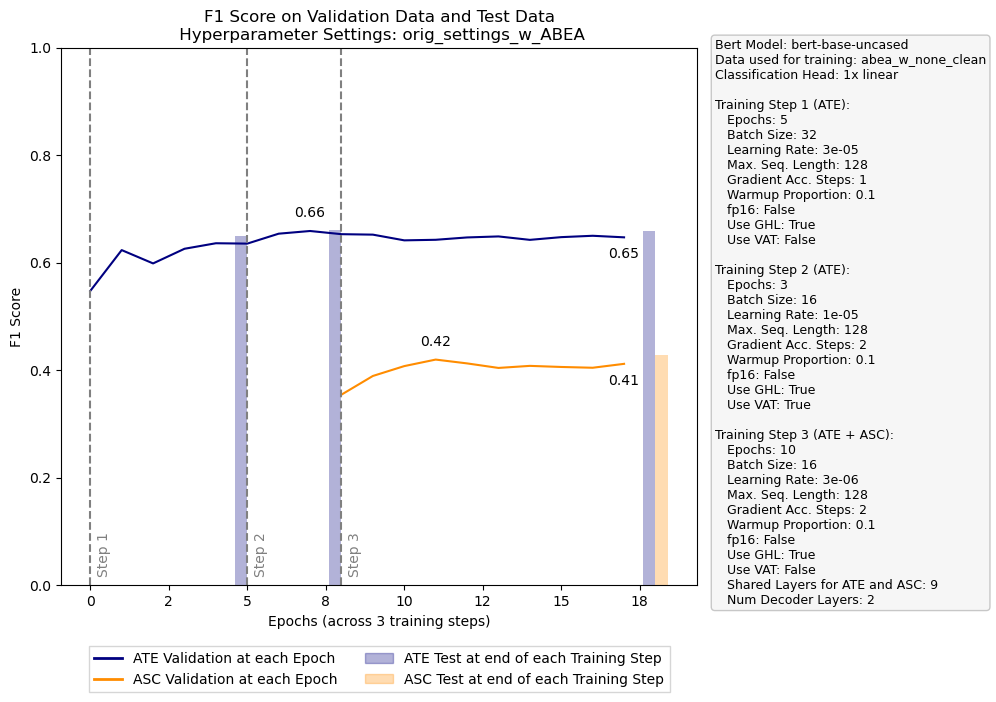

In [41]:
name = 'orig_settings_w_ABEA'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

AT: 67.3 in epoch 6
AS: 42.8 in epoch 6
Test Metrics AT: 65.6
Test Metrics AS: 45.0
F1 Score


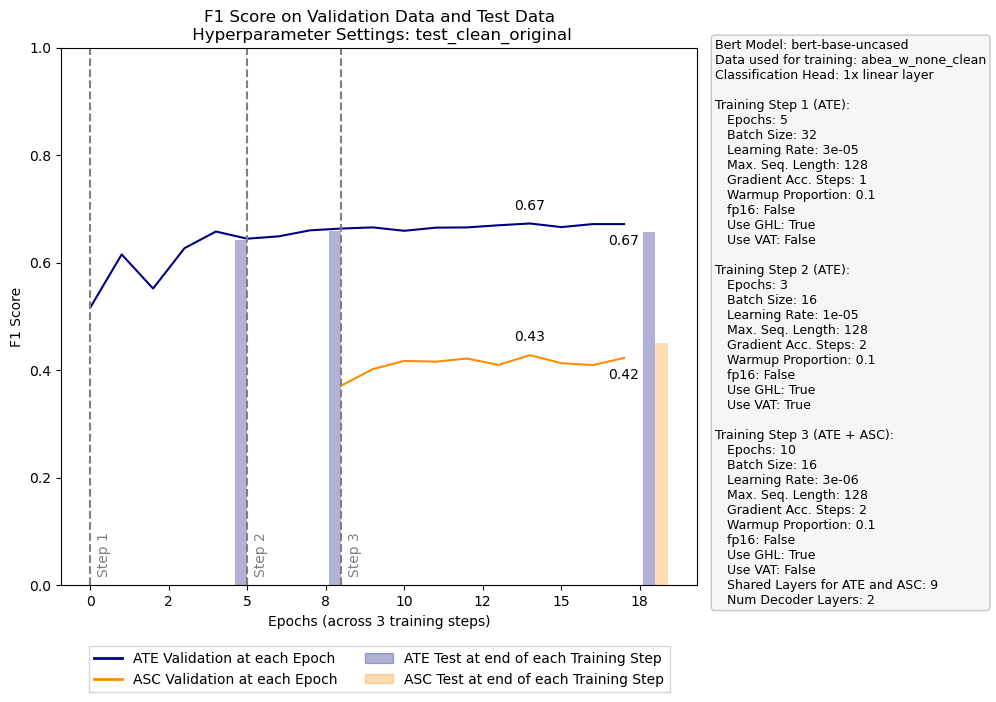

In [16]:
name = 'test_clean_original'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

F1 Score


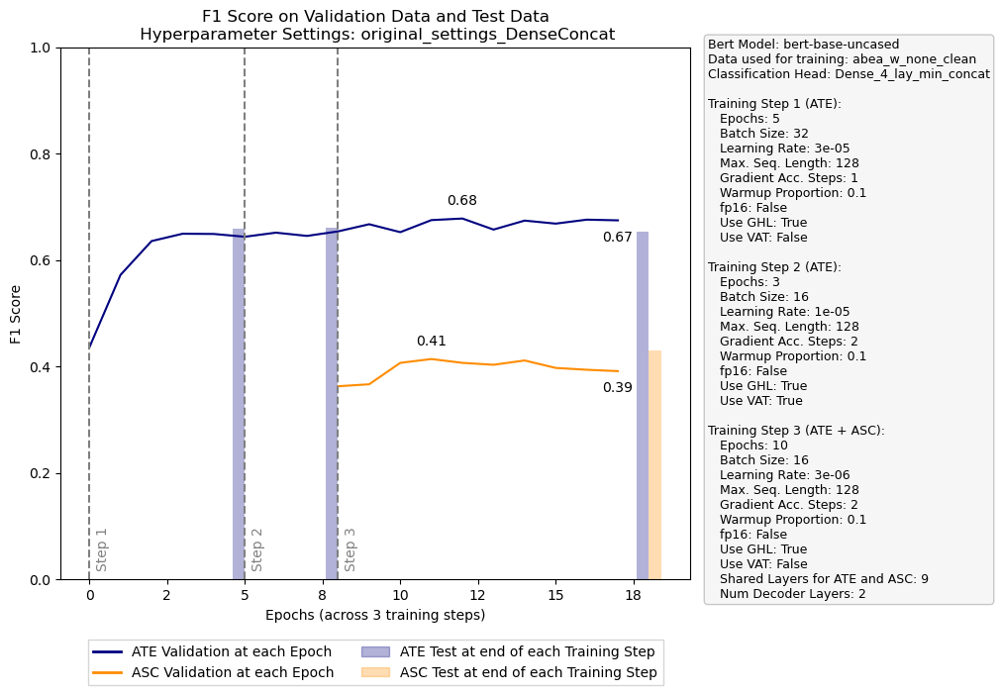

In [35]:
name = 'original_settings_DenseConcat'
file = 'GRACE/training_performance.json'
metric = "f1_score"


# extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

AT: 67.6 in epoch 0
AS: 41.4 in epoch 2
Test Metrics AT: 67.0
Test Metrics AS: 45.1
F1 Score


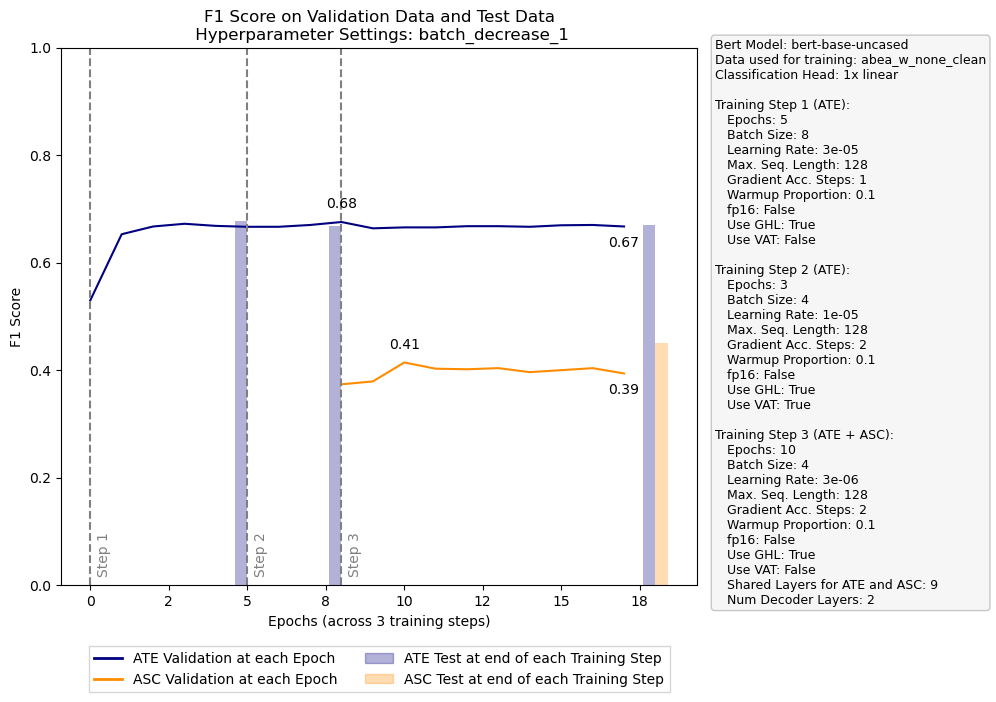

In [63]:
name = 'batch_decrease_1'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)
 
# used epoch 2 for validation

AT: 67.4 in epoch 0
AS: 42.1 in epoch 4
Test Metrics AT: 65.9
Test Metrics AS: 44.2
F1 Score


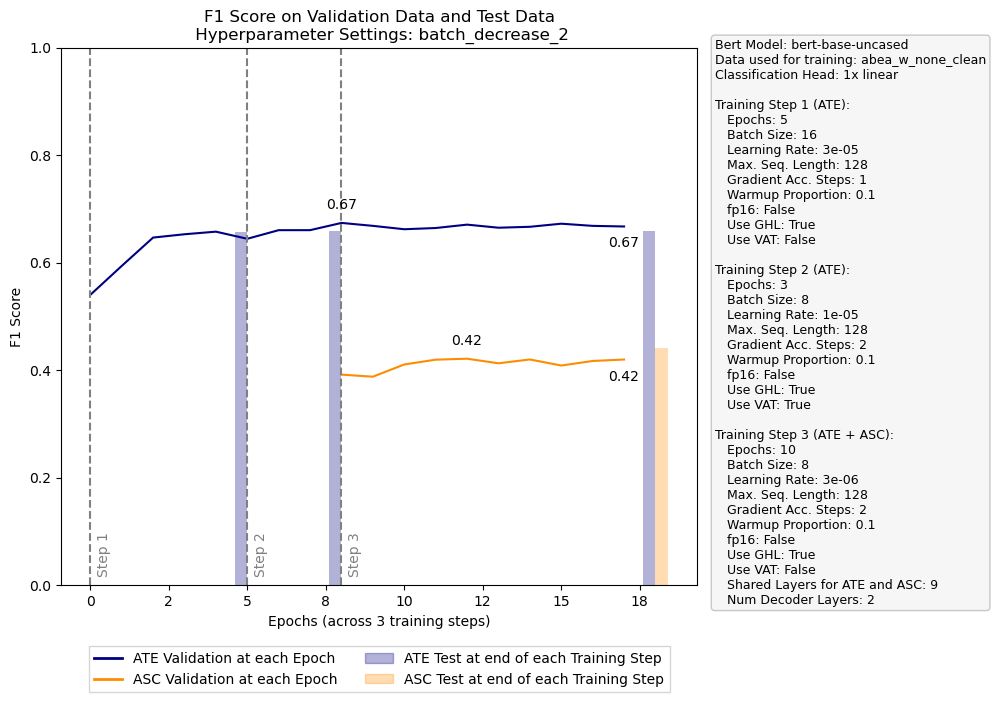

In [64]:
name = 'batch_decrease_2'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# used epoch 4 for validation

AT: 63.2 in epoch 0
AS: 39.1 in epoch 5
Test Metrics AT: 64.2
Test Metrics AS: 42.7
F1 Score


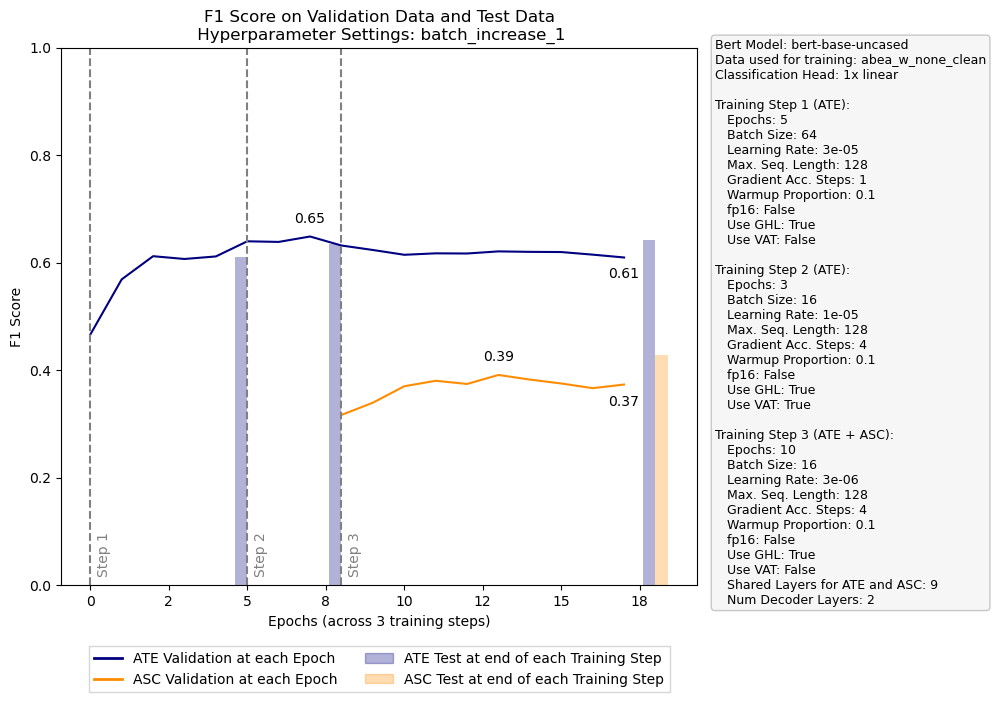

In [72]:
name = 'batch_increase_1'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# used epoch 5 for validation

AT: 68.2 in epoch 0
AS: 41.4 in epoch 3
Test Metrics AT: 67.4
Test Metrics AS: 45.3
F1 Score


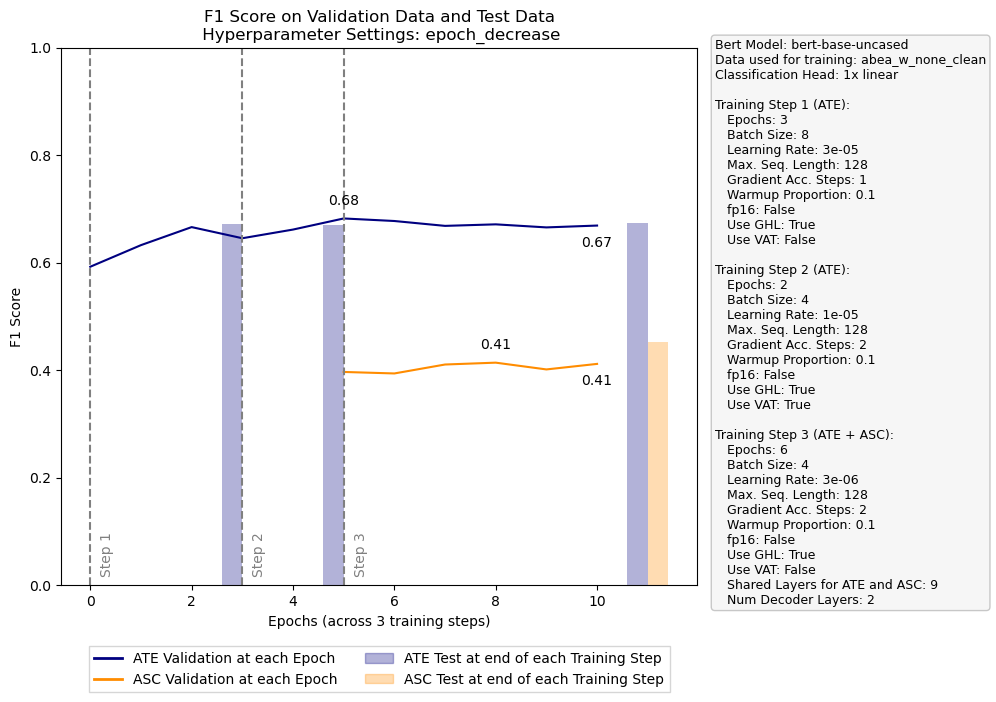

In [80]:
name = 'epoch_decrease'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 3

AT: 68.0 in epoch 4
AS: 42.2 in epoch 14
Test Metrics AT: 68.2
Test Metrics AS: 46.3
F1 Score


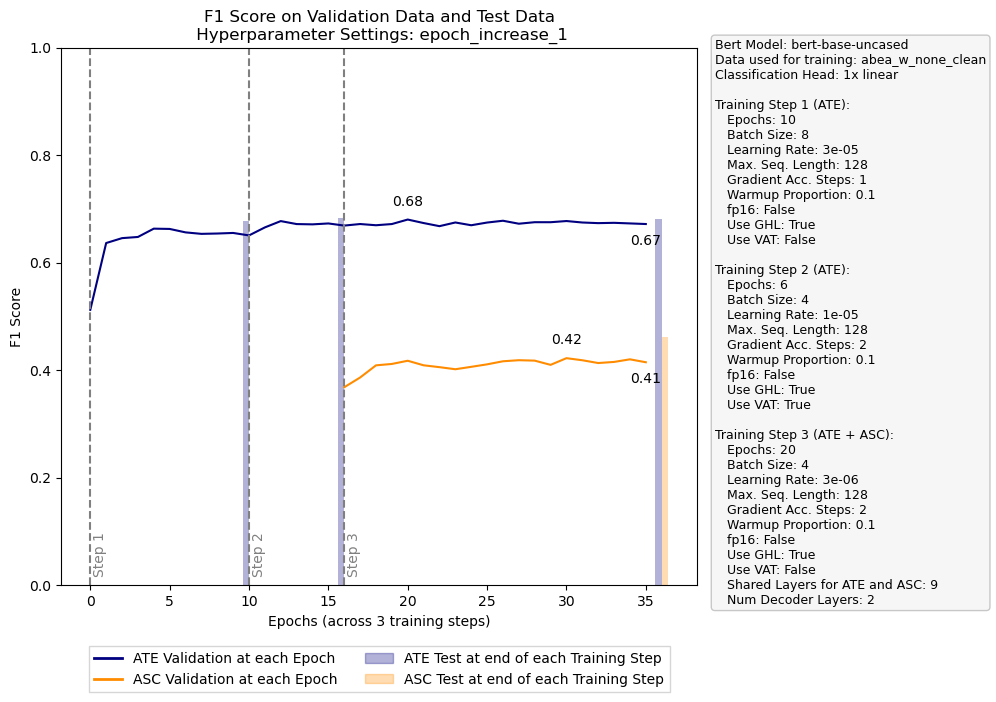

In [89]:
name = 'epoch_increase_1'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 14

AT: 67.7 in epoch 6
AS: 43.6 in epoch 15
Test Metrics AT: 67.4
Test Metrics AS: 45.1
F1 Score


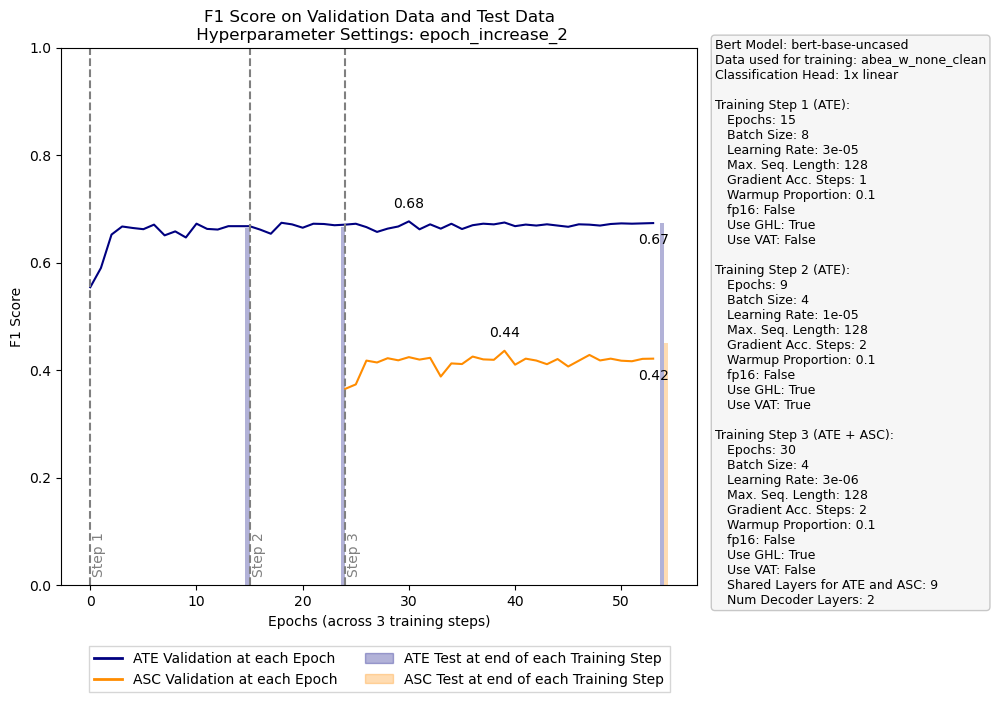

In [93]:
name = 'epoch_increase_2'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 15

AT: 67.8 in epoch 0
AS: 42.5 in epoch 2
Test Metrics AT: 68.2
Test Metrics AS: 44.7
F1 Score


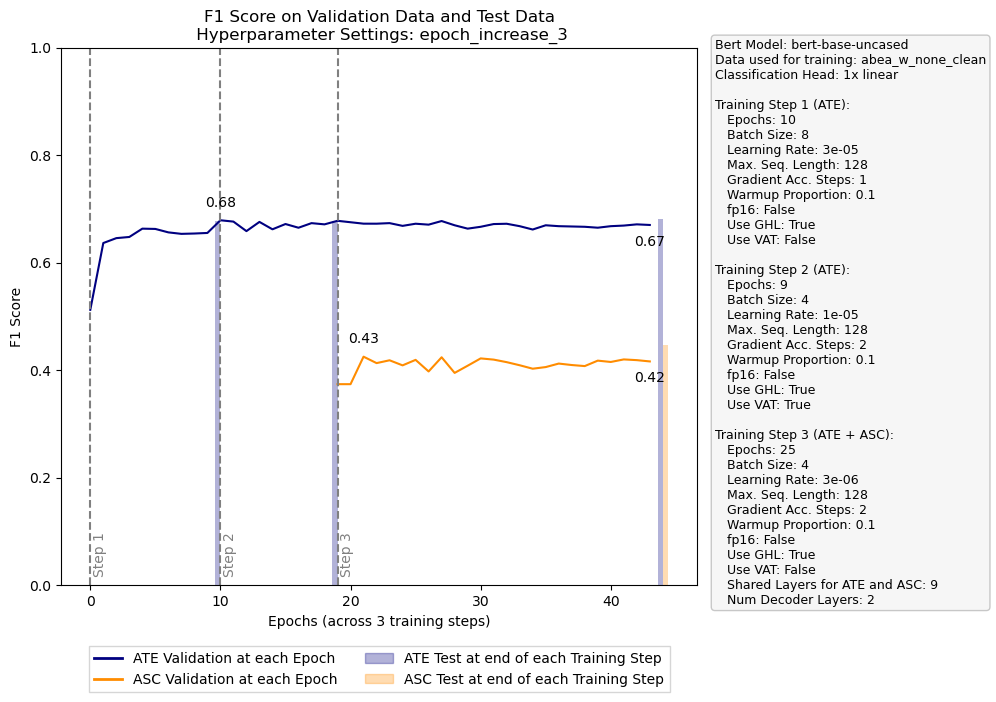

In [96]:
name = 'epoch_increase_3'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# 2

AT: 67.6 in epoch 2
AS: 43.0 in epoch 2
Test Metrics AT: 67.4
Test Metrics AS: 45.1
F1 Score


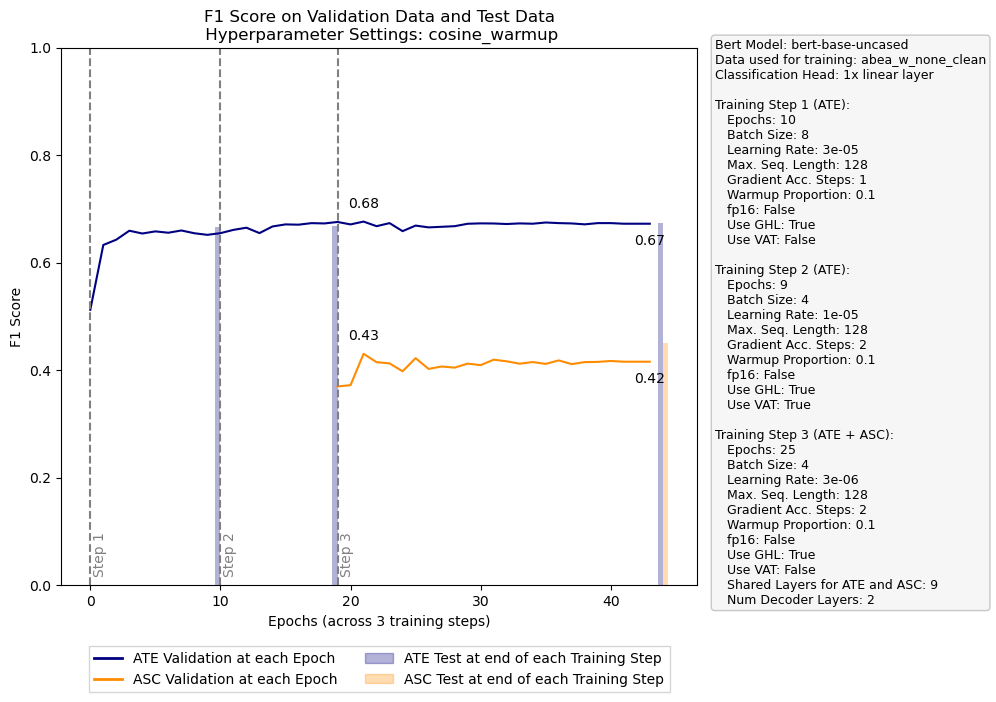

In [102]:
name = 'cosine_warmup'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 2

AT: 68.5 in epoch 19
AS: 43.6 in epoch 22
Test Metrics AT: 67.2
Test Metrics AS: 43.6
F1 Score


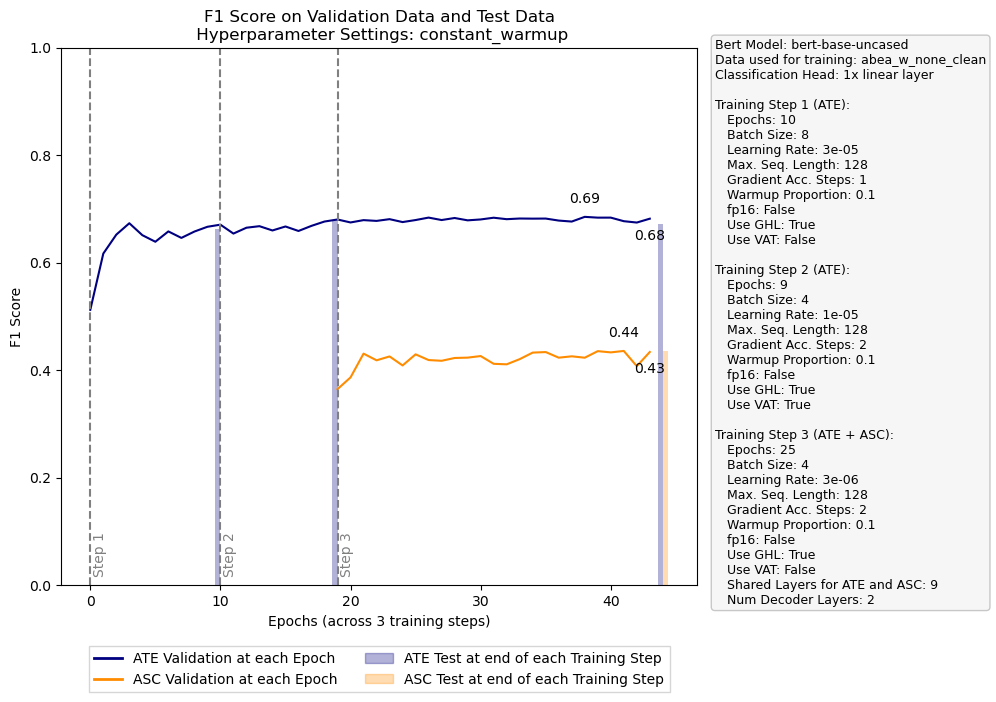

In [12]:
name = 'constant_warmup'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 22

AT: 68.7 in epoch 21
AS: 42.3 in epoch 22
Test Metrics AT: 66.8
Test Metrics AS: 44.5
F1 Score


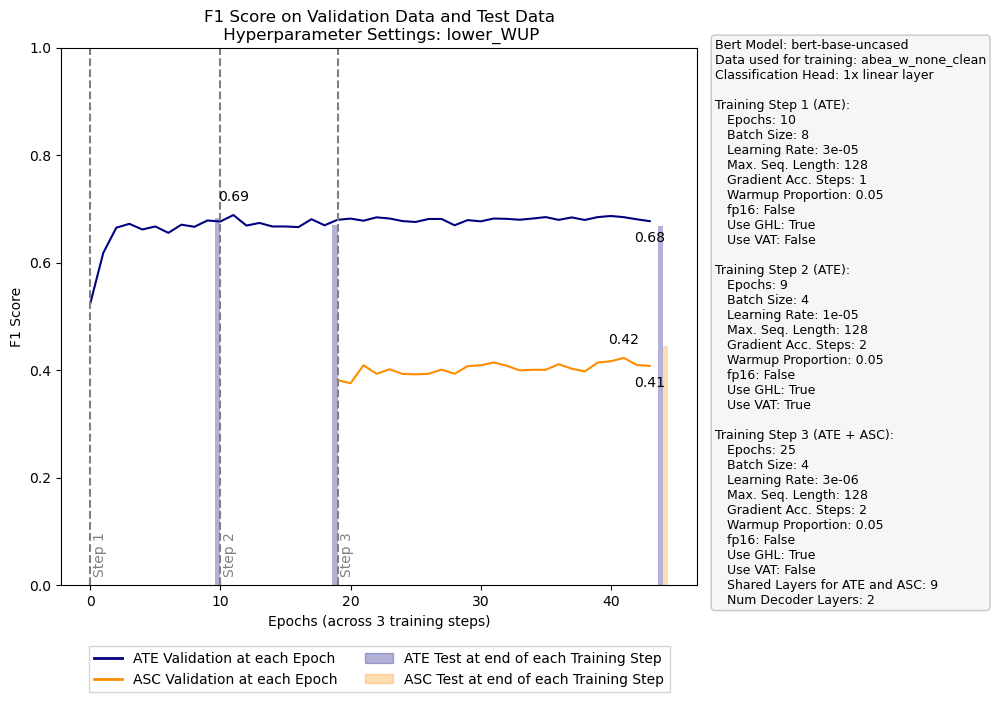

In [19]:
name = 'lower_WUP'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 22

AT: 65.9 in epoch 21
AS: 41.9 in epoch 17
Test Metrics AT: 68.0
Test Metrics AS: 46.0
F1 Score


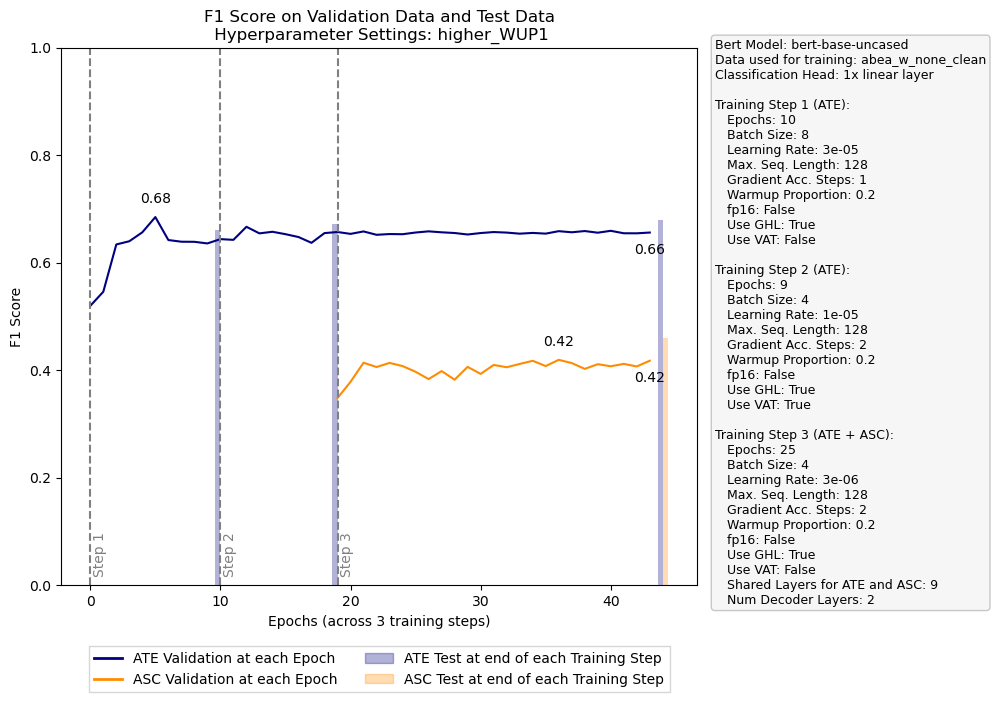

In [26]:
name = 'higher_WUP1'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 67.5 in epoch 10
AS: 42.5 in epoch 23
Test Metrics AT: 67.9
Test Metrics AS: 45.1
F1 Score


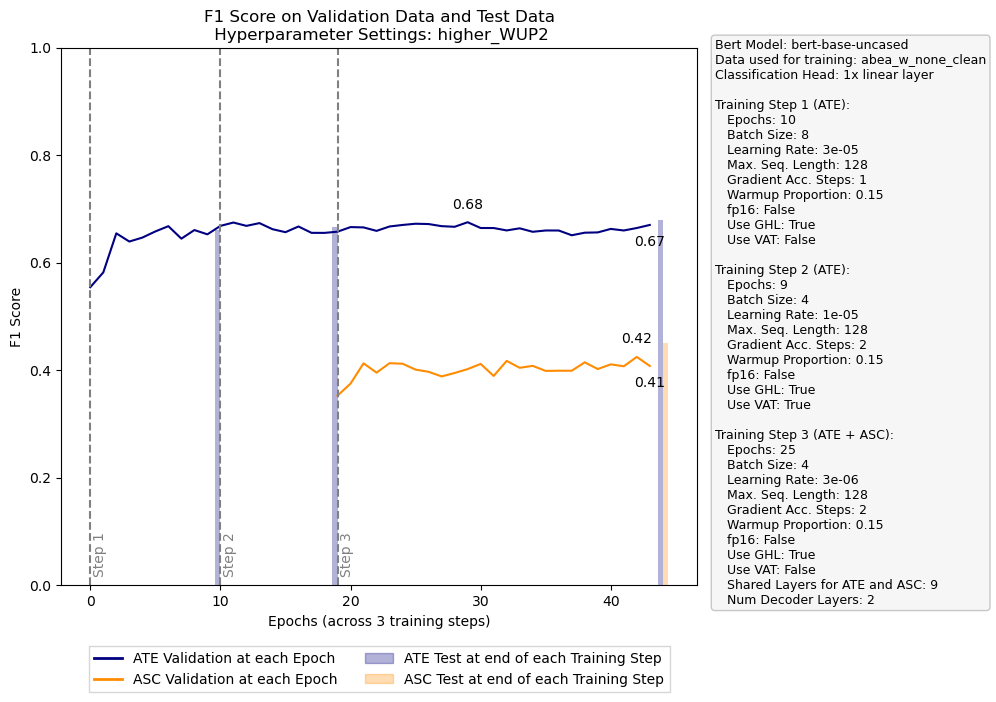

In [32]:
name = 'higher_WUP2'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 23

AT: 69.2 in epoch 1
AS: 42.3 in epoch 7
Test Metrics AT: 66.6
Test Metrics AS: 43.2
F1 Score


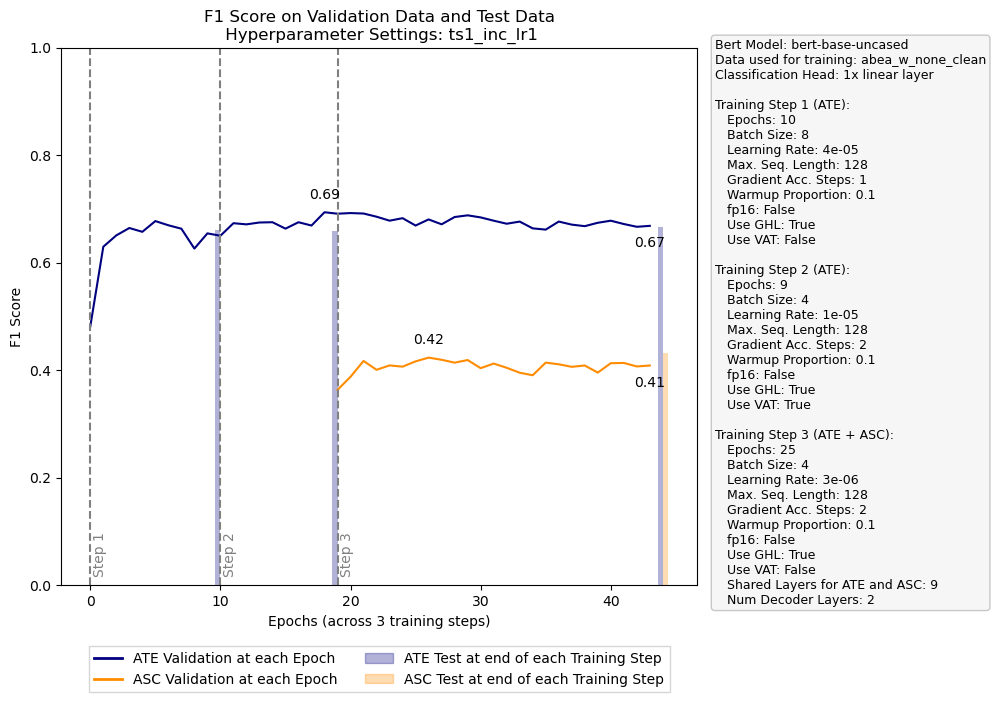

In [40]:
name = 'ts1_inc_lr1'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 7

AT: 68.8 in epoch 0
AS: 44.9 in epoch 13
Test Metrics AT: 66.0
Test Metrics AS: 42.8
F1 Score


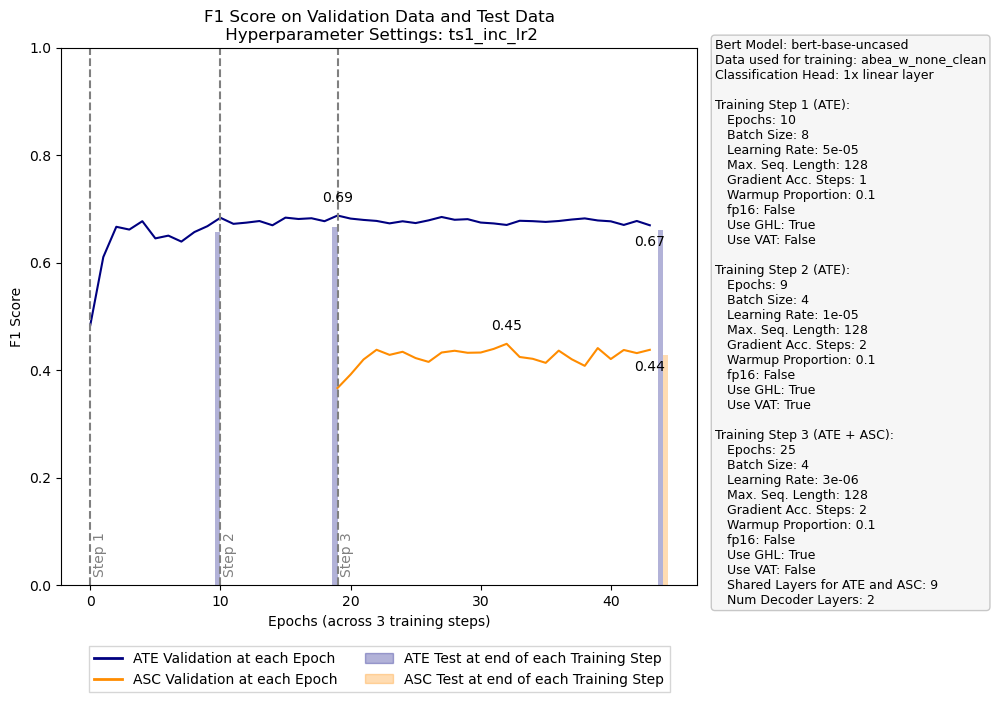

In [46]:
name = 'ts1_inc_lr2'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 13

AT: 68.2 in epoch 14
AS: 43.9 in epoch 24
Test Metrics AT: 67.7
Test Metrics AS: 45.9
F1 Score


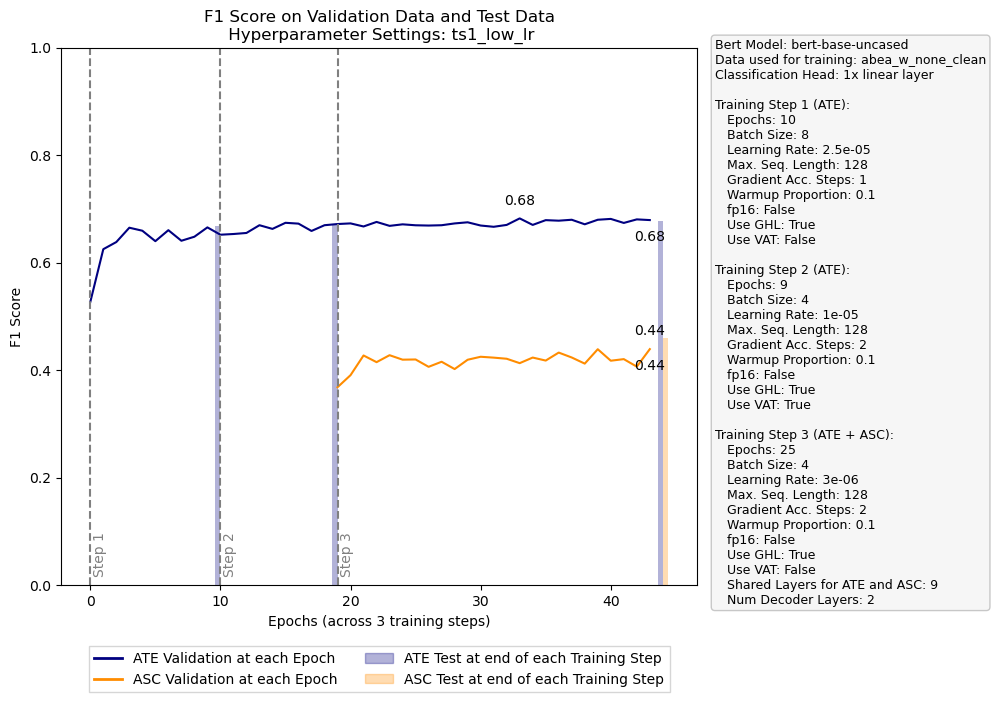

In [50]:
name = 'ts1_low_lr'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 24

AT: 68.4 in epoch 20
AS: 42.4 in epoch 17
Test Metrics AT: 67.1
Test Metrics AS: 44.5
F1 Score


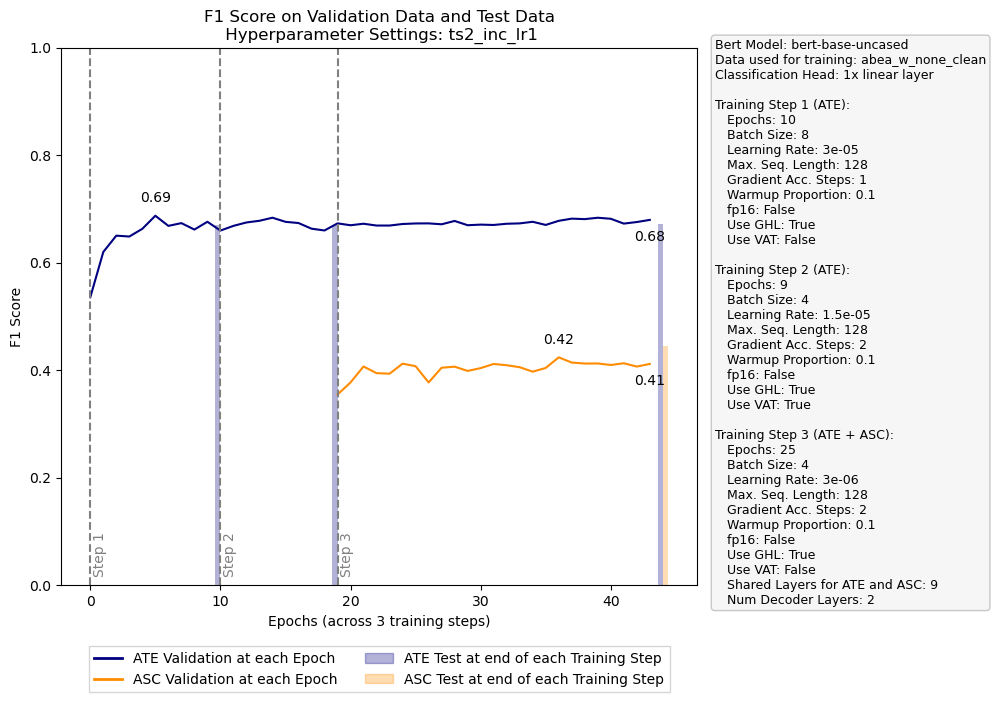

In [53]:
name = 'ts2_inc_lr1'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 68.2 in epoch 15
AS: 42.7 in epoch 23
Test Metrics AT: 66.8
Test Metrics AS: 45.7
F1 Score


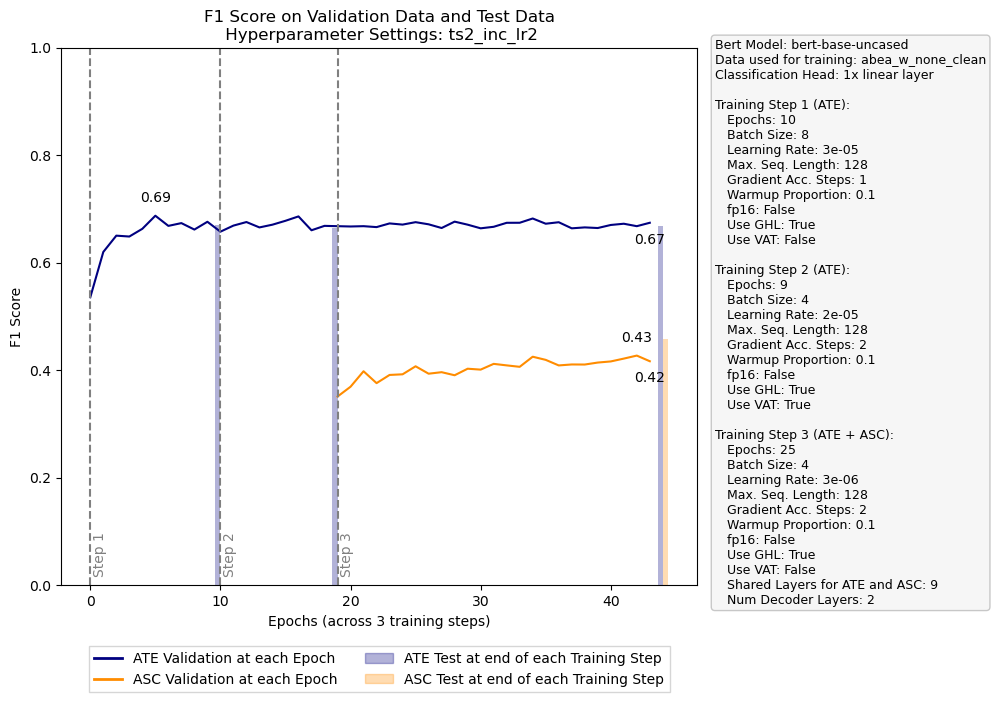

In [58]:
name = 'ts2_inc_lr2'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 23

AT: 69.4 in epoch 1
AS: 41.9 in epoch 12
Test Metrics AT: 67.1
Test Metrics AS: 43.9
F1 Score


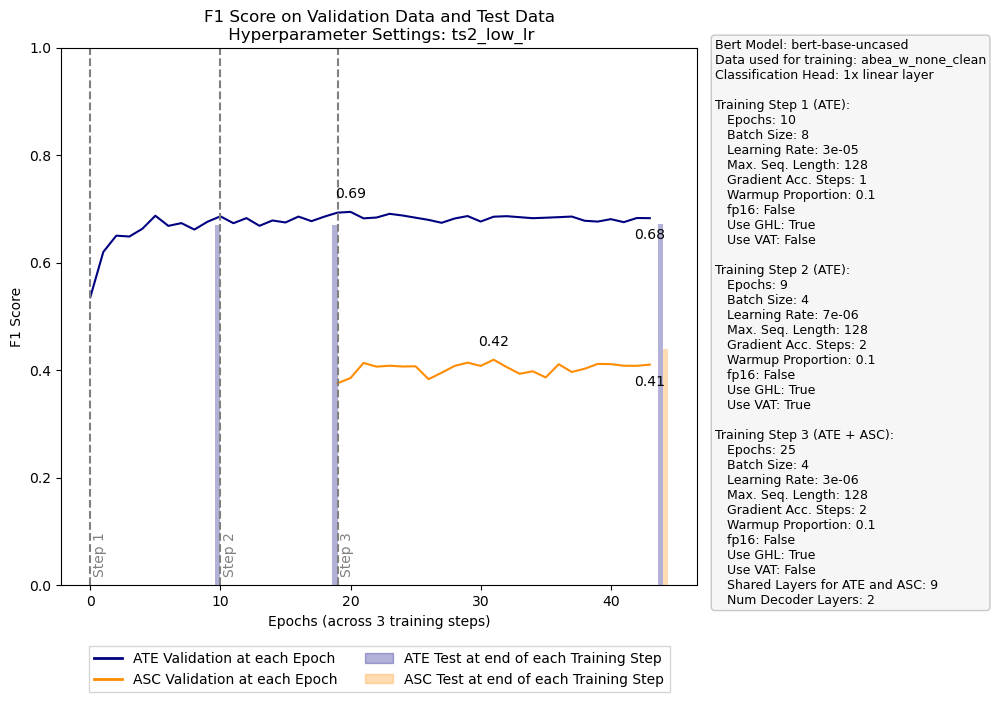

In [67]:
name = 'ts2_low_lr'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 12

AT: 69.9 in epoch 3
AS: 44.1 in epoch 11
Test Metrics AT: 67.7
Test Metrics AS: 43.1
F1 Score


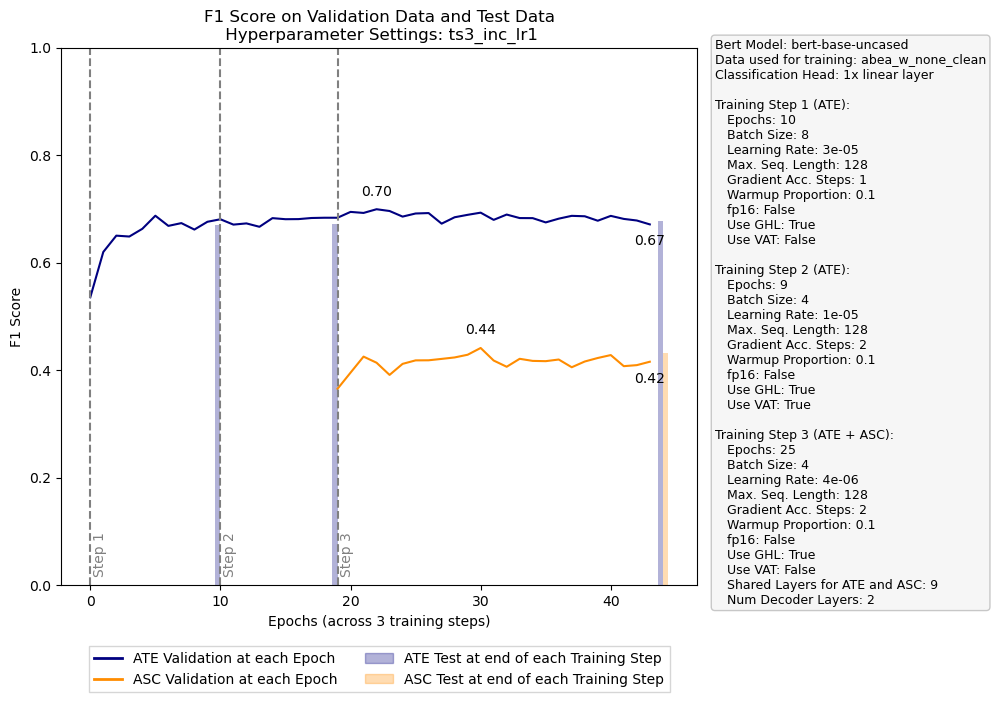

In [14]:
name = 'ts3_inc_lr1'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 11

AT: 70.0 in epoch 3
AS: 43.8 in epoch 11
Test Metrics AT: 68.1
Test Metrics AS: 44.3
F1 Score


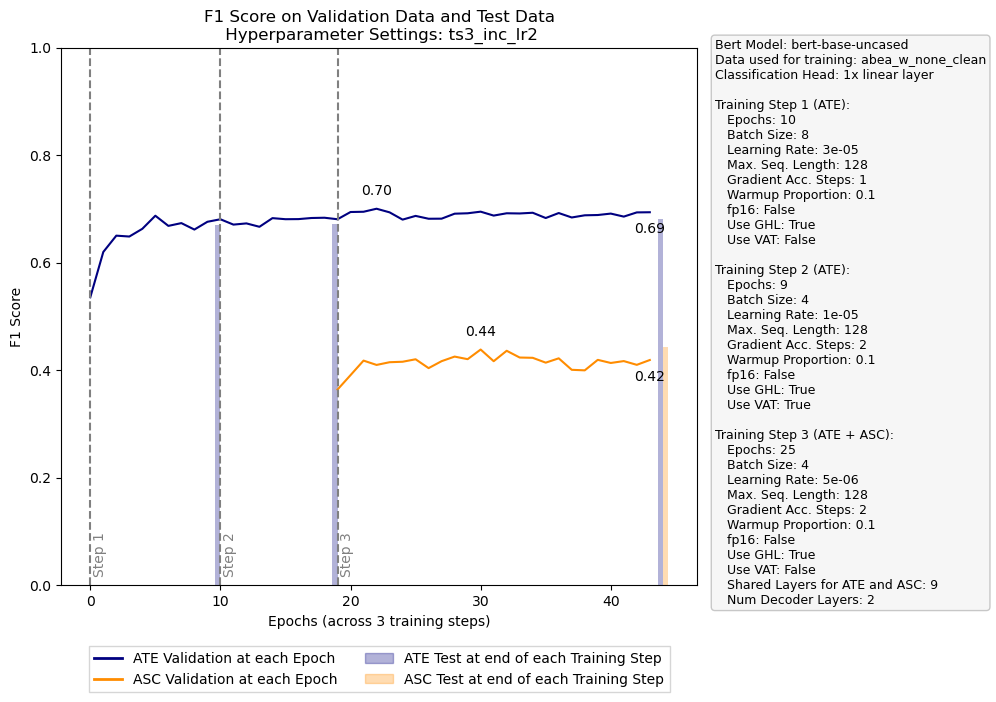

In [12]:
name = 'ts3_inc_lr2'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 12

AT: 69.6 in epoch 19
AS: 42.9 in epoch 17
Test Metrics AT: 67.8
Test Metrics AS: 44.2
F1 Score


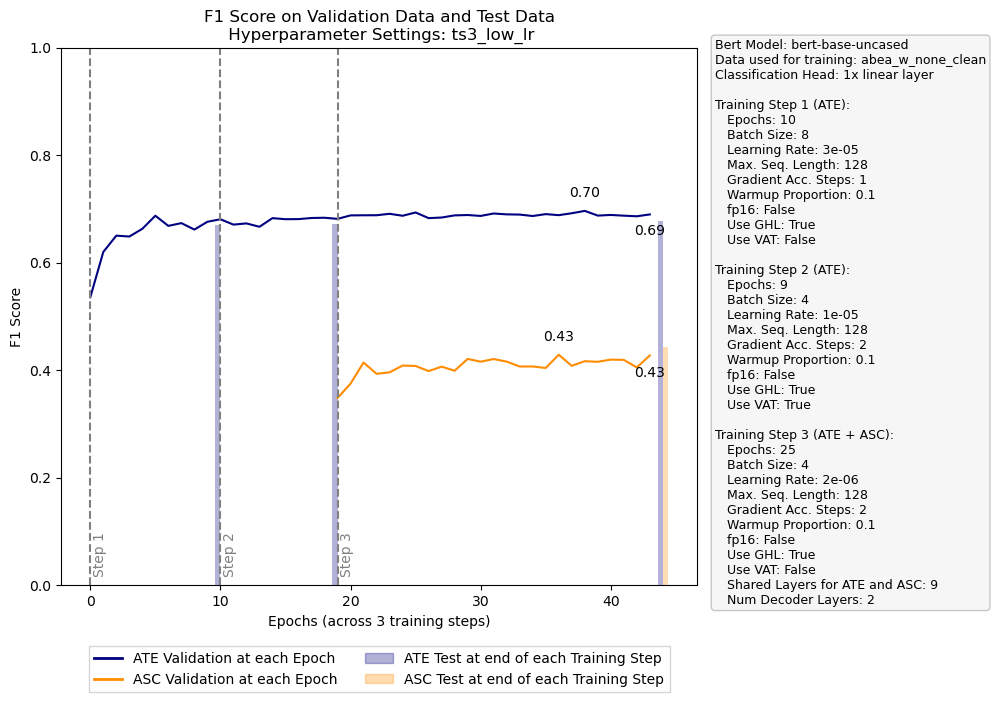

In [20]:
name = 'ts3_low_lr'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 69.8 in epoch 11
AS: 41.6 in epoch 22
Test Metrics AT: 67.3
Test Metrics AS: 45.6
F1 Score


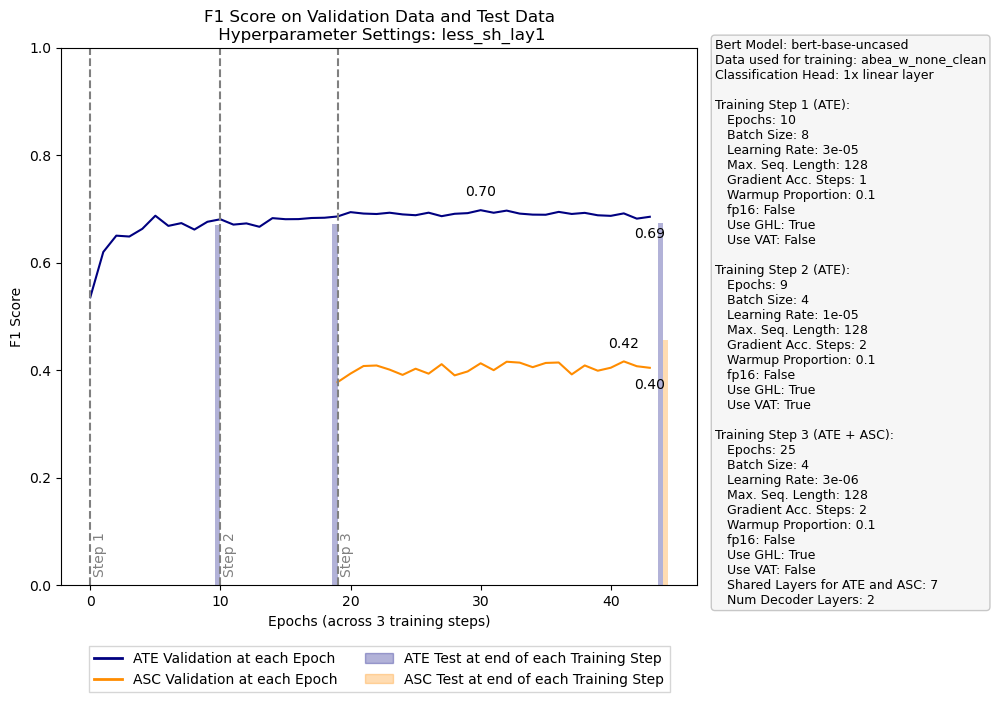

In [40]:
name = 'less_sh_lay1'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 22

AT: 69.1 in epoch 5
AS: 43.2 in epoch 19
Test Metrics AT: 67.3
Test Metrics AS: 46.5
F1 Score


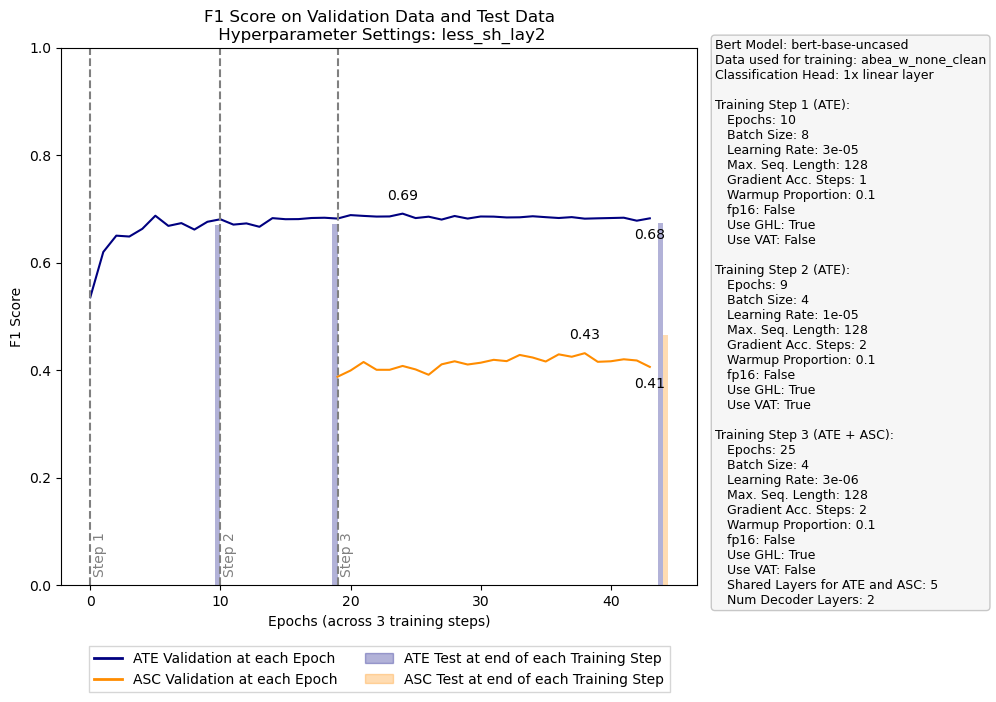

In [69]:
name = 'less_sh_lay2'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 19

AT: 69.5 in epoch 16
AS: 42.9 in epoch 16
Test Metrics AT: 66.9
Test Metrics AS: 45.4
F1 Score


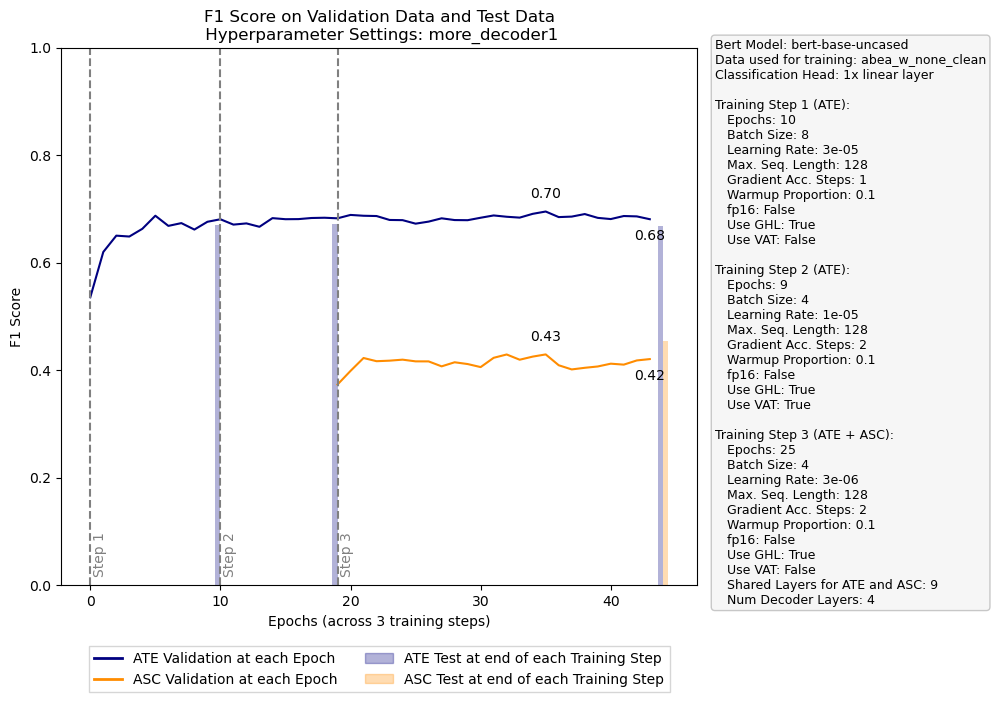

In [73]:
name = 'more_decoder1'    # 'more_decoder2', 'more_decoder1_less_sh', 'more_decoder2_less_sh']'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 16

AT: 69.1 in epoch 3
AS: 43.5 in epoch 19
Test Metrics AT: 67.7
Test Metrics AS: 45.3
F1 Score


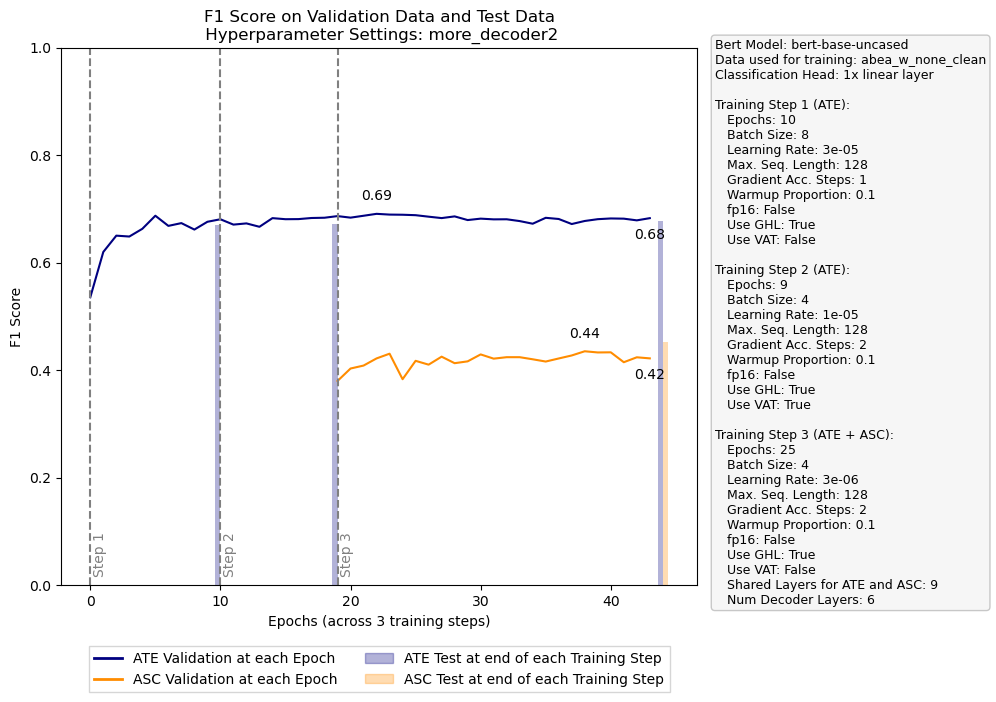

In [82]:
name = 'more_decoder2'    # 'more_decoder1_less_sh', 'more_decoder2_less_sh']'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 19

AT: 68.8 in epoch 1
AS: 44.7 in epoch 8
Test Metrics AT: 66.1
Test Metrics AS: 47.1
F1 Score


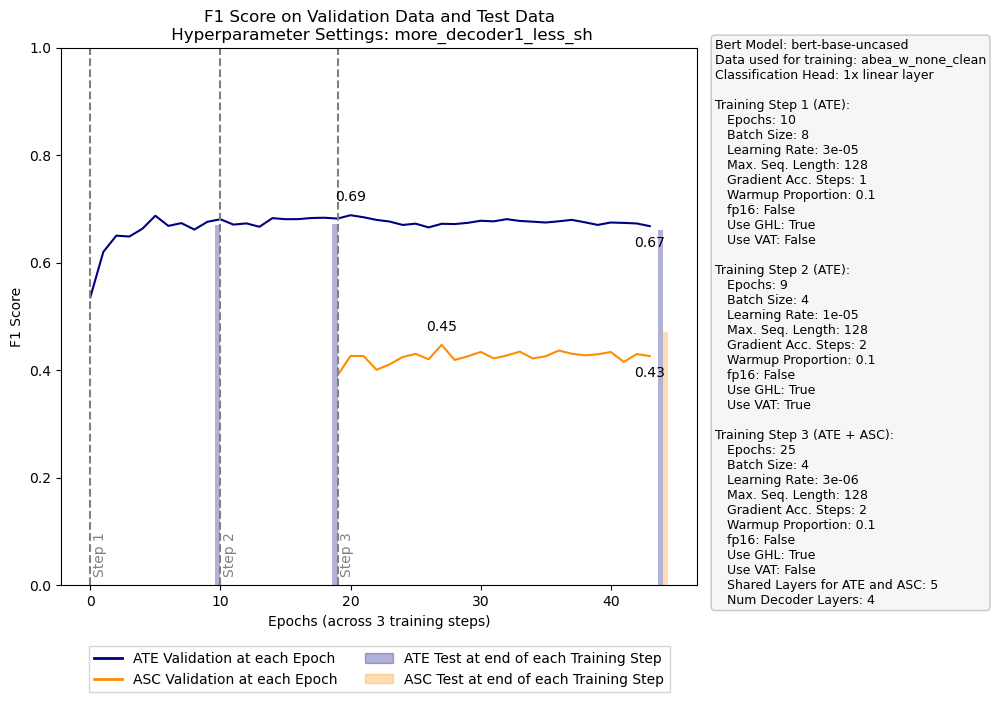

In [90]:
name = 'more_decoder1_less_sh'   # 'more_decoder2_less_sh'
file = 'GRACE/training_performance.json'
metric = "f1_score"


extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 8

AT: 68.6 in epoch 0
AS: 44.2 in epoch 13
Test Metrics AT: 66.5
Test Metrics AS: 45.9
F1 Score


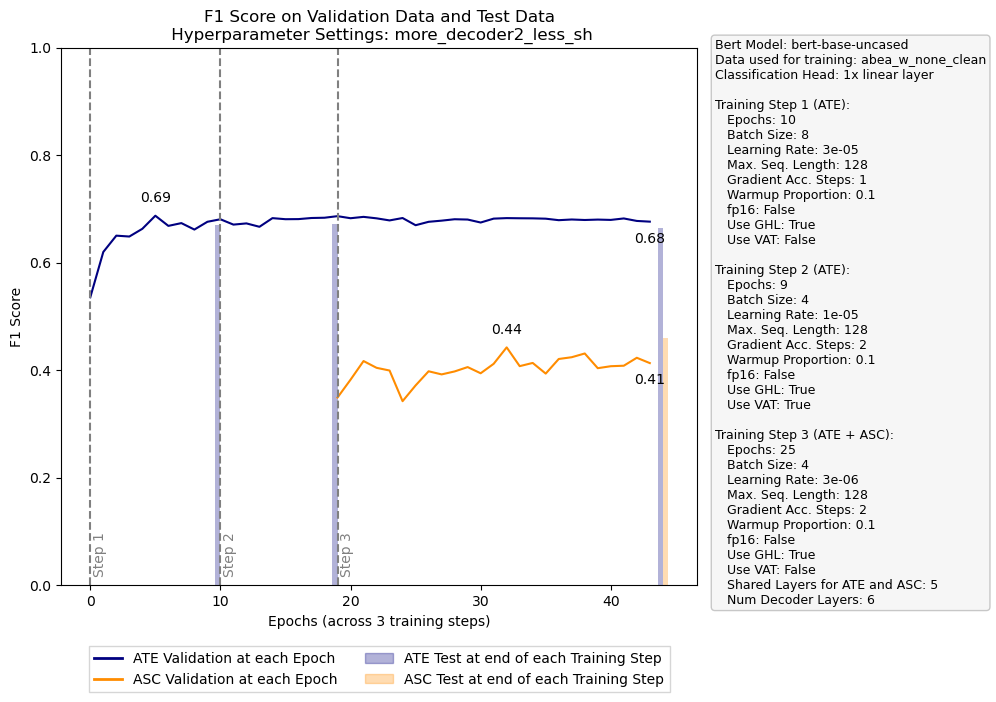

In [120]:
name = 'more_decoder2_less_sh'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 19

AT: 67.0 in epoch 21
AS: 44.2 in epoch 19
Test Metrics AT: 65.9
Test Metrics AS: 46.1
F1 Score


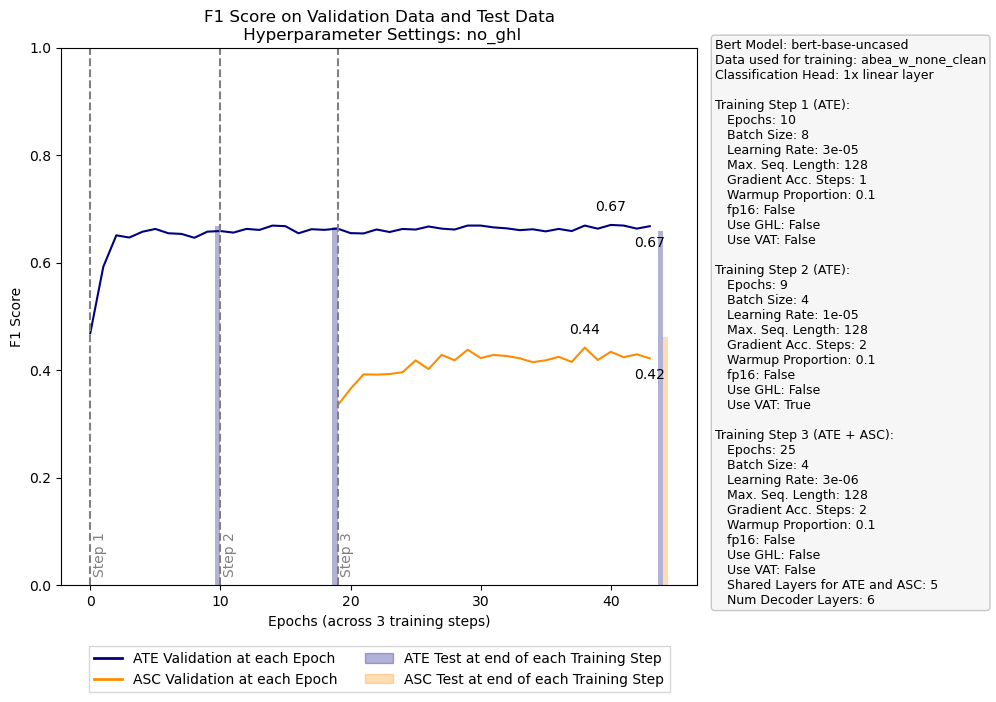

In [30]:
name = 'no_ghl'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 19

AT: 67.7 in epoch 22
AS: 44.7 in epoch 20
Test Metrics AT: 66.3
Test Metrics AS: 46.4
F1 Score


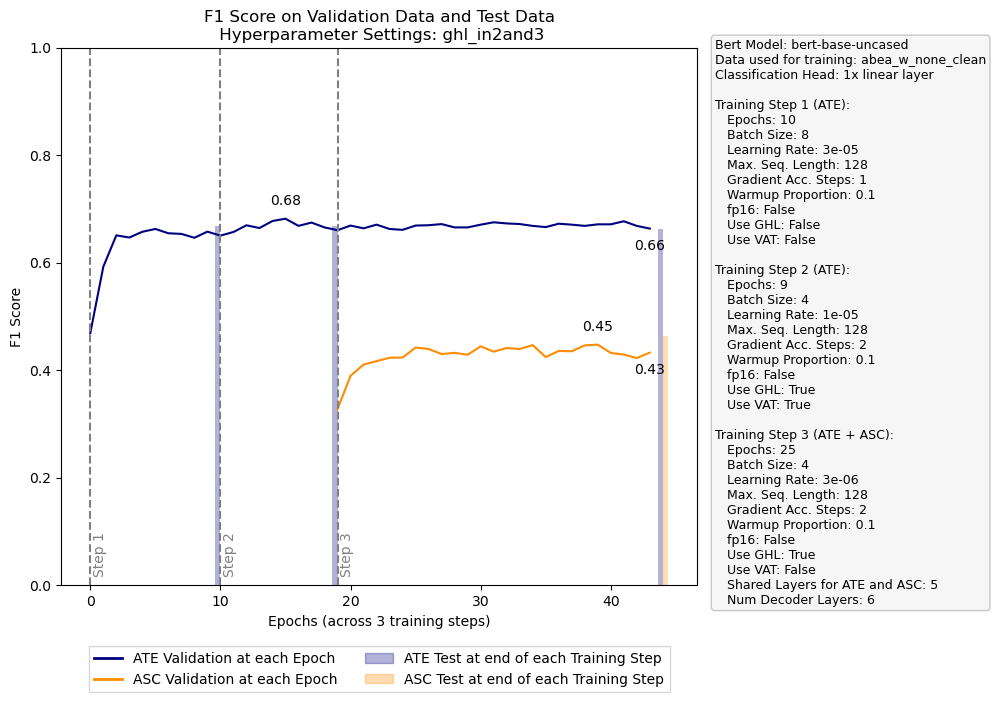

In [75]:
name = 'ghl_in2and3'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 20

AT: 66.7 in epoch 24
AS: 46.6 in epoch 20
Test Metrics AT: 66.0
Test Metrics AS: 46.9
F1 Score


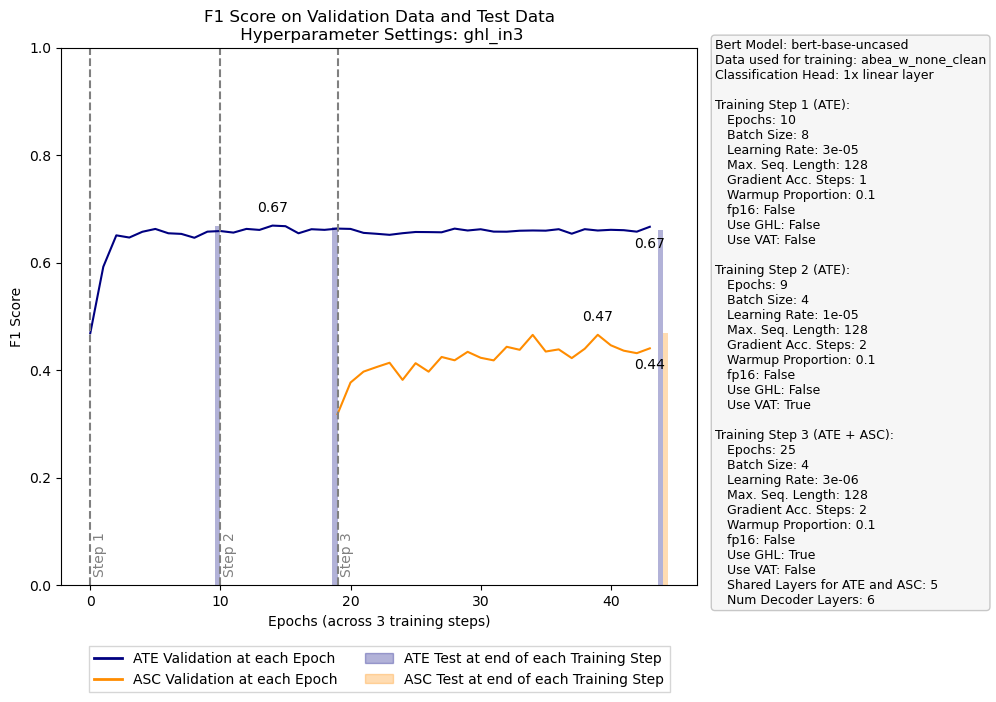

In [13]:
name = 'ghl_in3'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 

AT: 68.4 in epoch 7
AS: 45.9 in epoch 17
Test Metrics AT: 66.8
Test Metrics AS: 47.1
F1 Score


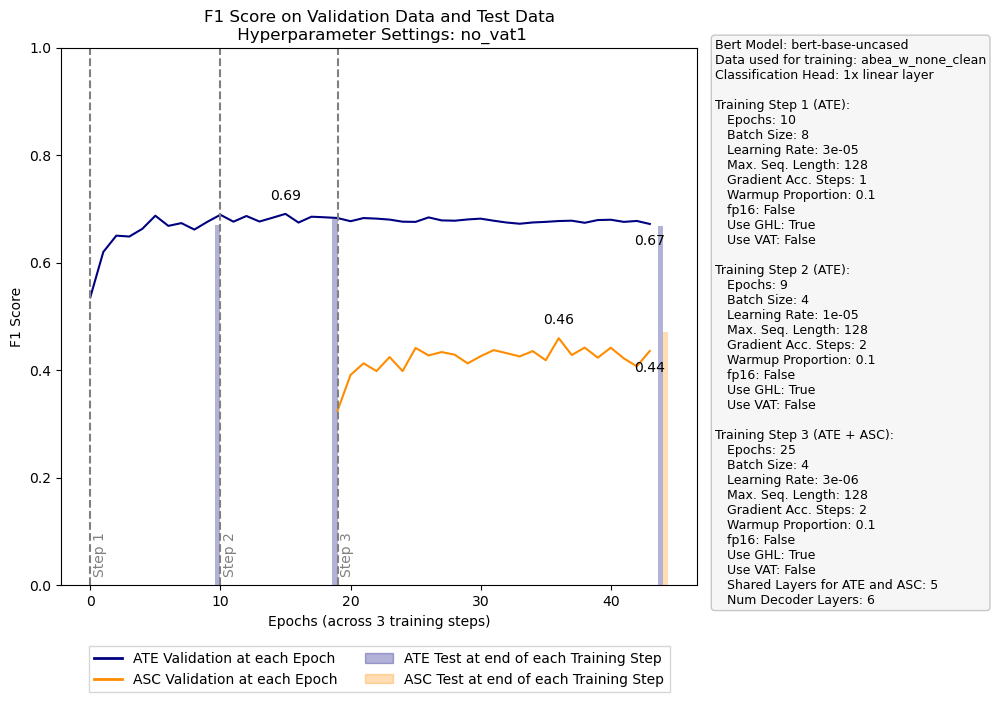

In [5]:
name = 'no_vat1' # + ghl in all, mlp classifier
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 67.7 in epoch 19
AS: 44.5 in epoch 19
Test Metrics AT: 66.1
Test Metrics AS: 45.2
F1 Score


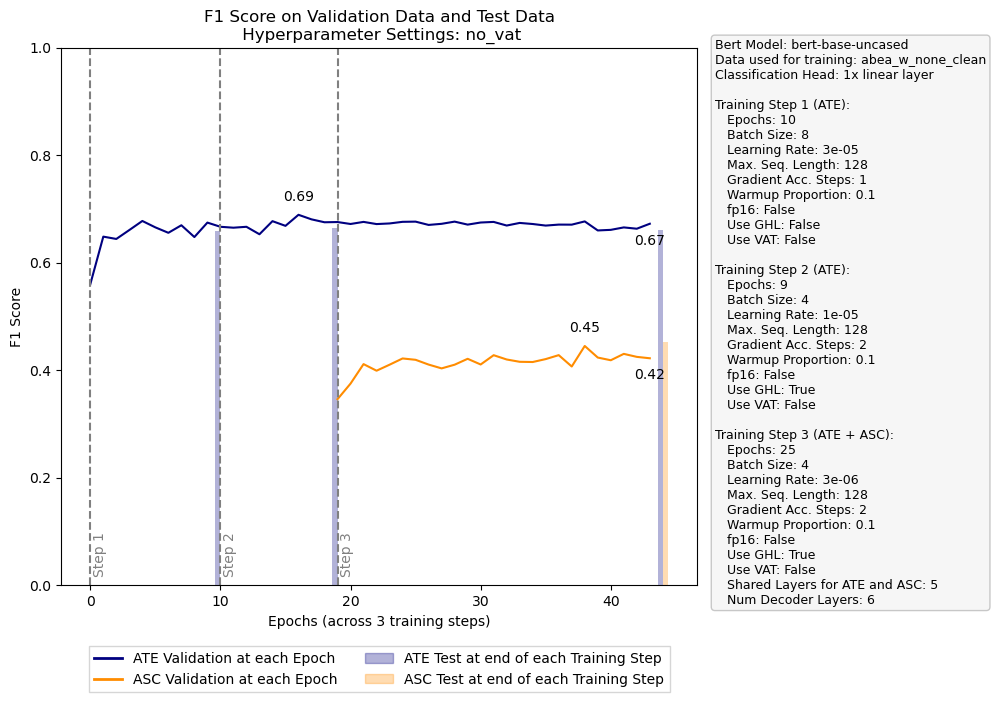

In [31]:
name = 'no_vat' # +  no ghl in 1, linear classifier
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 68.4 in epoch 7
AS: 45.9 in epoch 17
Test Metrics AT: 66.8
Test Metrics AS: 47.1
F1 Score


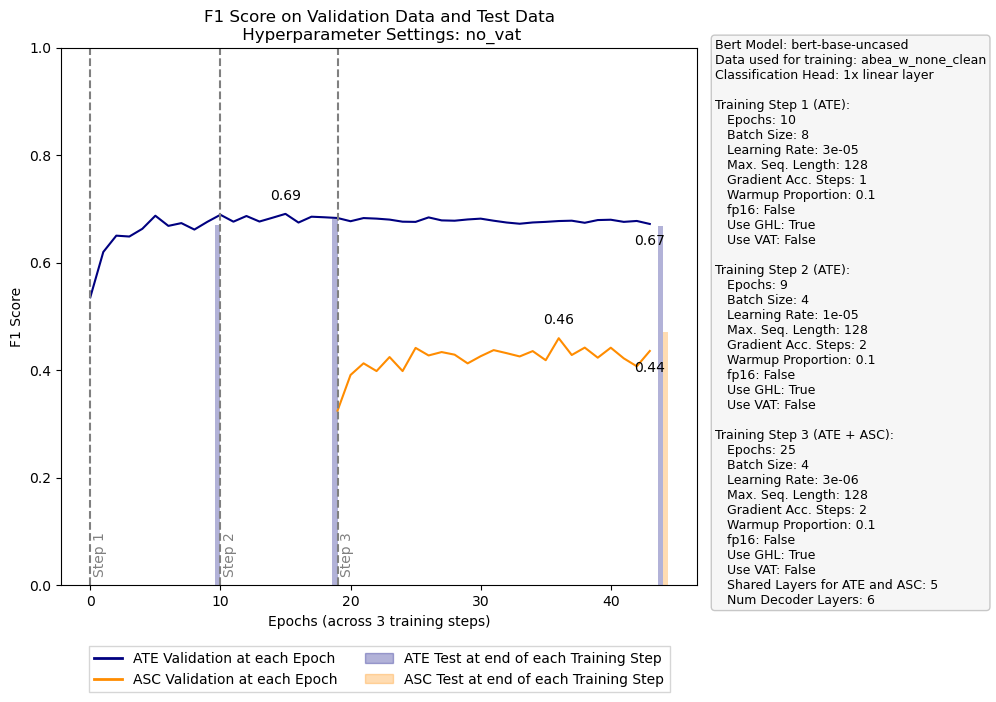

In [32]:
name = 'no_vat' # ghl in all, 1x linear classifier
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 68.8 in epoch 6
AS: 45.5 in epoch 13
Test Metrics AT: 67.7
Test Metrics AS: 46.7
F1 Score


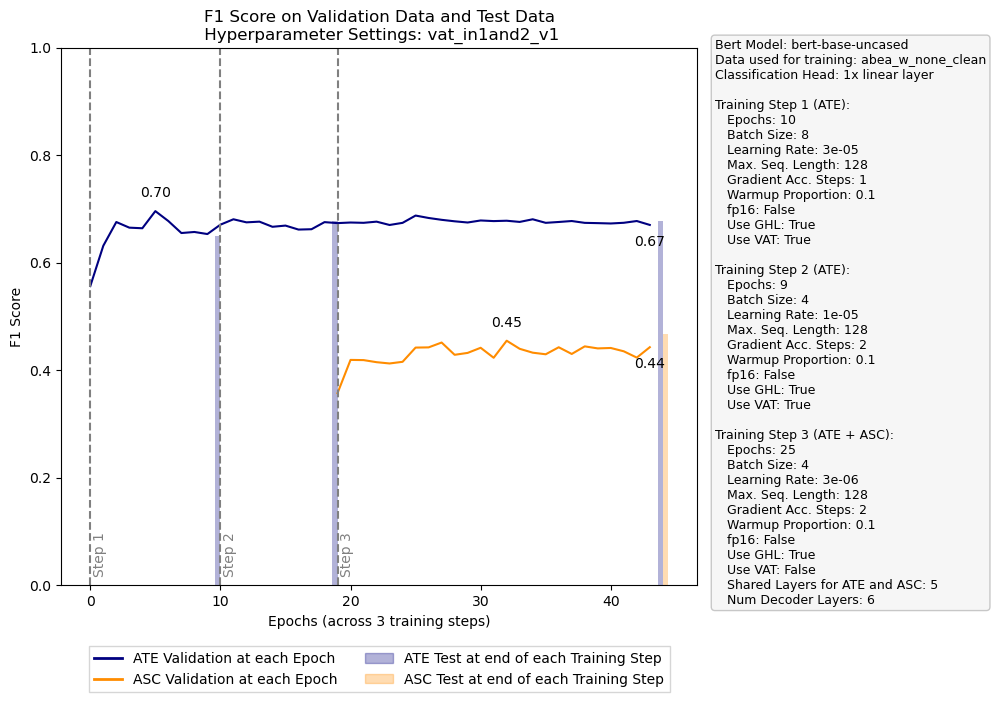

In [32]:
name = 'vat_in1and2_v1'  # ghl in all, MLP Classifier
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 13

AT: 66.0 in epoch 10
AS: 41.4 in epoch 23
Test Metrics AT: 66.4
Test Metrics AS: 45.5
F1 Score


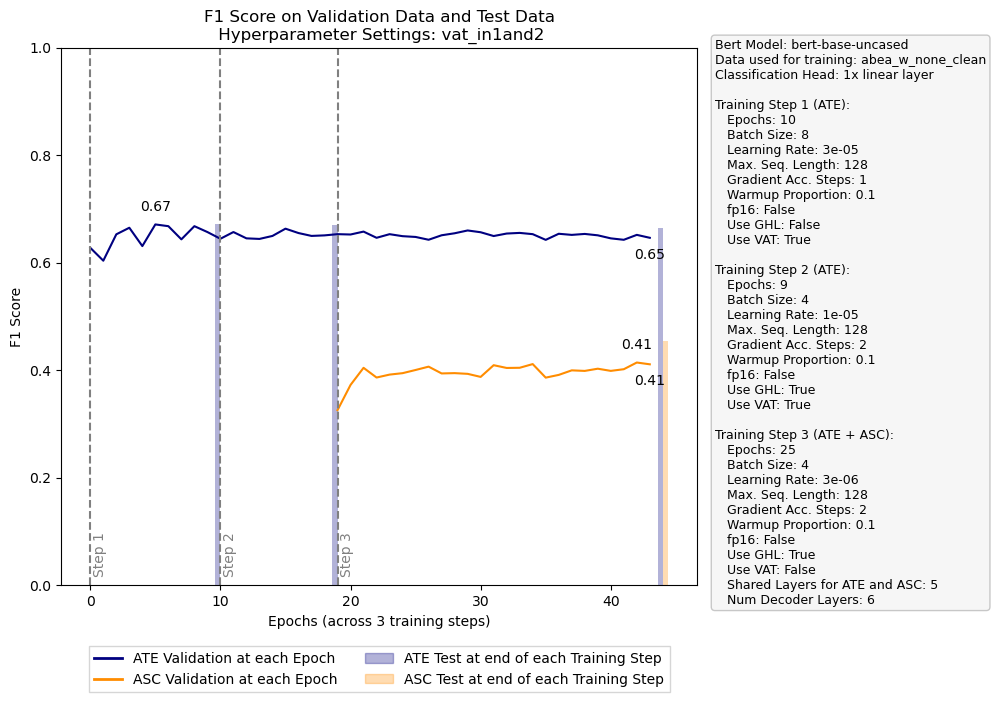

In [50]:
name = 'vat_in1and2' # ghl not in 1, 1x linear classifier

file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 13

AT: 68.8 in epoch 6
AS: 45.5 in epoch 13
Test Metrics AT: 67.7
Test Metrics AS: 46.7
F1 Score


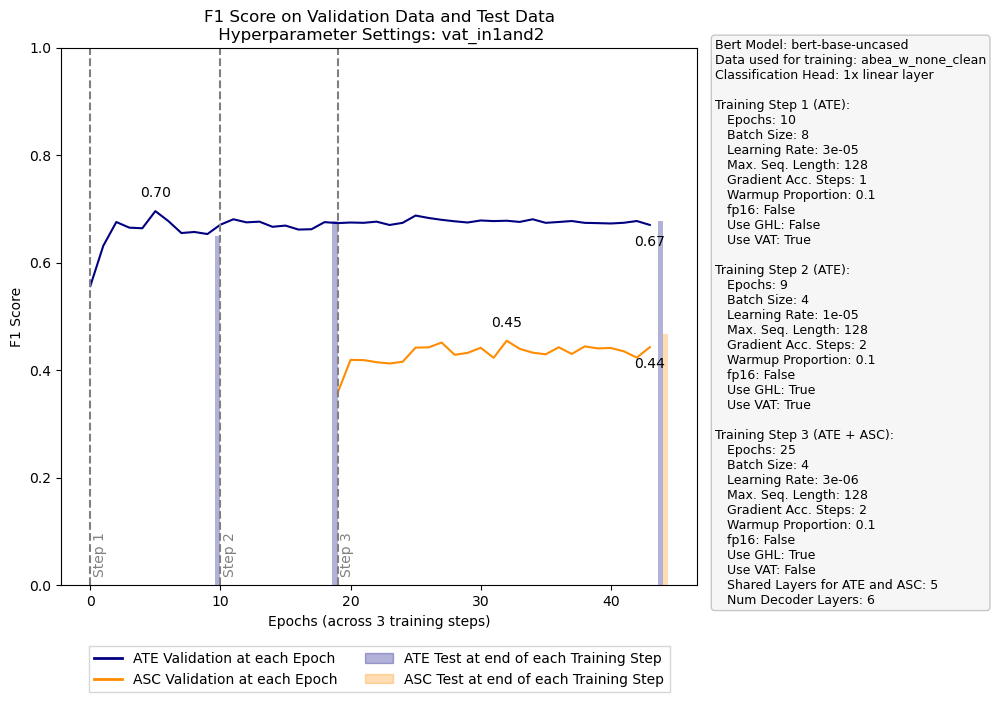

In [33]:
name = 'vat_in1and2' # ghl in all, 1x linear layer
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 13

#### Current-ish Outputs

AT: 70.2 in epoch 0
AS: 44.6 in epoch 24
Test Metrics AT: 67.0
Test Metrics AS: 48.0
F1 Score


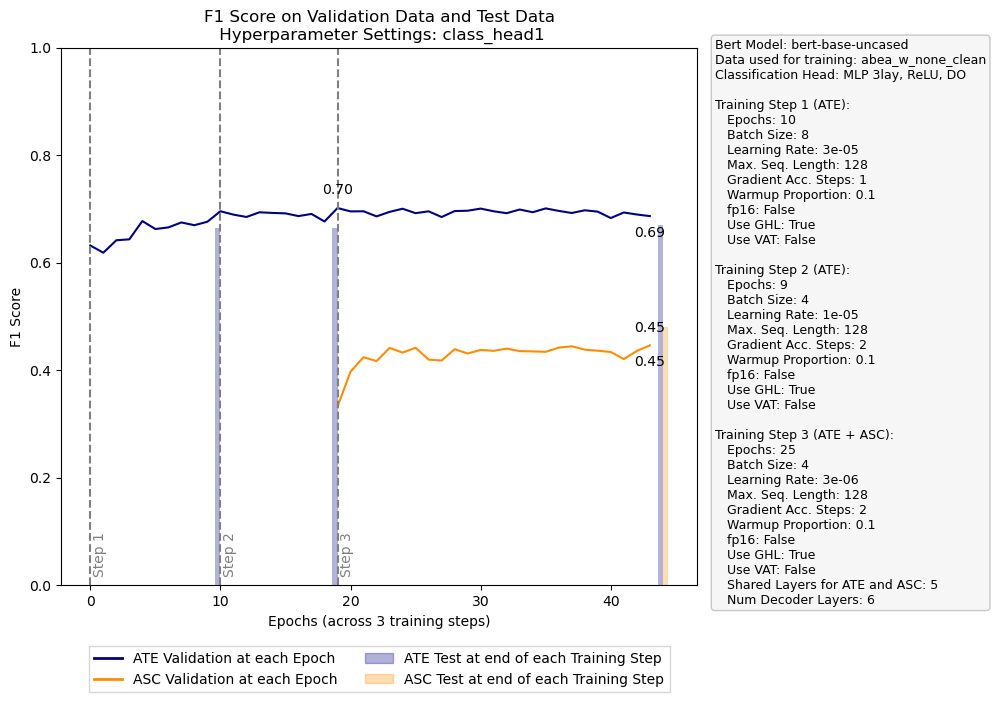

In [52]:
name = 'class_head1'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 24

AT: 68.3 in epoch 23
AS: 42.9 in epoch 24
Test Metrics AT: 66.5
Test Metrics AS: 46.1
F1 Score


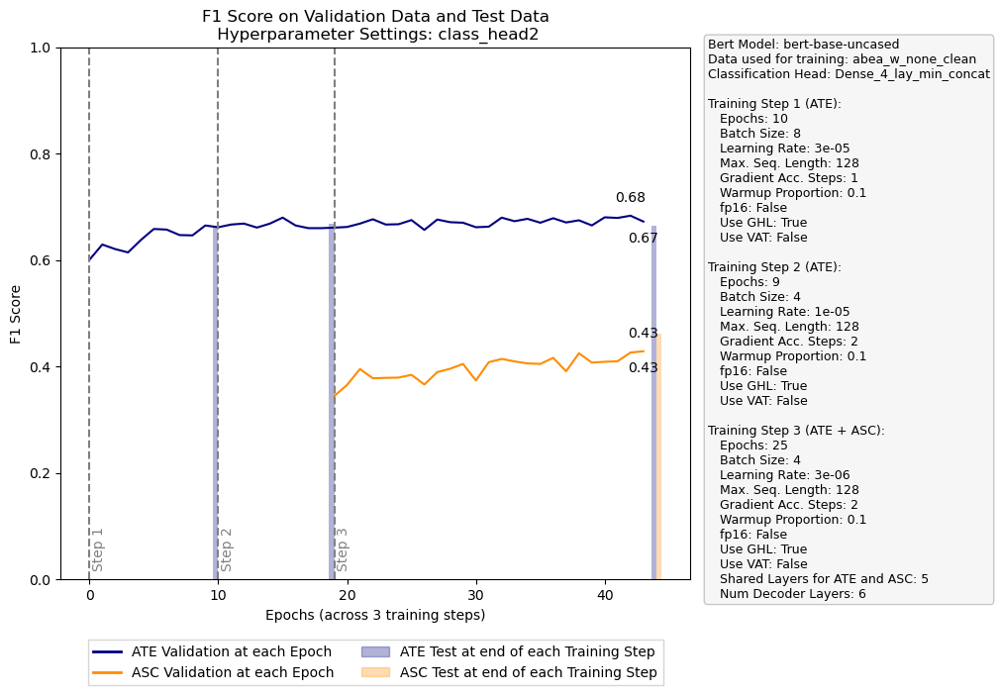

In [22]:
name = 'class_head2'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 24

AT: 68.3 in epoch 14
AS: 44.8 in epoch 19
Test Metrics AT: 66.4
Test Metrics AS: 46.9
F1 Score


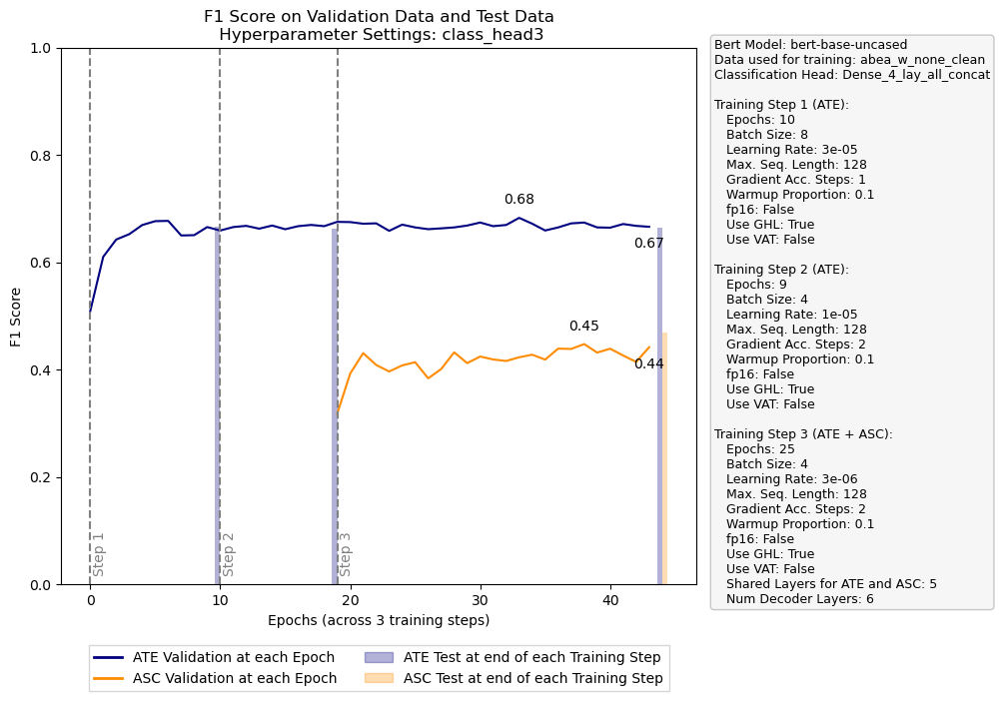

In [65]:
name = 'class_head3'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 19

AT: 67.5 in epoch 12
AS: 43.7 in epoch 17
Test Metrics AT: 66.3
Test Metrics AS: 44.5
F1 Score


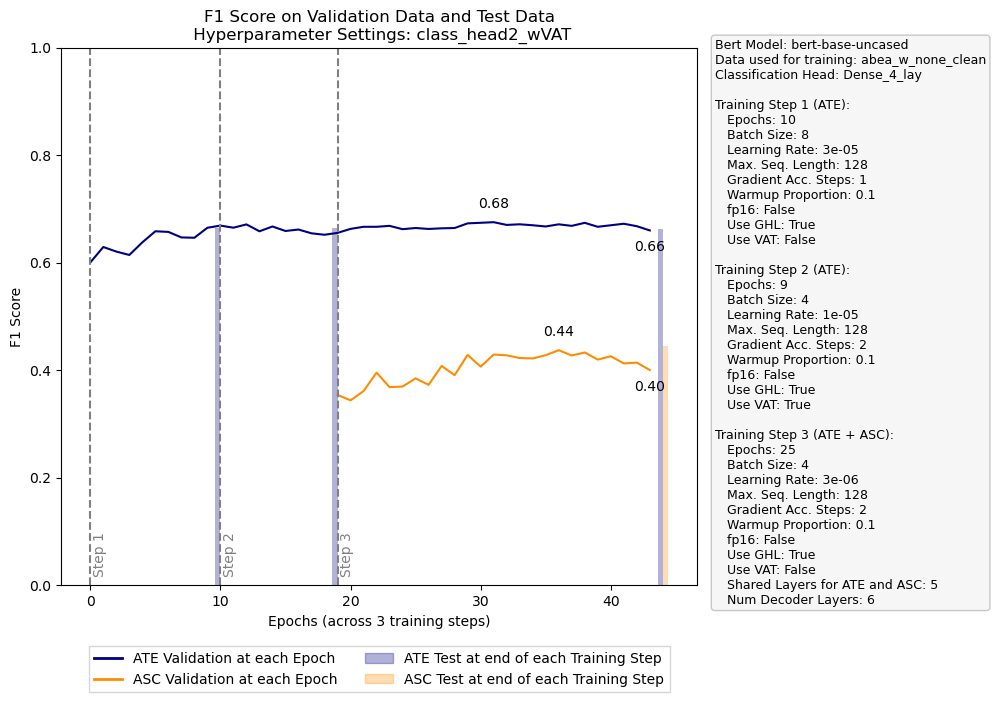

In [71]:
name = 'class_head2_wVAT' # dense 4 layers, minimal concat
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 58.6 in epoch 3
AS: 40.1 in epoch 14
Test Metrics AT: 56.8
Test Metrics AS: 40.7
F1 Score


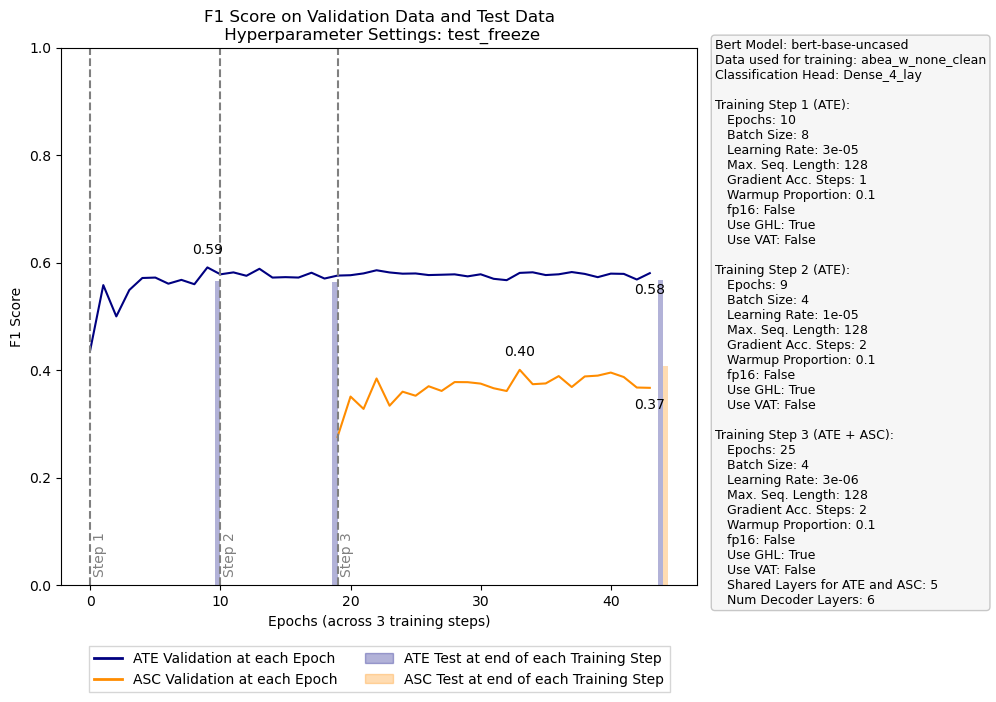

In [89]:
name = 'test_freeze' # freezing bottom 10 layers
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 14

AT: 64.4 in epoch 21
AS: 41.9 in epoch 24
Test Metrics AT: 65.7
Test Metrics AS: 45.2
F1 Score


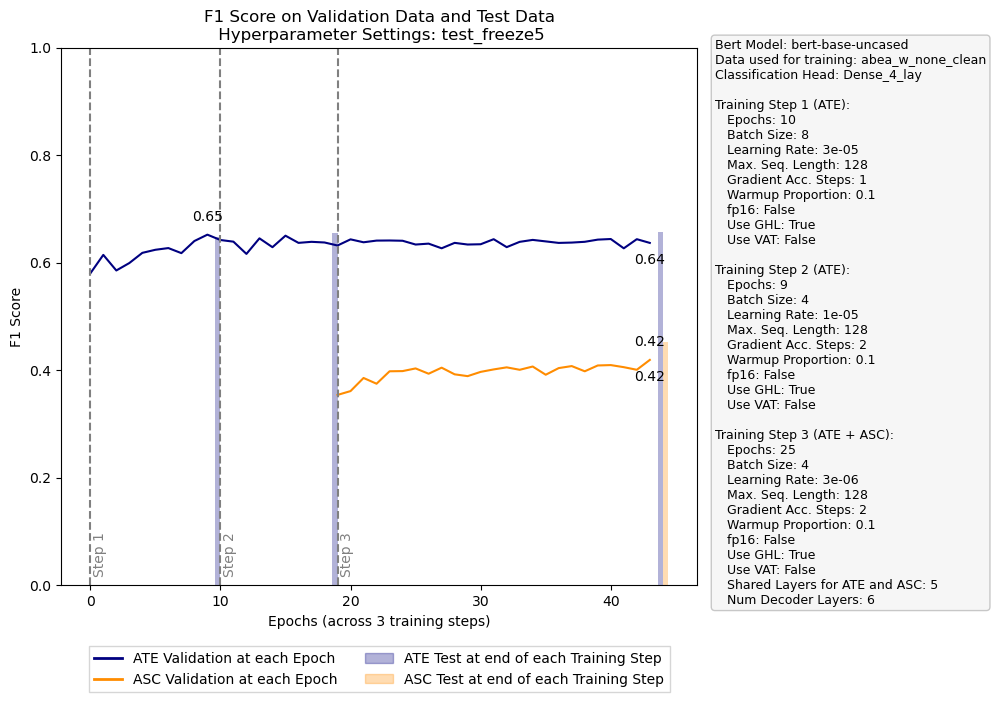

In [96]:
name = 'test_freeze5'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 14

AT: 67.3 in epoch 5
AS: 43.7 in epoch 21
Test Metrics AT: 66.9
Test Metrics AS: 46.4
F1 Score


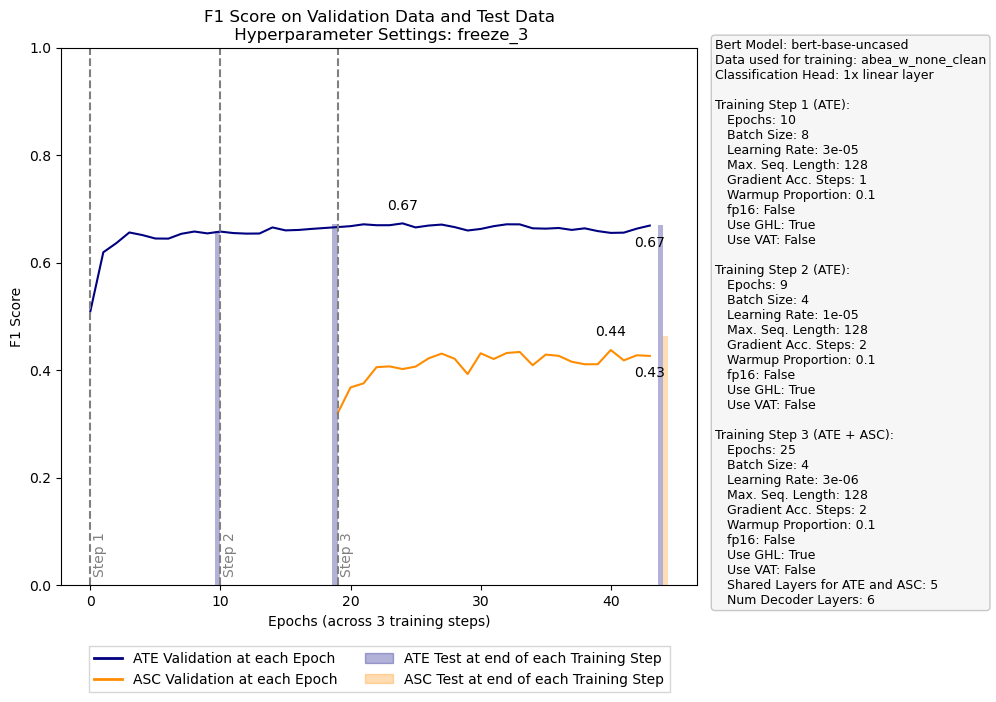

In [17]:
name = 'freeze_3'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 21

AT: 65.3 in epoch 1
AS: 44.7 in epoch 20
Test Metrics AT: 65.9
Test Metrics AS: 45.8
F1 Score


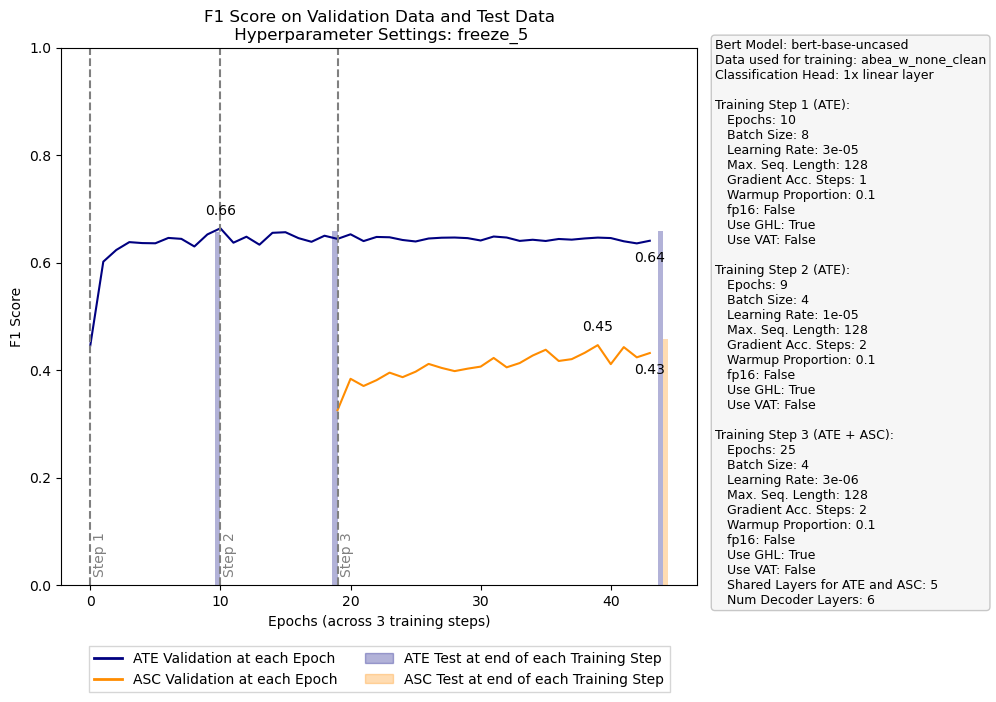

In [23]:
name = 'freeze_5'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 20

AT: 61.1 in epoch 15
AS: 41.5 in epoch 19
Test Metrics AT: 58.1
Test Metrics AS: 40.1
F1 Score


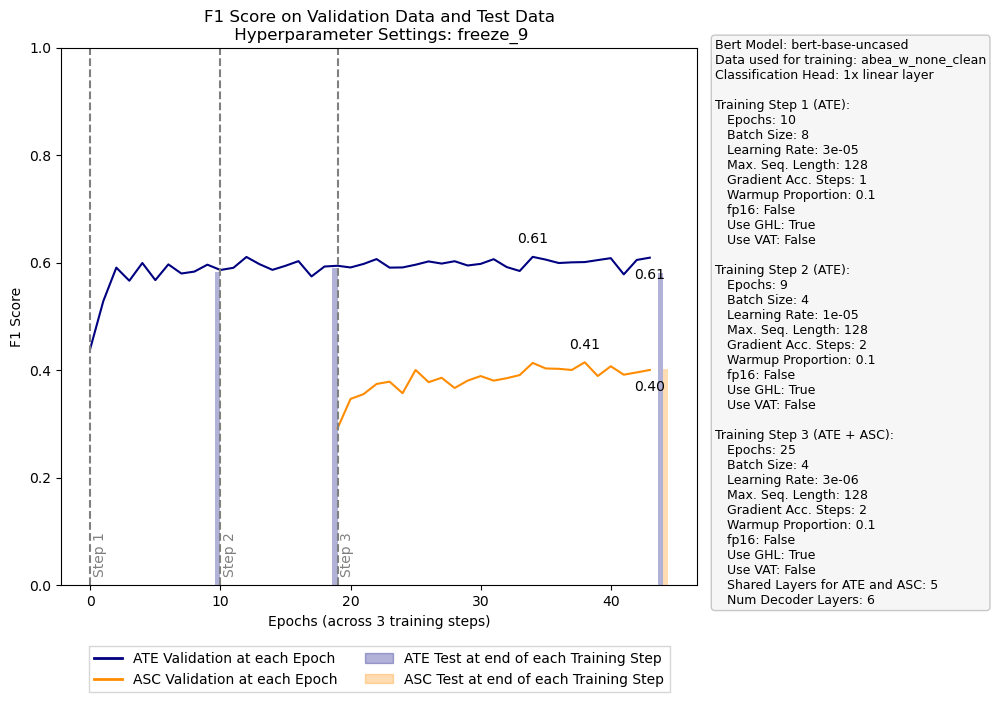

In [30]:
name = 'freeze_9'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 19

AT: 67.1 in epoch 3
AS: 43.1 in epoch 10
Test Metrics AT: 66.9
Test Metrics AS: 45.4
F1 Score


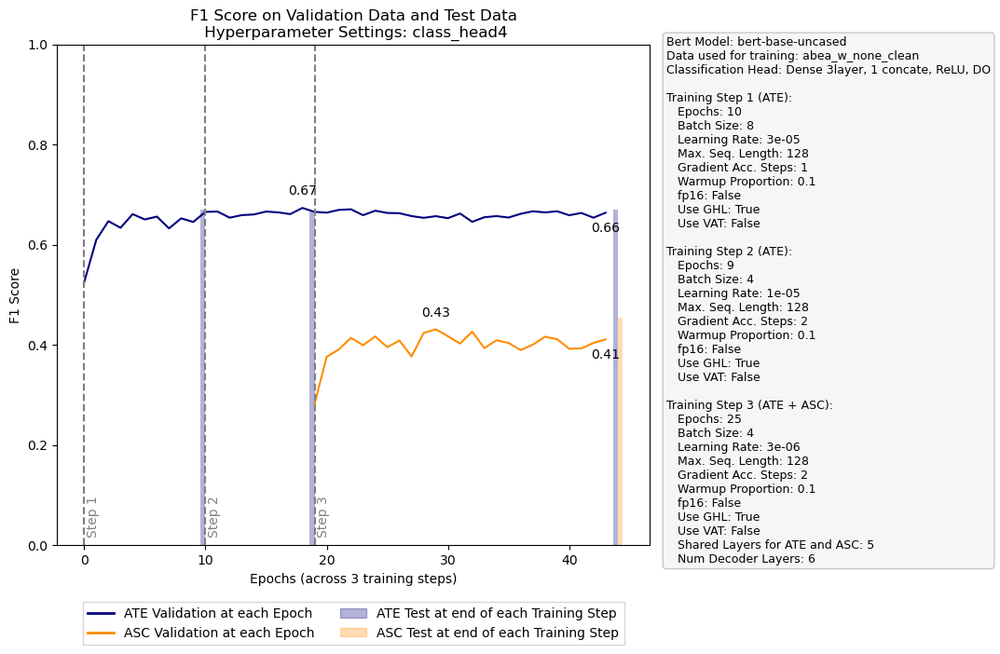

In [38]:
name = 'class_head4'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 10

AT: 68.0 in epoch 2
AS: 44.8 in epoch 18
Test Metrics AT: 67.0
Test Metrics AS: 48.2
F1 Score


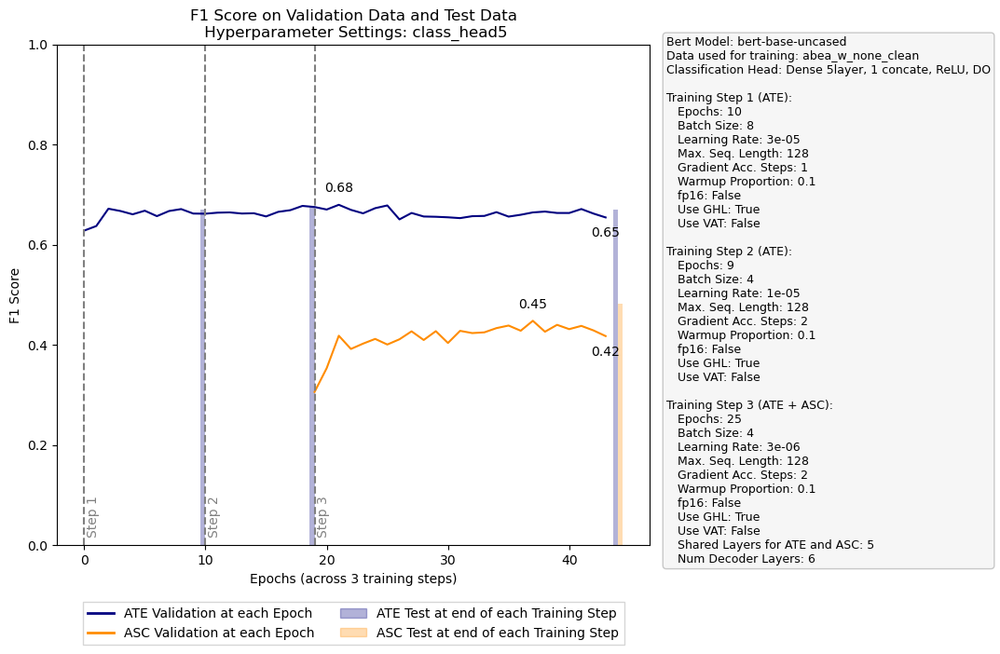

In [50]:
name = 'class_head5'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 18

In [8]:
name = 'ASC_in2and3'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 14

AT: Not found
AS: Not found
Test Metrics AT: Not found
Test Metrics AS: Not found
F1 Score


TypeError: 'NoneType' object is not subscriptable

AT: 66.4 in epoch 13
AS: 42.1 in epoch 7
Test Metrics AT: 66.6
Test Metrics AS: 45.2
F1 Score


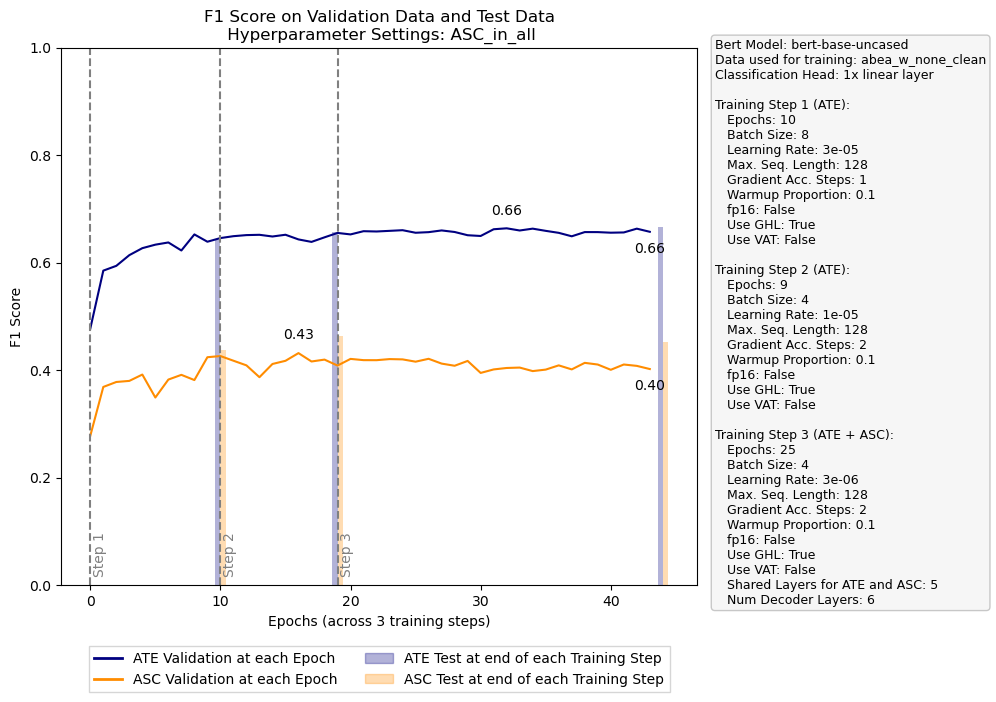

In [85]:
name = 'ASC_in_all'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 7

AT: 68.3 in epoch 23
AS: 42.9 in epoch 24
Test Metrics AT: 66.5
Test Metrics AS: 46.1
F1 Score


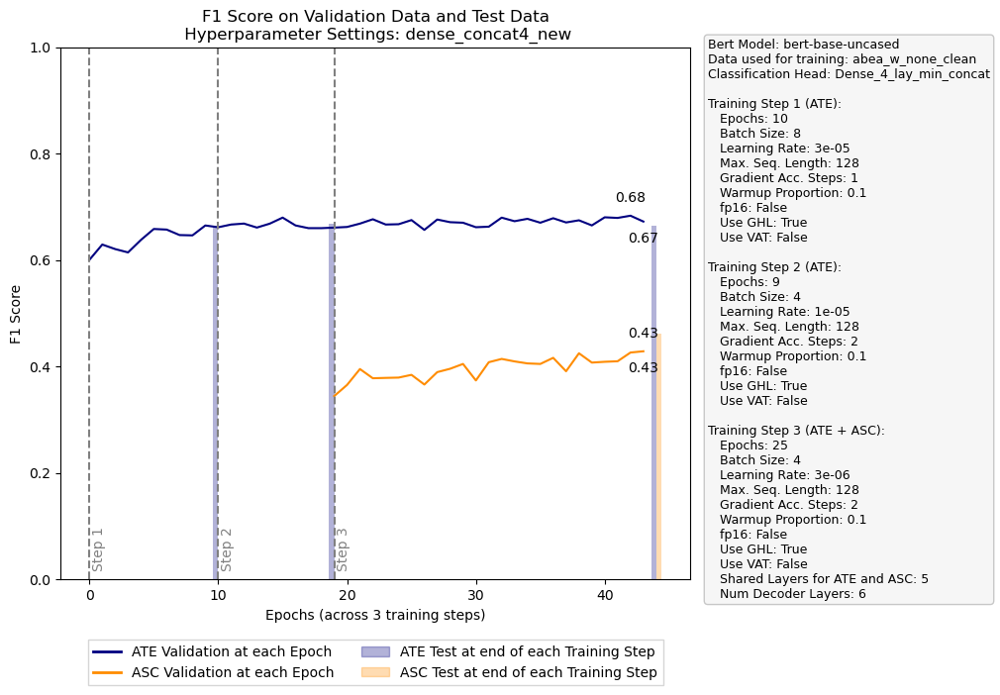

In [25]:
name = 'dense_concat4_new'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 7

AT: 68.2 in epoch 19
AS: 45.2 in epoch 24
Test Metrics AT: 68.3
Test Metrics AS: 48.6
F1 Score


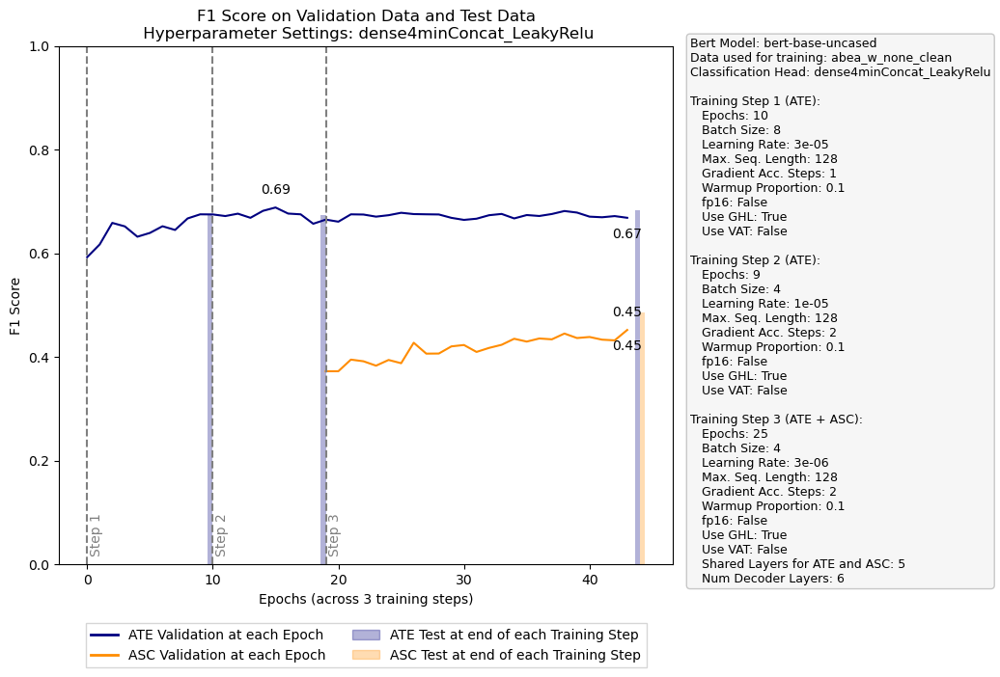

In [47]:
name = 'dense4minConcat_LeakyRelu'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 24

AT: 68.0 in epoch 1
AS: 43.7 in epoch 15
Test Metrics AT: 67.5
Test Metrics AS: 46.3
F1 Score


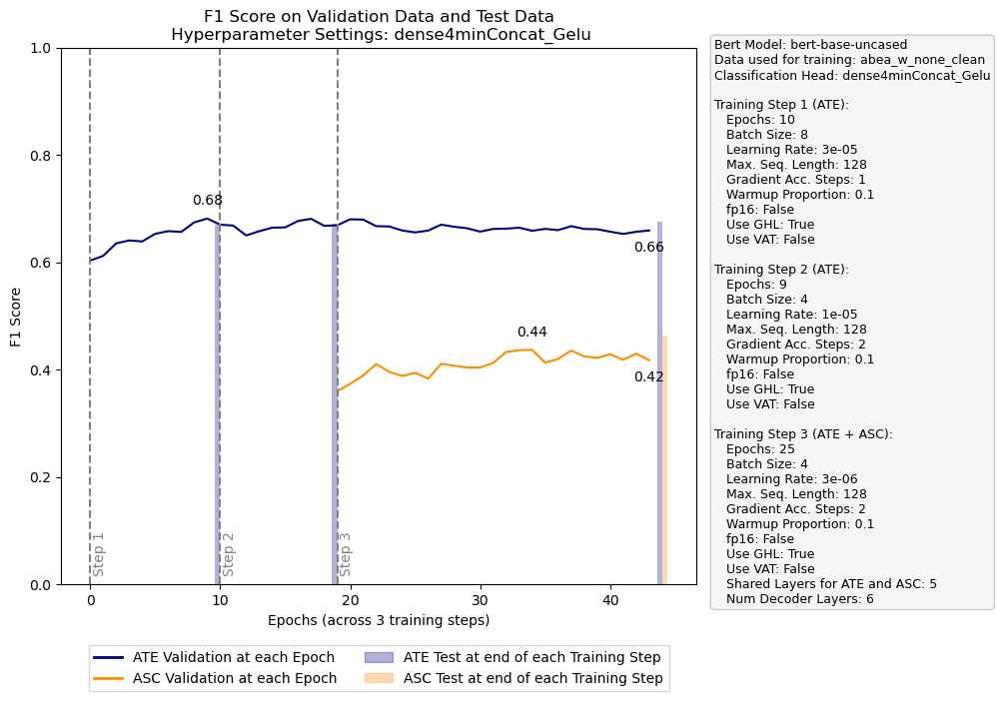

In [61]:
name = 'dense4minConcat_Gelu'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    # 
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 7

AT: 65.9 in epoch 1
AS: 43.8 in epoch 21
Test Metrics AT: 66.2
Test Metrics AS: 46.8
F1 Score


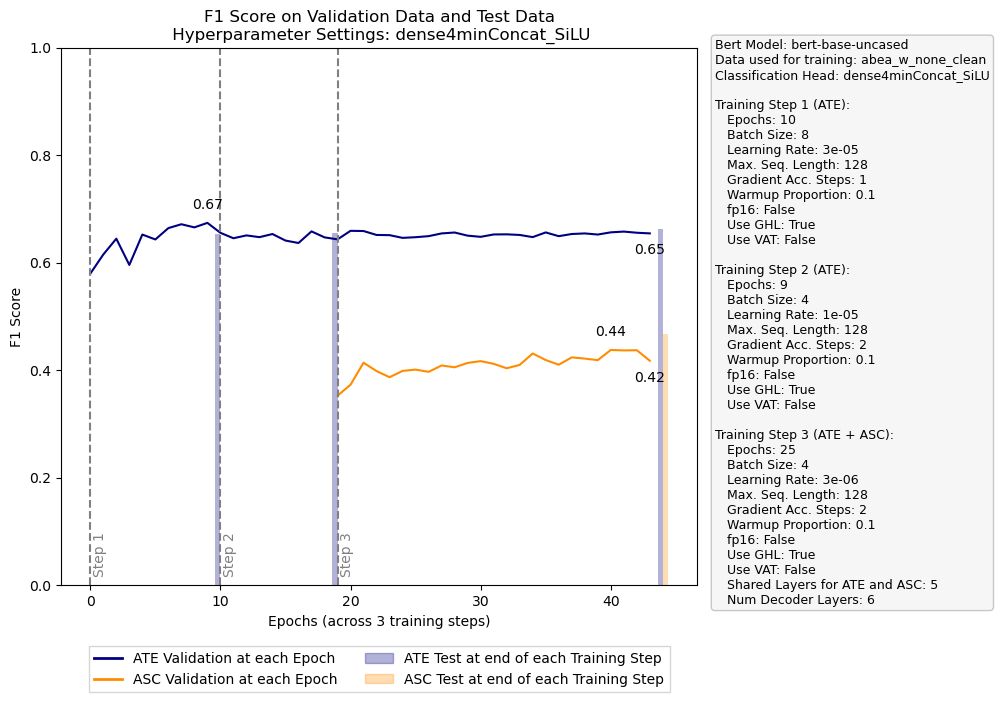

In [66]:
name = 'dense4minConcat_SiLU'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
    # 
with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 7

AT: 68.4 in epoch 7
AS: 45.9 in epoch 17
Test Metrics AT: 66.8
Test Metrics AS: 47.1
F1 Score


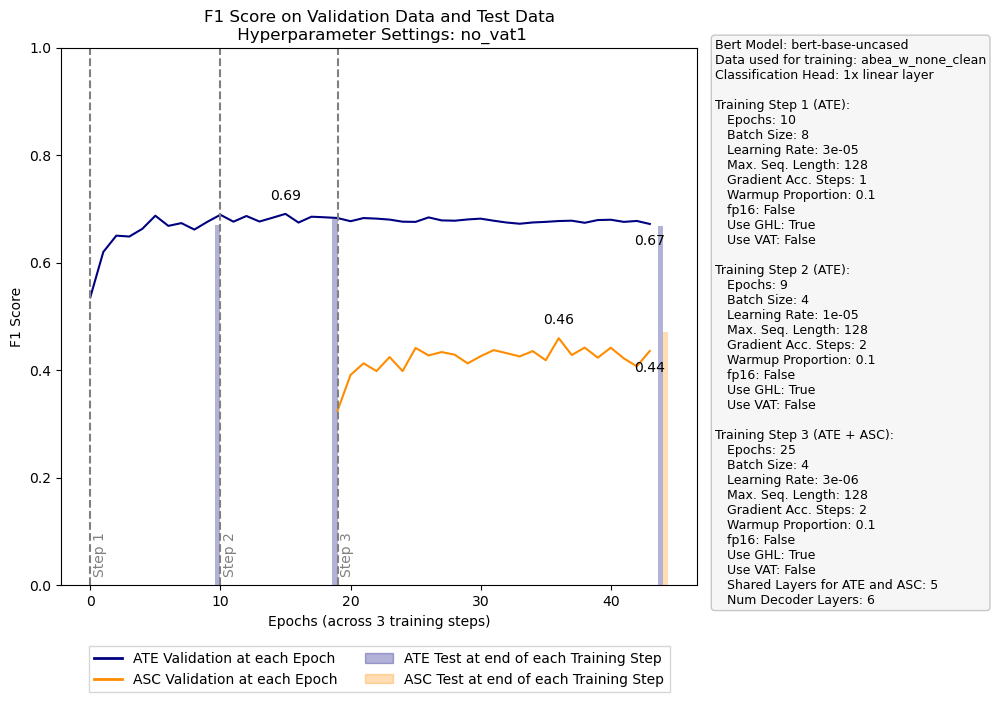

In [15]:
name = 'no_vat1'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 67.4 in epoch 2
AS: 43.6 in epoch 21
Test Metrics AT: 67.0
Test Metrics AS: 46.1
F1 Score


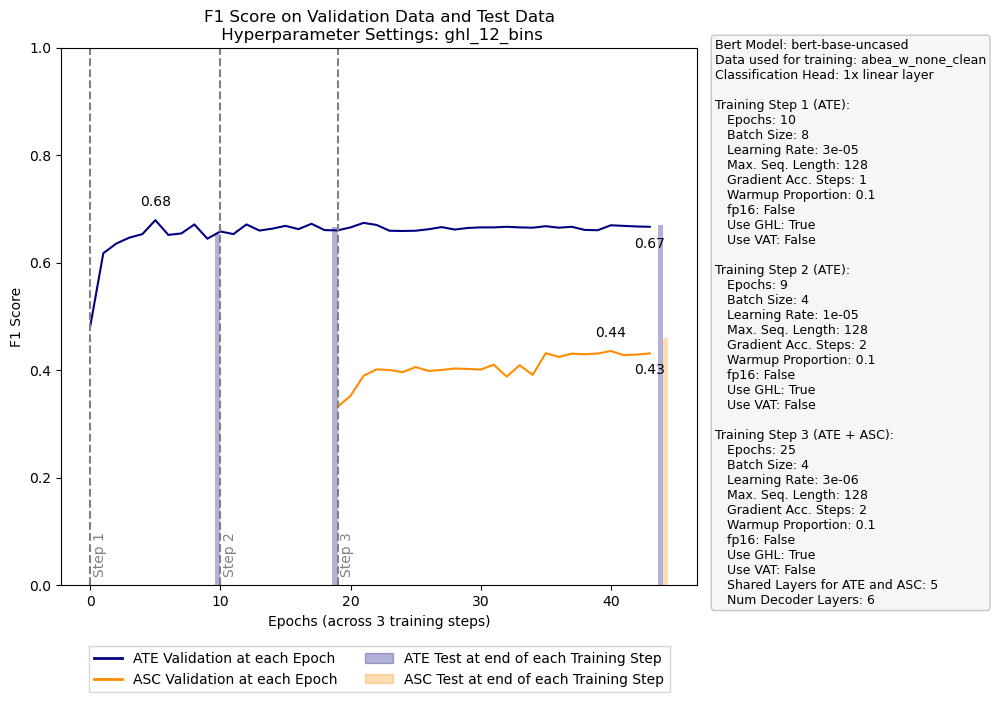

In [6]:
name = 'ghl_12_bins'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 21

AT: 67.3 in epoch 5
AS: 45.5 in epoch 9
Test Metrics AT: 66.7
Test Metrics AS: 47.0
F1 Score


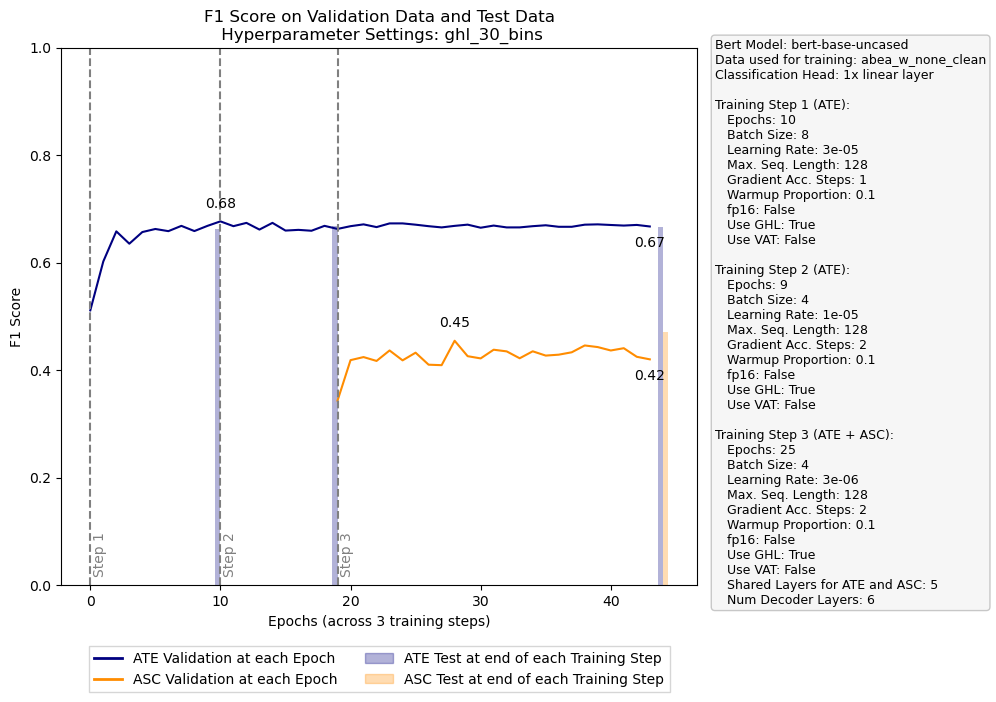

In [29]:
name = 'ghl_30_bins'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 9

AT: 66.9 in epoch 3
AS: 43.9 in epoch 15
Test Metrics AT: 67.0
Test Metrics AS: 46.8
F1 Score


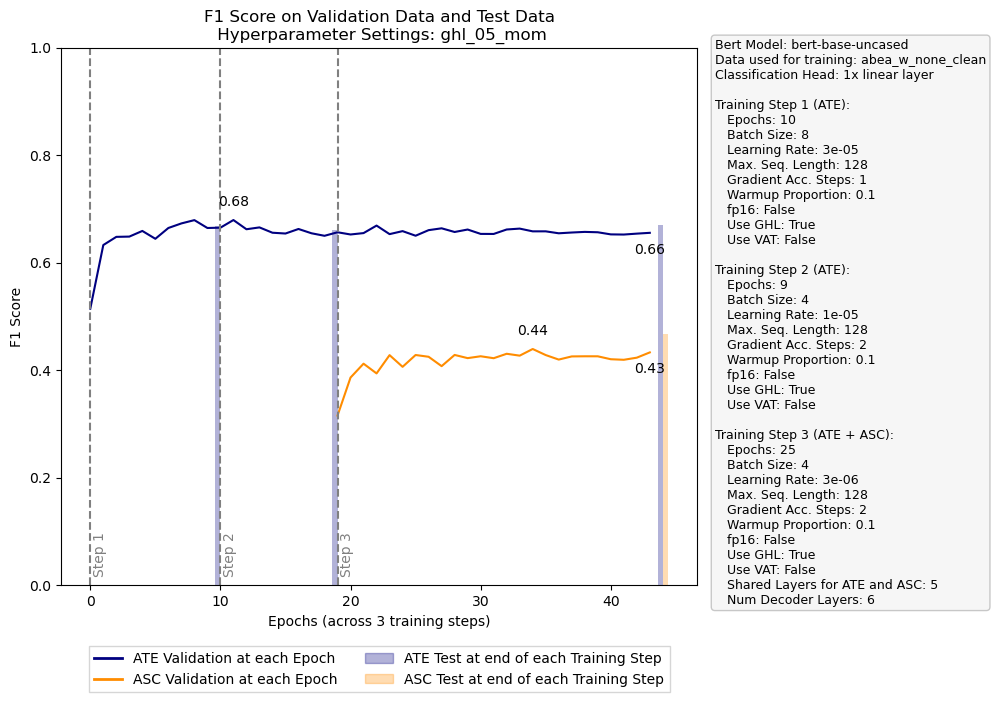

In [12]:
name = 'ghl_05_mom'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 15

AT: 66.9 in epoch 9
AS: 45.5 in epoch 20
Test Metrics AT: 66.5
Test Metrics AS: 46.8
F1 Score


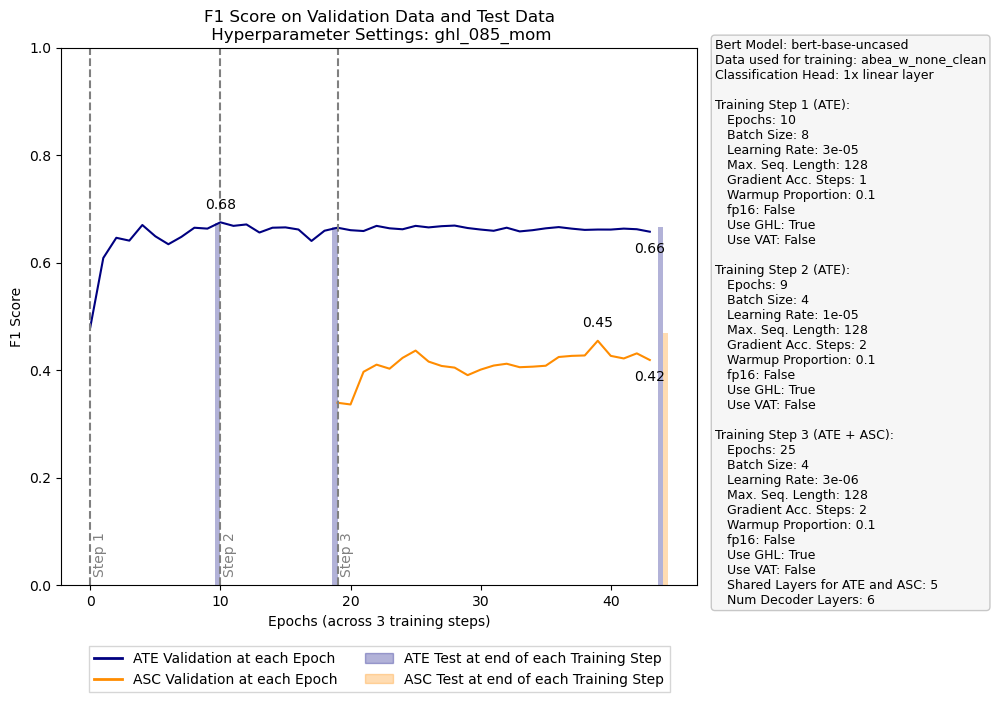

In [20]:
name = 'ghl_085_mom'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 20

0
AT: 67.0 in epoch 3
AS: 47.8 in epoch 5
Test Metrics AT: 64.6
Test Metrics AS: 43.8

F1 Score


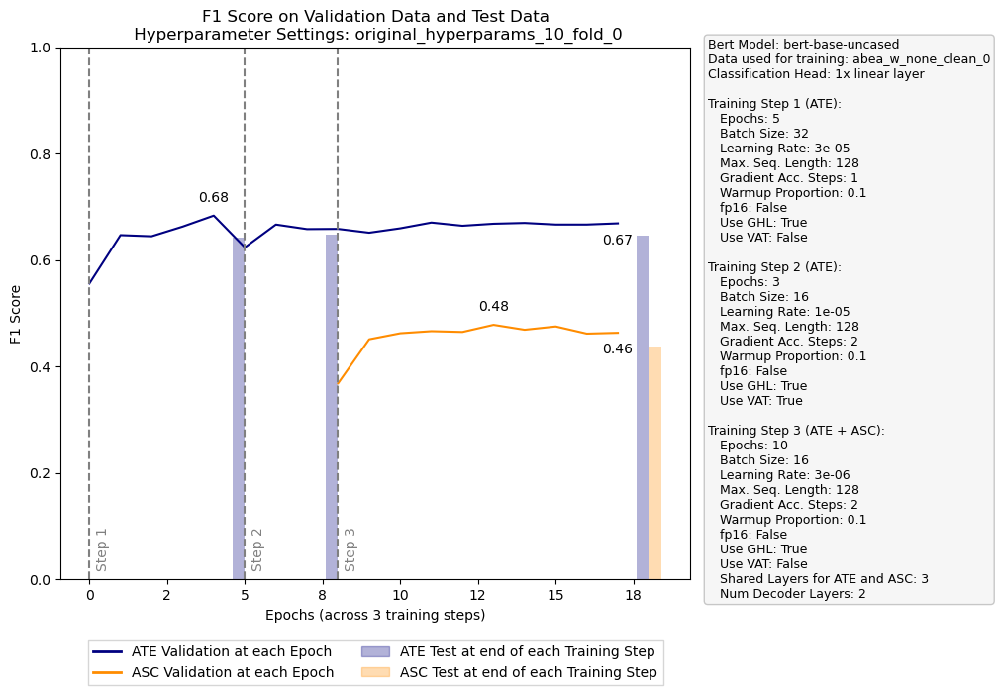

1
AT: 64.0 in epoch 0
AS: 41.9 in epoch 6
Test Metrics AT: 65.2
Test Metrics AS: 44.7

F1 Score


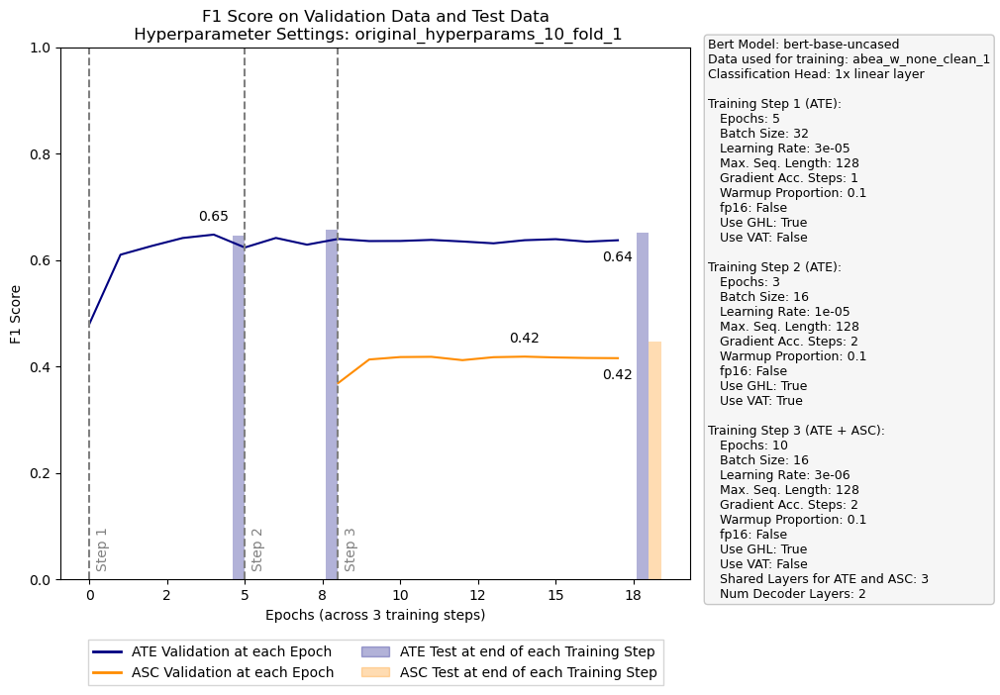

2
AT: 66.7 in epoch 1
AS: 45.4 in epoch 9
Test Metrics AT: 64.6
Test Metrics AS: 44.2

F1 Score


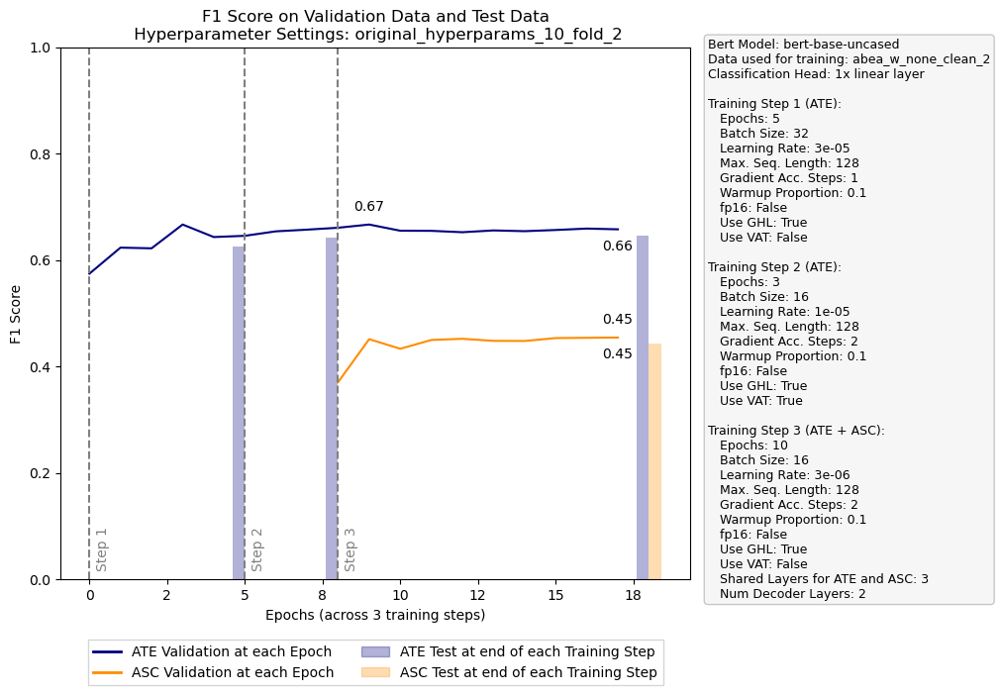

3
AT: 69.3 in epoch 8
AS: 46.6 in epoch 8
Test Metrics AT: 65.4
Test Metrics AS: 46.1

F1 Score


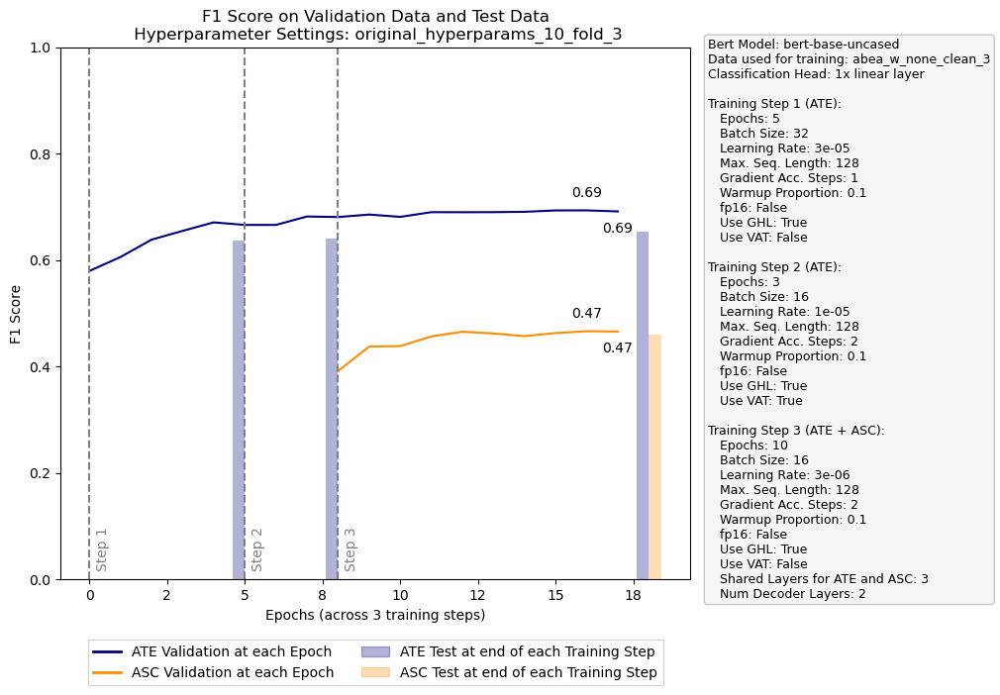

4
AT: 63.8 in epoch 4
AS: 45.3 in epoch 4
Test Metrics AT: 65.7
Test Metrics AS: 47.9

F1 Score


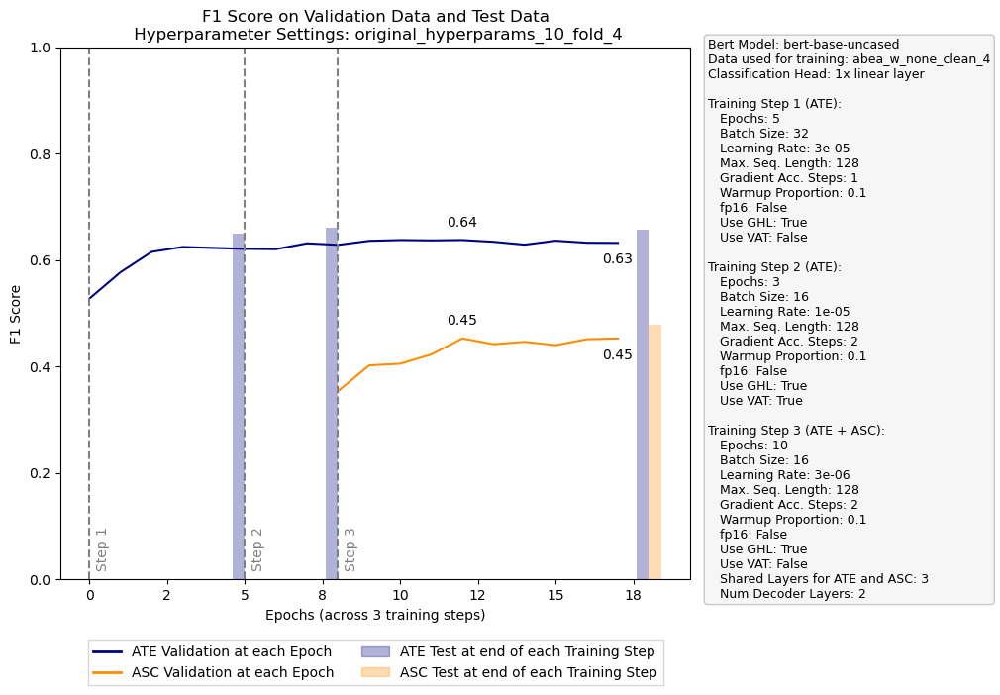

5
AT: 65.3 in epoch 1
AS: 49.9 in epoch 1
Test Metrics AT: 64.9
Test Metrics AS: 43.0

F1 Score


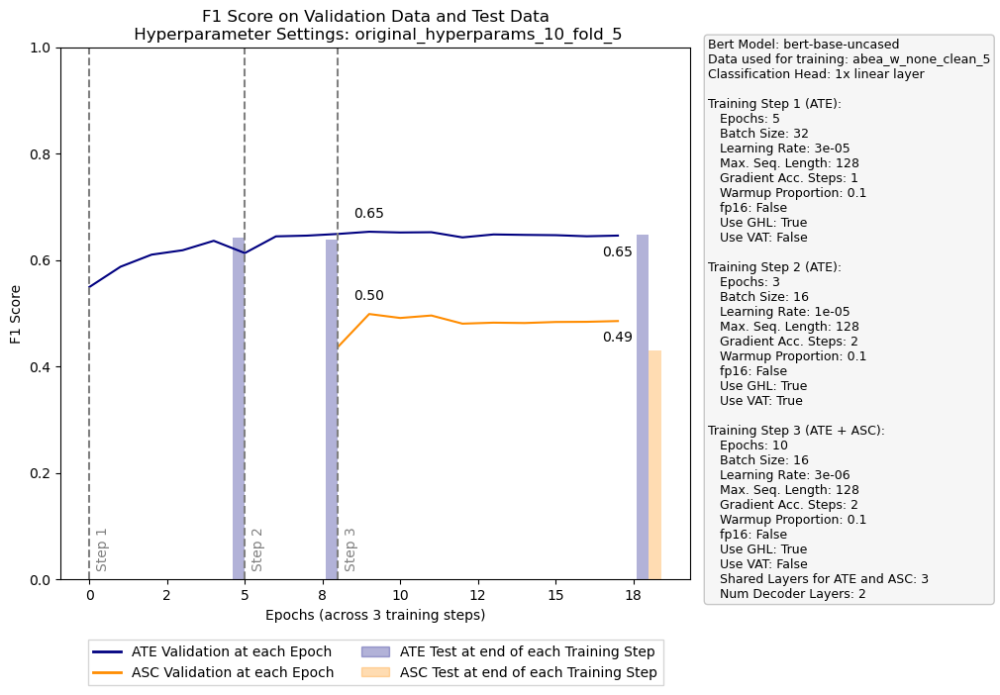

6
AT: 65.6 in epoch 4
AS: 44.1 in epoch 3
Test Metrics AT: 62.3
Test Metrics AS: 40.8

F1 Score


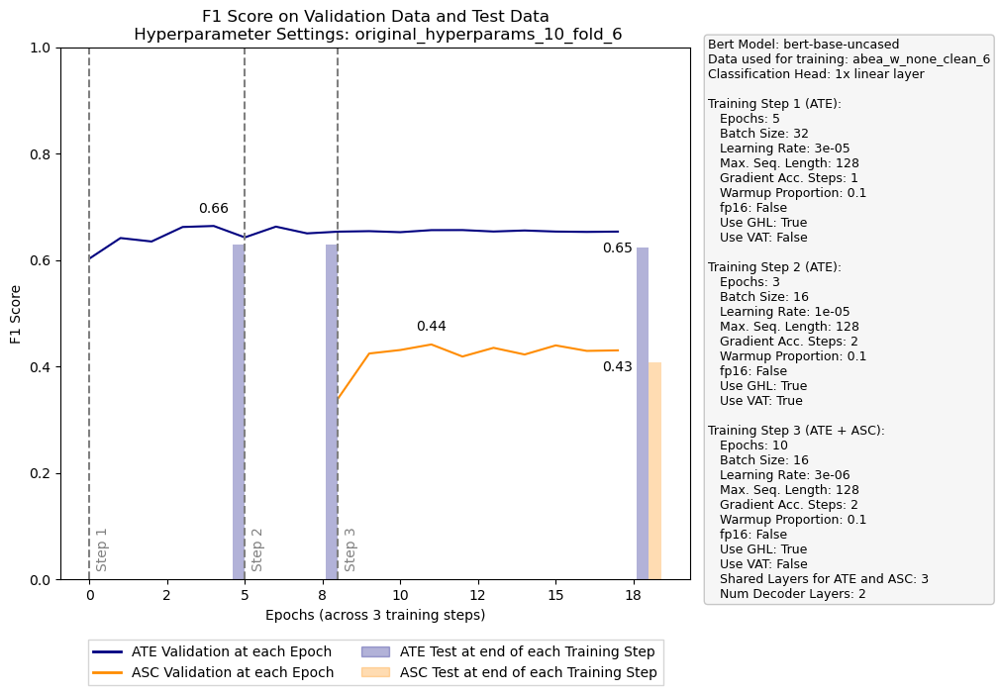

7
AT: 66.2 in epoch 9
AS: 45.0 in epoch 2
Test Metrics AT: 65.6
Test Metrics AS: 45.9

F1 Score


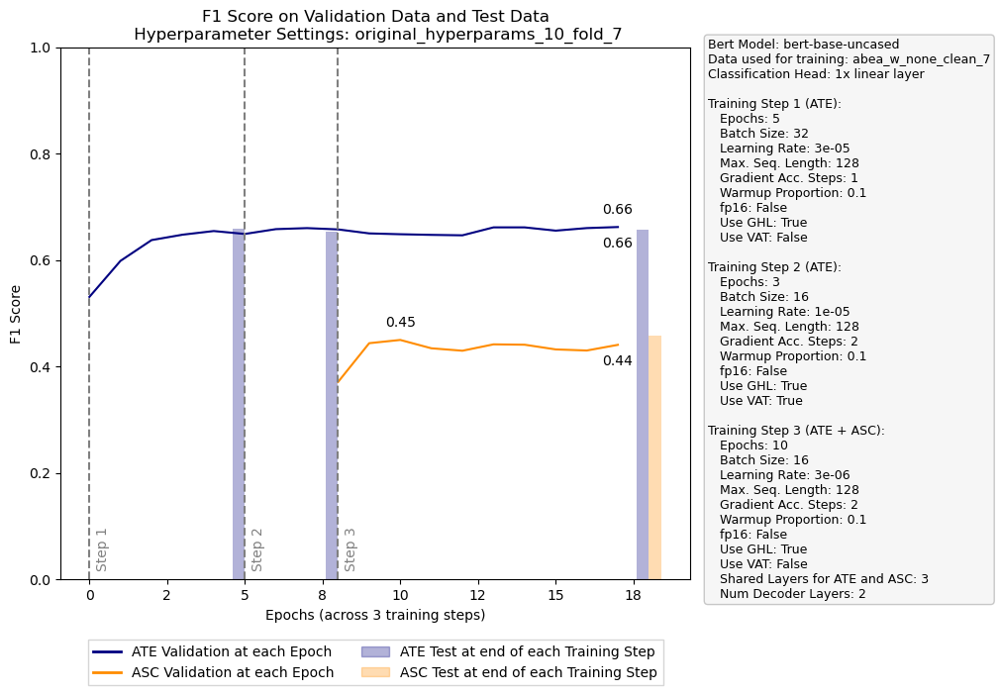

8
AT: 64.4 in epoch 3
AS: 43.6 in epoch 4
Test Metrics AT: 65.6
Test Metrics AS: 45.6

F1 Score


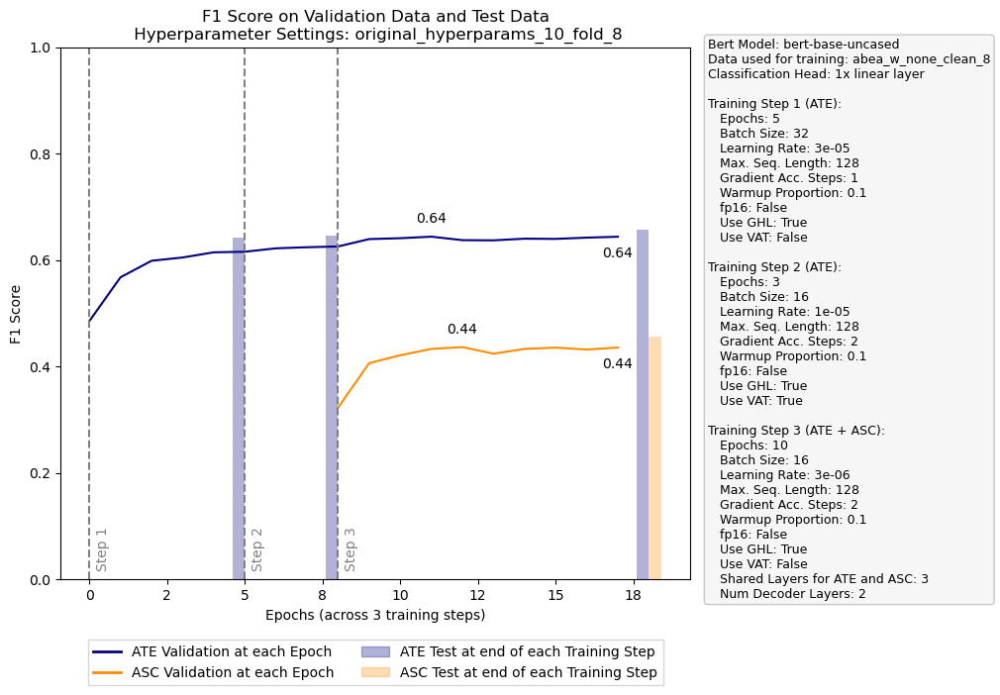

9
AT: 67.4 in epoch 1
AS: 46.5 in epoch 4
Test Metrics AT: 65.2
Test Metrics AS: 42.1

F1 Score


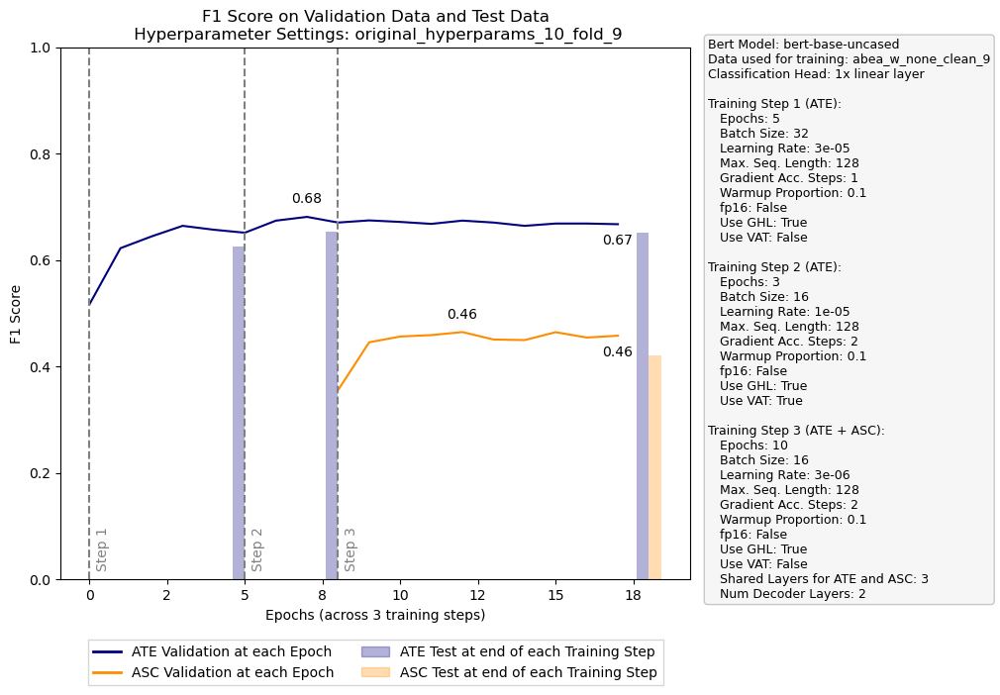

In [17]:
for i in range(10):
    name = f'original_hyperparams_10_fold_{i}'
    file = 'GRACE/training_performance.json'
    metric = "f1_score"

    print(i)
    extract_highest_f1_score(file, name, metric)
    print(f"")

    with open(file, 'r') as f:
        data = json.load(f)

    data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
    create_performance_chart(data_to_plot, metric, name)

    # epoch 17

0
AT: 70.3 in epoch 12
AS: 49.3 in epoch 18
Test Metrics AT: 68.4
Test Metrics AS: 46.6

F1 Score


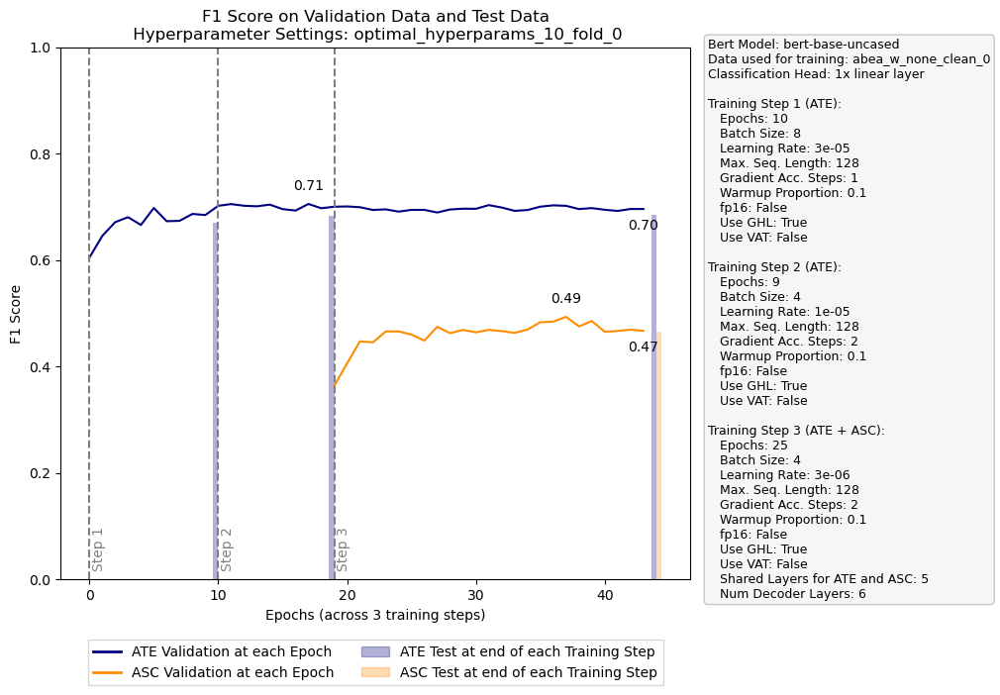

1
AT: 67.7 in epoch 1
AS: 44.9 in epoch 12
Test Metrics AT: 67.2
Test Metrics AS: 45.3

F1 Score


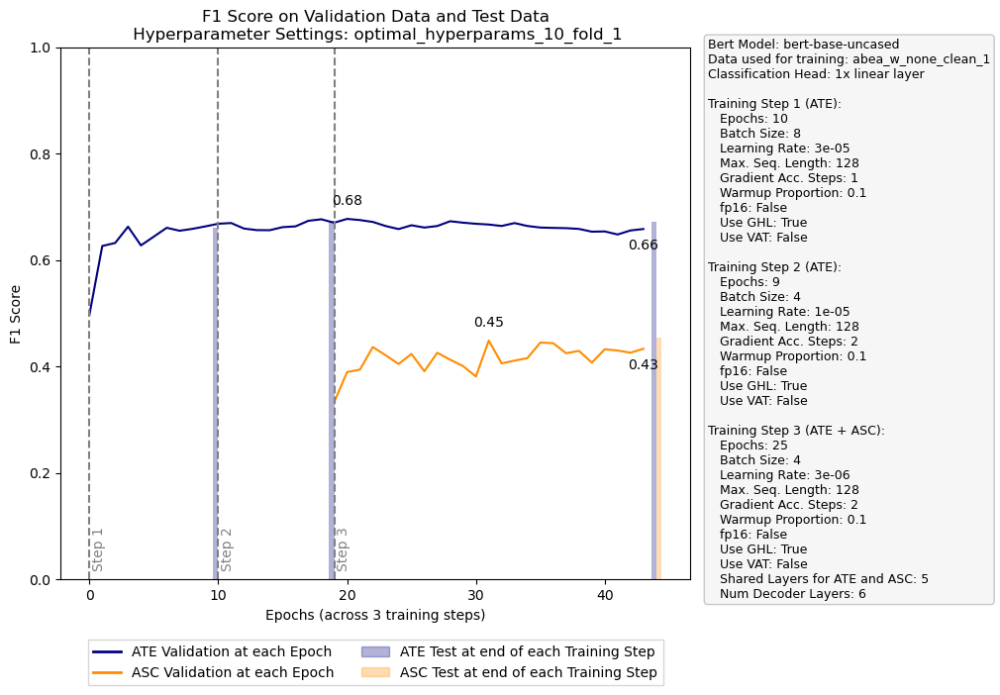

2
AT: 71.2 in epoch 20
AS: 52.3 in epoch 19
Test Metrics AT: 68.6
Test Metrics AS: 49.6

F1 Score


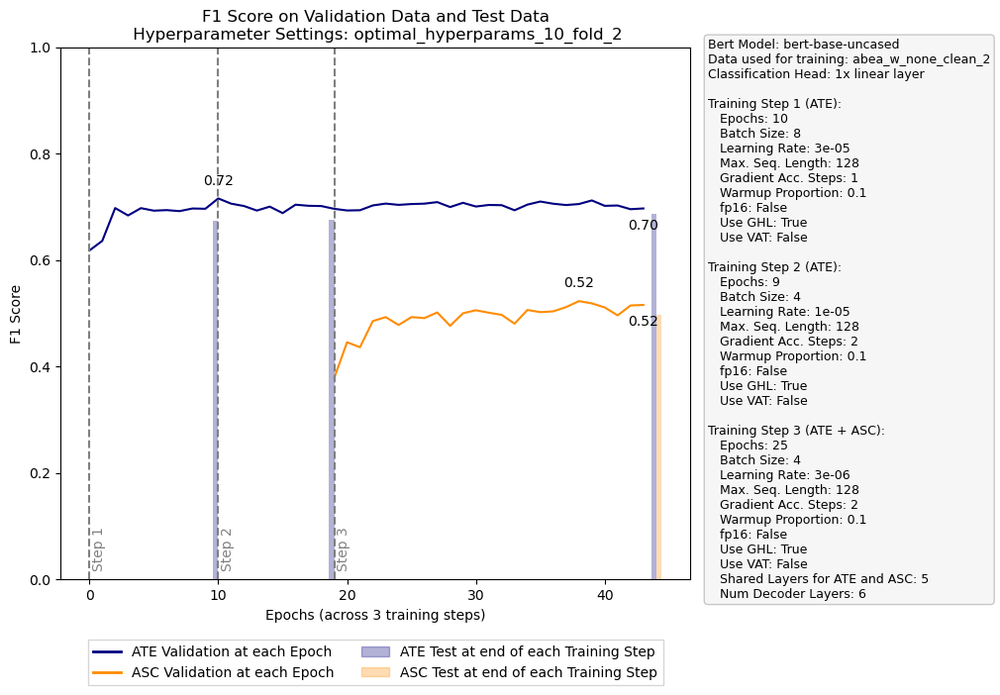

3
AT: 71.5 in epoch 3
AS: 49.6 in epoch 13
Test Metrics AT: 67.1
Test Metrics AS: 45.5

F1 Score


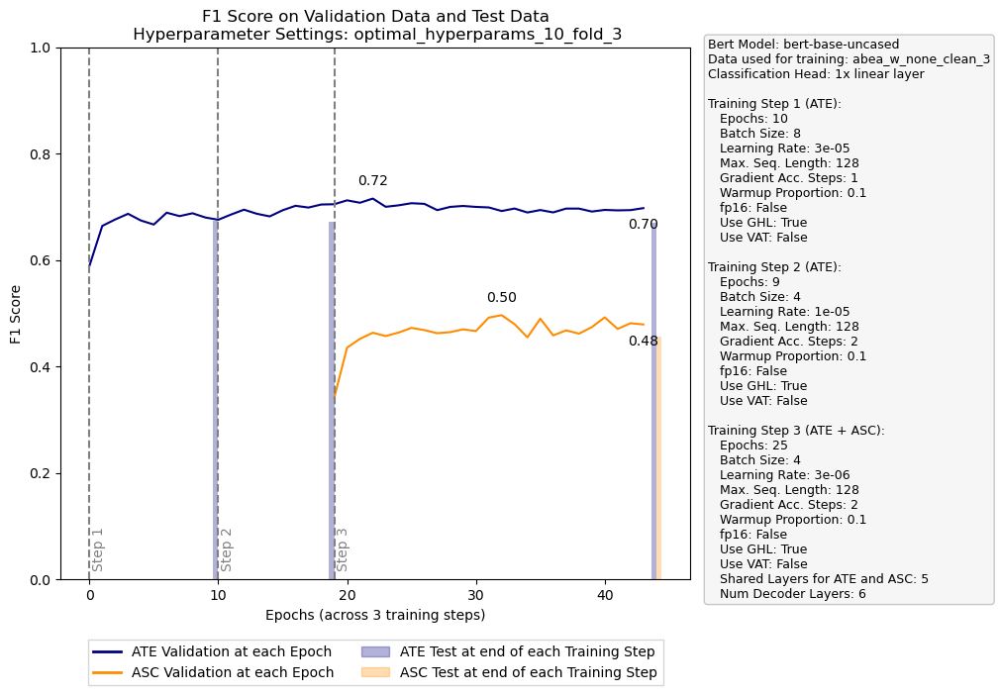

4
AT: 69.0 in epoch 22
AS: 45.7 in epoch 13
Test Metrics AT: 67.7
Test Metrics AS: 46.6

F1 Score


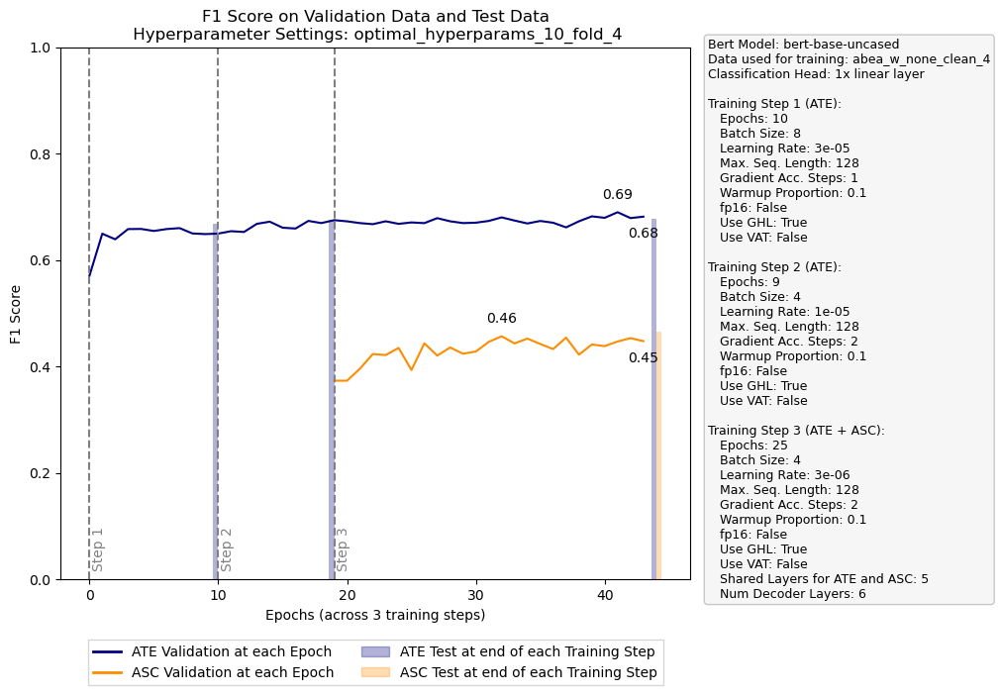

5
AT: 64.5 in epoch 5
AS: 47.7 in epoch 10
Test Metrics AT: 67.2
Test Metrics AS: 41.9

F1 Score


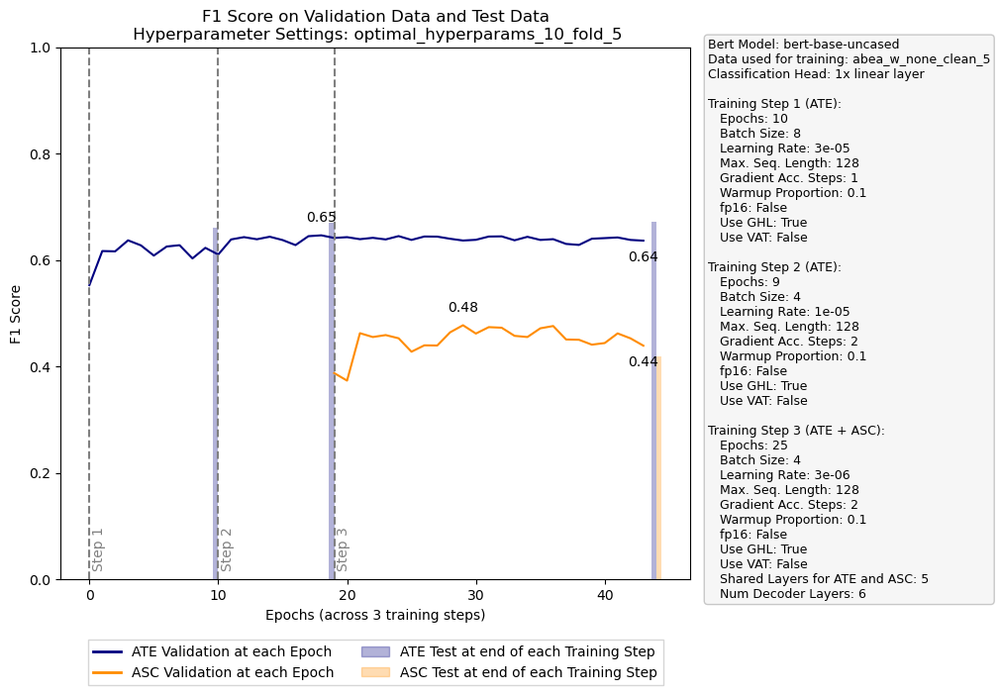

6
AT: 71.4 in epoch 14
AS: 47.2 in epoch 23
Test Metrics AT: 66.2
Test Metrics AS: 41.0

F1 Score


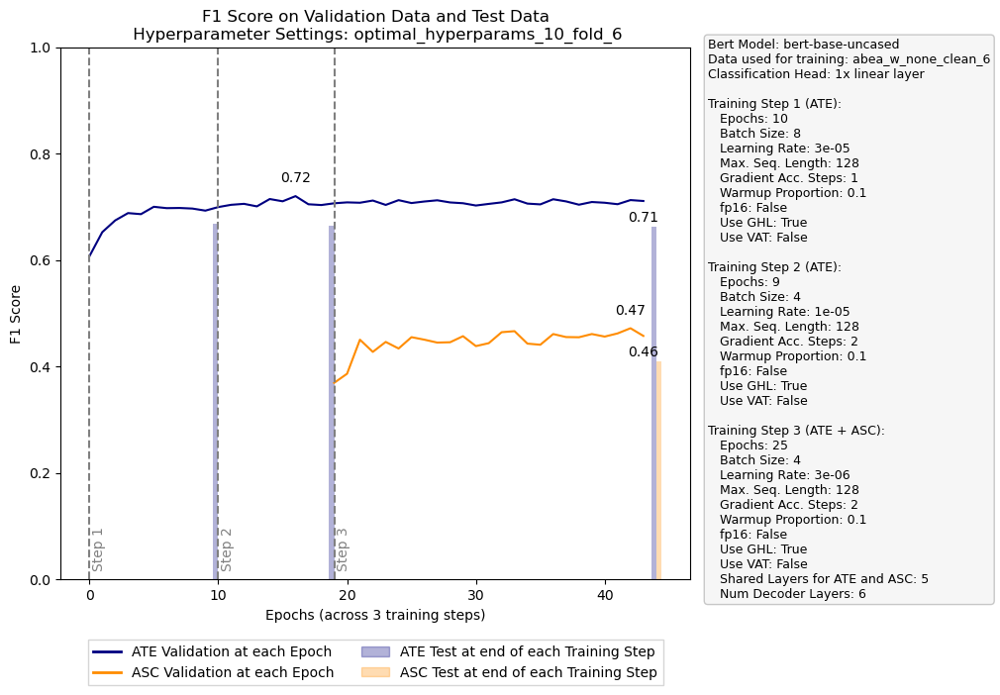

7
AT: 69.8 in epoch 5
AS: 46.7 in epoch 15
Test Metrics AT: 66.7
Test Metrics AS: 43.4

F1 Score


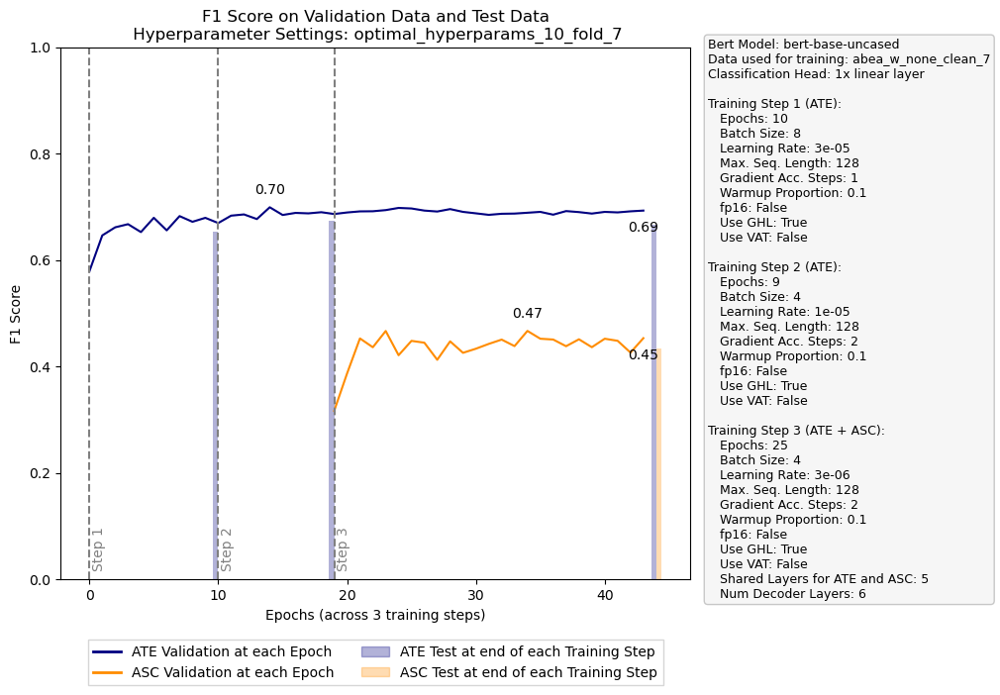

8
AT: 63.2 in epoch 5
AS: 43.1 in epoch 17
Test Metrics AT: 67.0
Test Metrics AS: 44.4

F1 Score


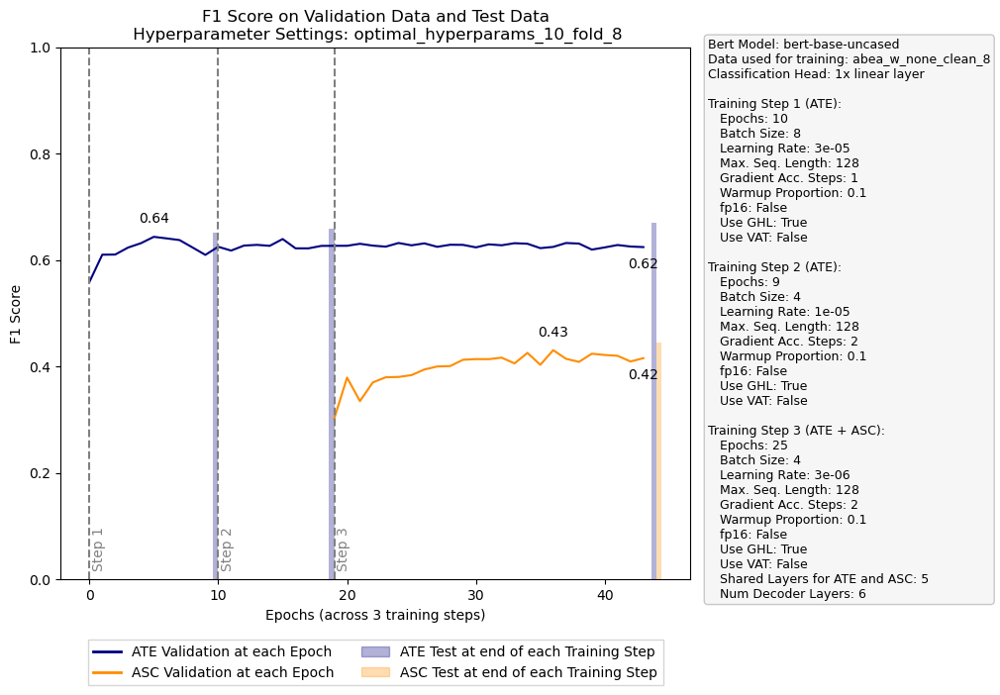

9
AT: 70.9 in epoch 20
AS: 49.0 in epoch 24
Test Metrics AT: 67.6
Test Metrics AS: 46.9

F1 Score


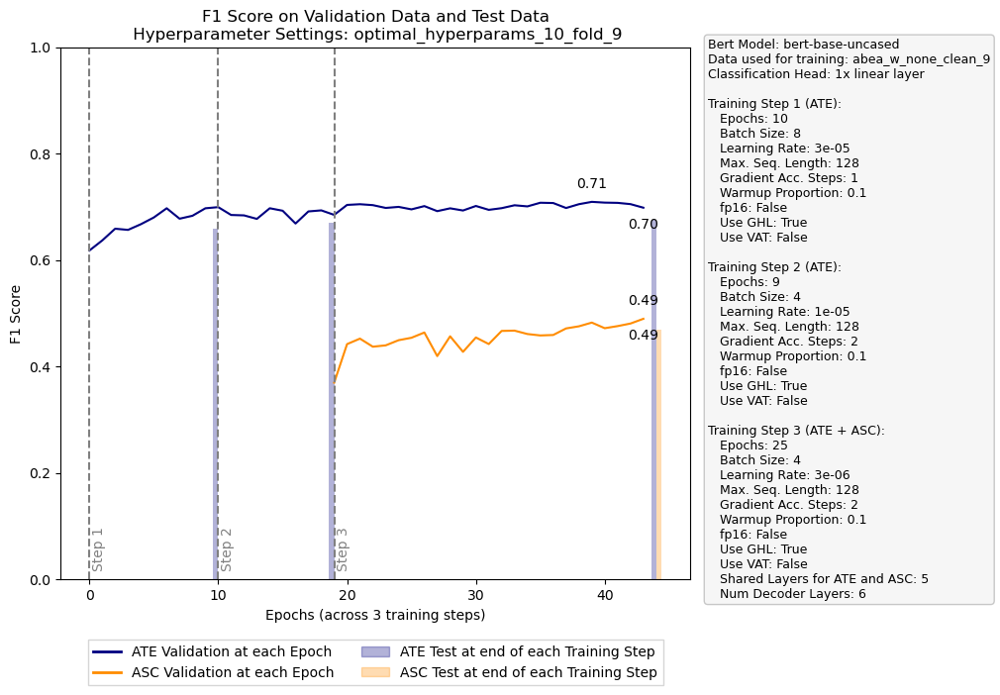

In [18]:
for i in range(10):
    name = f'optimal_hyperparams_10_fold_{i}'
    file = 'GRACE/training_performance.json'
    metric = "f1_score"

    print(i)
    extract_highest_f1_score(file, name, metric)
    print(f"")

    with open(file, 'r') as f:
        data = json.load(f)

    data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
    create_performance_chart(data_to_plot, metric, name)

9
AT: 74.6 in epoch 4
AS: 55.7 in epoch 8
Test Metrics AT: 73.4
Test Metrics AS: 55.0

F1 Score


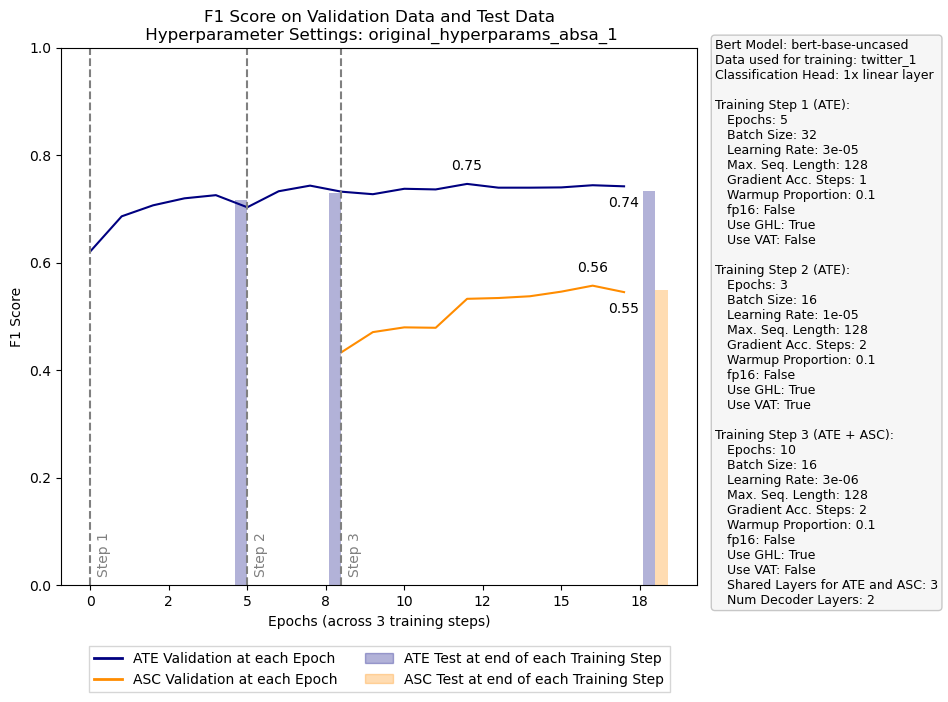

In [28]:
name = f'original_hyperparams_absa_1'
file = 'GRACE/training_performance.json'
metric = "f1_score"

print(i)
extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

AT: 69.9 in epoch 1
AS: 45.4 in epoch 14
Test Metrics AT: 65.8
Test Metrics AS: 45.6

F1 Score


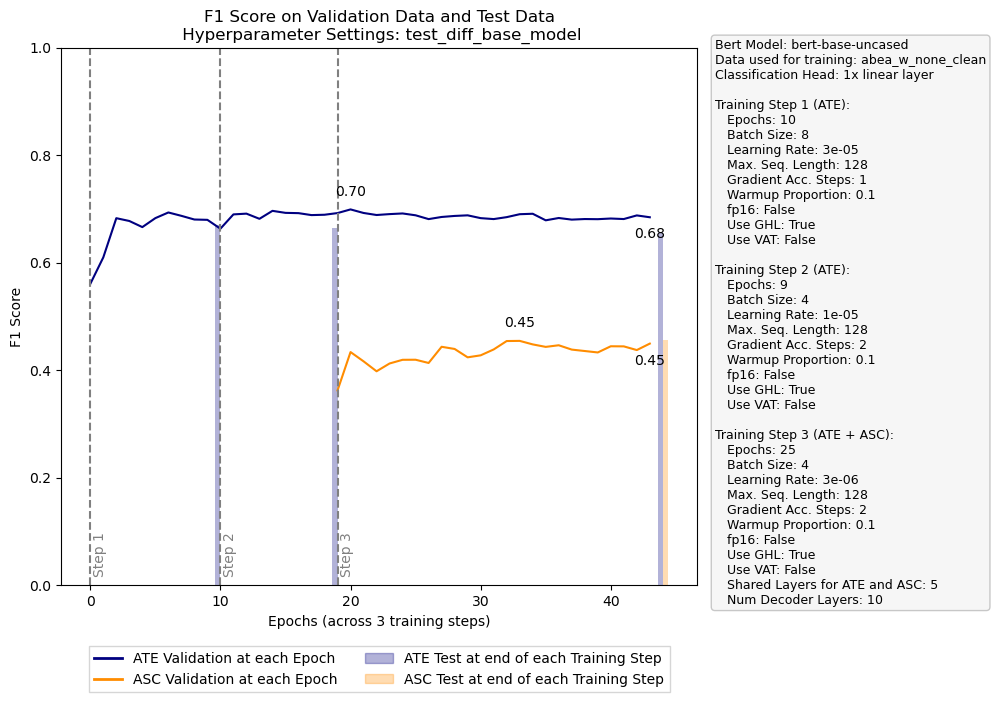

In [52]:
name = f'test_diff_base_model'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

F1 Score


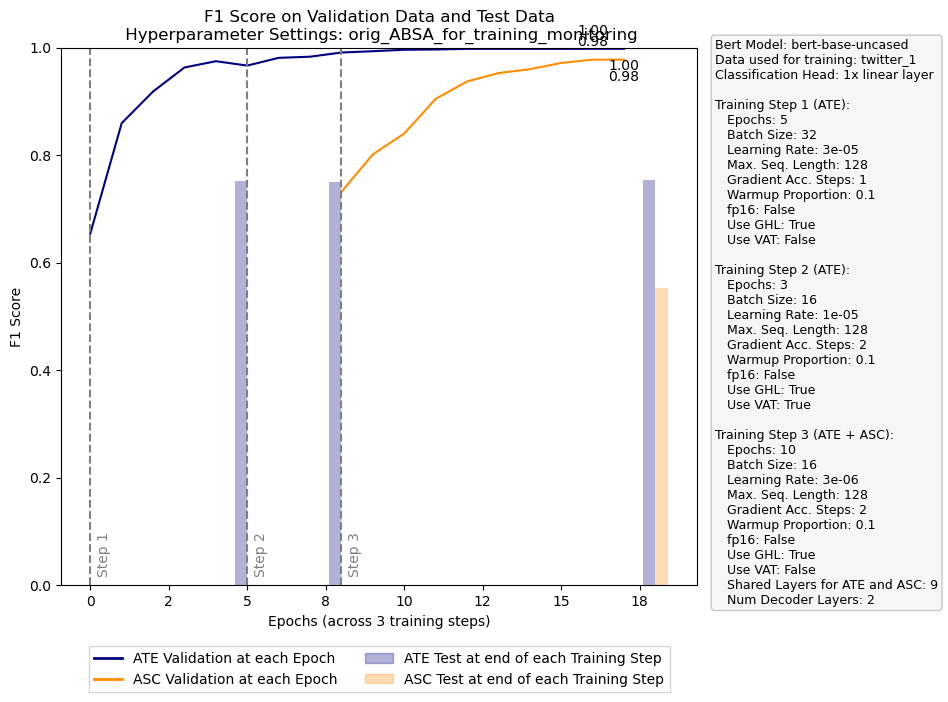

In [19]:
name = f'orig_ABSA_for_training_monitoring'
file = 'GRACE/training_performance.json'
metric = "f1_score"

# print(i)
# extract_highest_f1_score(file, name, metric)
# print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

F1 Score


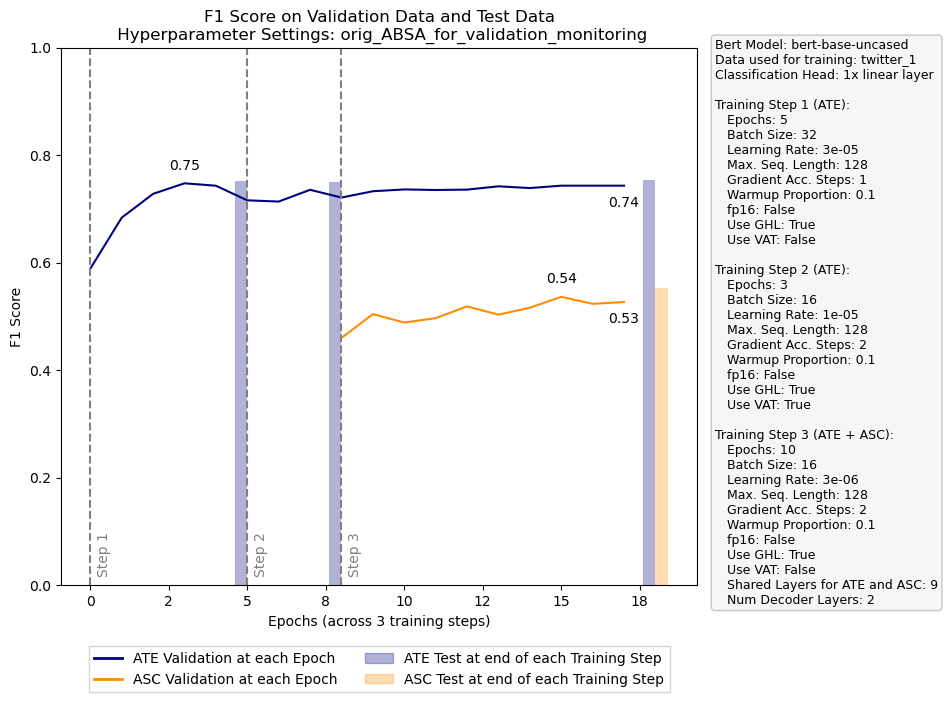

In [20]:
name = f'orig_ABSA_for_validation_monitoring'
file = 'GRACE/training_performance.json'
metric = "f1_score"

# print(i)
# extract_highest_f1_score(file, name, metric)
# print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 68.2 in epoch 5
AS: 43.6 in epoch 3
Test Metrics AT: 65.7
Test Metrics AS: 44.6

F1 Score


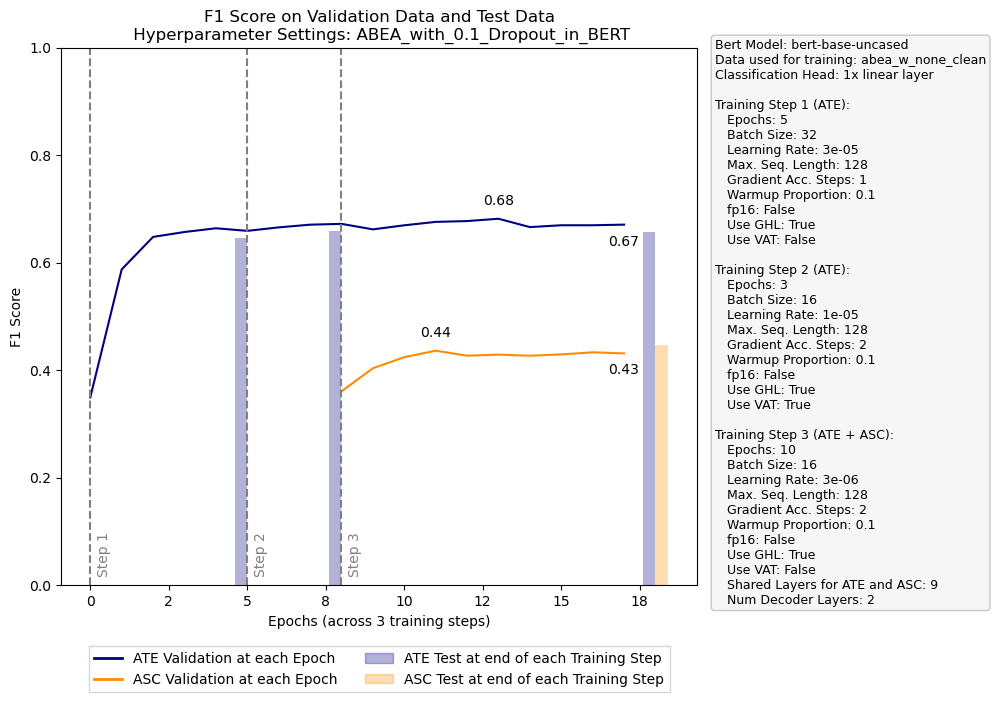

In [16]:
name = f'ABEA_with_0.1_Dropout_in_BERT'
file = 'GRACE/training_performance.json'
metric = "f1_score"

# print(i)
extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 99.1 in epoch 9
AS: 95.3 in epoch 9
Test Metrics AT: 65.7
Test Metrics AS: 44.6

F1 Score


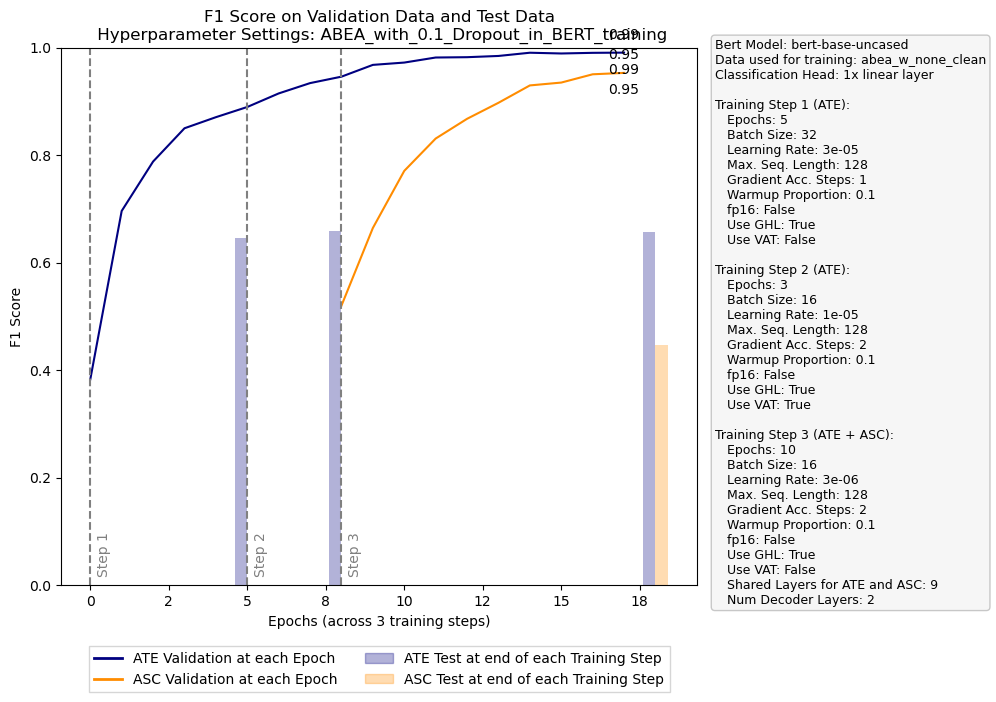

In [17]:
name = f'ABEA_with_0.1_Dropout_in_BERT_training'

file = 'GRACE/training_performance.json'
metric = "f1_score"

# print(i)
extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 67.5 in epoch 8
AS: 43.8 in epoch 9
Test Metrics AT: 65.0
Test Metrics AS: 44.0

F1 Score


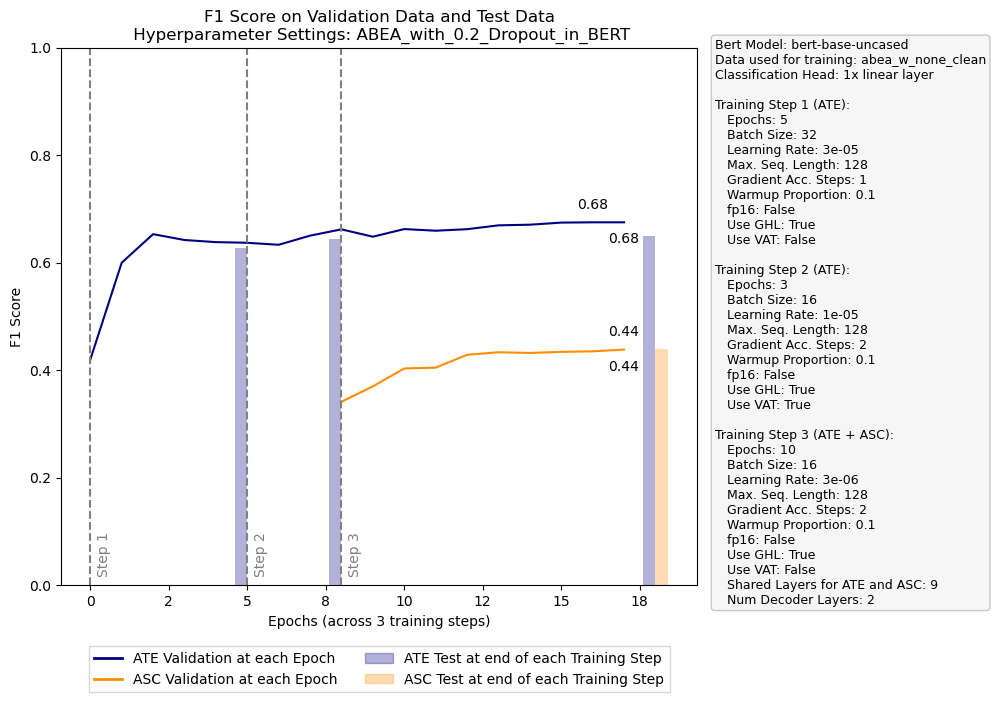

In [26]:
name = f'ABEA_with_0.2_Dropout_in_BERT'

file = 'GRACE/training_performance.json'
metric = "f1_score"

# # print(i)
extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 87.9 in epoch 8
AS: 79.0 in epoch 9
Test Metrics AT: 65.0
Test Metrics AS: 44.0

F1 Score


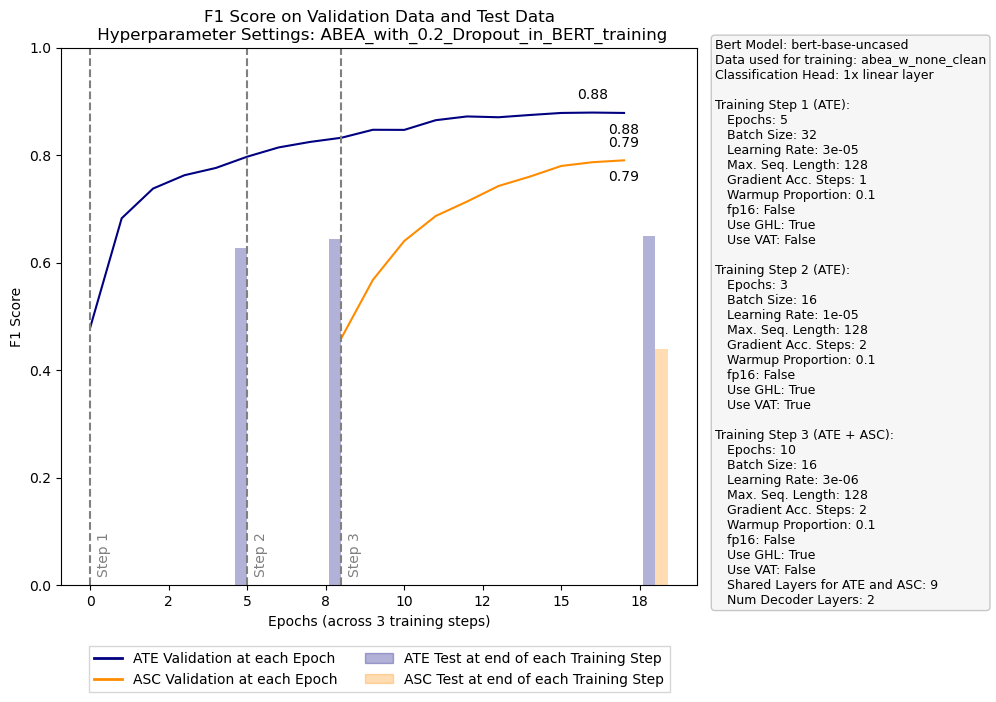

In [31]:
name = f'ABEA_with_0.2_Dropout_in_BERT_training'

file = 'GRACE/training_performance.json'
metric = "f1_score"

# print(i)
extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 64.2 in epoch 5
AS: 39.4 in epoch 5
Test Metrics AT: 62.3
Test Metrics AS: 41.8

F1 Score


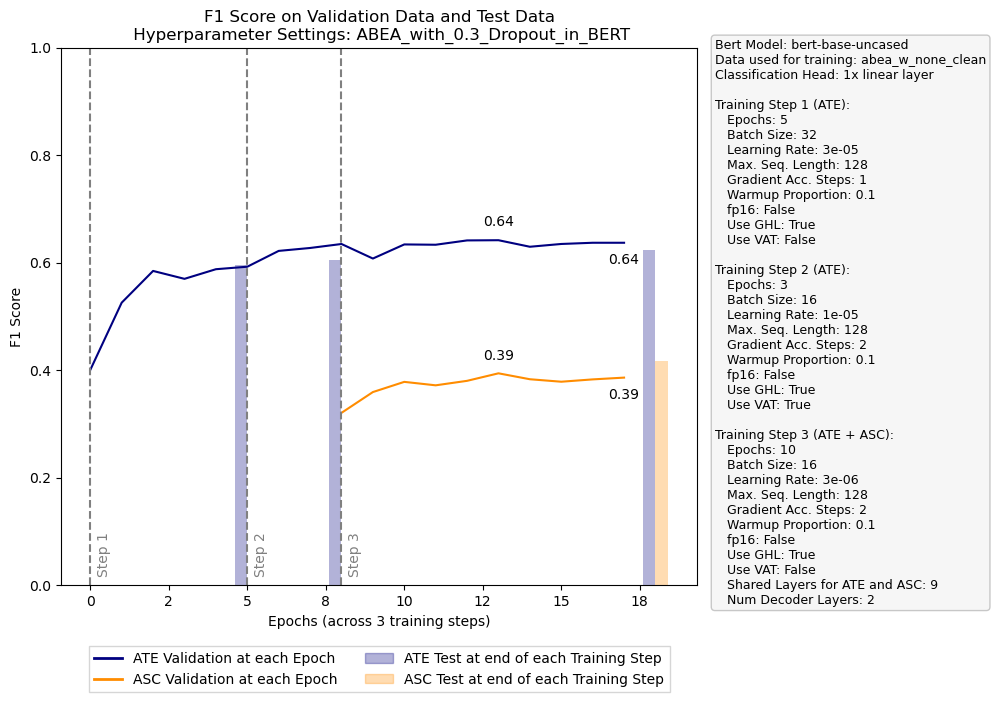

In [98]:
name = f'ABEA_with_0.3_Dropout_in_BERT'

file = 'GRACE/training_performance.json'
metric = "f1_score"

# # print(i)
extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 73.5 in epoch 8
AS: 60.8 in epoch 8
Test Metrics AT: 62.3
Test Metrics AS: 41.8

F1 Score


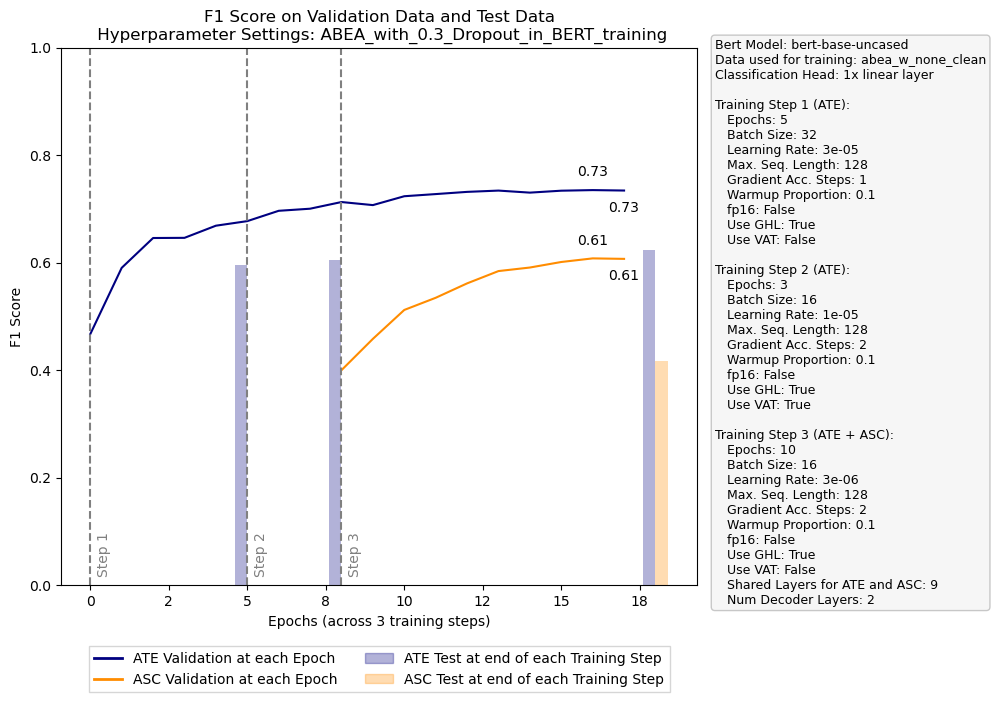

In [115]:
name = f'ABEA_with_0.3_Dropout_in_BERT_training'

file = 'GRACE/training_performance.json'
metric = "f1_score"

# # print(i)
extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

# epoch 17

AT: 66.2 in epoch 9
AS: 41.3 in epoch 8
Test Metrics AT: 64.0
Test Metrics AS: 44.6

F1 Score


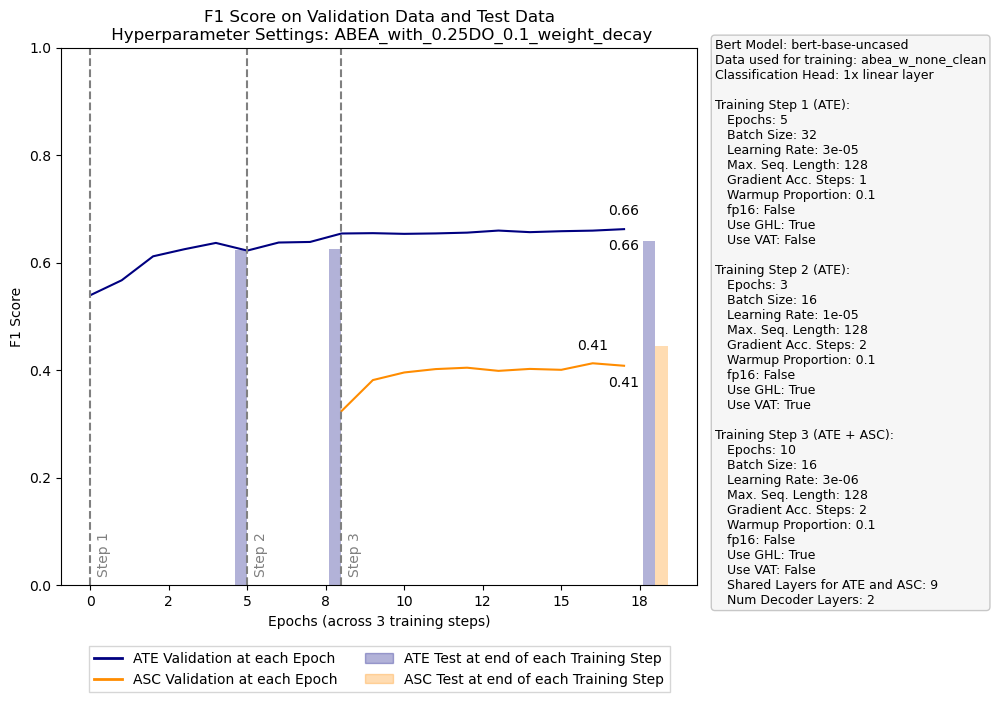

In [126]:
name = f'ABEA_with_0.25DO_0.1_weight_decay'

file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

AT: 80.2 in epoch 8
AS: 69.3 in epoch 9
Test Metrics AT: 64.0
Test Metrics AS: 44.6

F1 Score


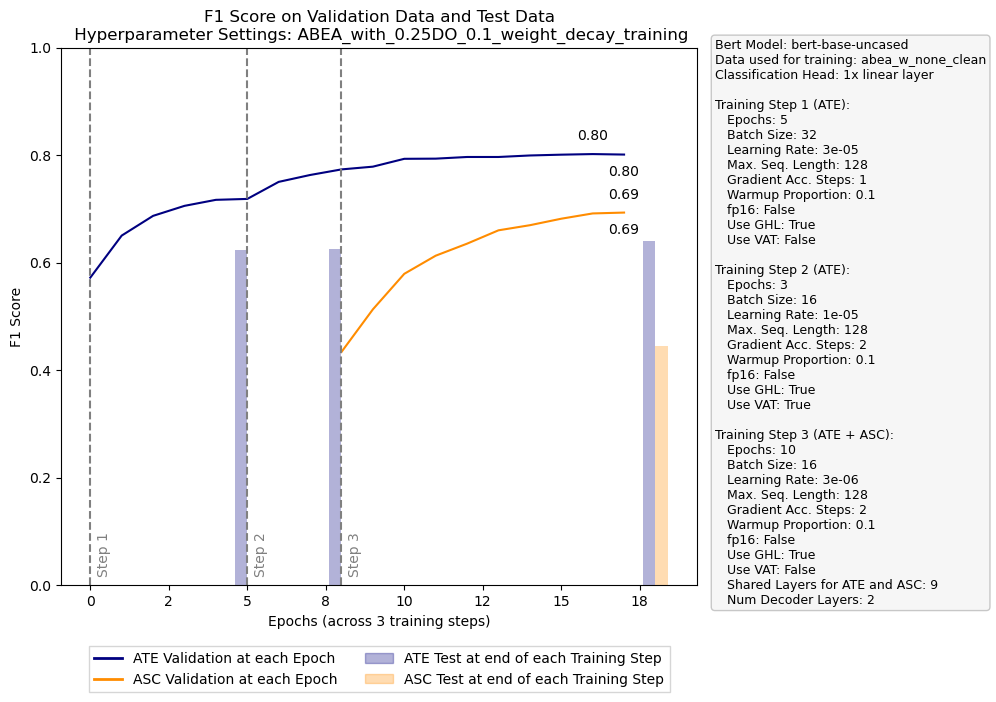

In [127]:
name = f'ABEA_with_0.25DO_0.1_weight_decay_training'

file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

AT: 66.2 in epoch 9
AS: 41.3 in epoch 8
Test Metrics AT: 64.0
Test Metrics AS: 44.6

F1 Score


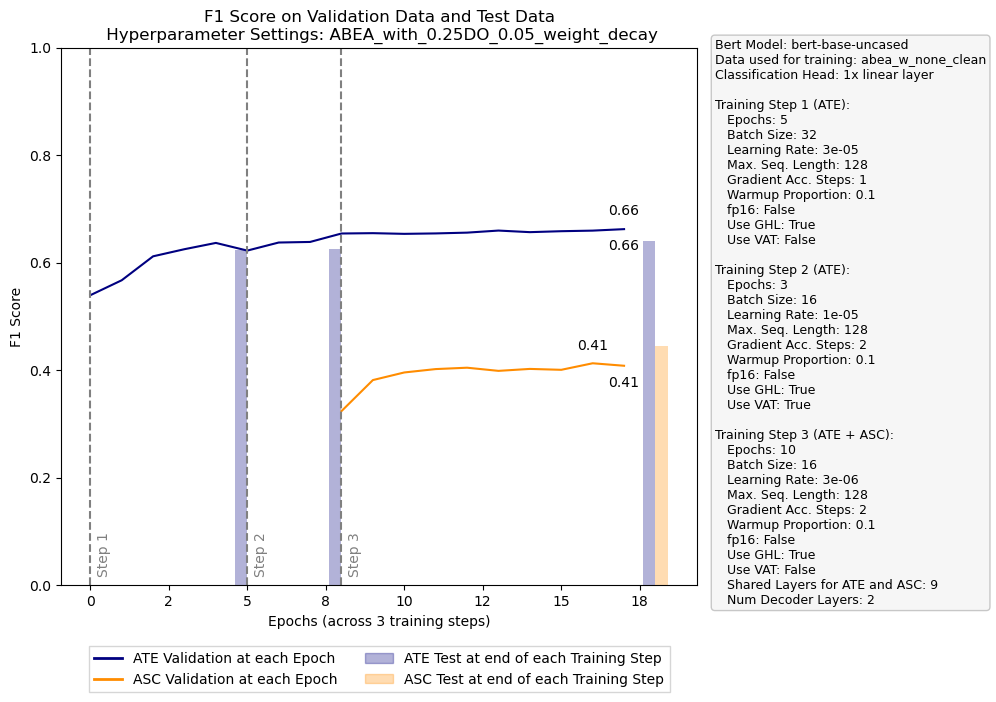

In [140]:
name = f'ABEA_with_0.25DO_0.05_weight_decay'

file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

AT: 80.2 in epoch 8
AS: 69.3 in epoch 9
Test Metrics AT: 64.0
Test Metrics AS: 44.6

F1 Score


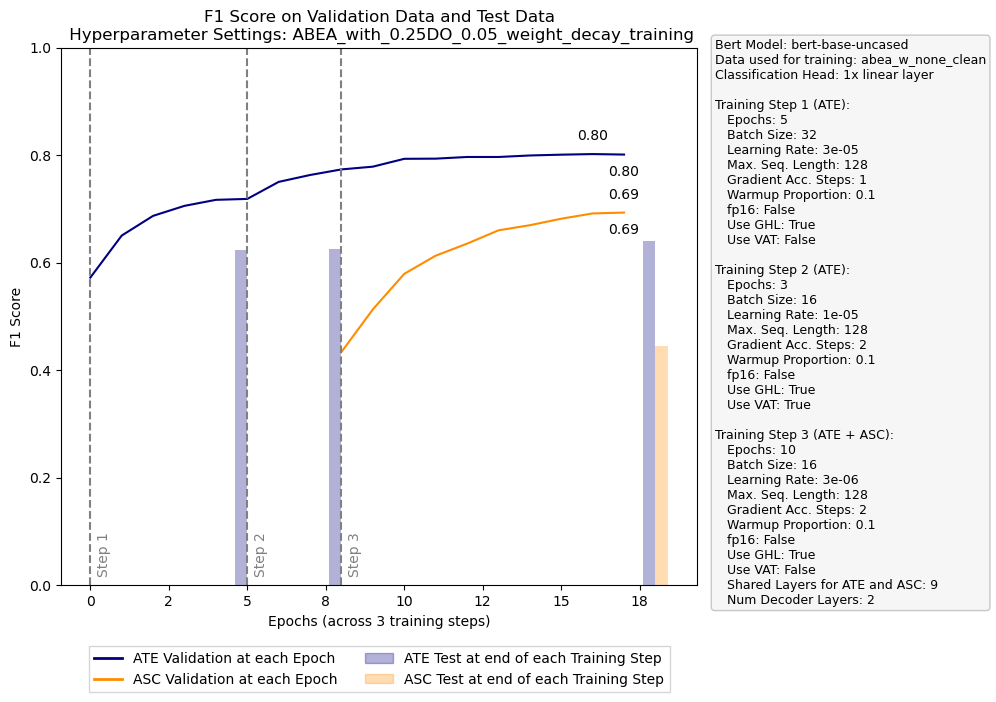

In [141]:
name = f'ABEA_with_0.25DO_0.05_weight_decay_training'

file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

AT: 64.1 in epoch 2
AS: 38.7 in epoch 4
Test Metrics AT: 62.8
Test Metrics AS: 42.6

F1 Score


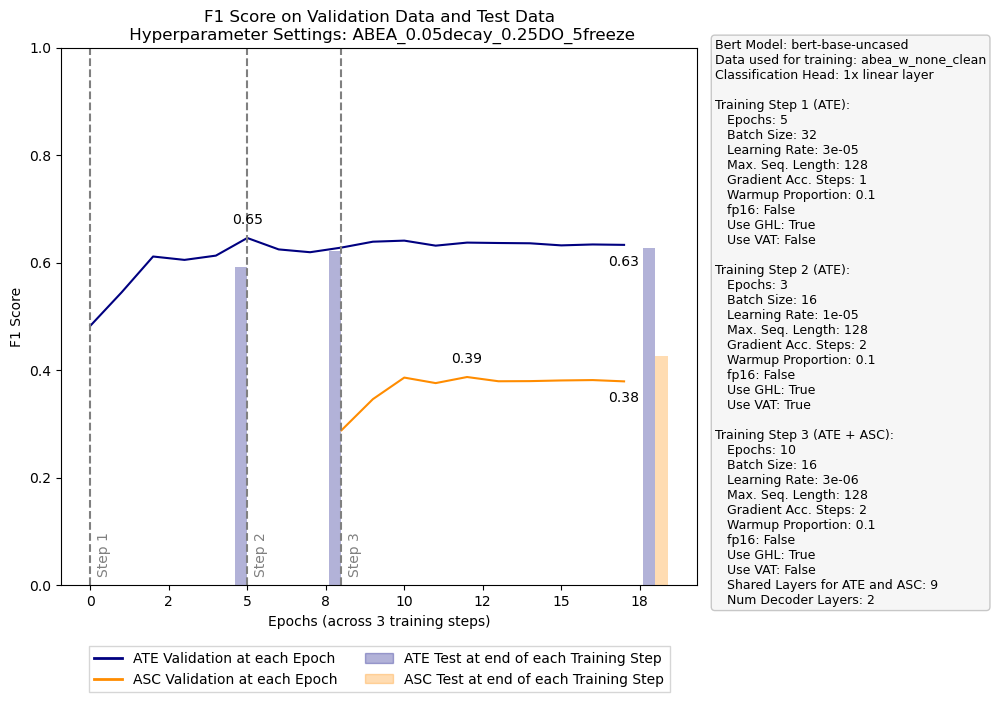

In [150]:
name = f'ABEA_0.05decay_0.25DO_5freeze'

file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)
print(f"")

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)

## Previous Results Visualisation

#### Previous Results

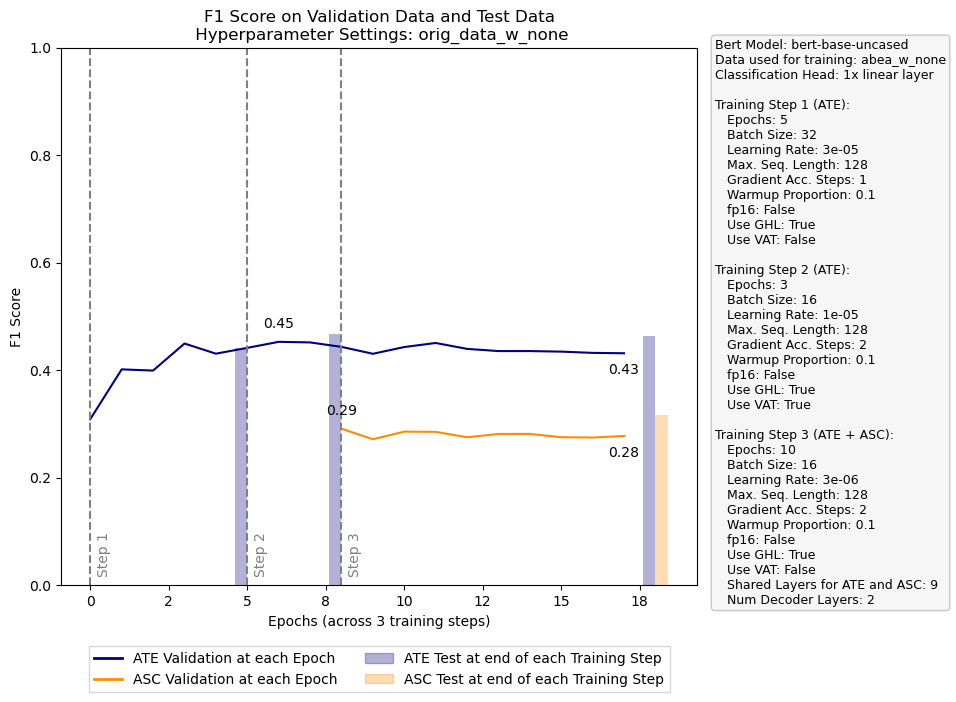

In [130]:
# name = 'orig_data_w_none'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'orig_data_w_none'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

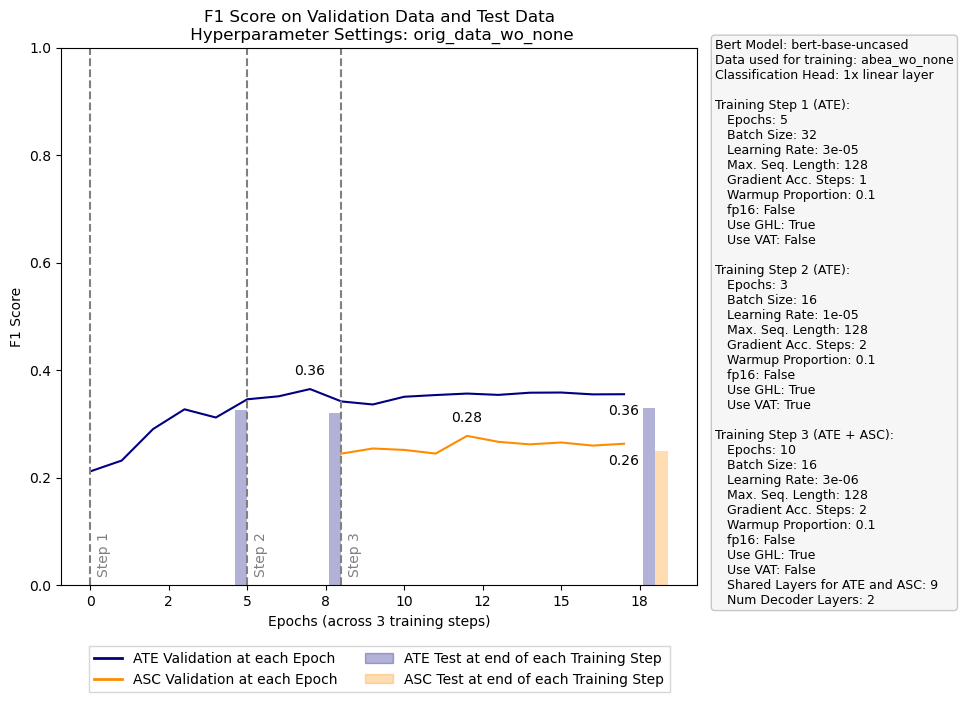

In [131]:
# name = 'orig_data_wo_none'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'orig_data_wo_none'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

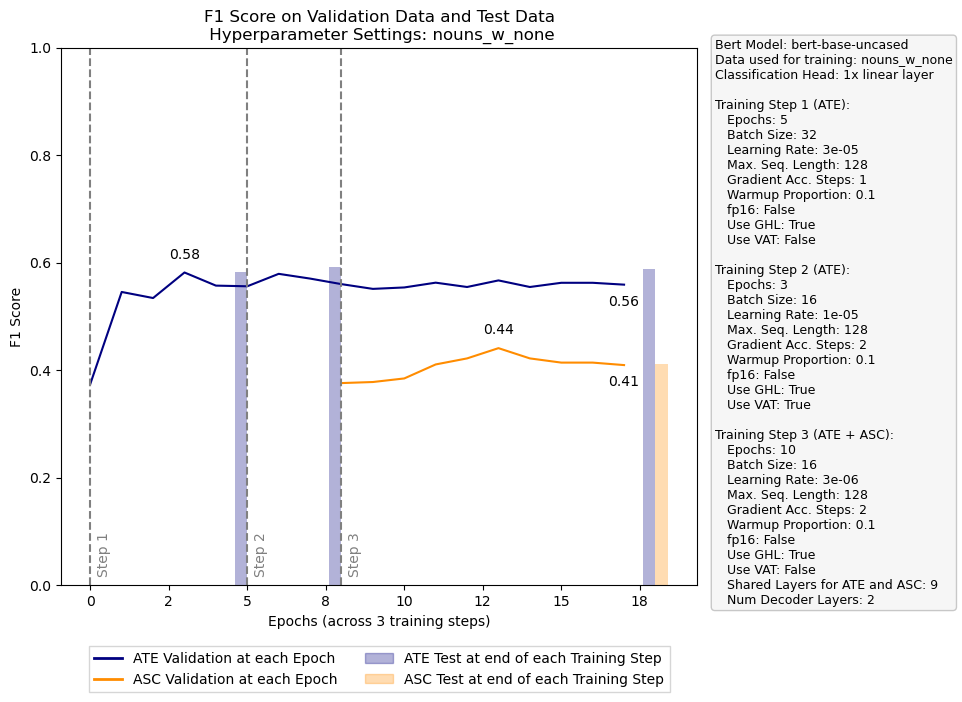

In [140]:
# name = 'nouns_w_none'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'nouns_w_none'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

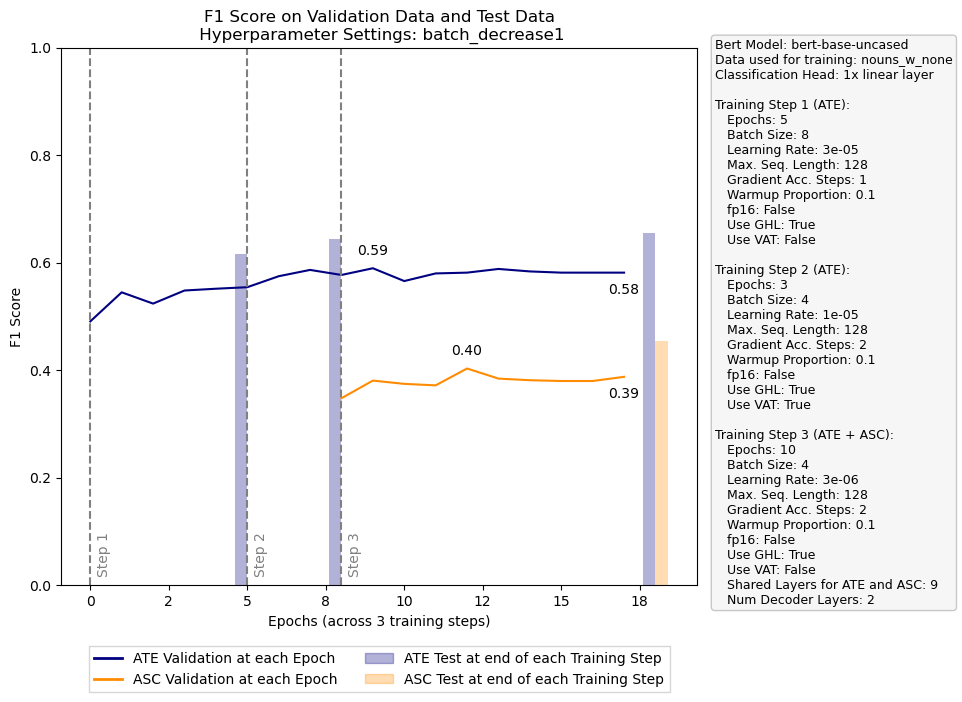

In [155]:
# name = 'batch_decrease1'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'batch_decrease1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

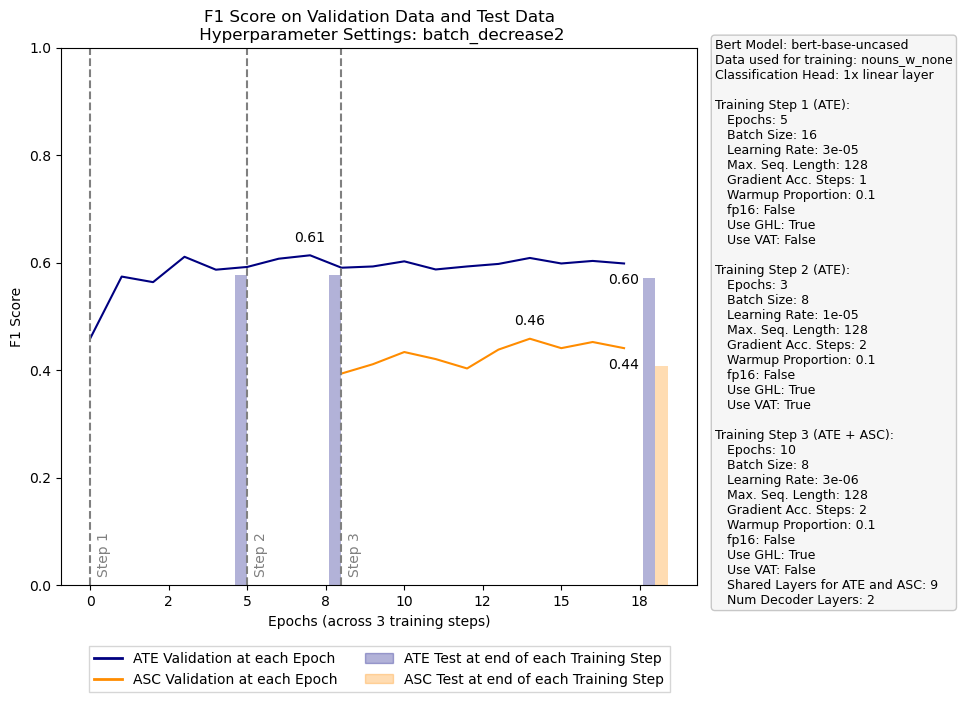

In [165]:
# name = 'batch_decrease2'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'batch_decrease2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

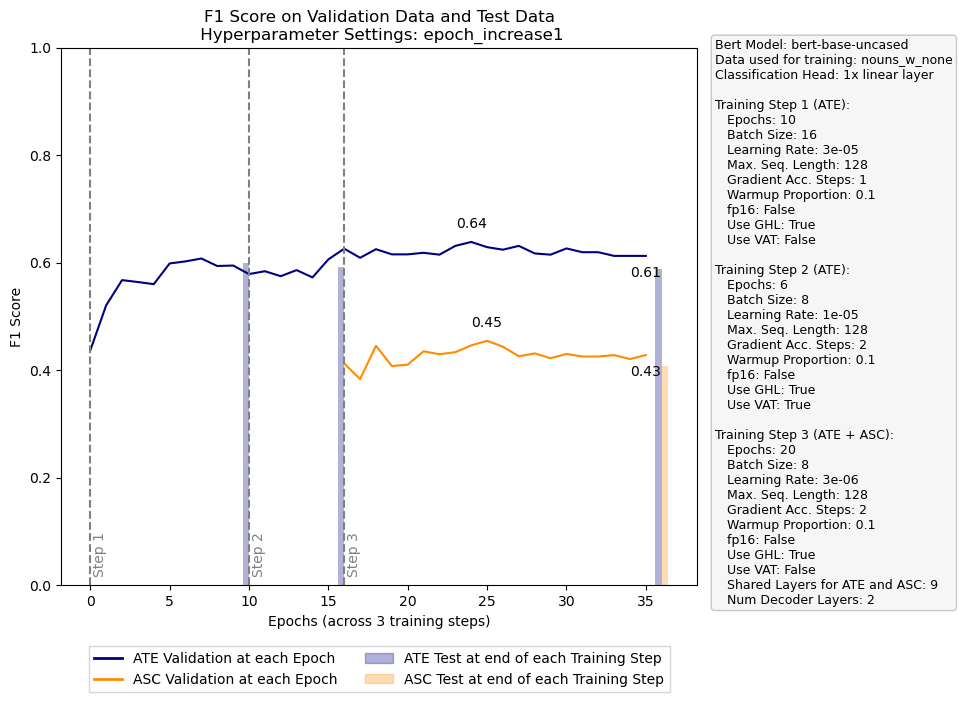

In [175]:
# name = 'epoch_increase1'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'epoch_increase1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

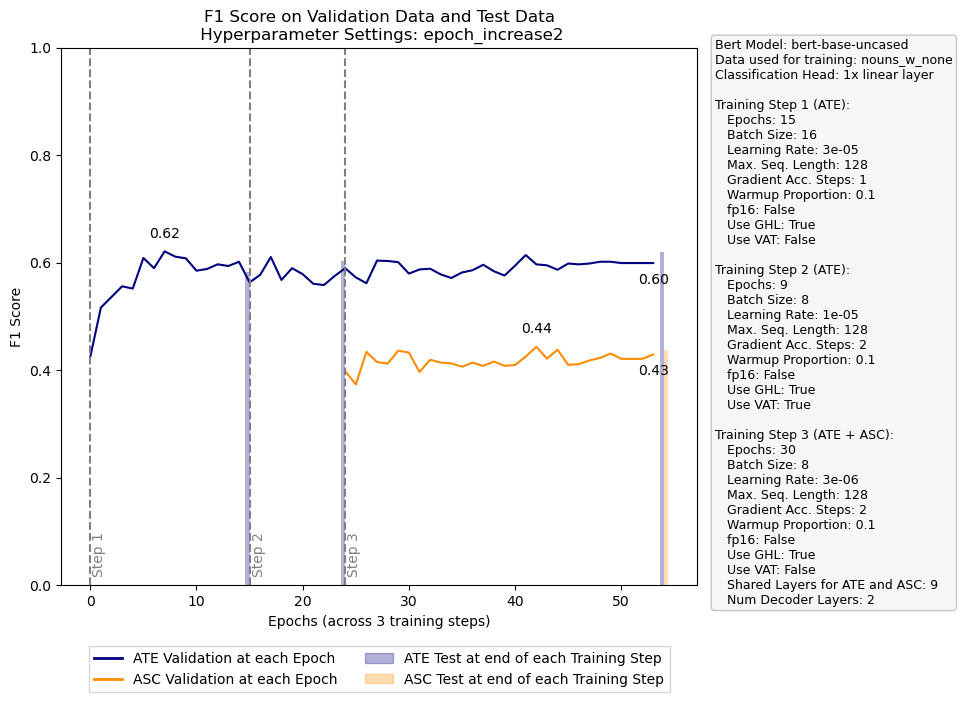

In [183]:
# name = 'epoch_increase2'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'epoch_increase2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

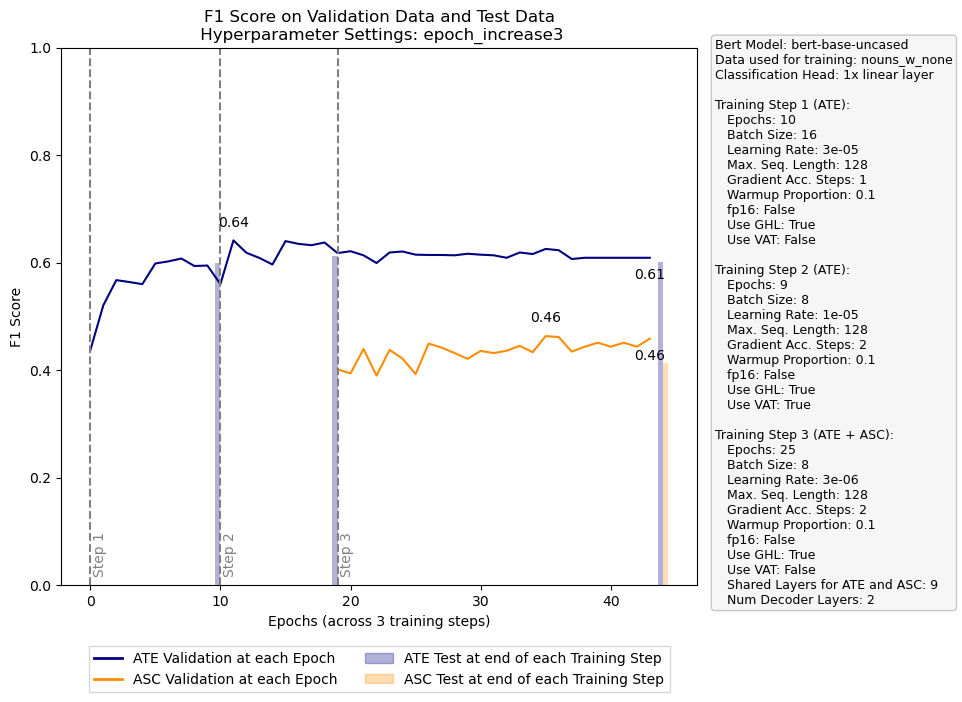

In [24]:
# name = 'epoch_increase3'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'epoch_increase3'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

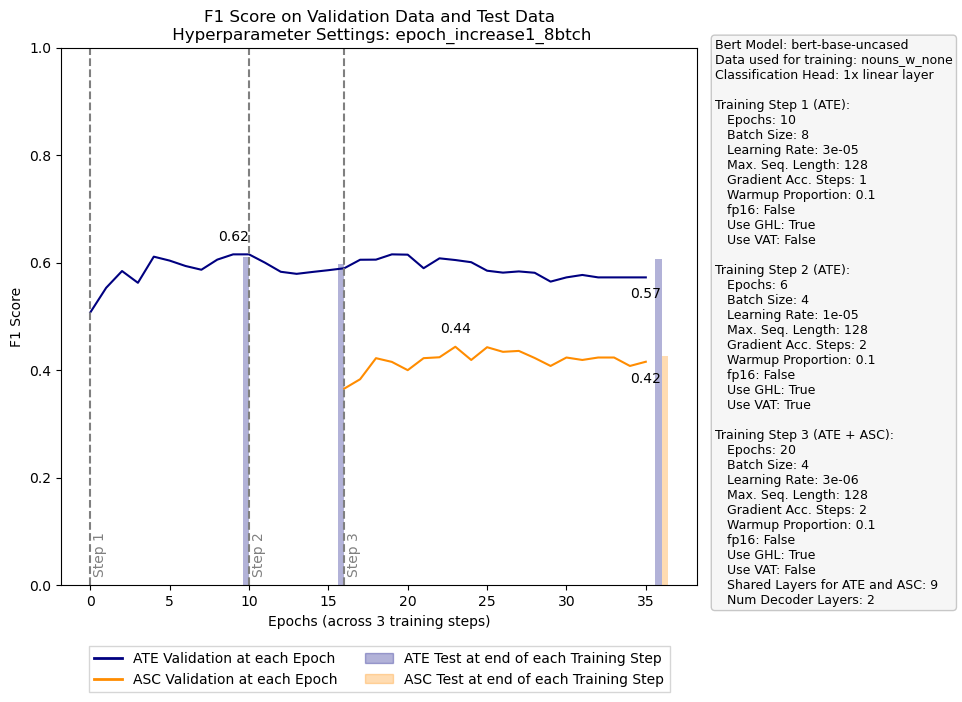

In [38]:
#name = 'epoch_increase1_8btch'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'epoch_increase1_8btch'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

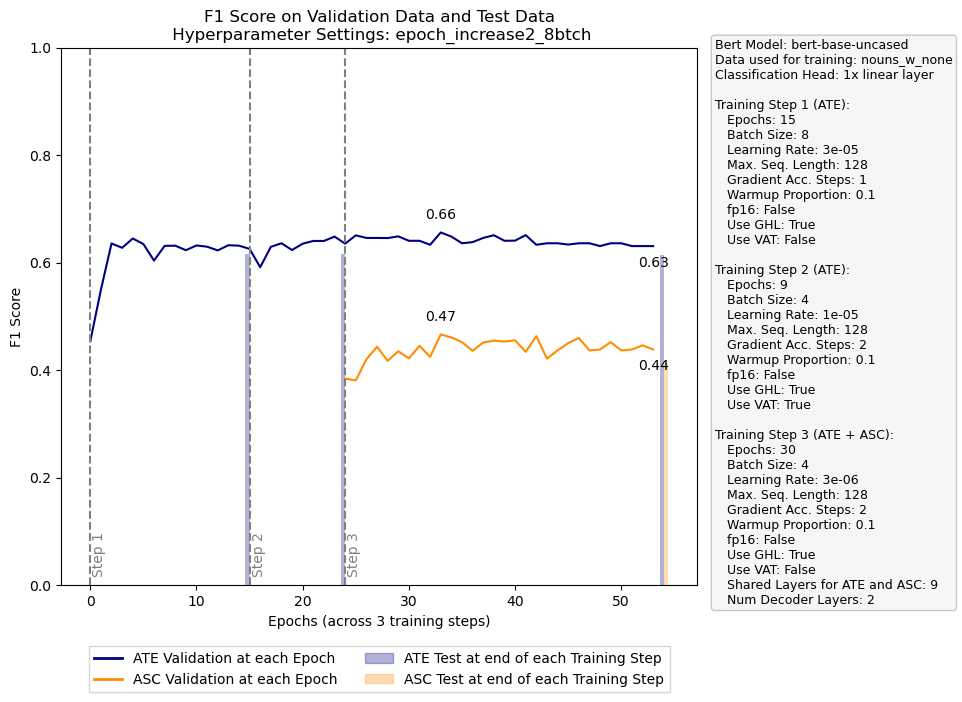

In [47]:
# name = 'epoch_increase2_8btch'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'epoch_increase2_8btch'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

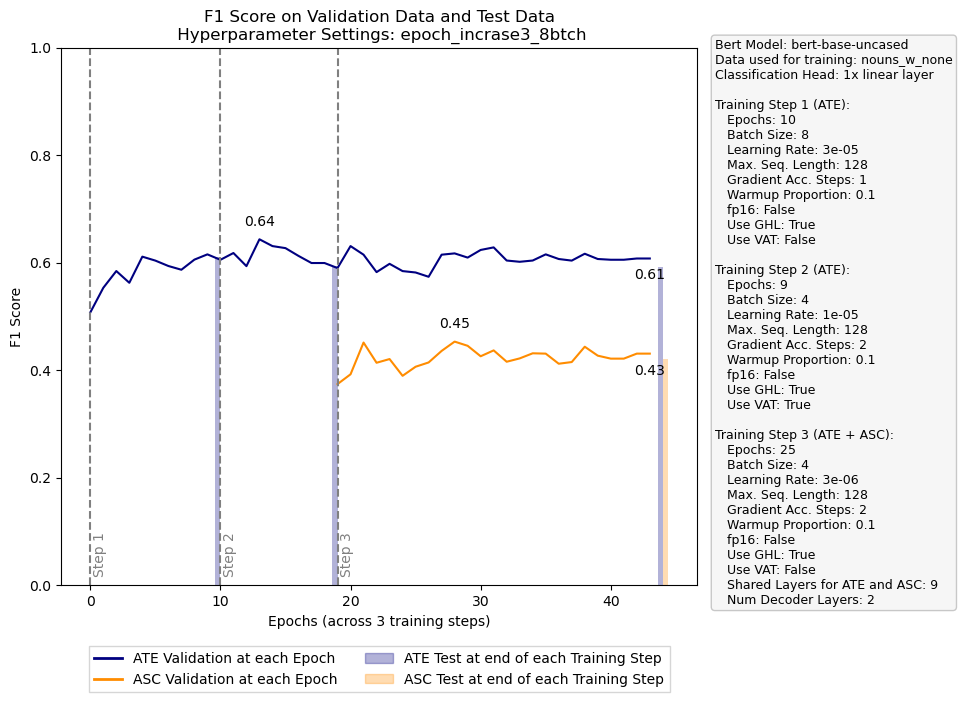

In [71]:
# name = 'epoch_incrase3_8btch'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'epoch_incrase3_8btch'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

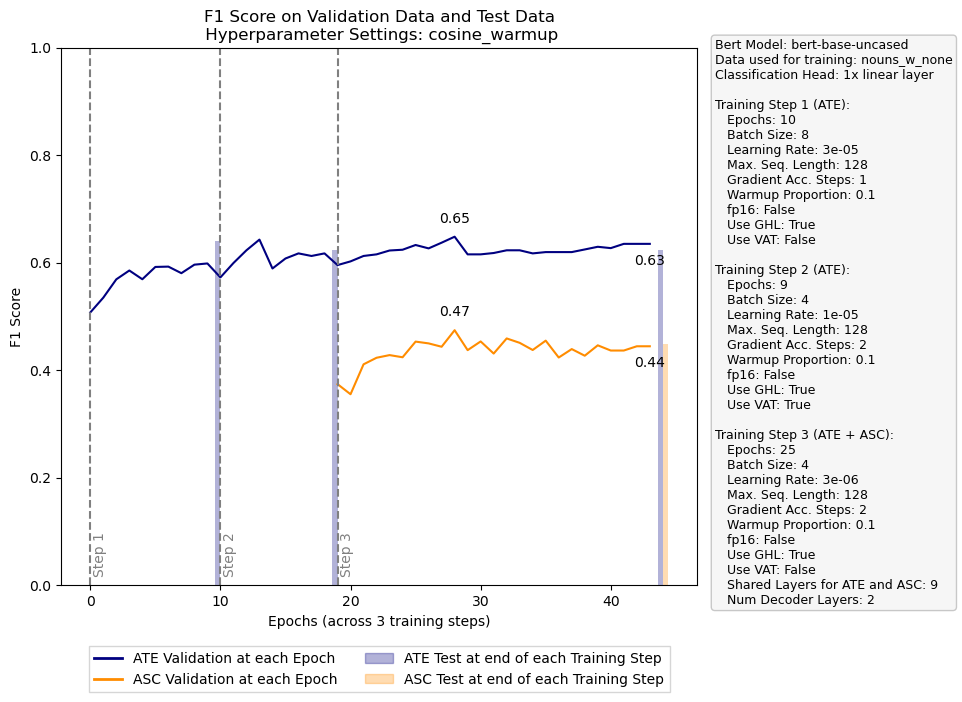

In [81]:
# name = 'cosine_warmup'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'cosine_warmup'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

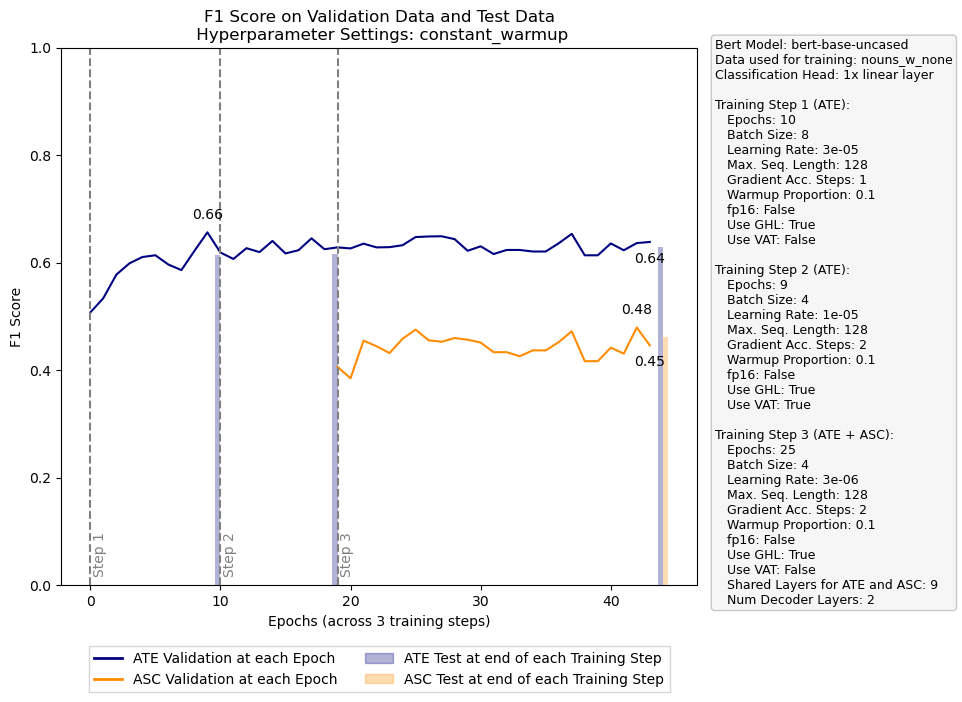

In [101]:
# name = 'constant_warmup'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'constant_warmup'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

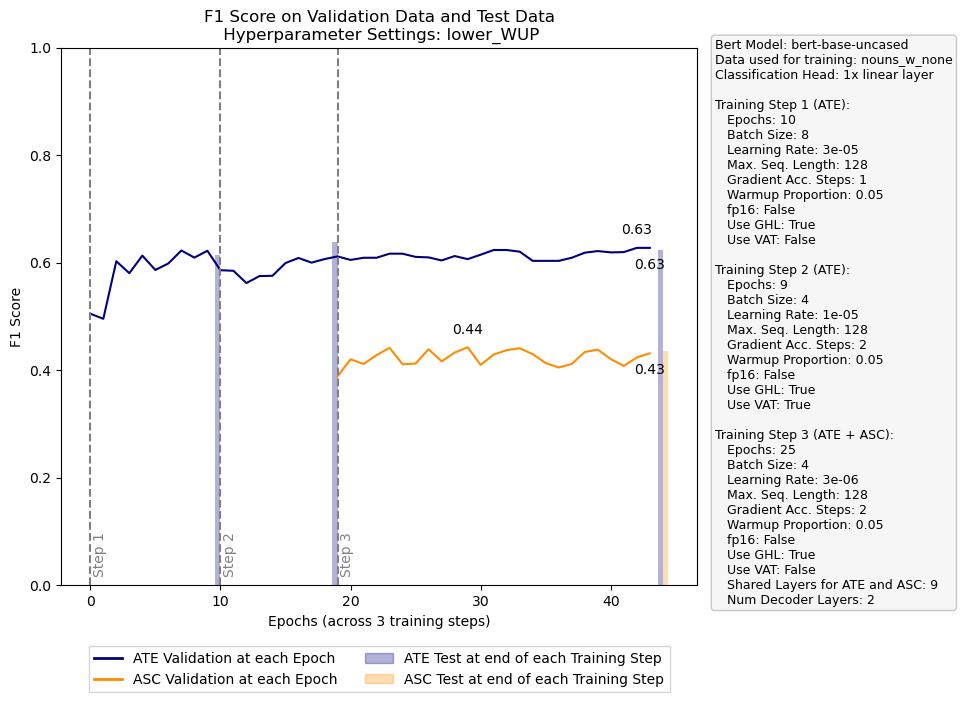

In [119]:
# name = 'lower_WUP'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'lower_WUP'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

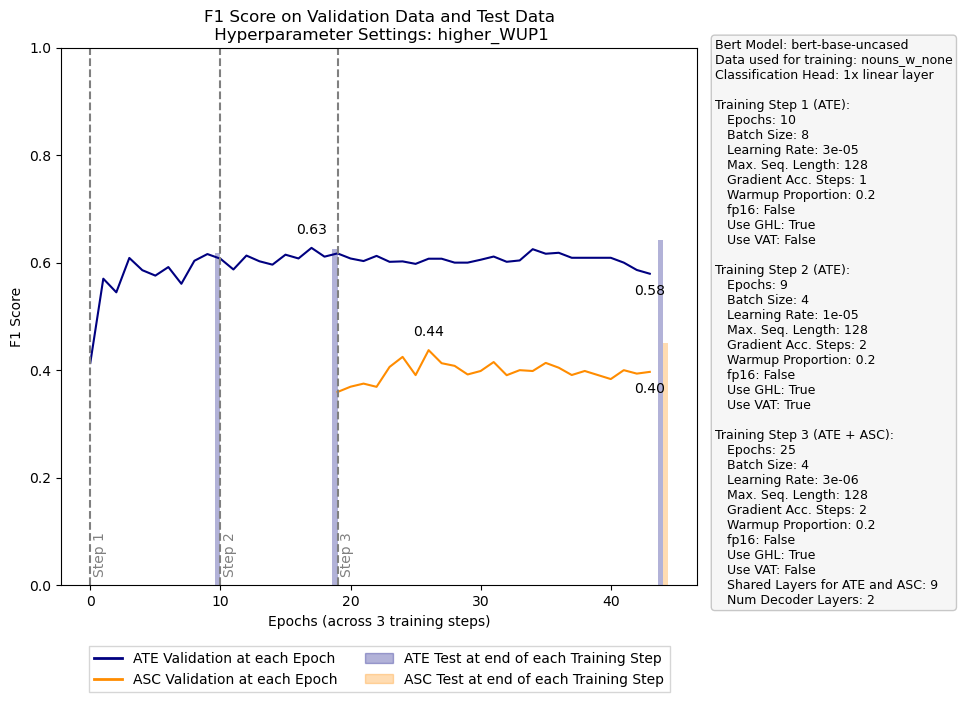

In [133]:
# name = 'higher_WUP1'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'higher_WUP1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

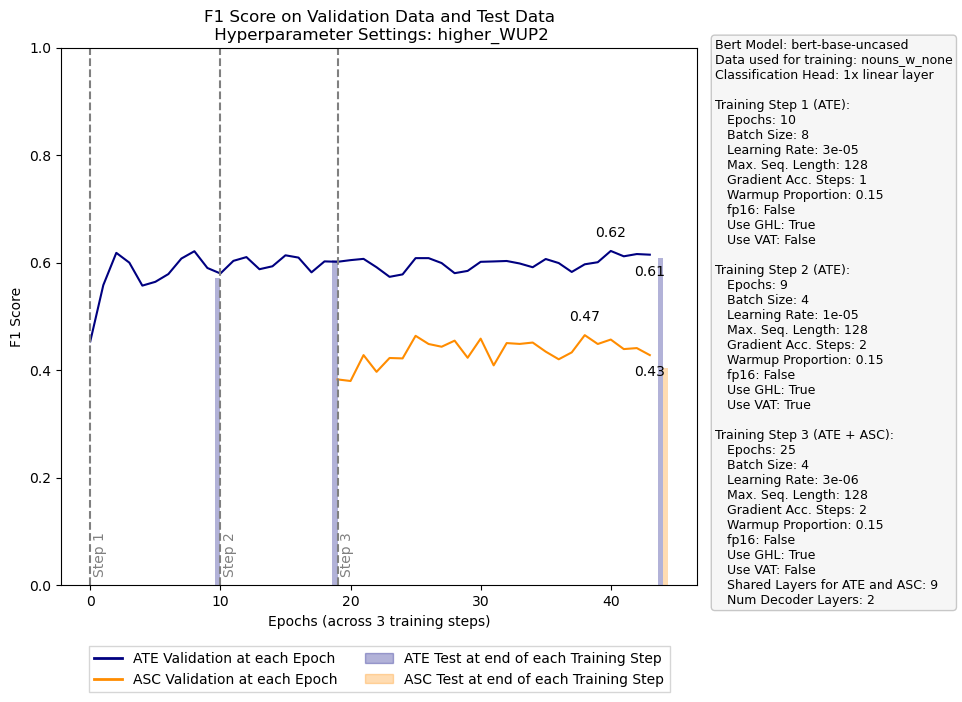

In [136]:
# name = 'higher_WUP2'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'higher_WUP2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

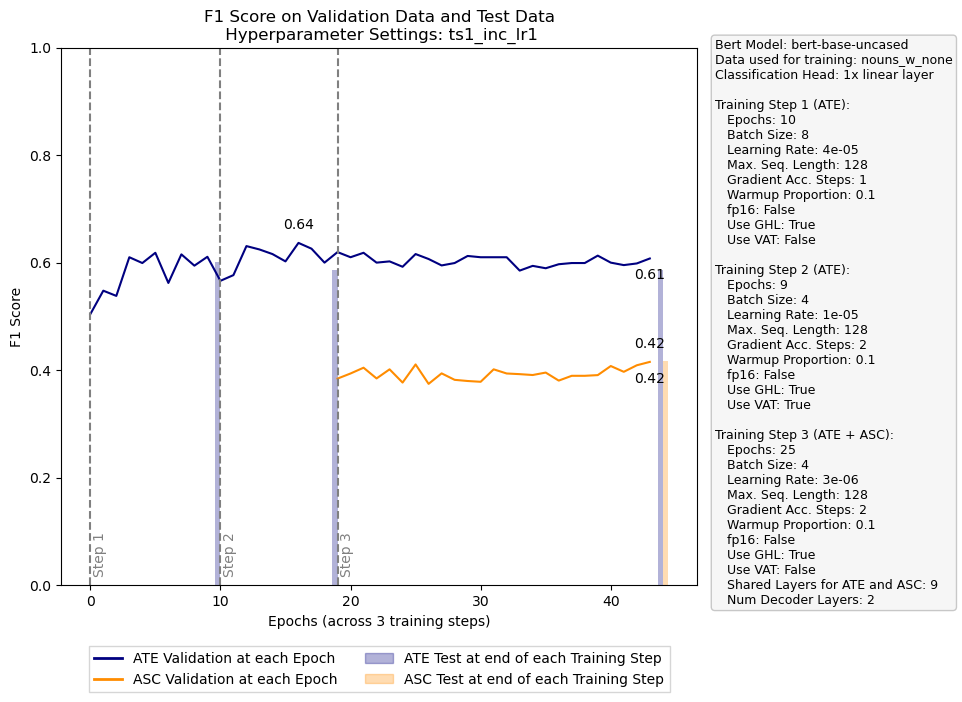

In [148]:
# name = 'ts1_inc_lr1'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts1_inc_lr1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)


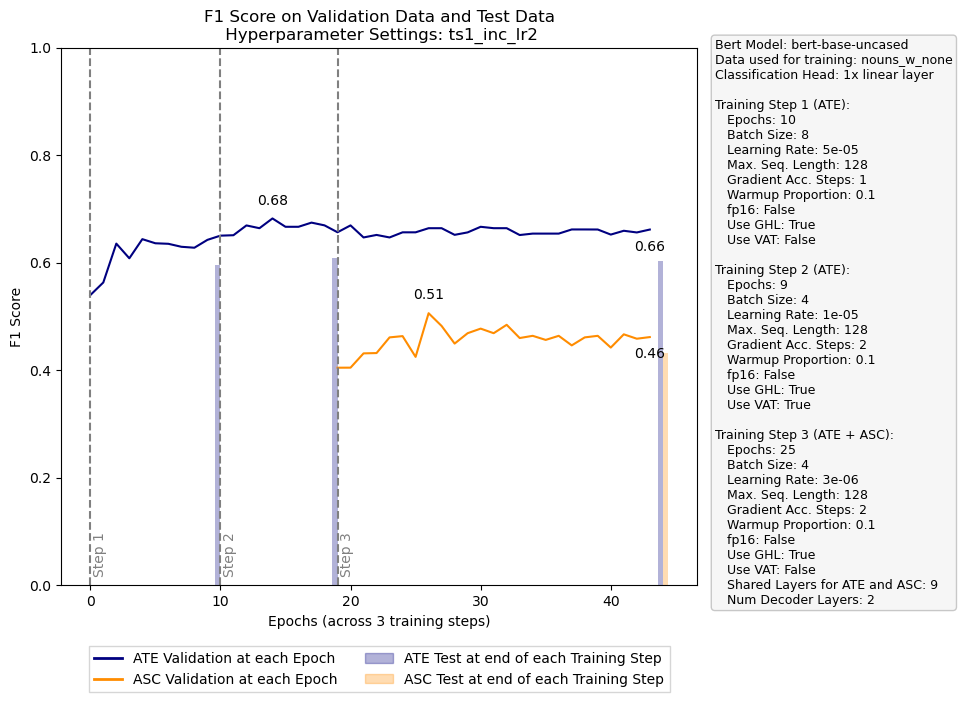

In [4]:
# name = 'ts1_inc_lr2'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts1_inc_lr2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

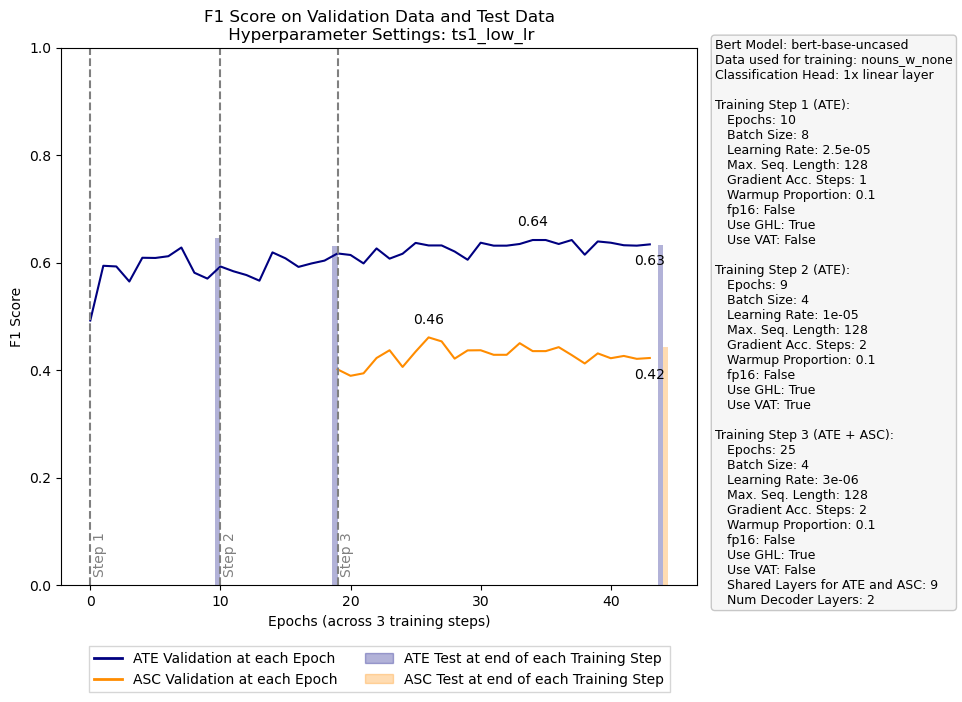

In [5]:
# name = 'ts1_low_lr'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts1_low_lr'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

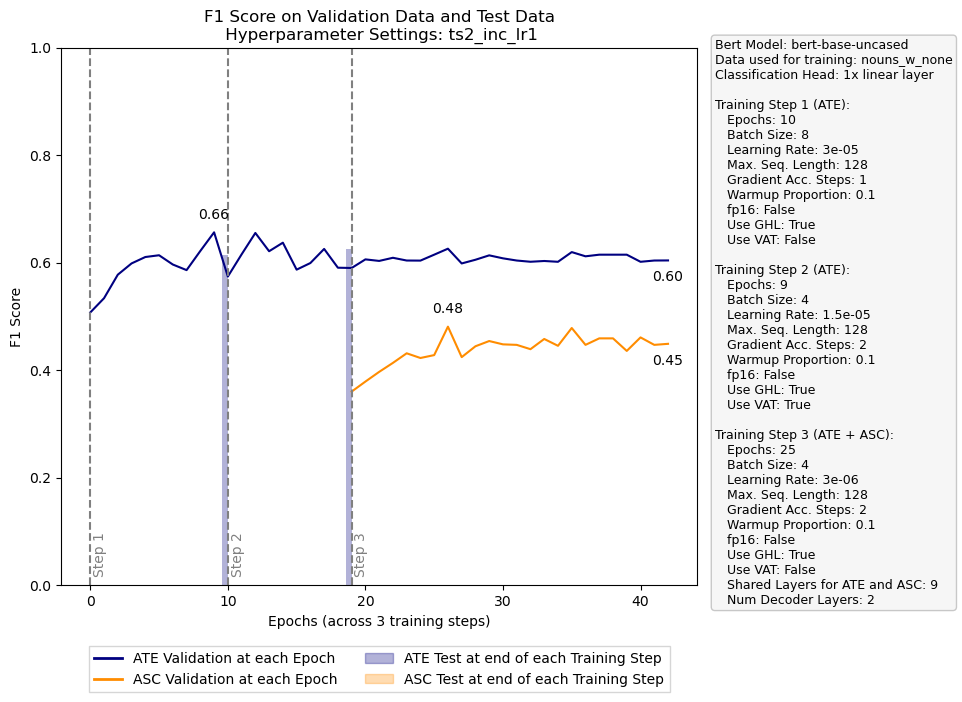

In [11]:
# name = 'ts2_inc_lr1'

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts2_inc_lr1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

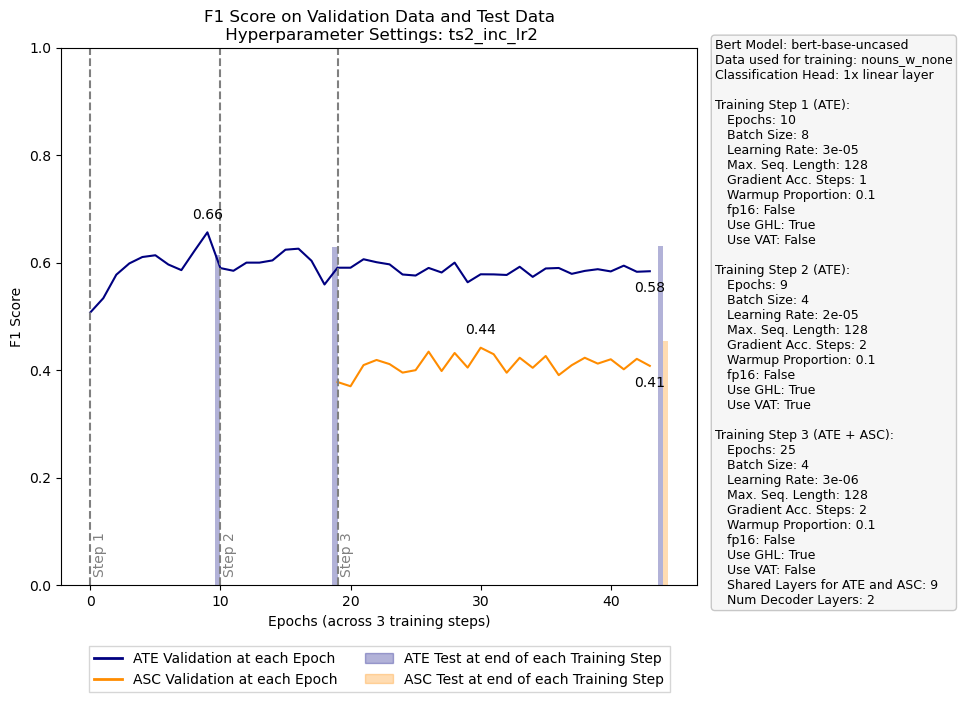

In [16]:
# name = 'ts2_inc_lr2'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts2_inc_lr2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

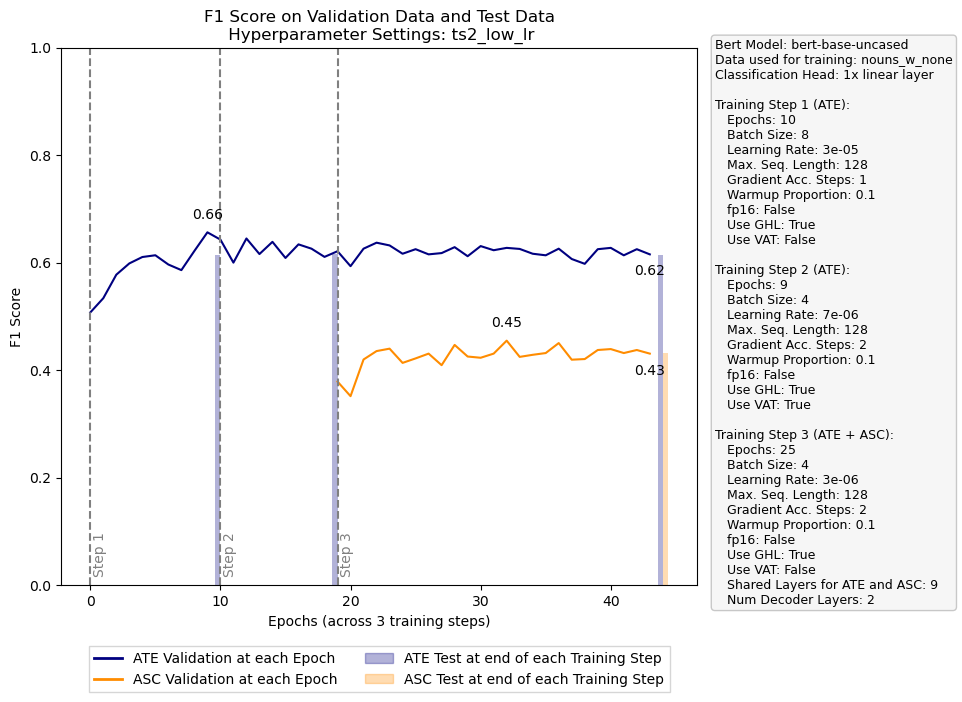

In [6]:
# name = 'ts2_low_lr'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts2_low_lr'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

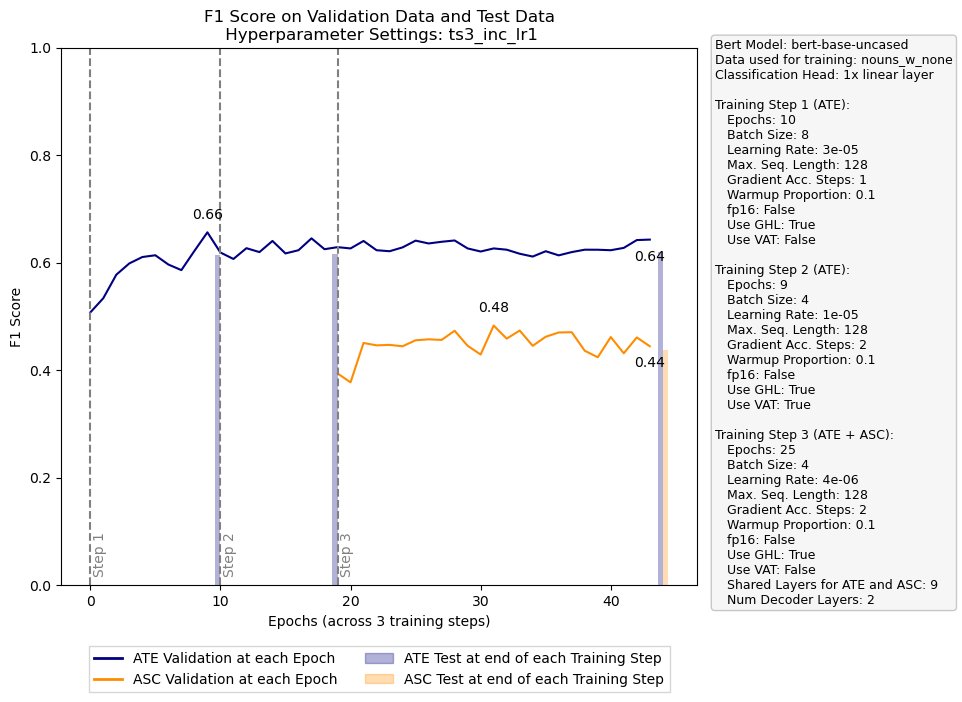

In [7]:
# name = 'ts3_inc_lr1'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts3_inc_lr1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

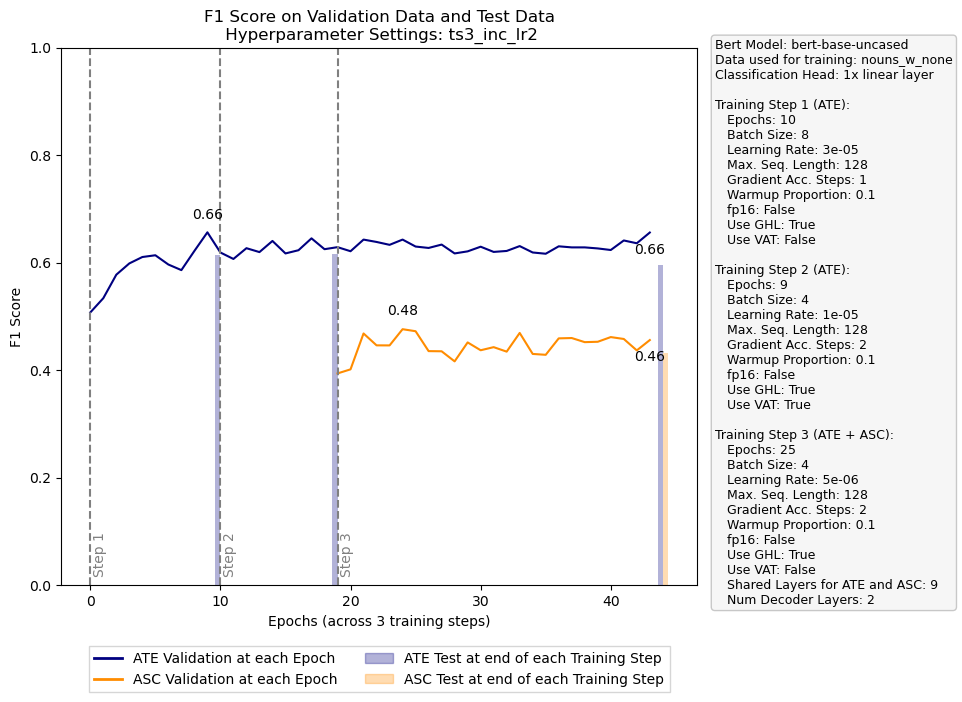

In [13]:
# name = 'ts3_inc_lr2'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts3_inc_lr2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

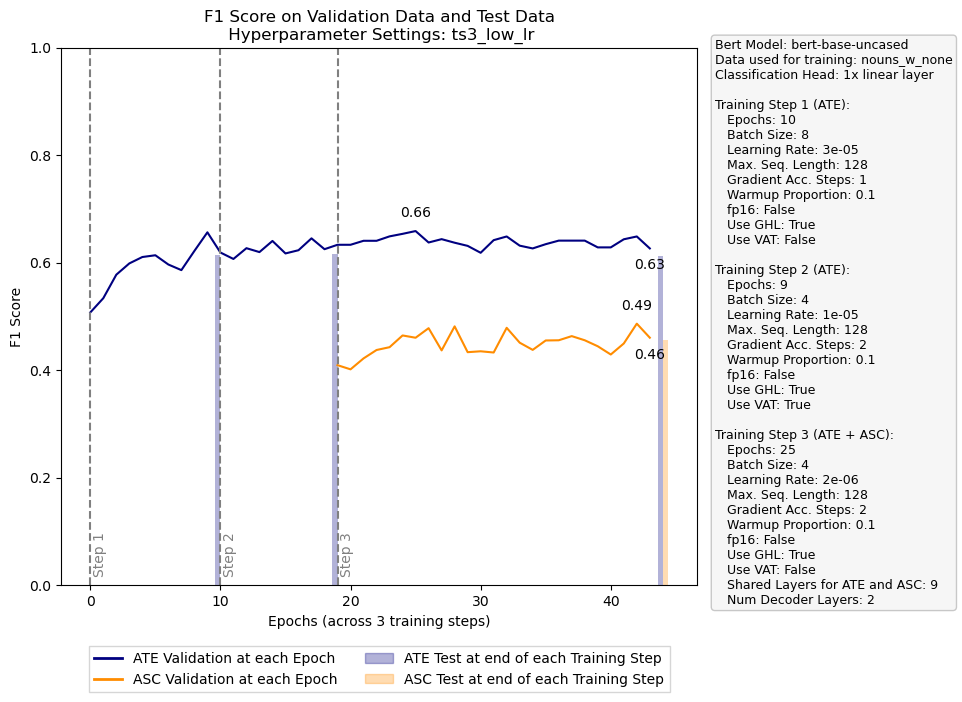

In [17]:
# name = 'ts3_low_lr'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ts3_low_lr'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

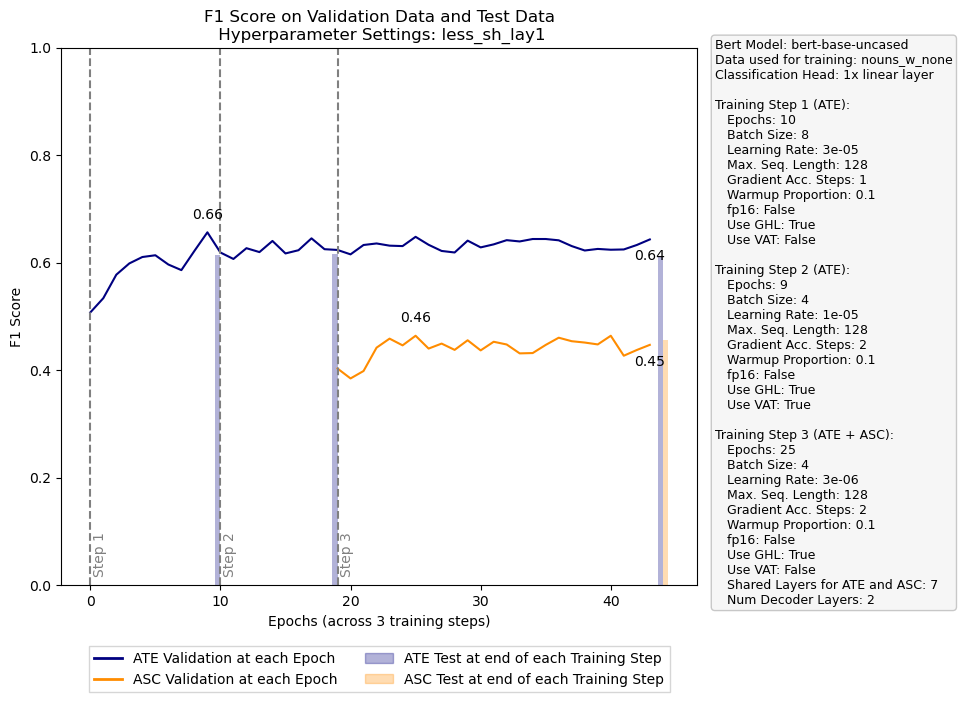

In [57]:
# name = 'less_sh_lay1'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'less_sh_lay1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

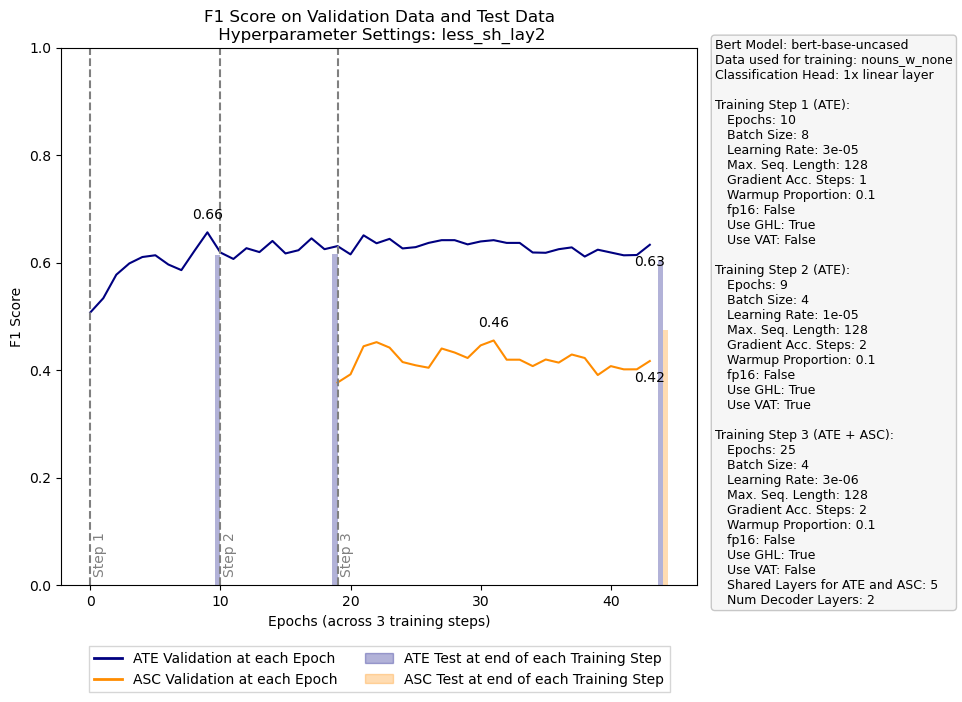

In [72]:
# name = 'less_sh_lay2'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'less_sh_lay2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

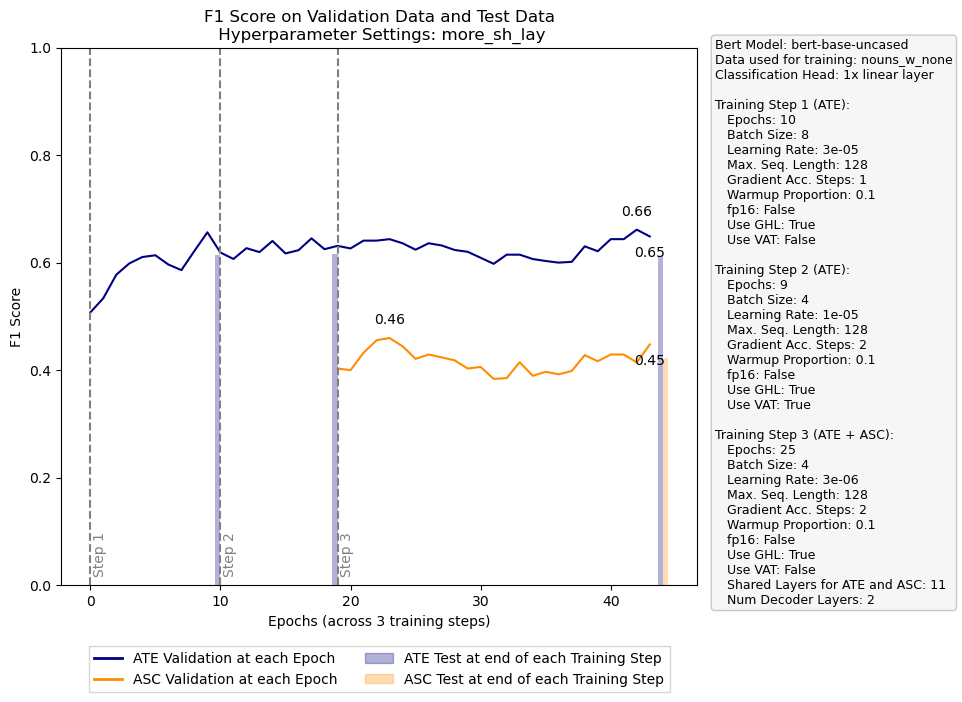

In [73]:
# name = 'more_sh_lay'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'more_sh_lay'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

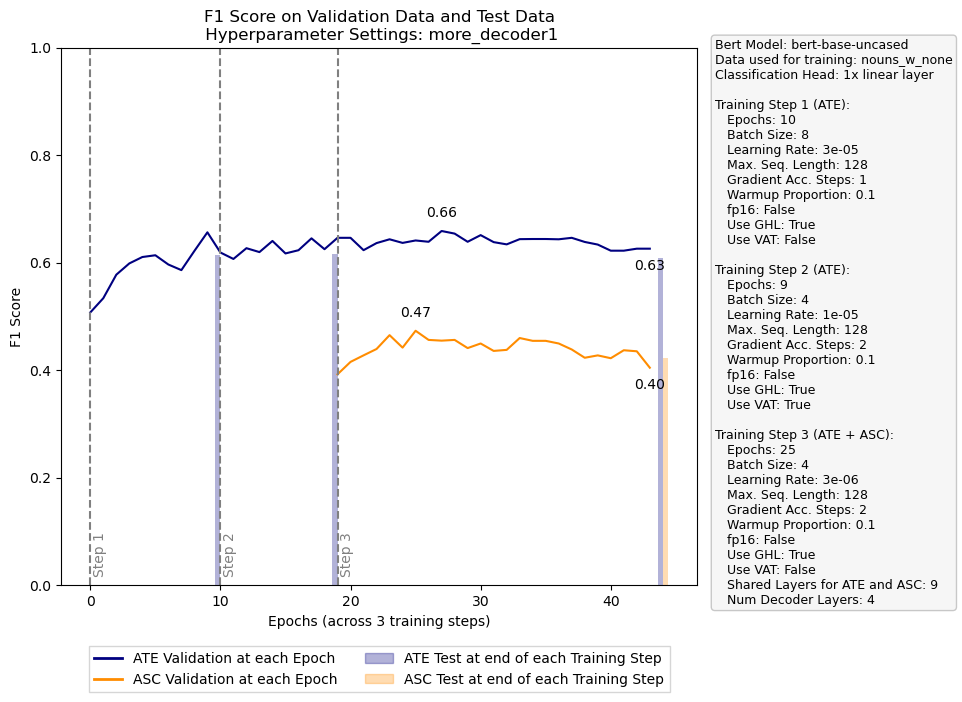

In [77]:
# name = 'more_decoder1'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'more_decoder1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

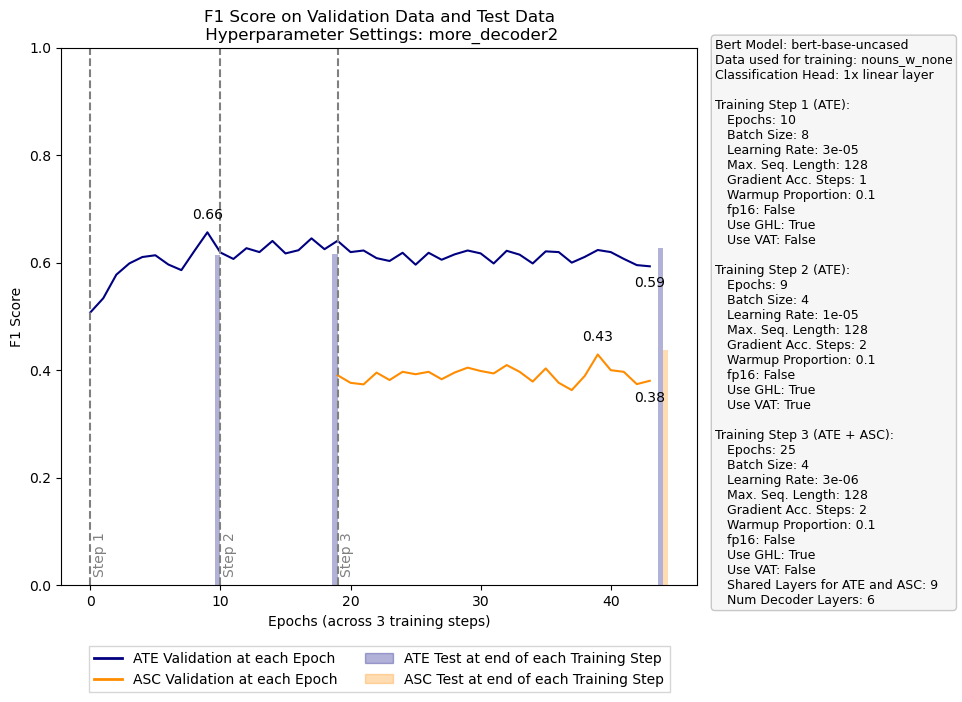

In [79]:
# name = 'more_decoder2'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'more_decoder2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

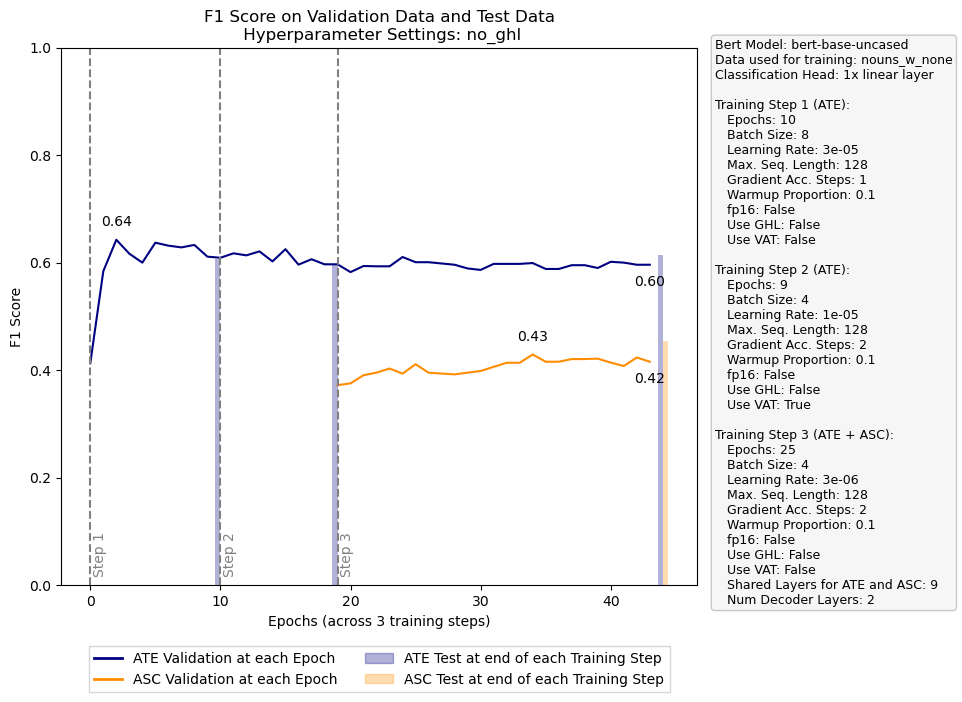

In [13]:
# name = 'no_ghl'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'no_ghl'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

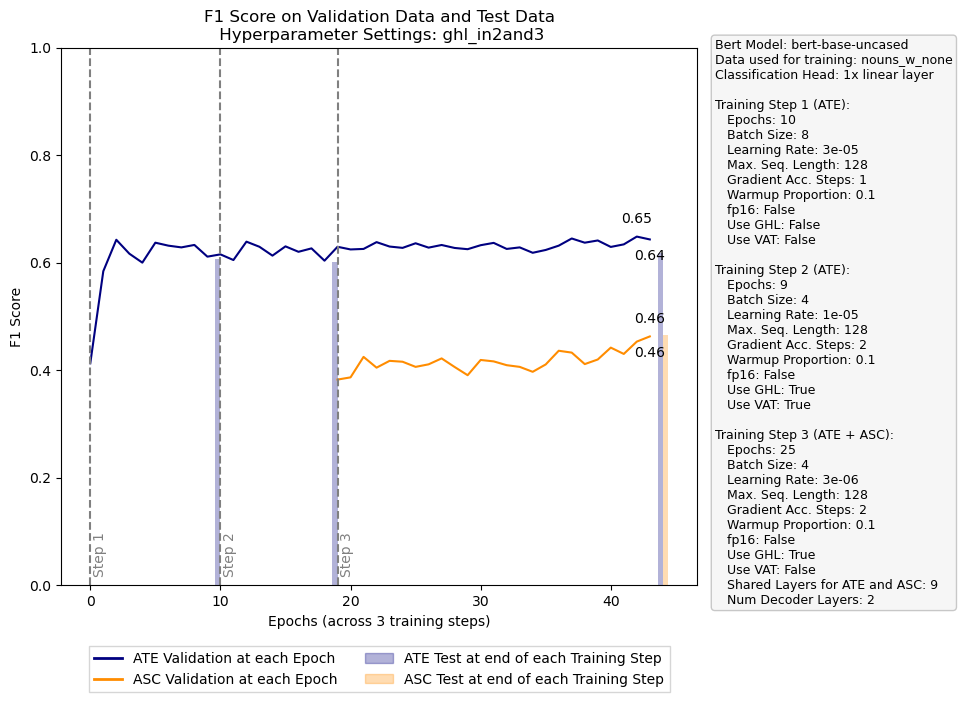

In [14]:
# name = 'ghl_in2and3'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ghl_in2and3'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

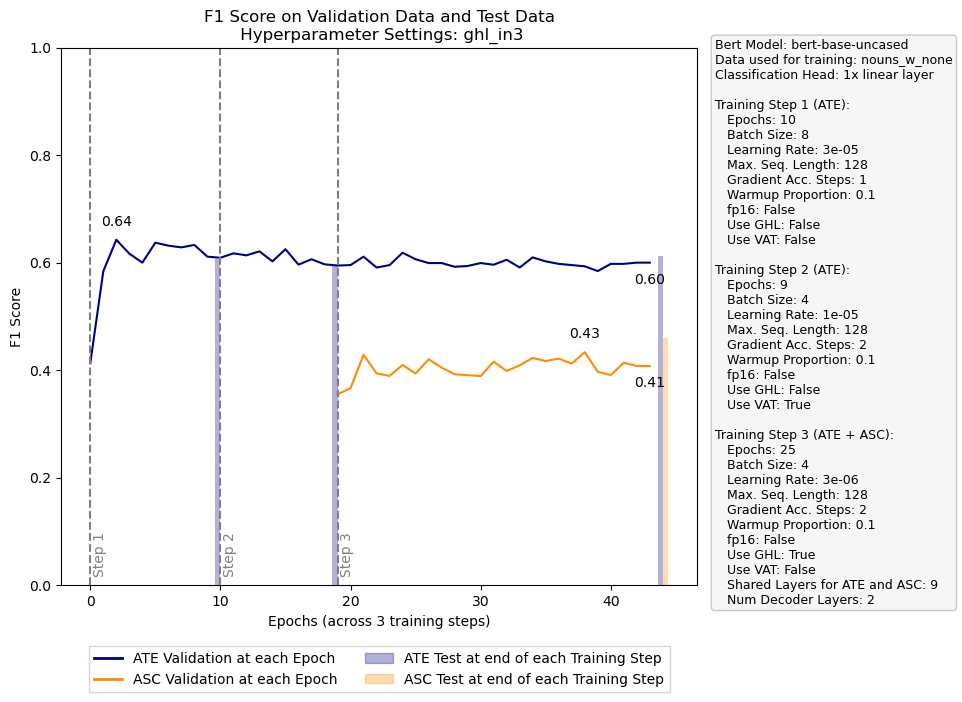

In [20]:
# name = 'ghl_in3'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'ghl_in3'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

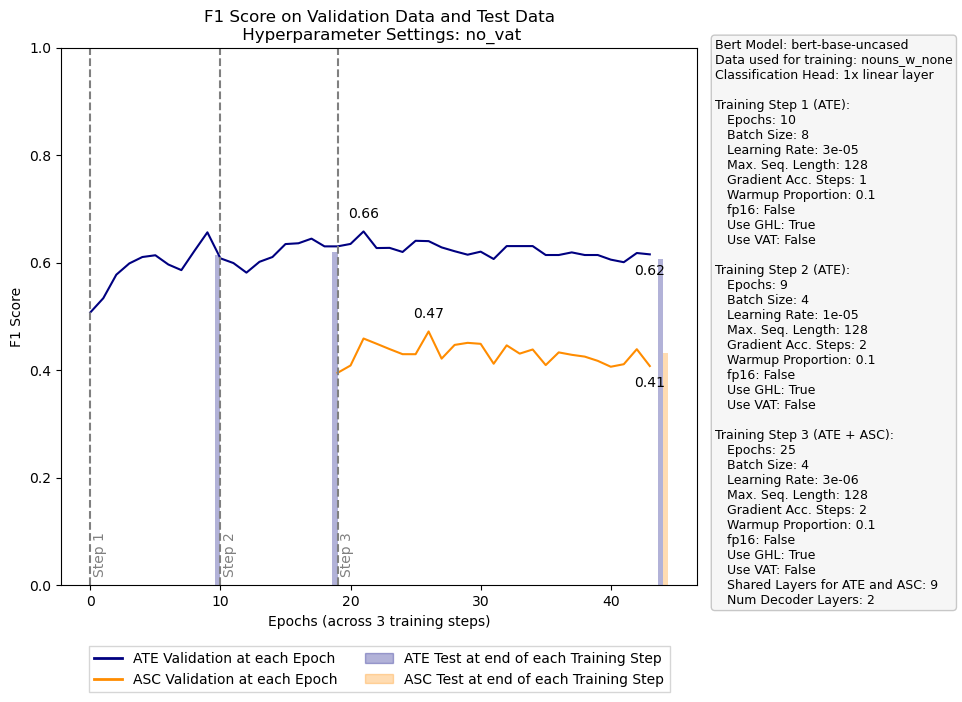

In [31]:
# name = 'no_vat'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'no_vat'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

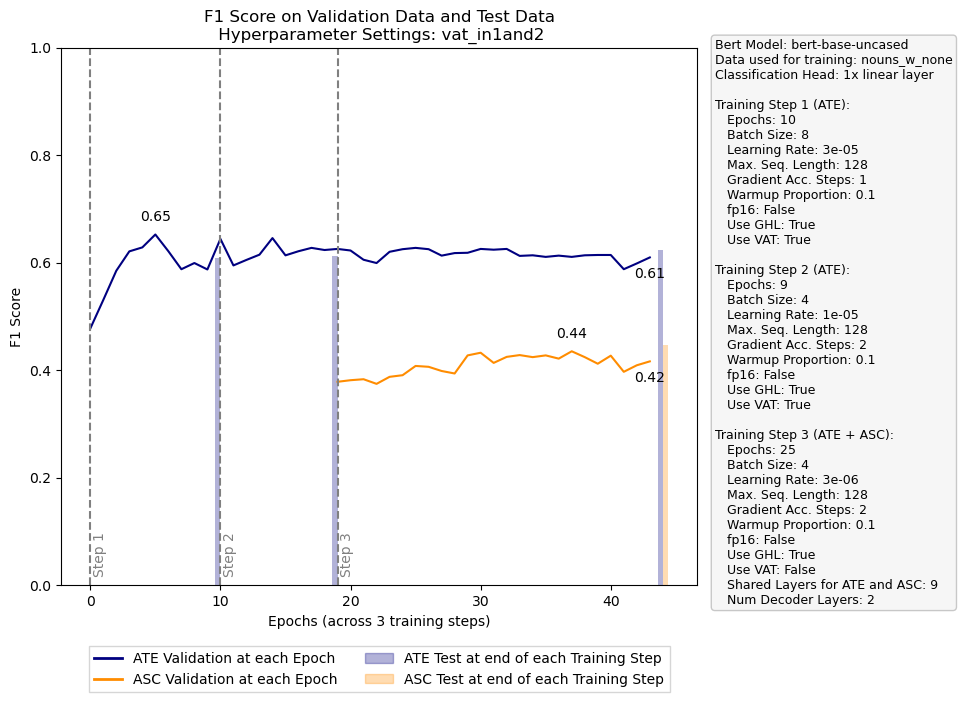

In [19]:
# name = 'vat_in1and2'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'vat_in1and2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

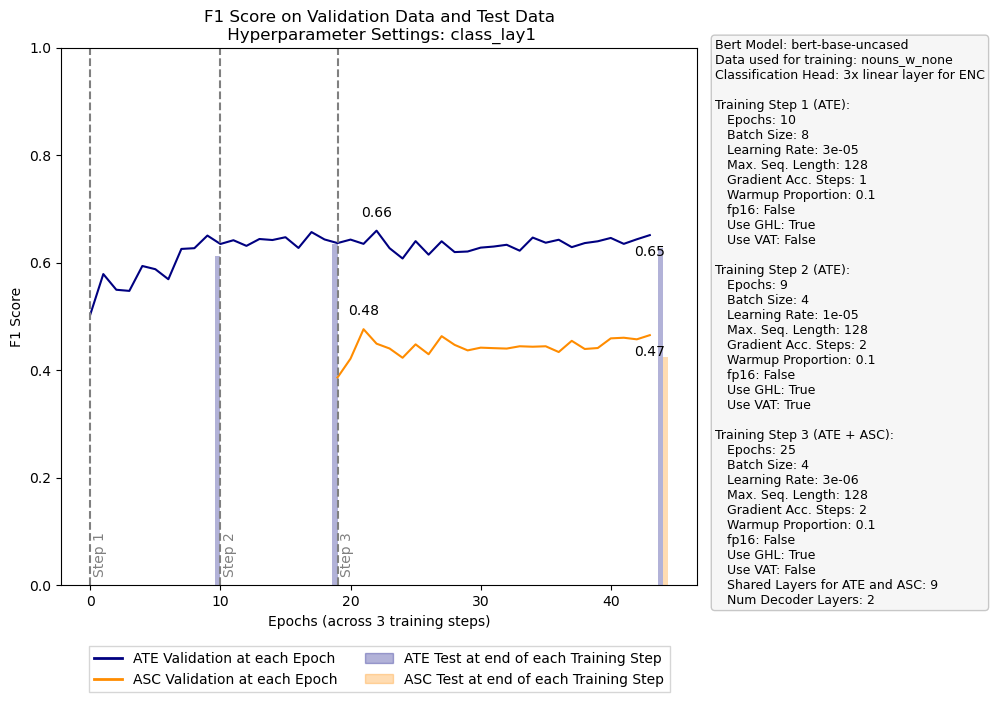

In [20]:
# name = 'class_lay1'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

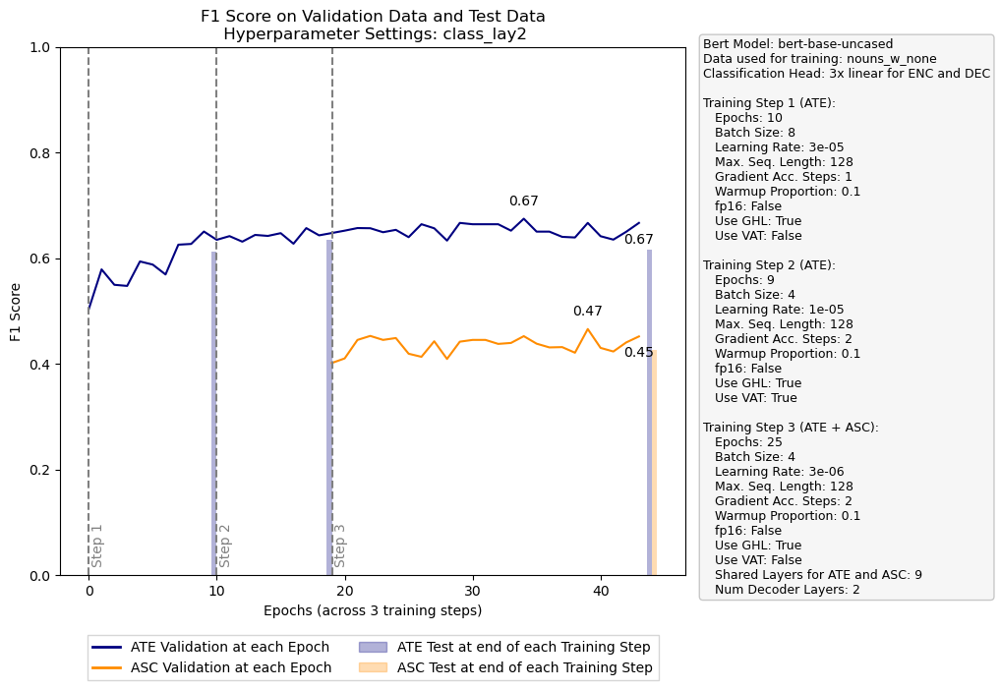

In [18]:
# name = 'class_lay2'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

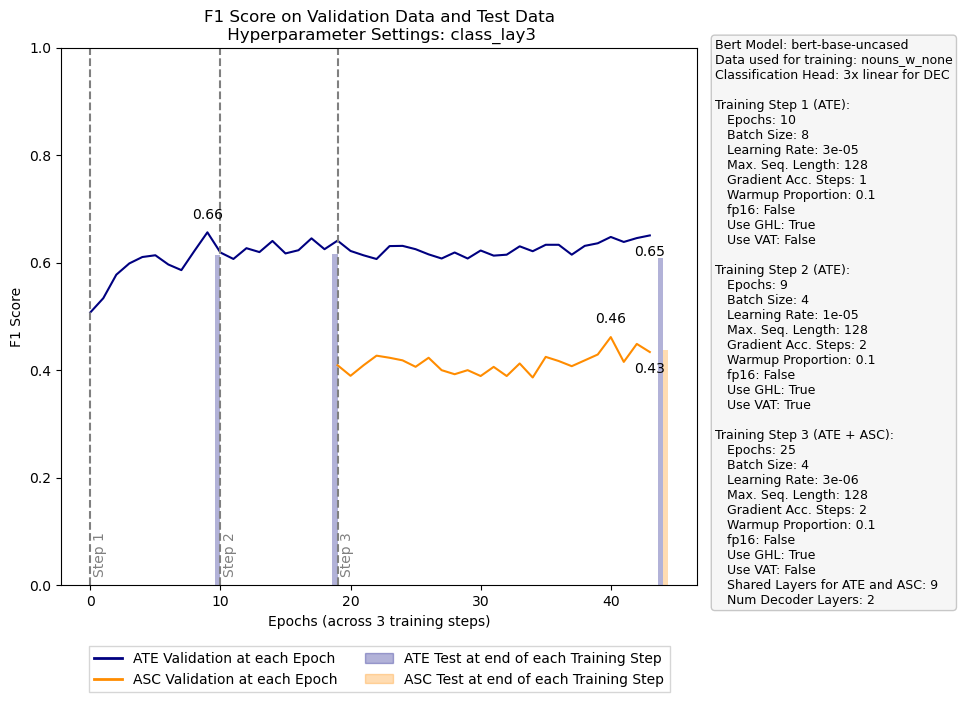

In [34]:
# name = 'class_lay3'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay3'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

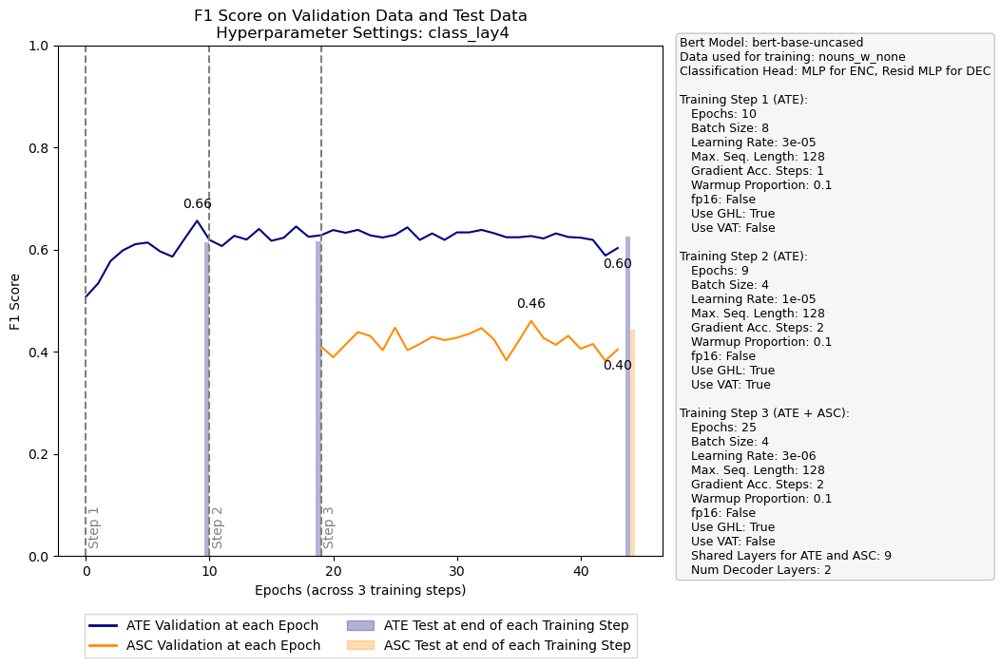

In [47]:
# name = 'class_lay4'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay4'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

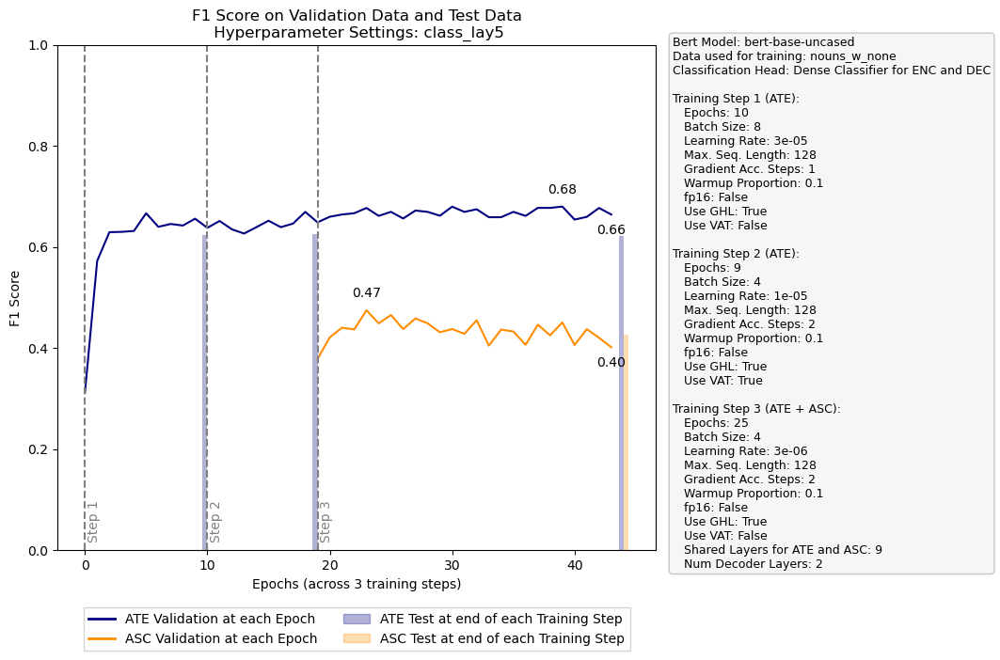

In [55]:
# name = 'class_lay5'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay5'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

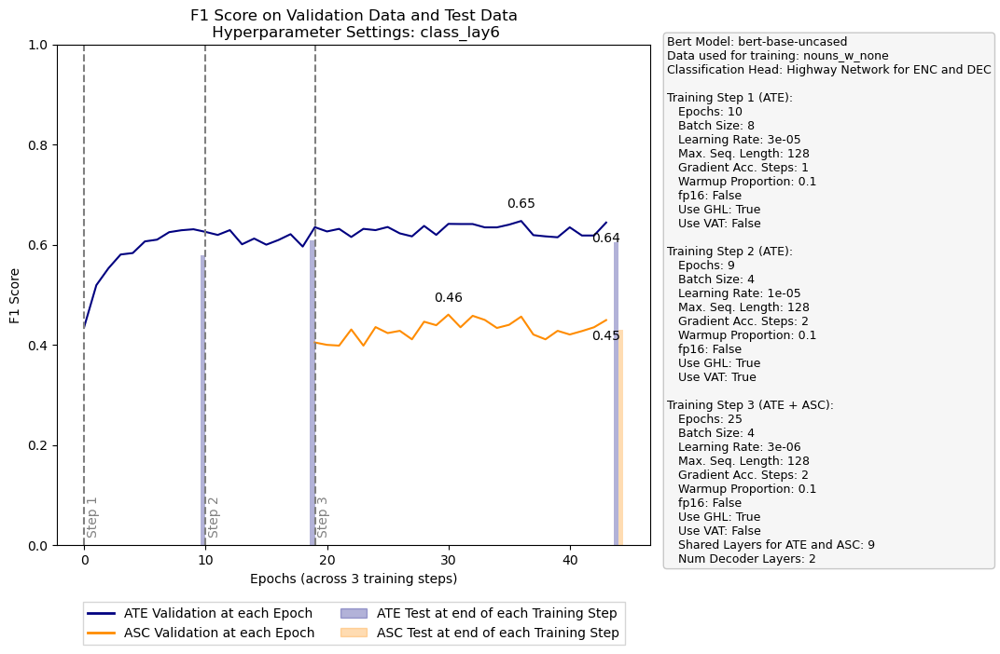

In [70]:
# name = 'class_lay6'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay6'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

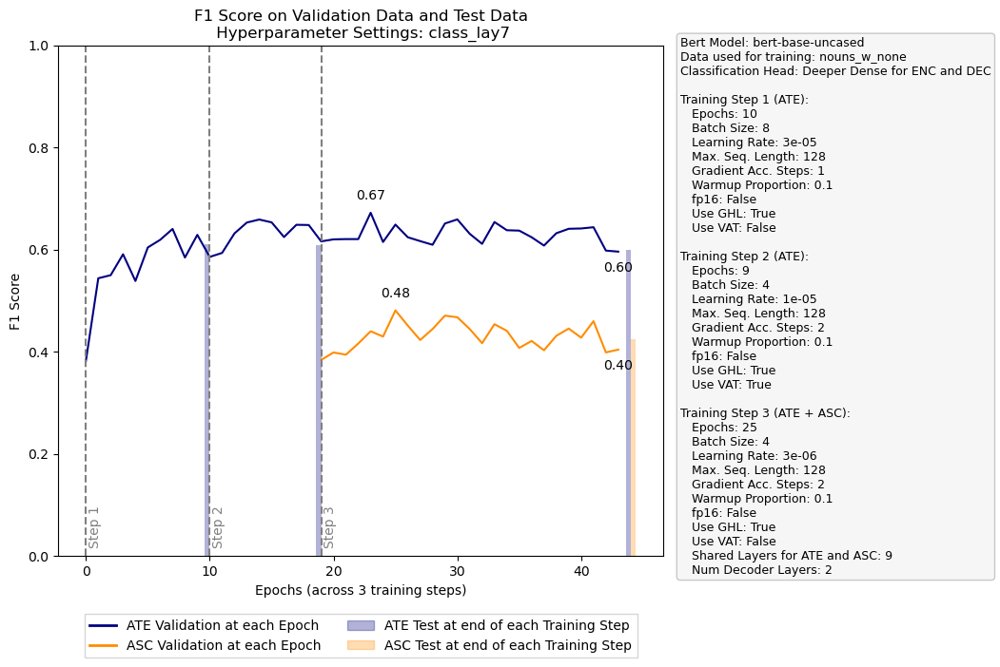

In [103]:
# name = 'class_lay7'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay7'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

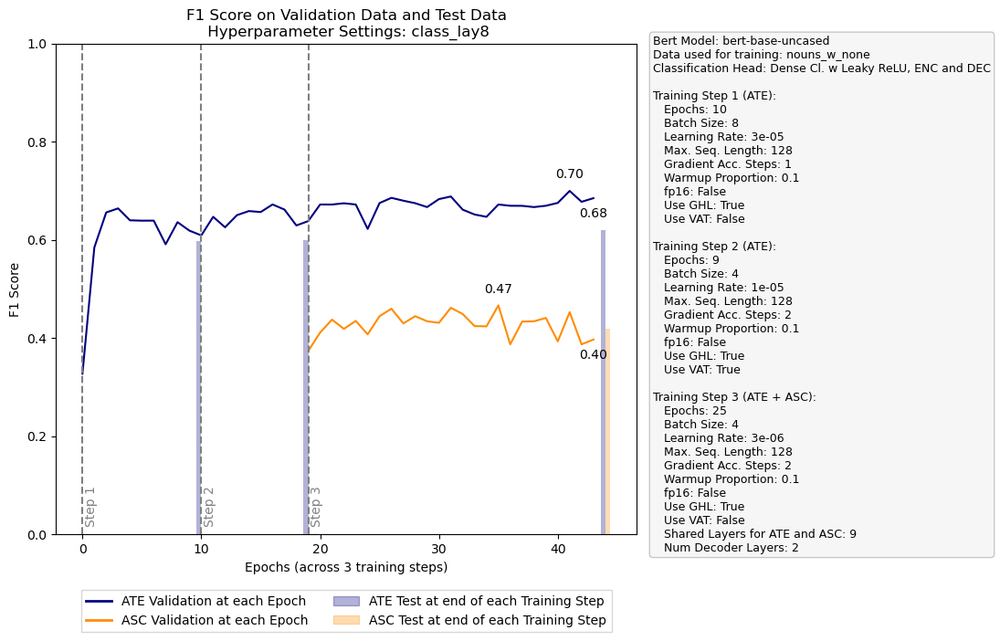

In [28]:
# name = 'class_lay8'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay8'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

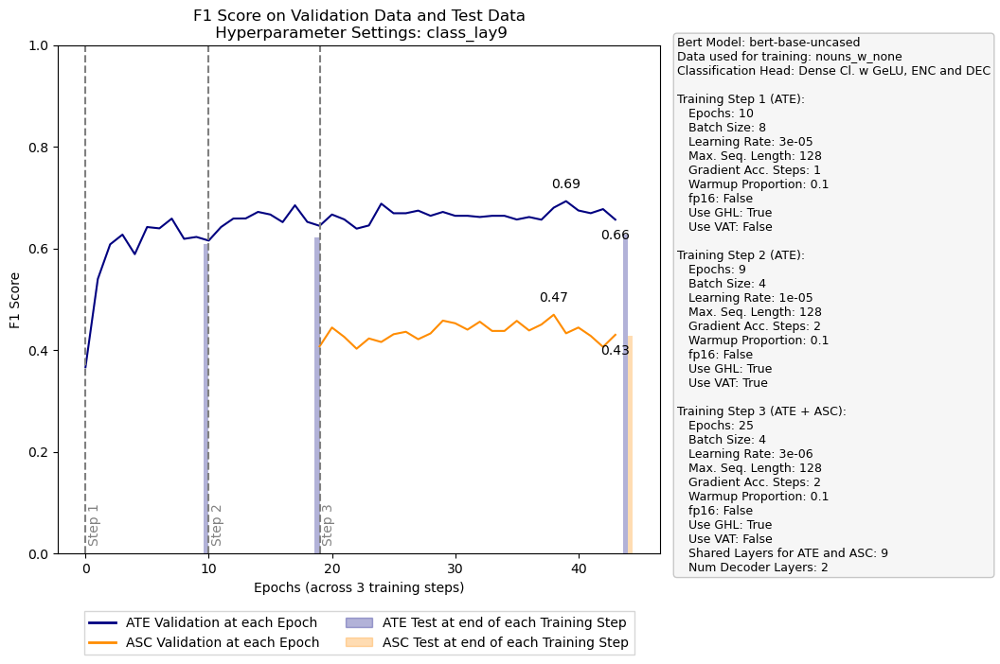

In [46]:
# name = 'class_lay9'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay9'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

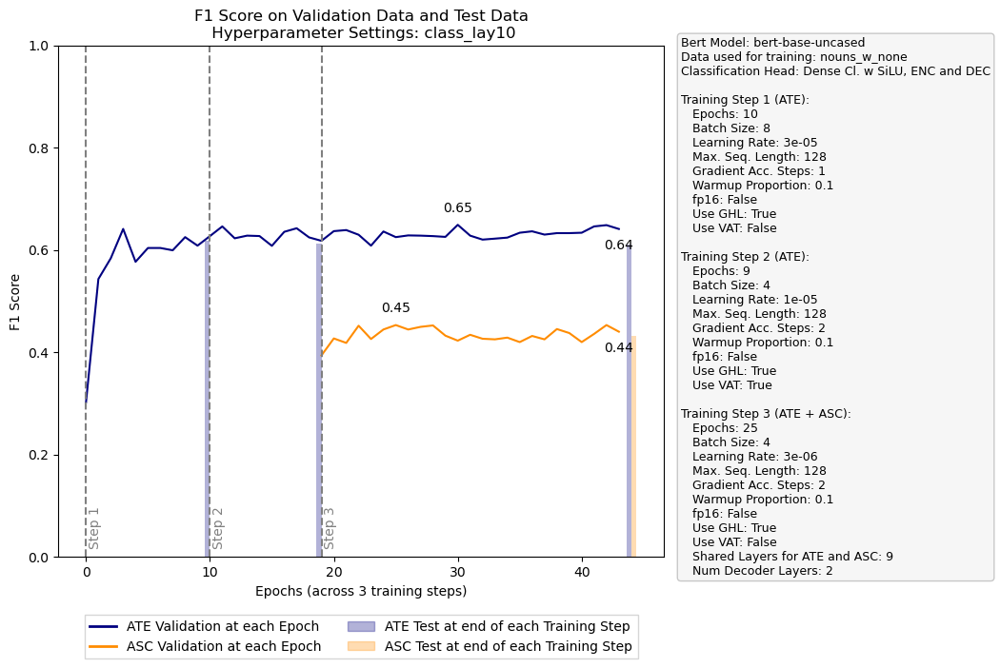

In [57]:
# name = 'class_lay10'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay10'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

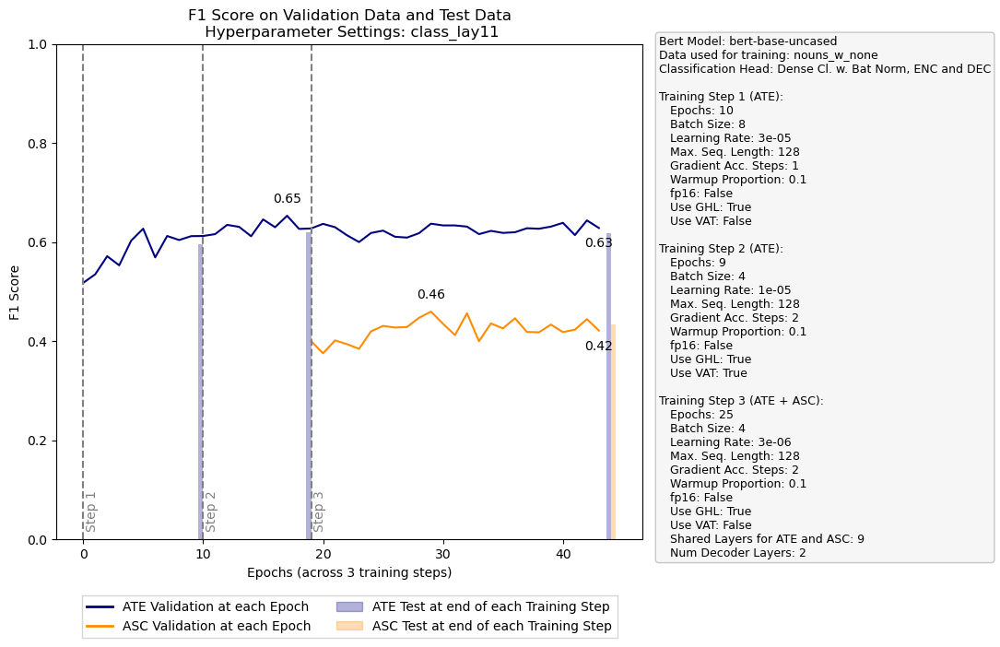

In [11]:
# name = 'class_lay11'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay11'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

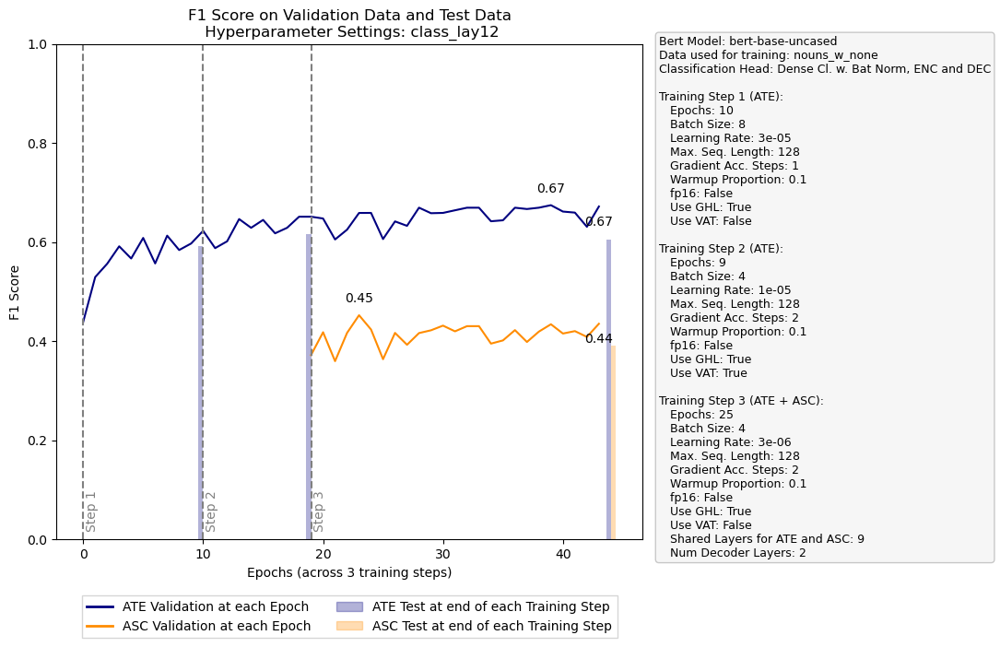

In [6]:
# name = 'class_lay12'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay12'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

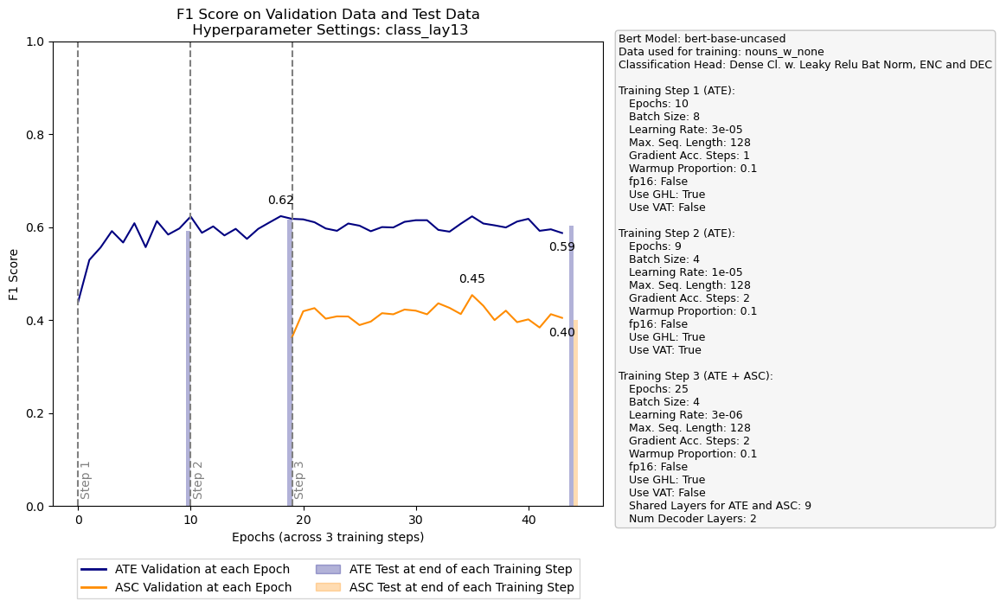

In [15]:
# name = 'class_lay13'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay13'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

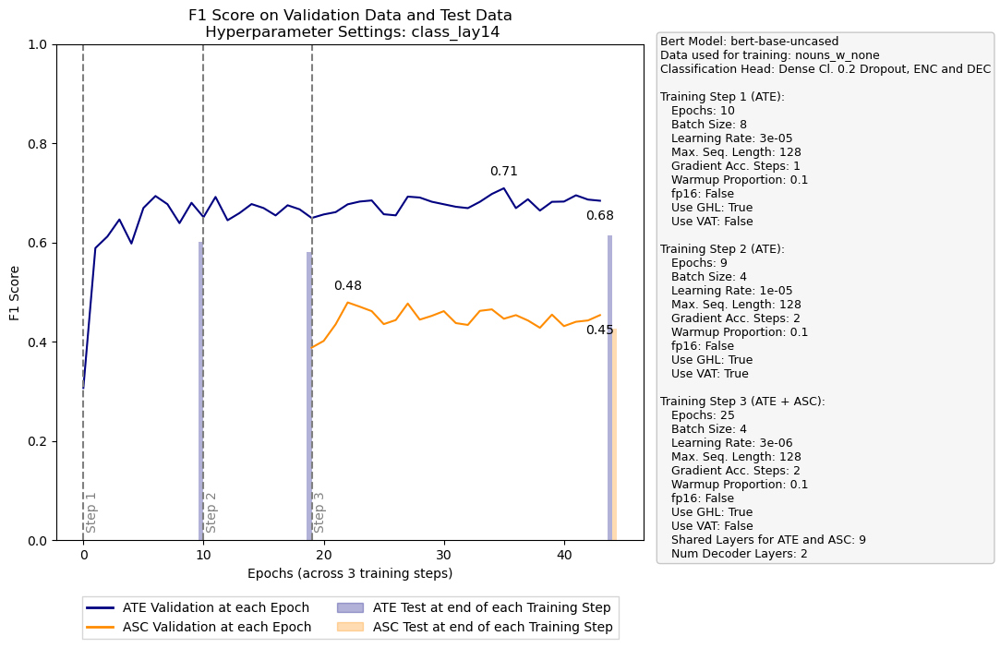

In [26]:
# name = 'class_lay14'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay14'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

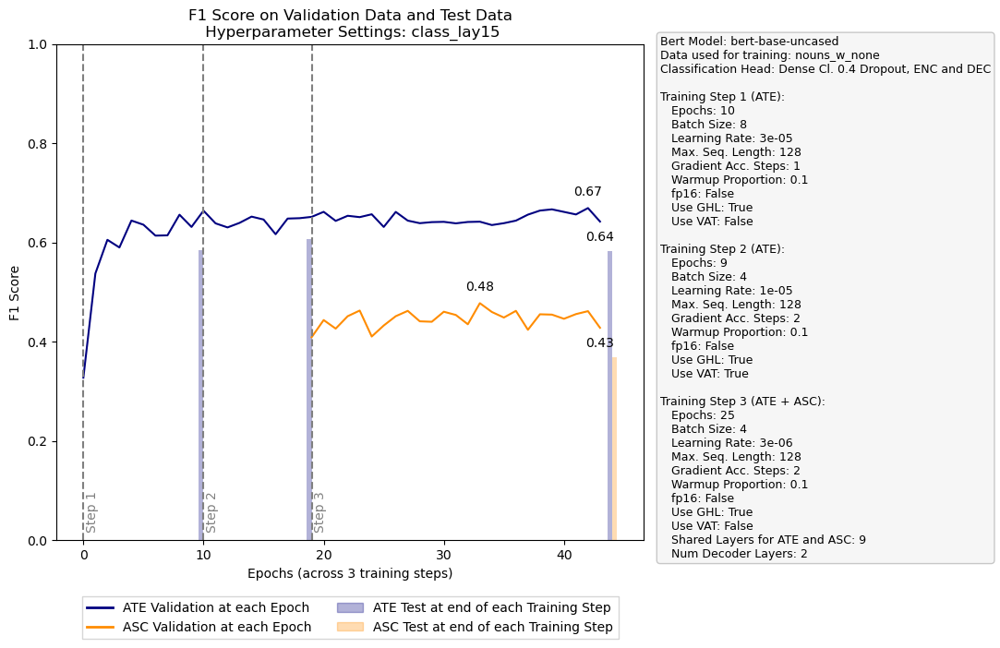

In [40]:
# name = 'class_lay15'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay15'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

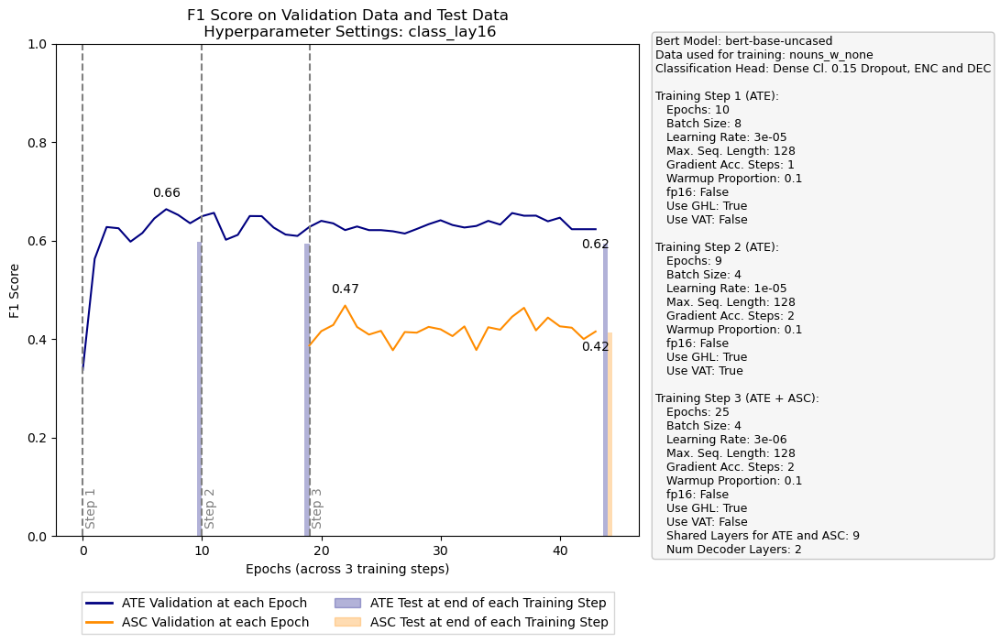

In [53]:
# name = 'class_lay16'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay16'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

#### Current Results

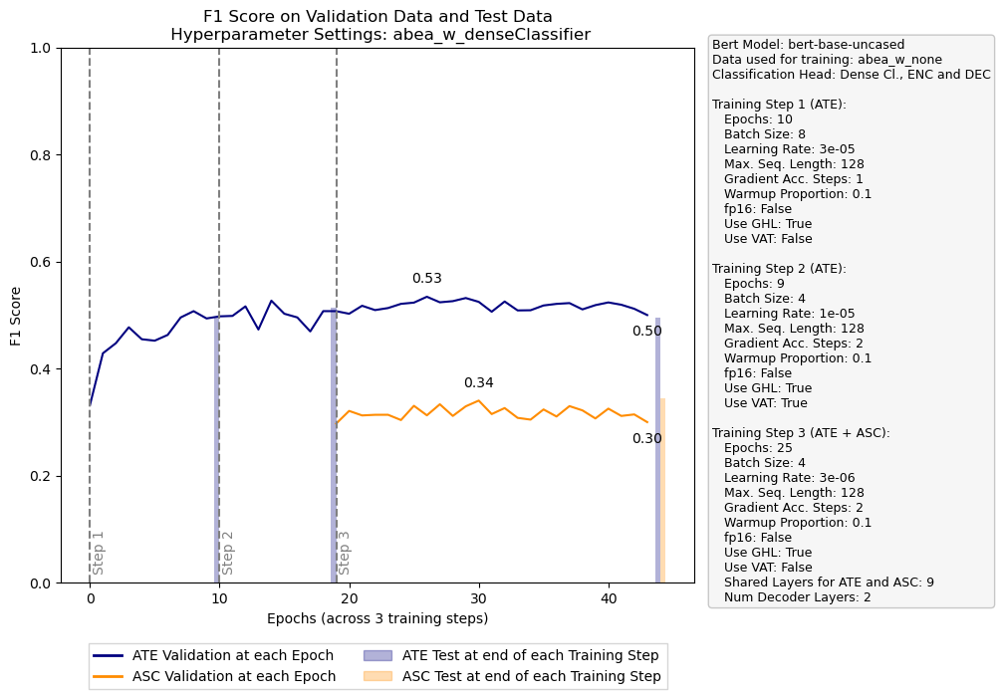

In [70]:
# name = 'abea_w_denseClassifier'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'abea_w_denseClassifier'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

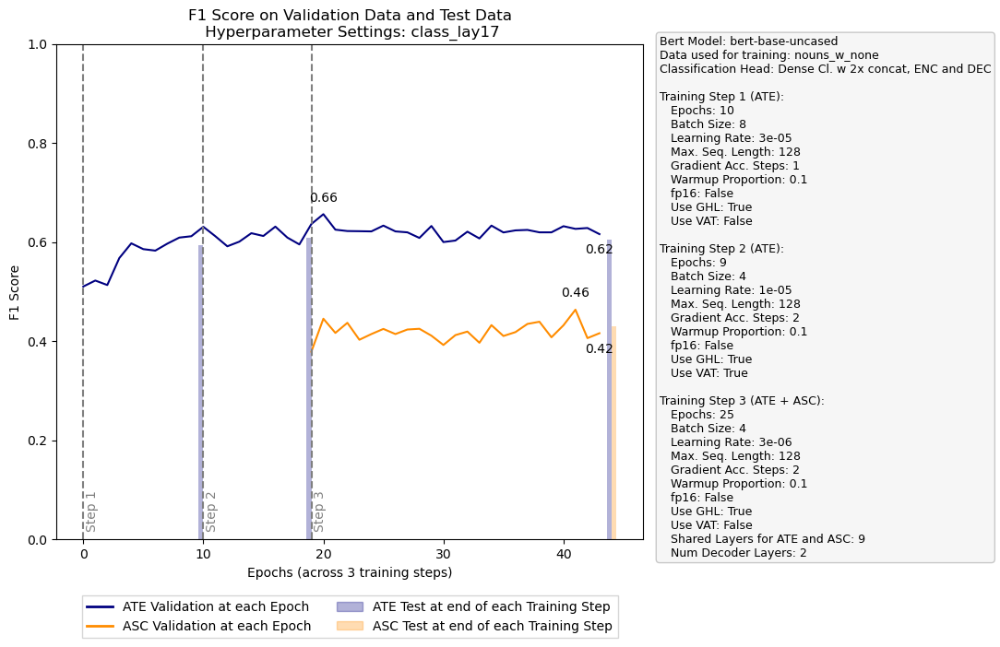

In [34]:
# name = 'class_lay17'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'class_lay17'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

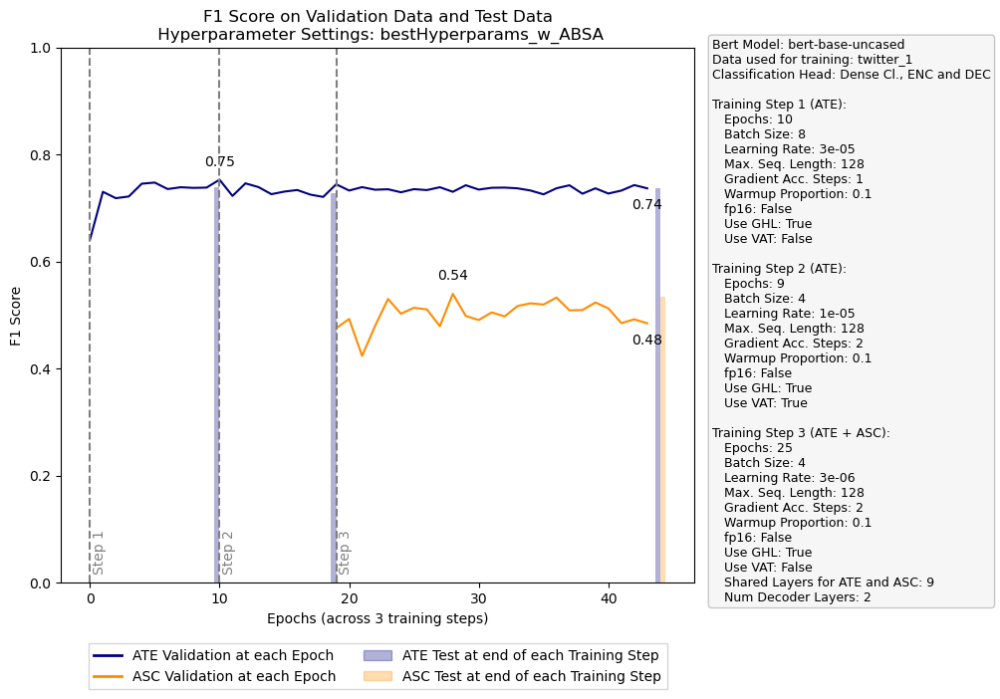

In [24]:
# name = 'bestHyperparams_w_ABSA'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'bestHyperparams_w_ABSA'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

AT: 65.3 in epoch 0
AS: 42.0 in epoch 3
Test Metrics AT: 65.9
Test Metrics AS: 42.9
F1 Score


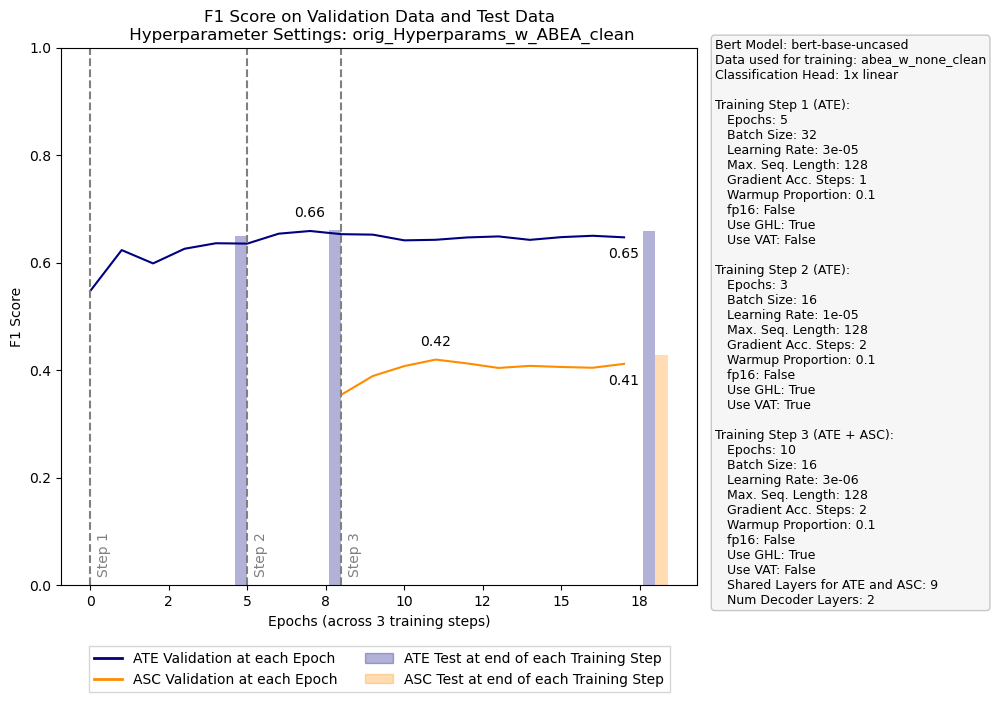

In [21]:
name = 'orig_Hyperparams_w_ABEA_clean'
file = 'GRACE/training_performance.json'
metric = "f1_score"

extract_highest_f1_score(file, name, metric)

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)



In [1]:
# name = 'bestHyperparams_w_ABSA'
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

extract_highest_f1_score(file, name, metric)

with open(file, 'r') as f:
    data = json.load(f)

data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
create_performance_chart(data_to_plot, metric, name)



NameError: name 'json' is not defined

## Old Attempts

#### New Attempts for More Epochs and More Decoder Layers

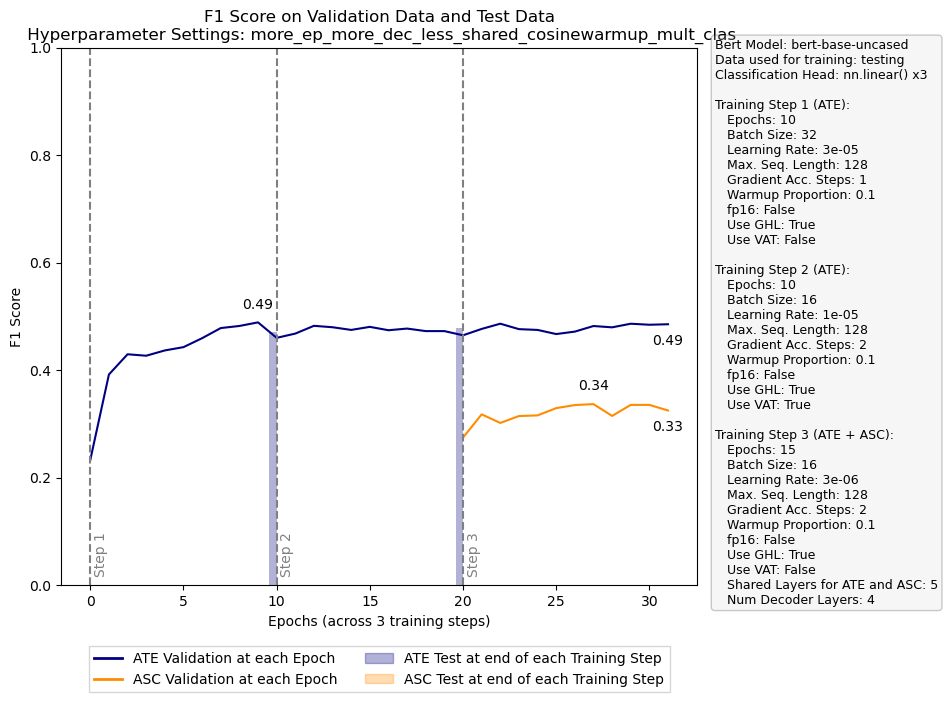

In [99]:
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'more_ep_more_dec_less_shared_cosinewarmup_mult_clas'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

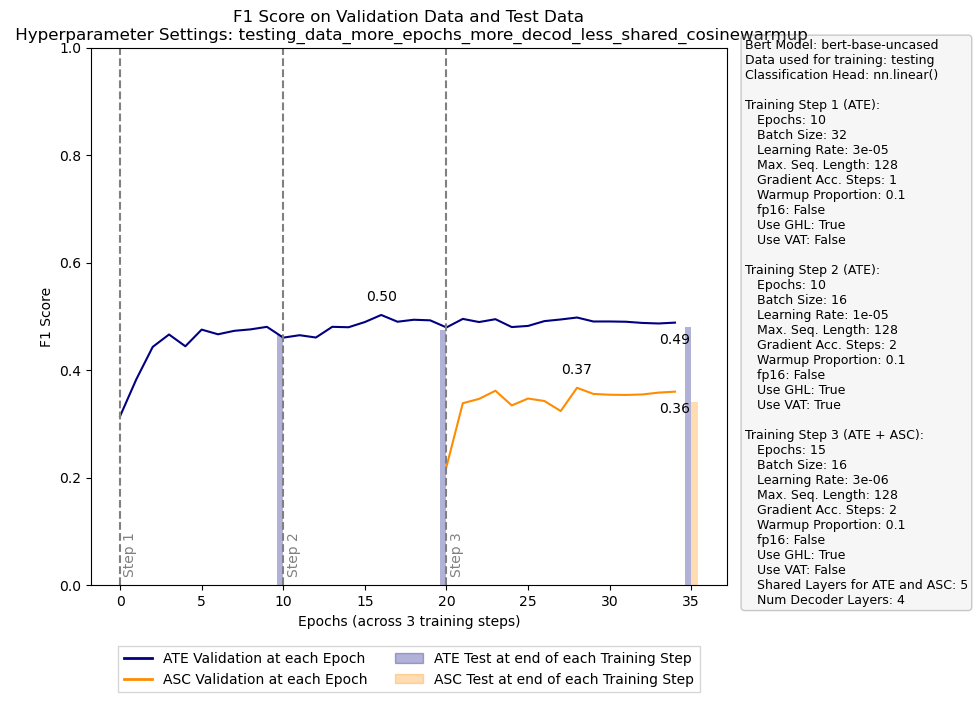

In [89]:
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'testing_data_more_epochs_more_decod_less_shared_cosinewarmup'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

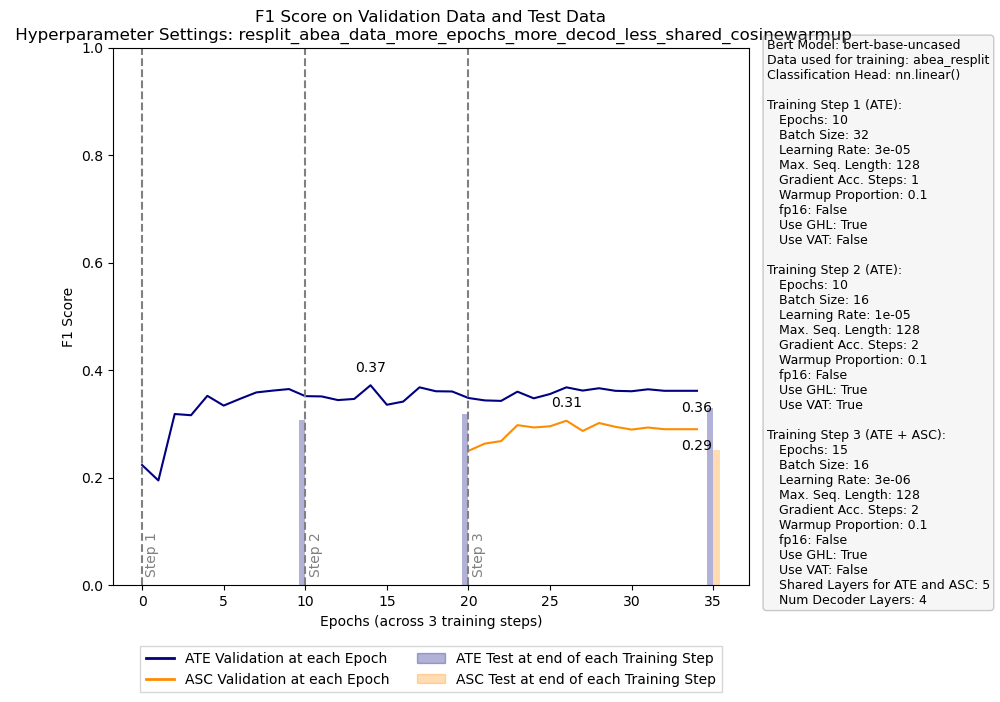

In [71]:
# name = ['redo_more_epochs_more_decoder_layers', 'new_even_more_epochs_more_decoder_layers']

# ORIGINAL

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'resplit_abea_data_more_epochs_more_decod_less_shared_cosinewarmup'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

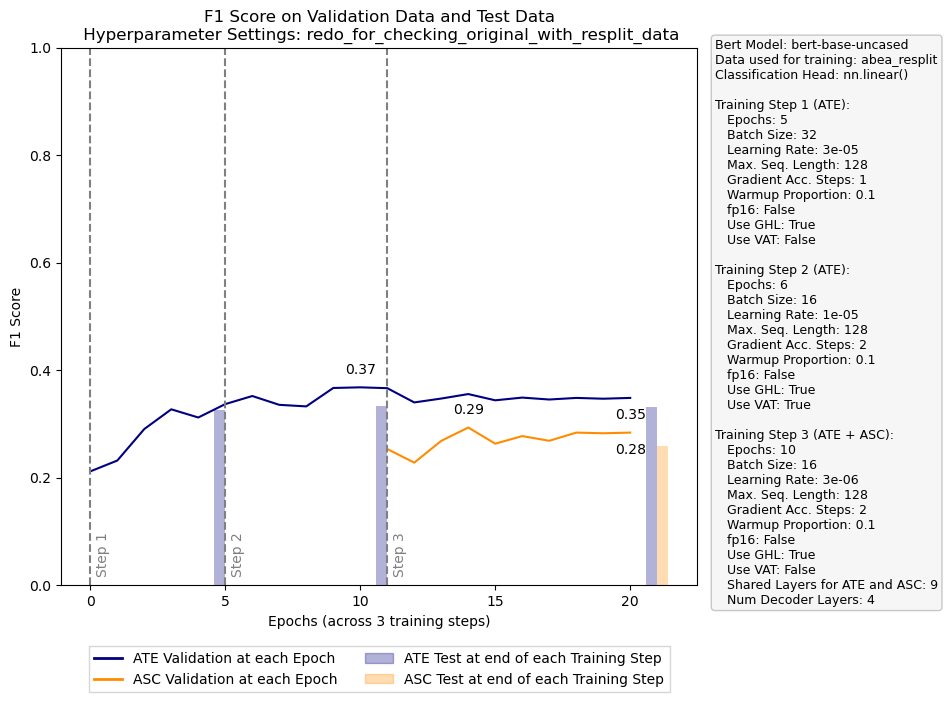

In [62]:
# name = ['redo_more_epochs_more_decoder_layers', 'new_even_more_epochs_more_decoder_layers']

# ORIGINAL

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'redo_for_checking_original_with_resplit_data'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

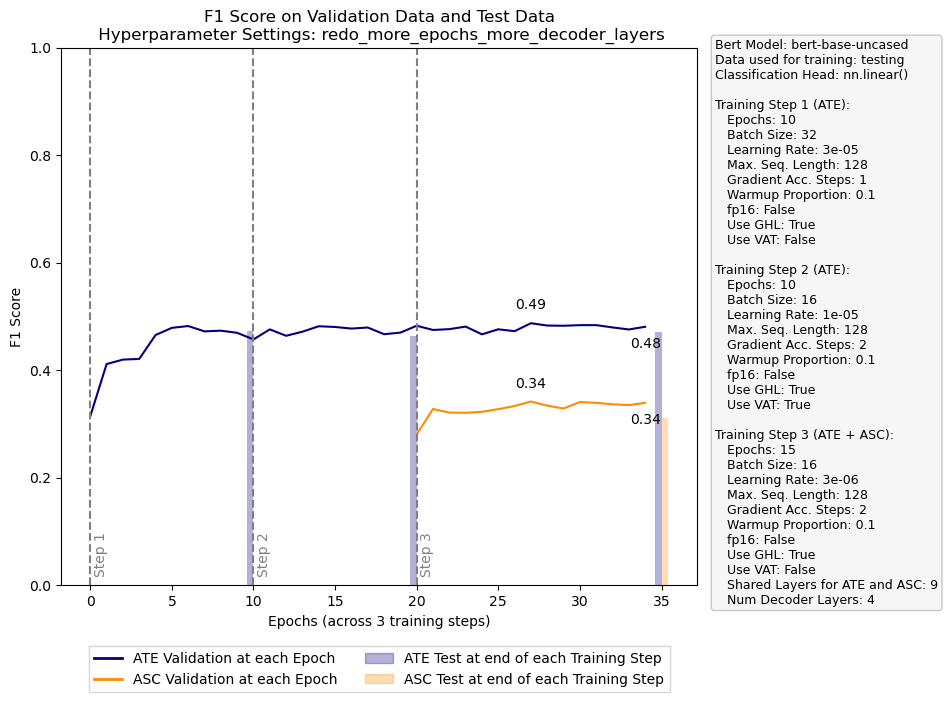

In [15]:
# name = ['redo_more_epochs_more_decoder_layers', 'new_even_more_epochs_more_decoder_layers']

# ORIGINAL

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'redo_more_epochs_more_decoder_layers'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

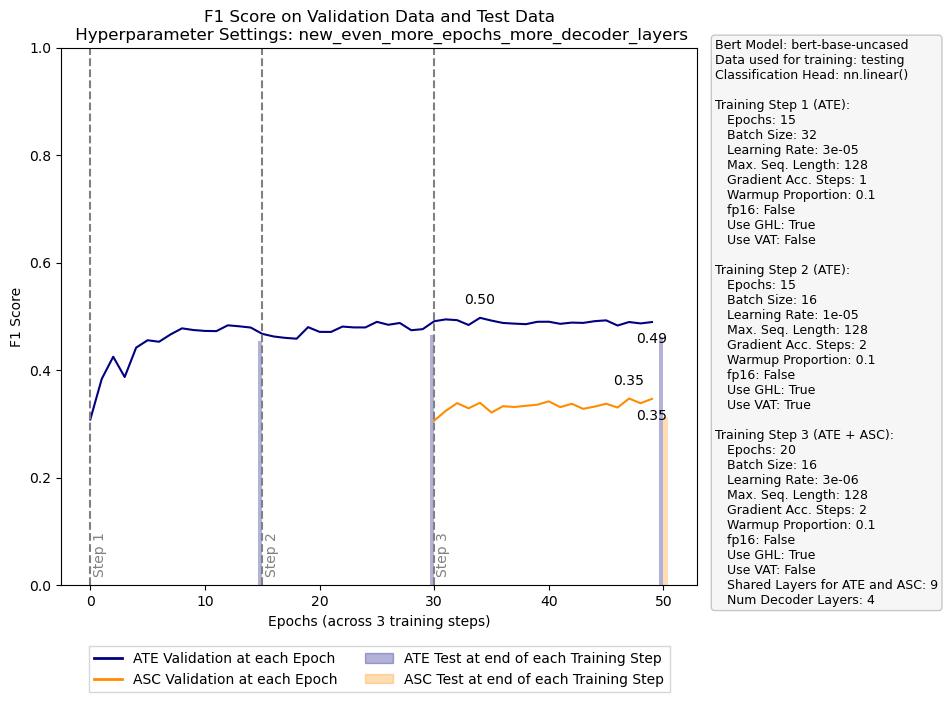

In [27]:
# name = ['redo_more_epochs_more_decoder_layers', 'new_even_more_epochs_more_decoder_layers']

# ORIGINAL

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'new_even_more_epochs_more_decoder_layers'
# name = 'less_decoder_layers'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

#### Results on Refined (checked) ABEA Dataset

##### previous

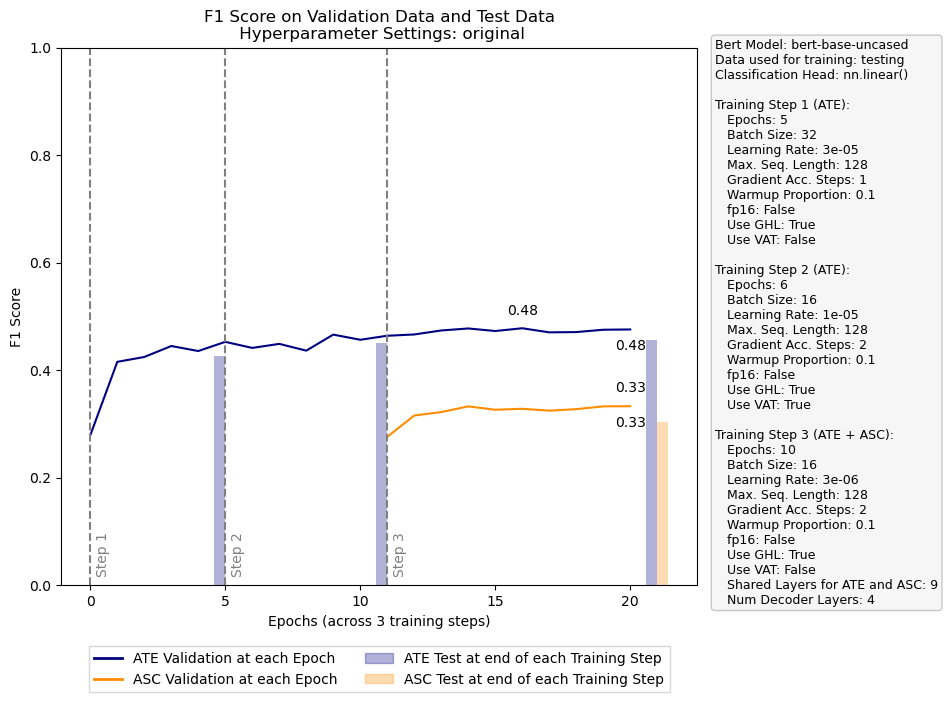

In [15]:
# ORIGINAL

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'original'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

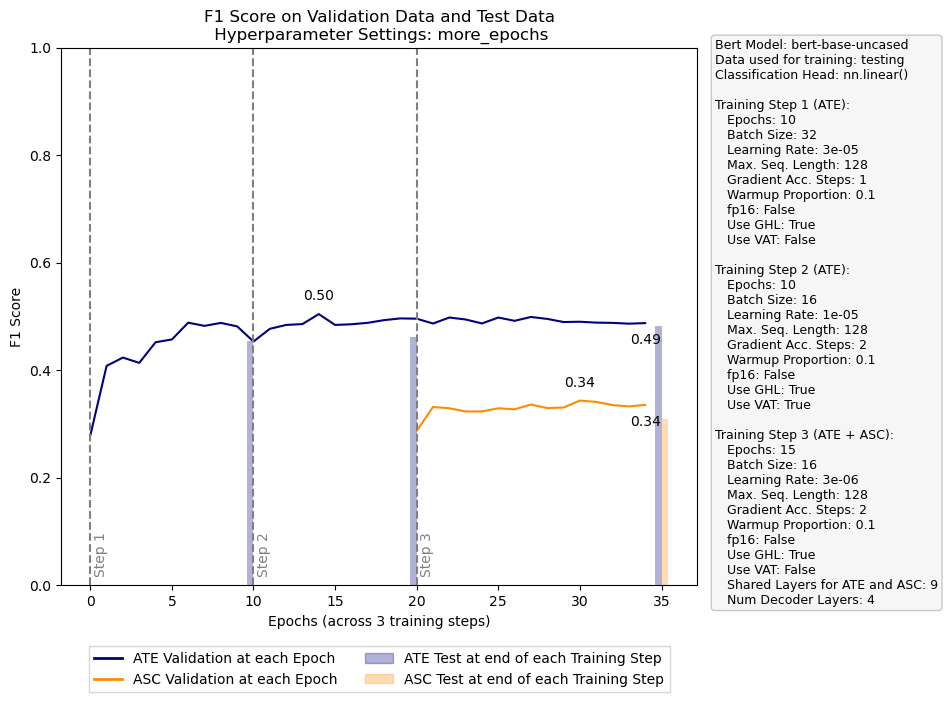

In [23]:
# MORE EPOCHS

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'more_epochs'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

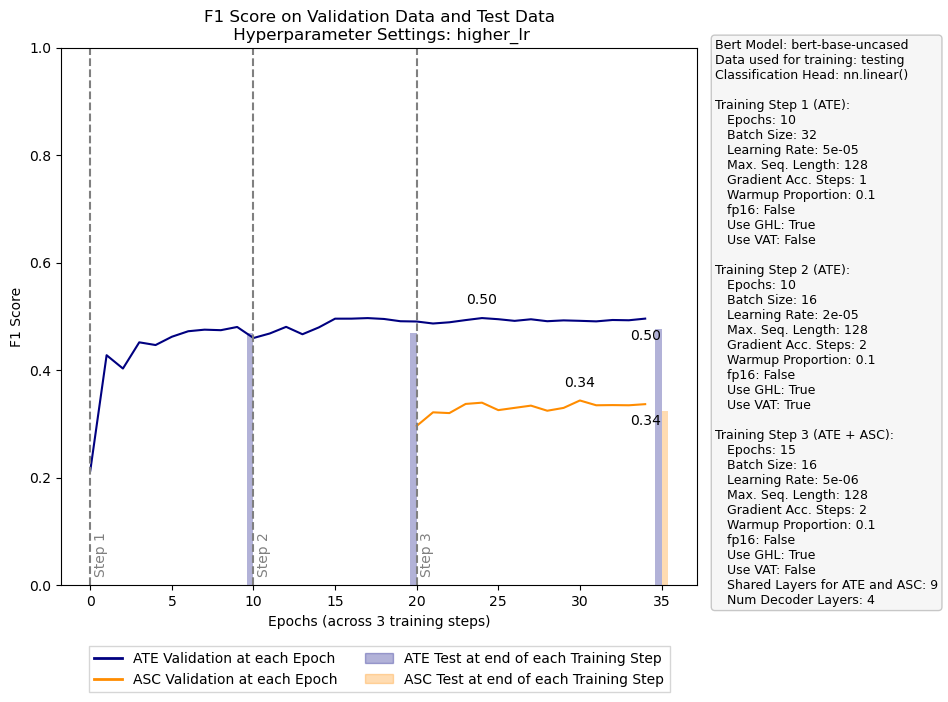

In [26]:
# HIGHER LEARNING RATES

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'higher_lr'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

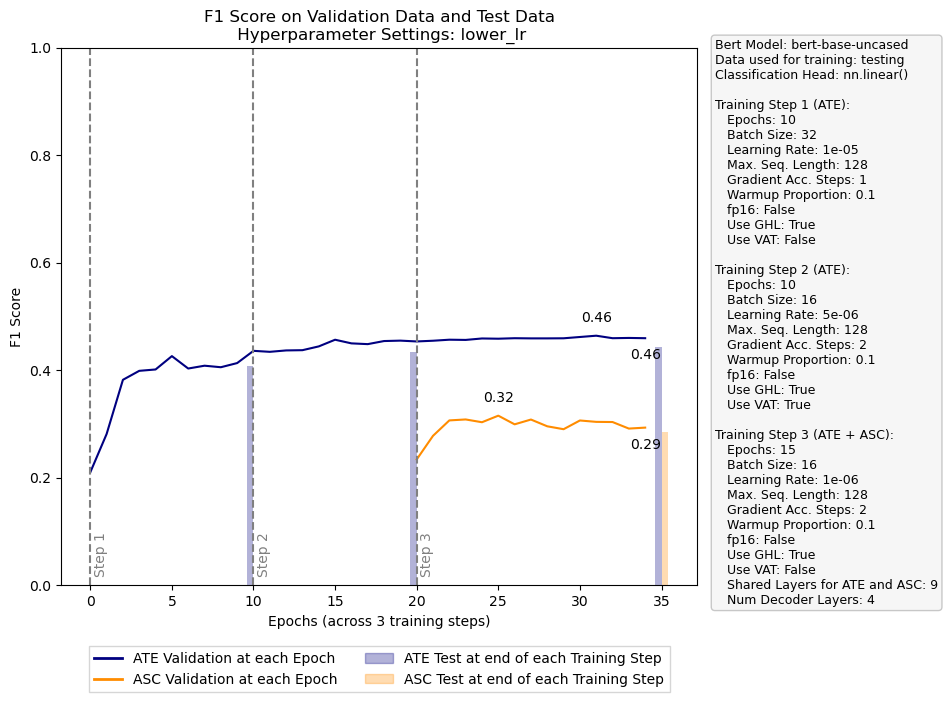

In [27]:
# LOWER LEARNING RATES

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'lower_lr'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

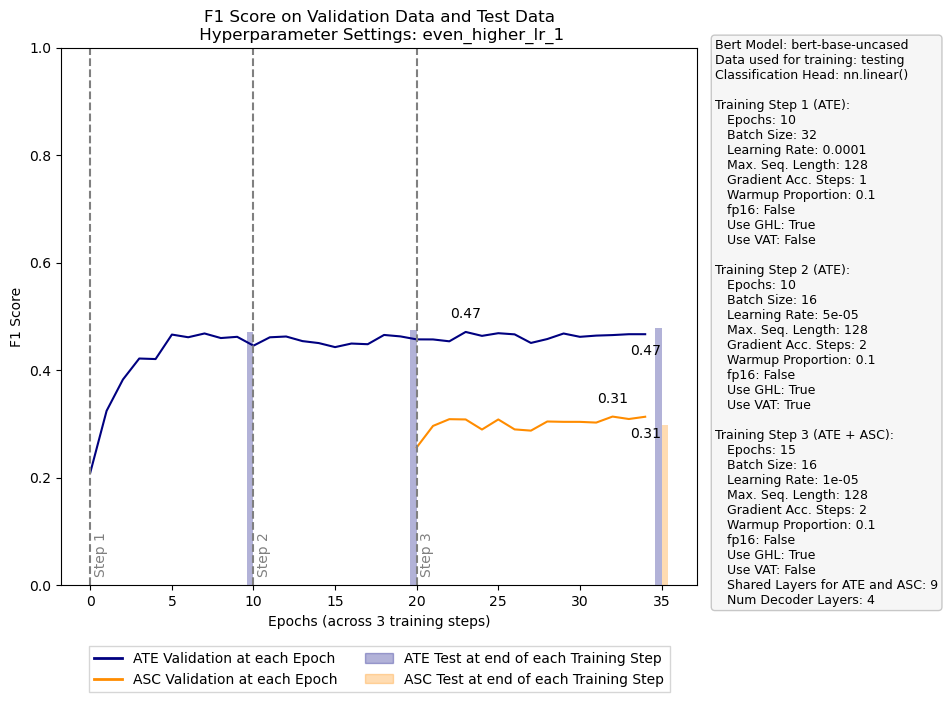

In [12]:
# LOWER LEARNING RATES

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'even_higher_lr_1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

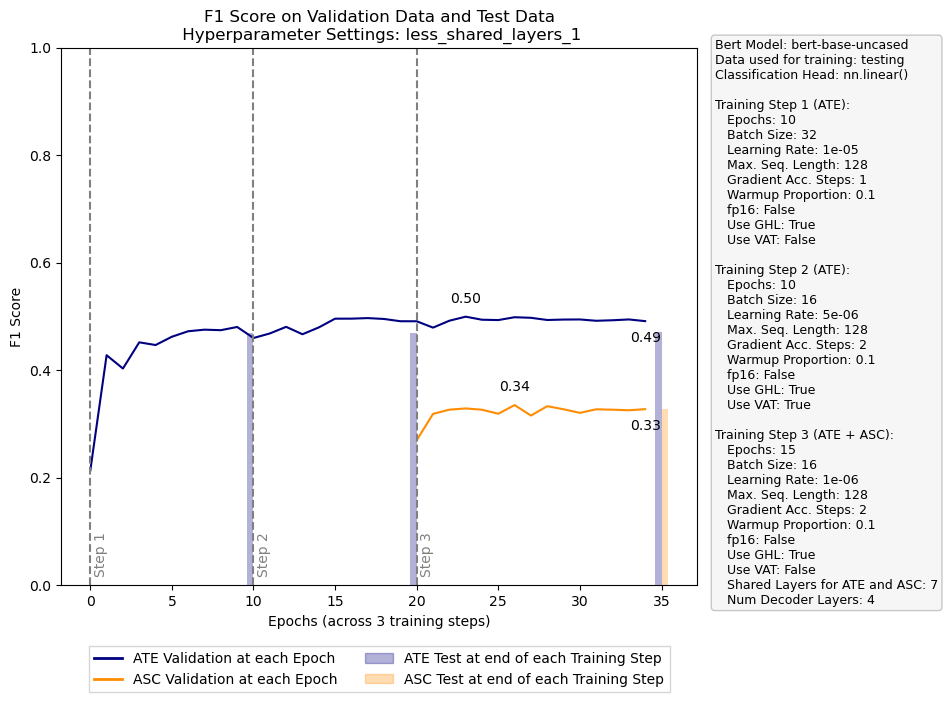

In [28]:
# LESS SHARED LAYERS

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

# name = ['less_shared_layers_1', 'less_shared_layers_2', 'more_shared_layers']

name = 'less_shared_layers_1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

### current

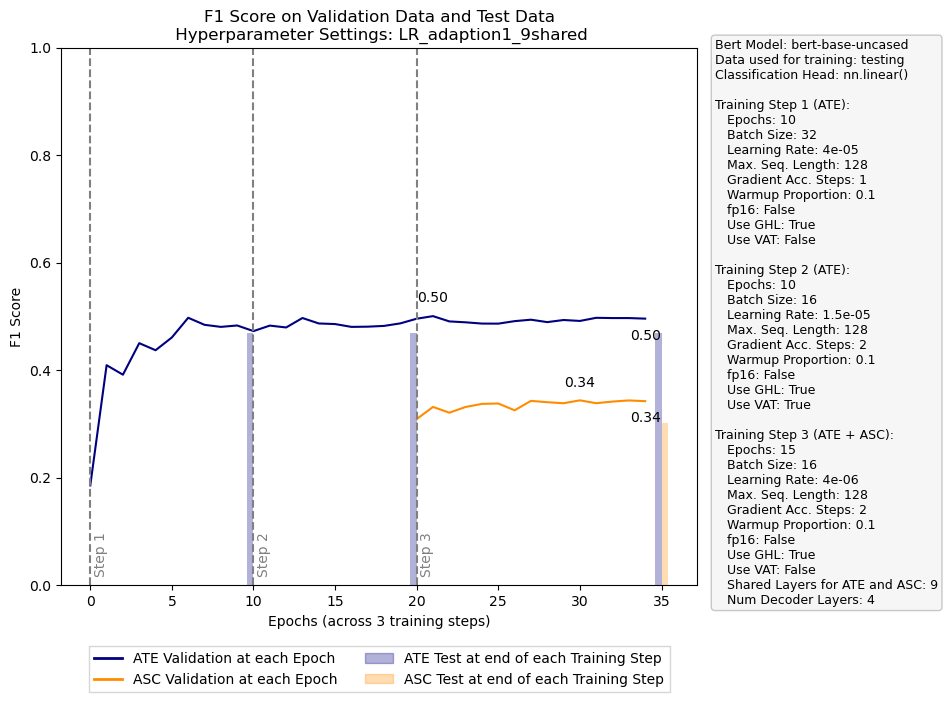

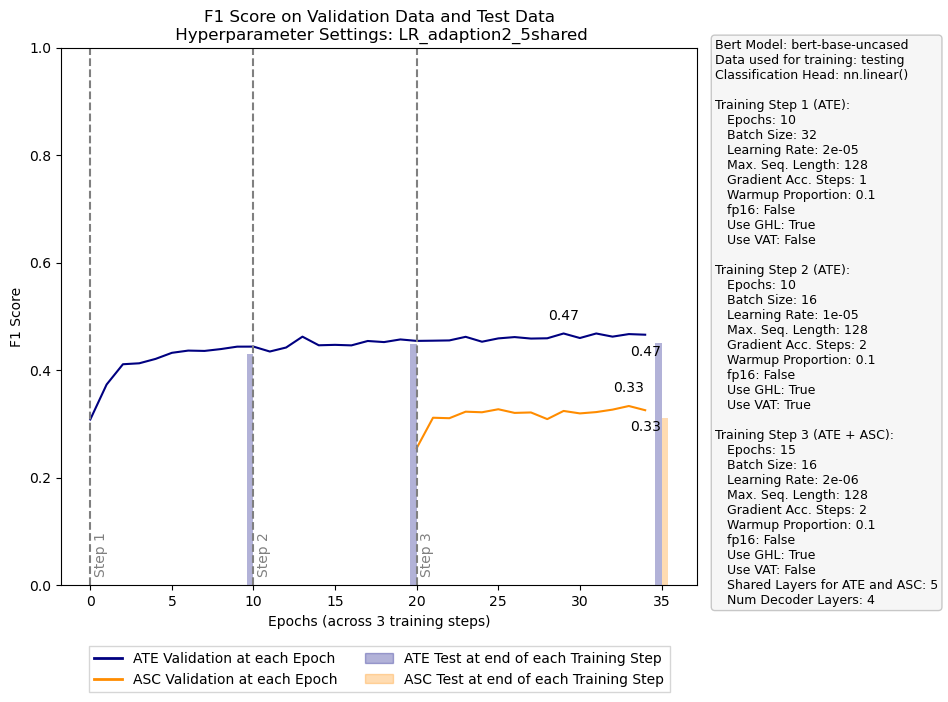

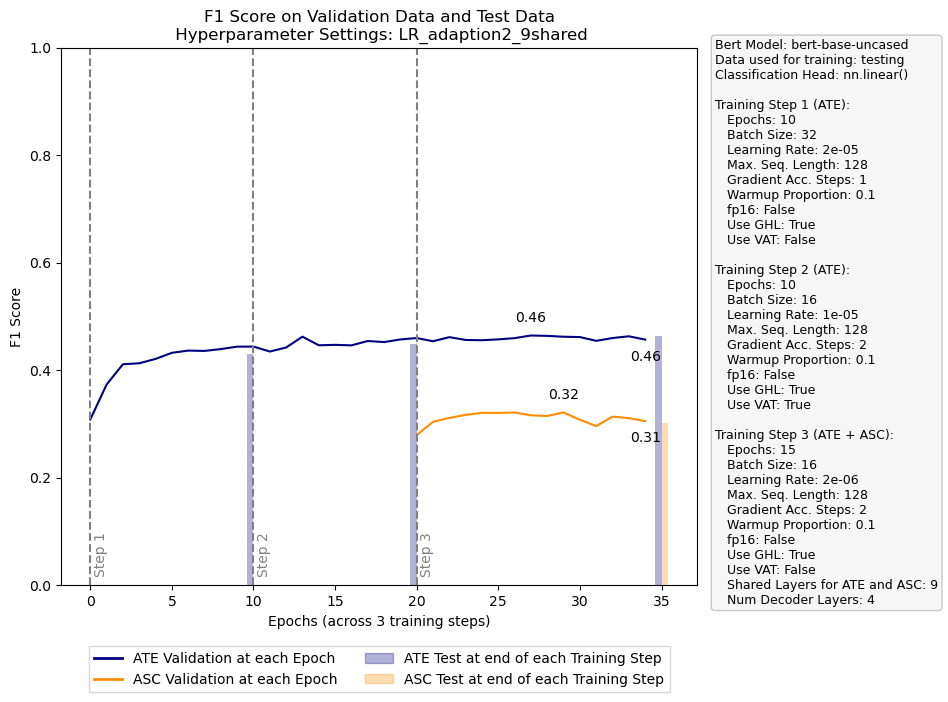

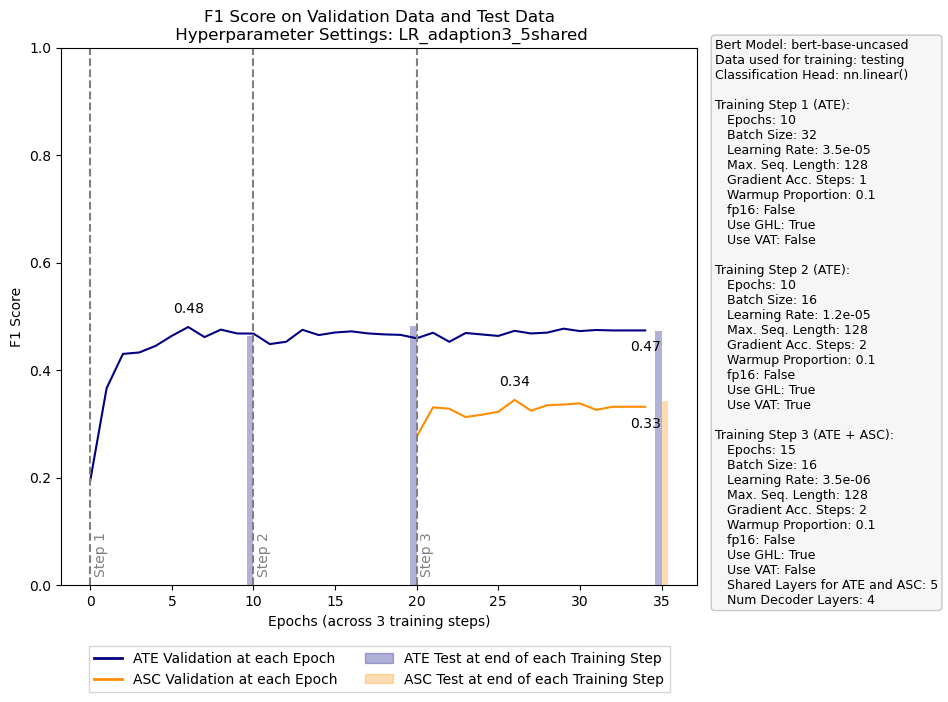

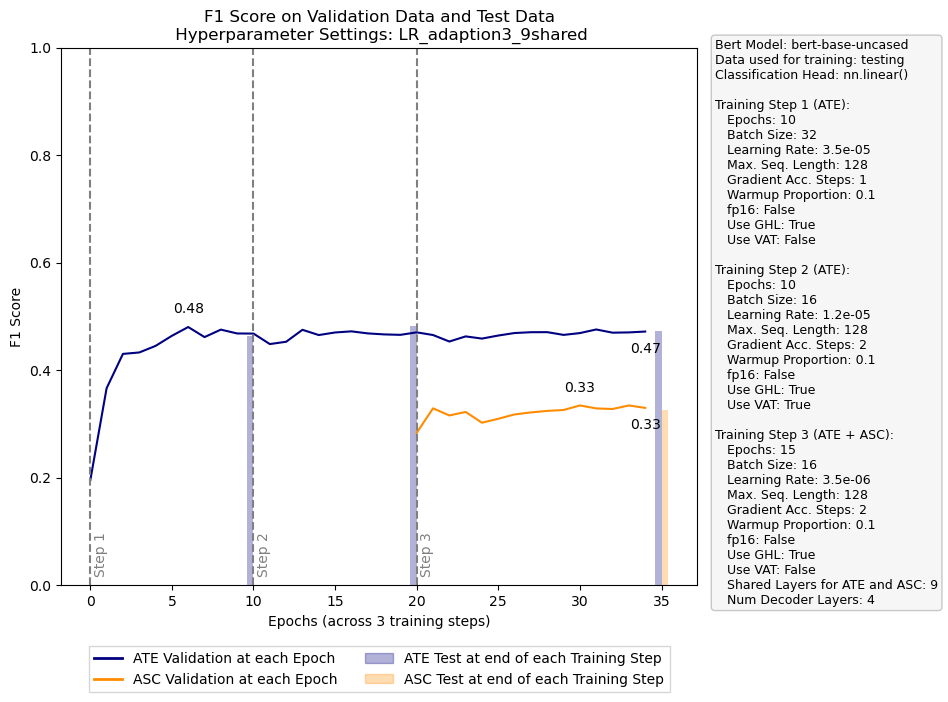

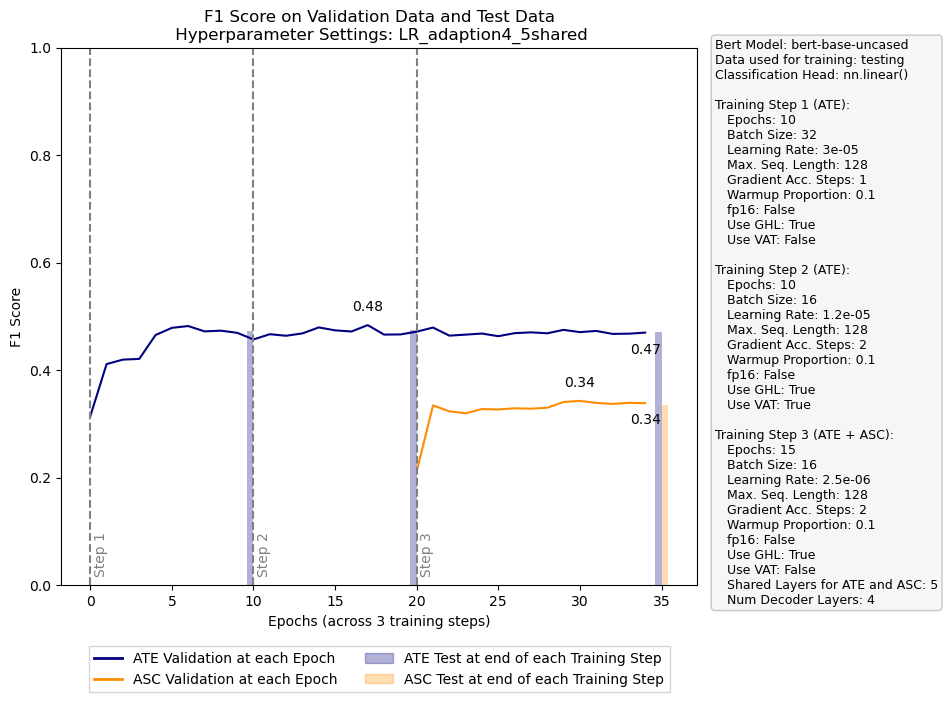

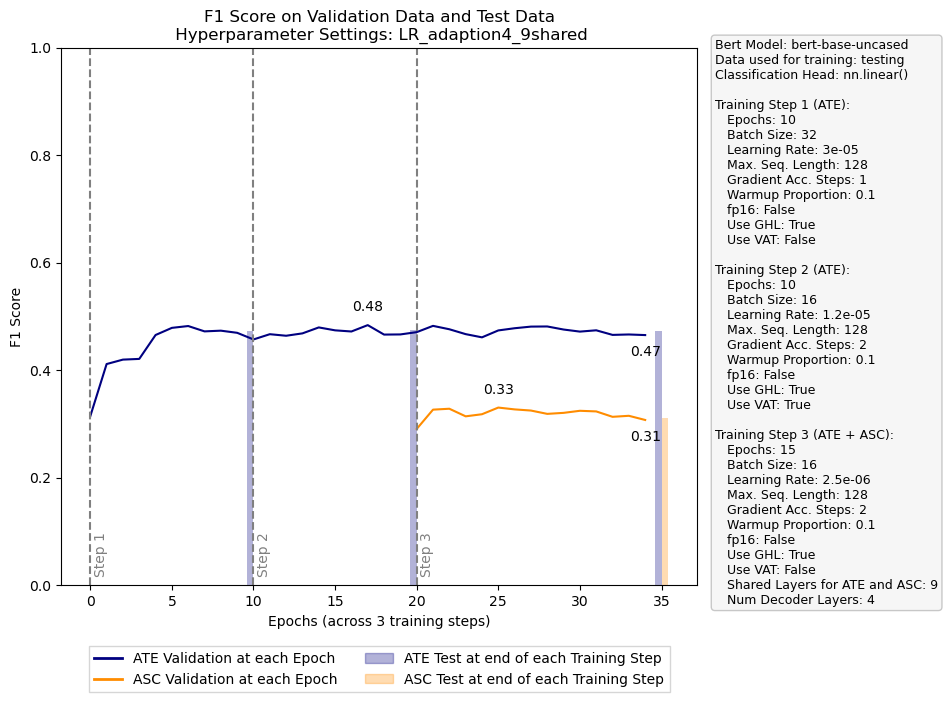

In [5]:
names = ['LR_adaption1_9shared', 'LR_adaption2_5shared', 'LR_adaption2_9shared', 'LR_adaption3_5shared', 'LR_adaption3_9shared', 'LR_adaption4_5shared', 'LR_adaption4_9shared']

for i in range(len(names)):
    with open('GRACE/training_performance.json', 'r') as f:
        data = json.load(f)

    name = names[i]
    data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
    metric = "f1_score"

    create_performance_chart(data_to_plot, metric, name)

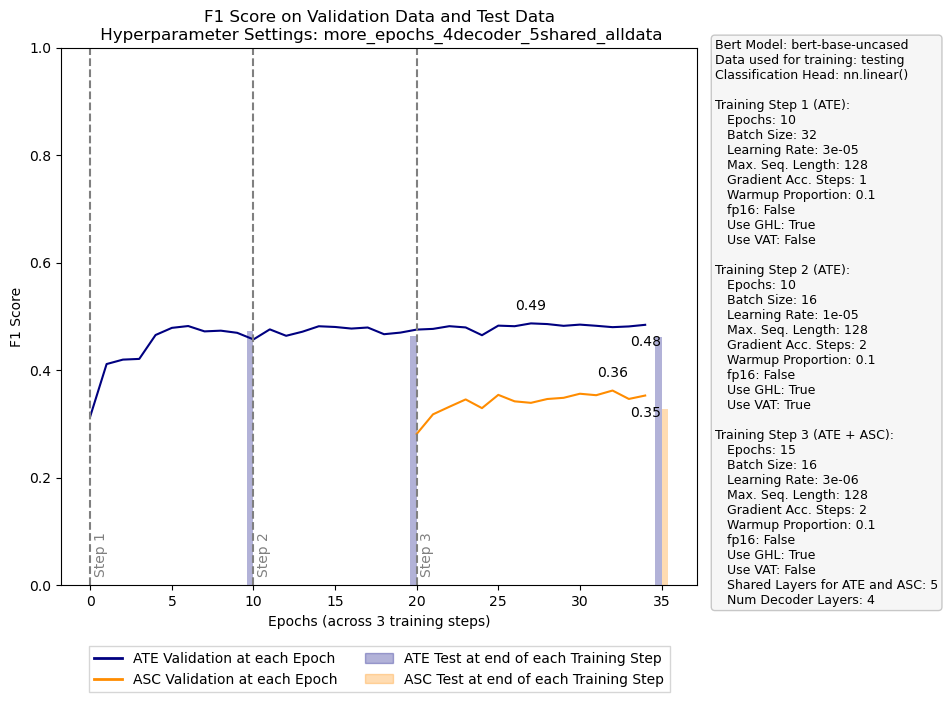

In [8]:
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'more_epochs_4decoder_5shared_alldata'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

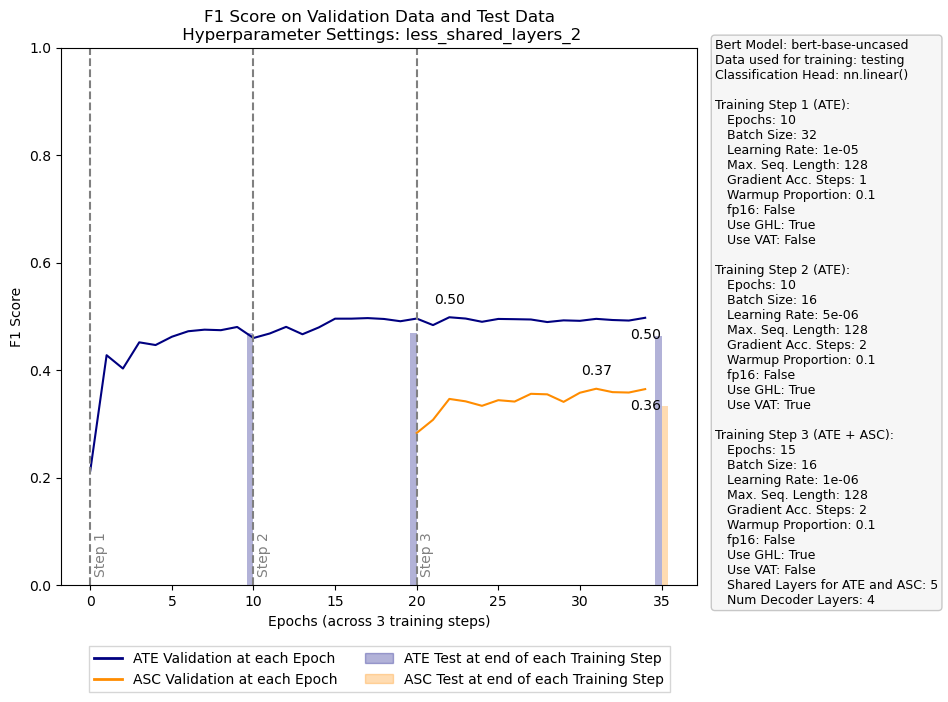

In [27]:
# LESS SHARED LAYERS

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

# name = ['less_shared_layers_1', 'less_shared_layers_2', 'more_shared_layers']

name = 'less_shared_layers_2'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

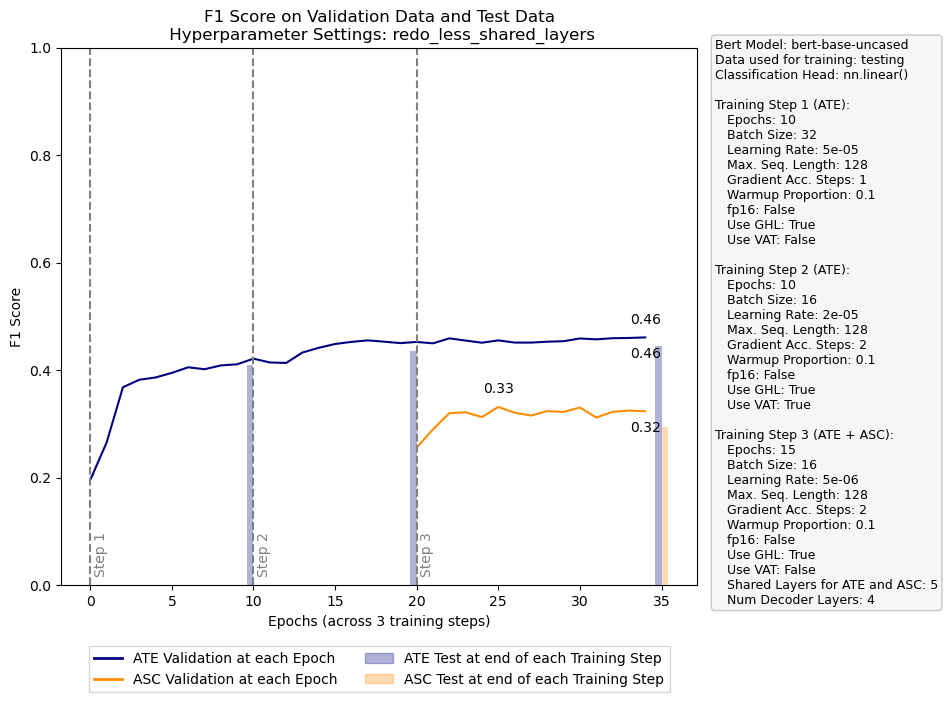

In [13]:
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

# name = ['less_shared_layers_1', 'less_shared_layers_2', 'more_shared_layers']

name = 'redo_less_shared_layers'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

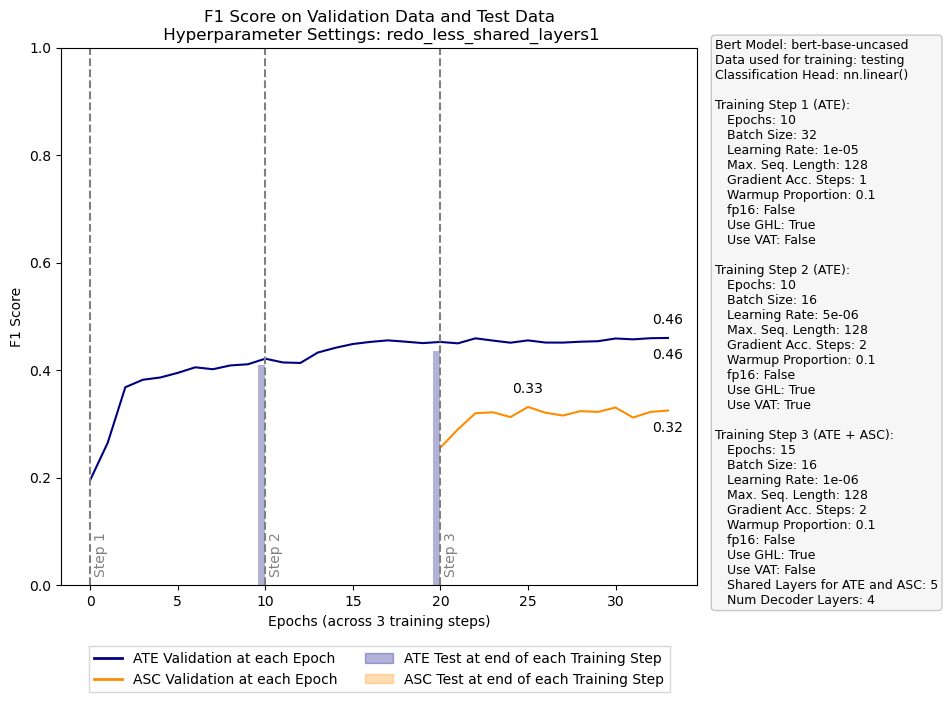

In [7]:
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

# name = ['less_shared_layers_1', 'less_shared_layers_2', 'more_shared_layers']

name = 'redo_less_shared_layers1'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

### previous

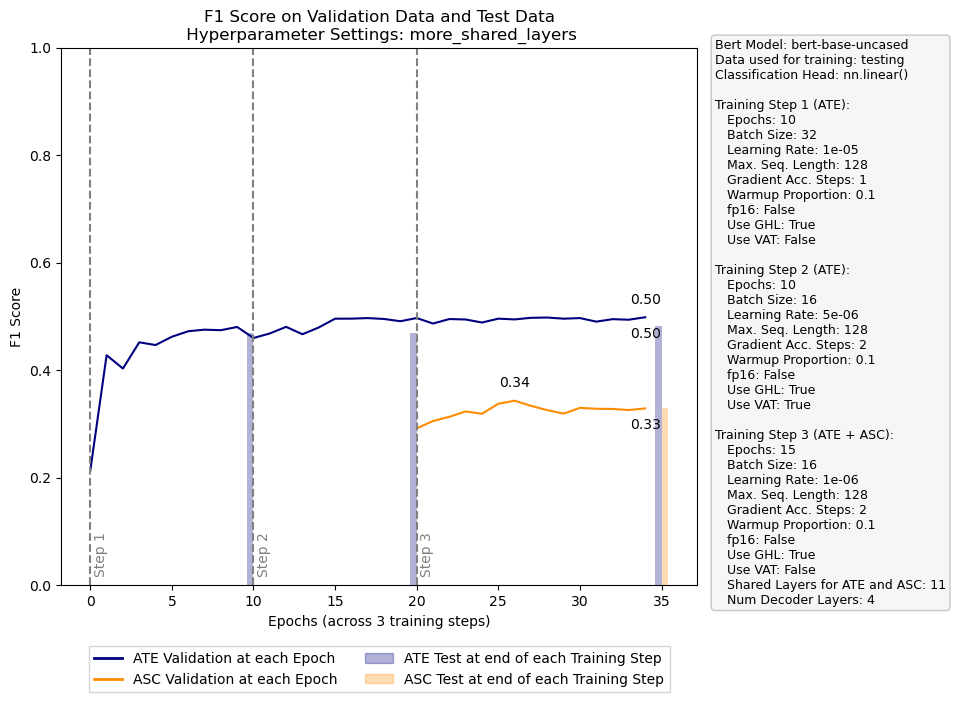

In [25]:
# MORE SHARED LAYERS

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

# name = ['less_shared_layers_1', 'less_shared_layers_2', 'more_shared_layers']

name = 'more_shared_layers'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

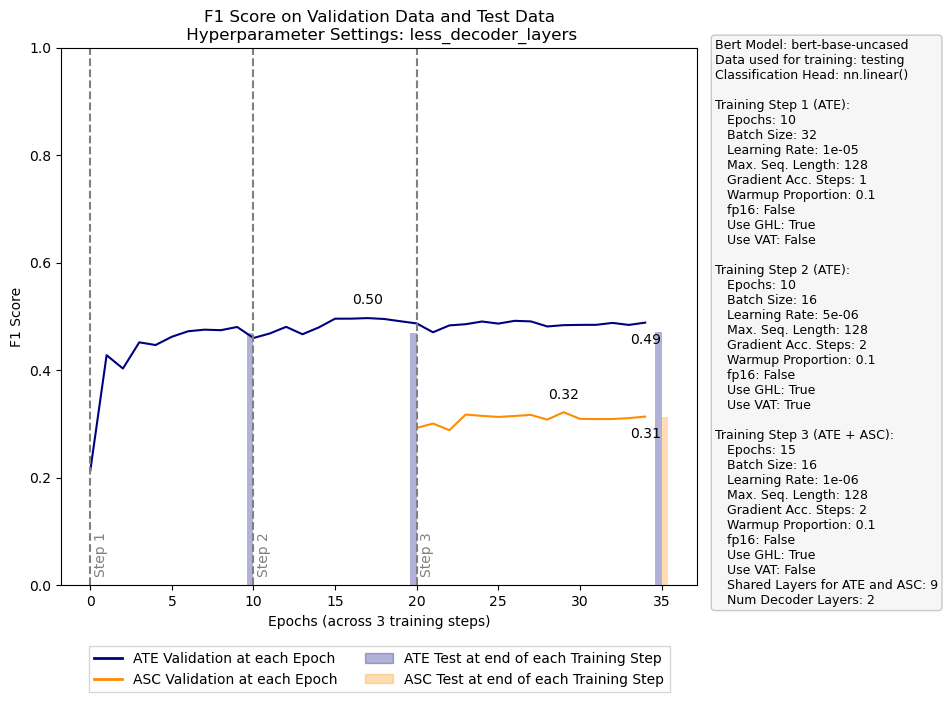

In [29]:
# MORE DECODER LAYERS 

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'less_decoder_layers'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

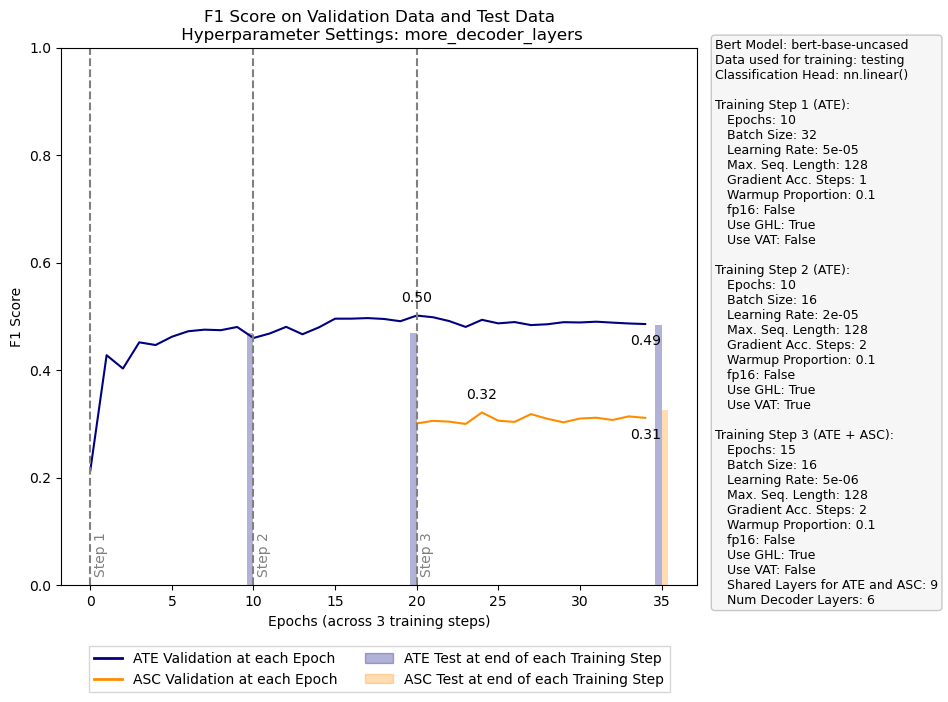

In [30]:
# MORE DECODER LAYERS 

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'more_decoder_layers'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

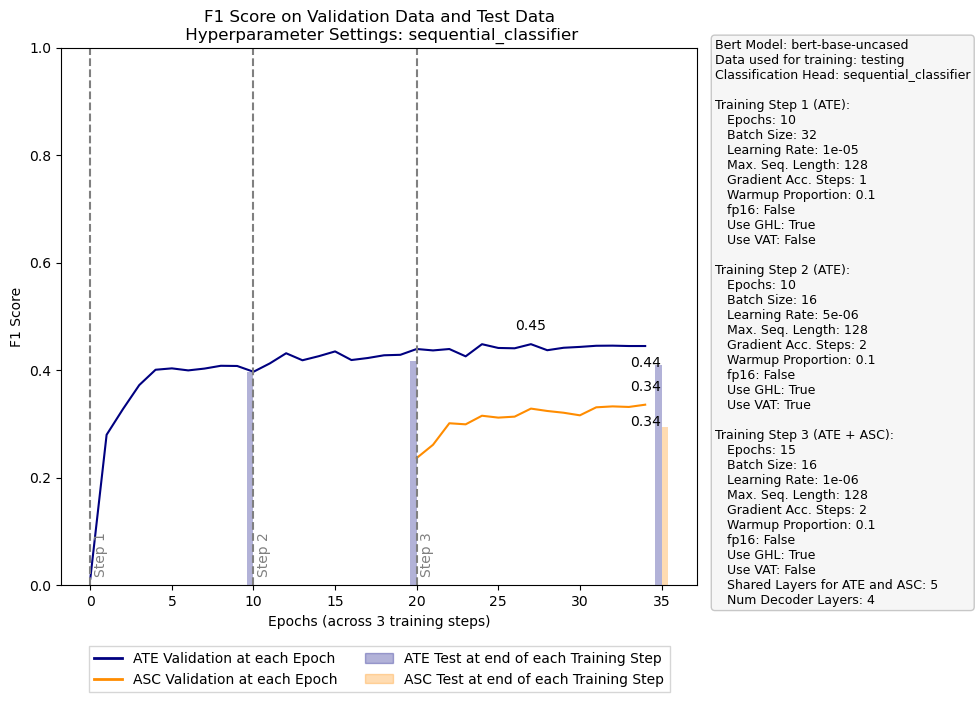

In [33]:
# SEQUENTIAL CLASSIFIER

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'sequential_classifier'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

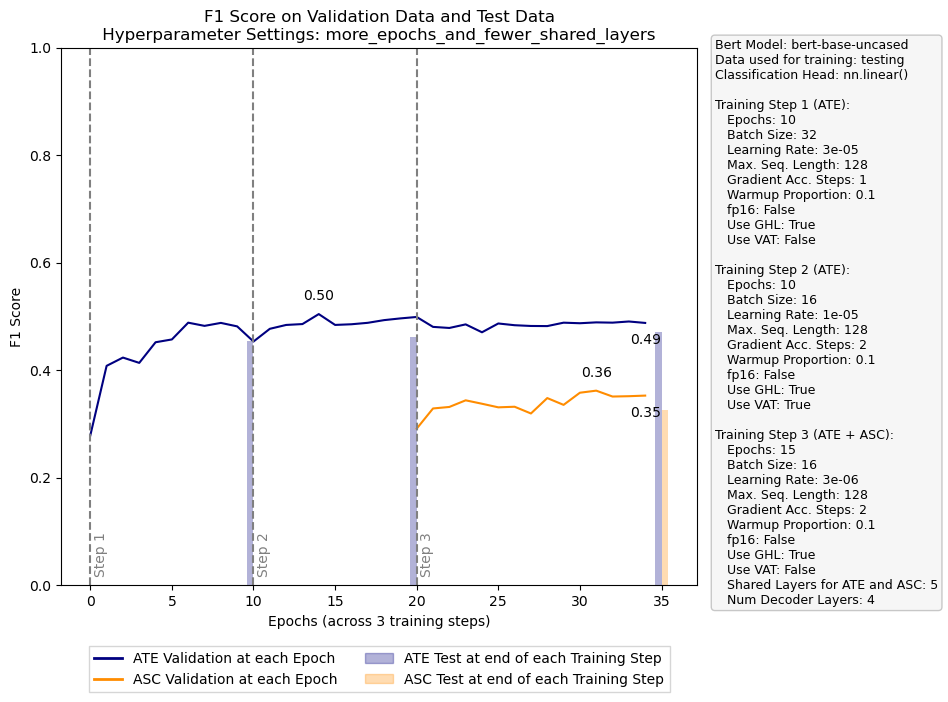

In [53]:
# MORE EPOCHS AND LESS SHARED LAYERS

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'more_epochs_and_fewer_shared_layers '
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

##### current

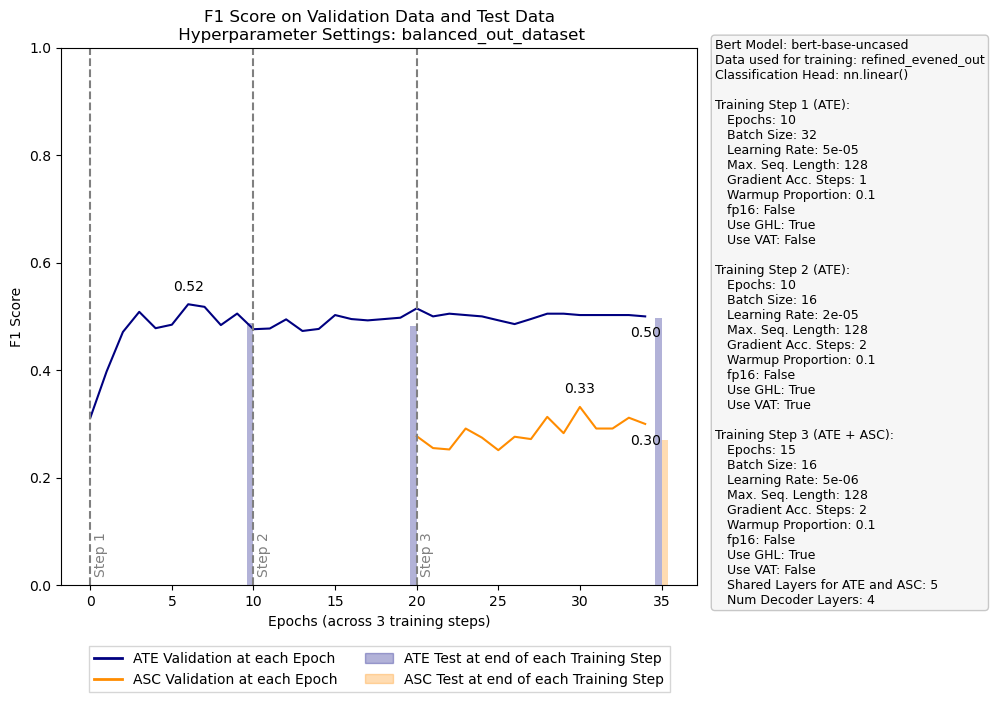

In [8]:
# BALANCED OUT DATASET 

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'balanced_out_dataset'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

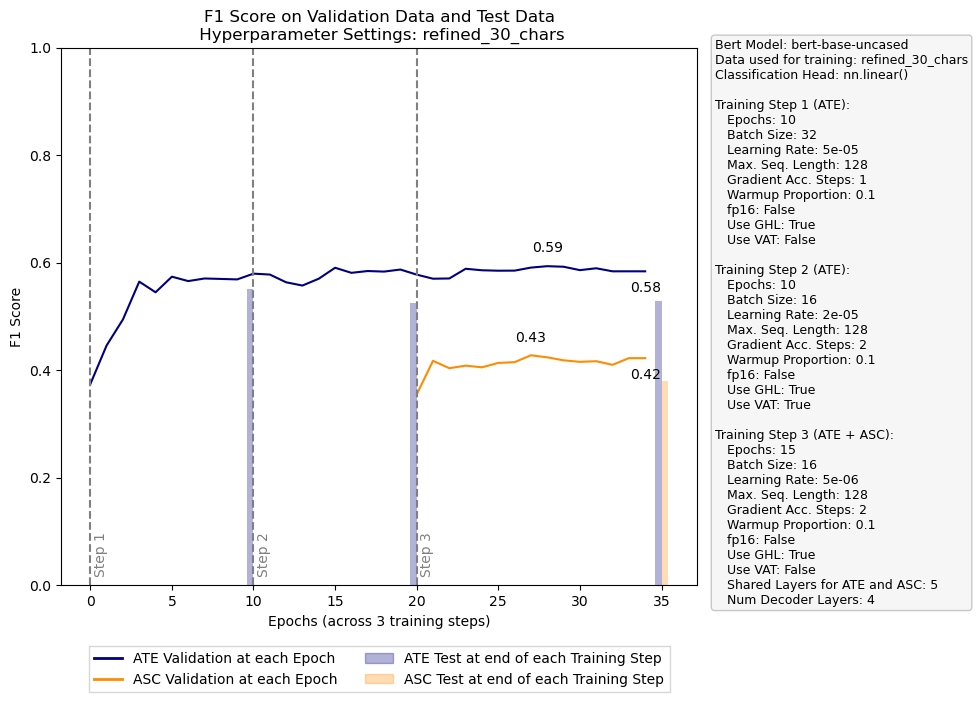

In [16]:
# LESS THAN 30 CHARACTERS IN AT

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'refined_30_chars'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

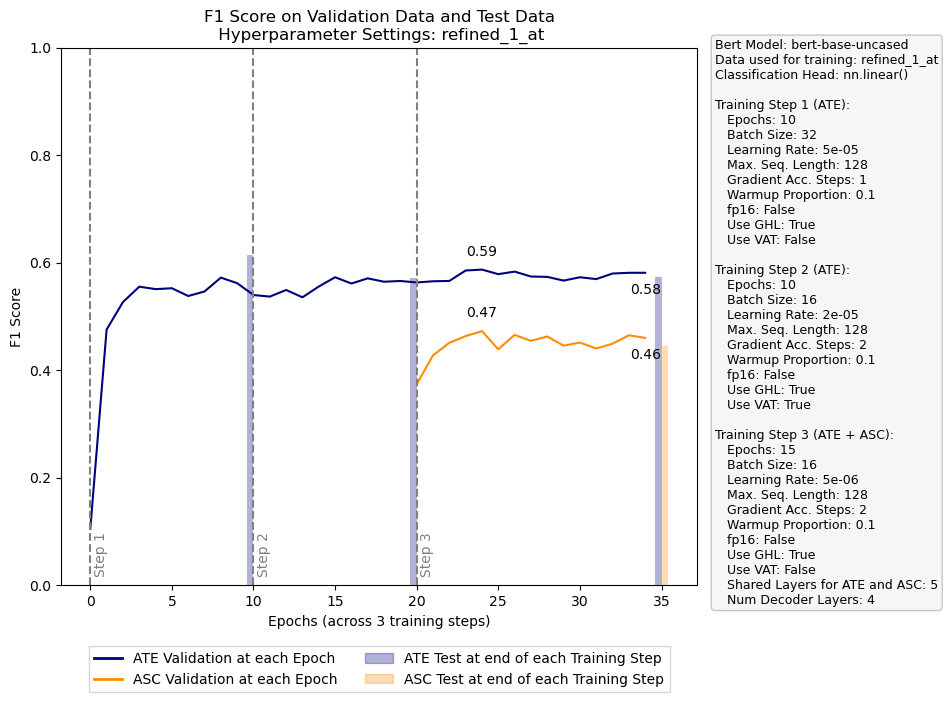

In [18]:
# LESS THAN 30 CHARACTERS IN AT

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'refined_1_at'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

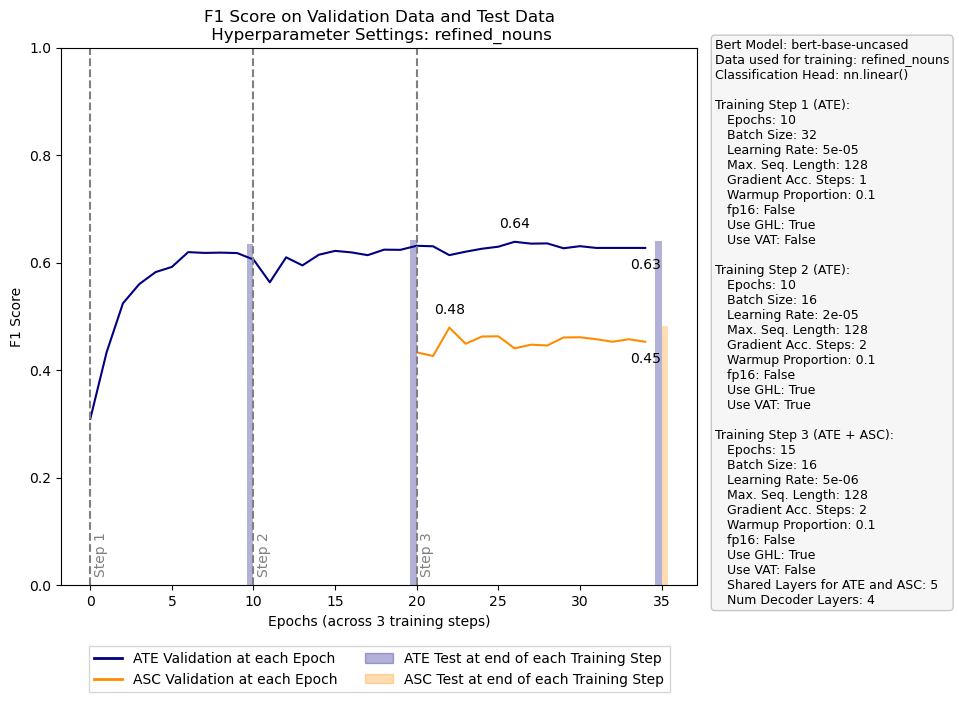

In [25]:
# NOUNS ONLY

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'refined_nouns'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

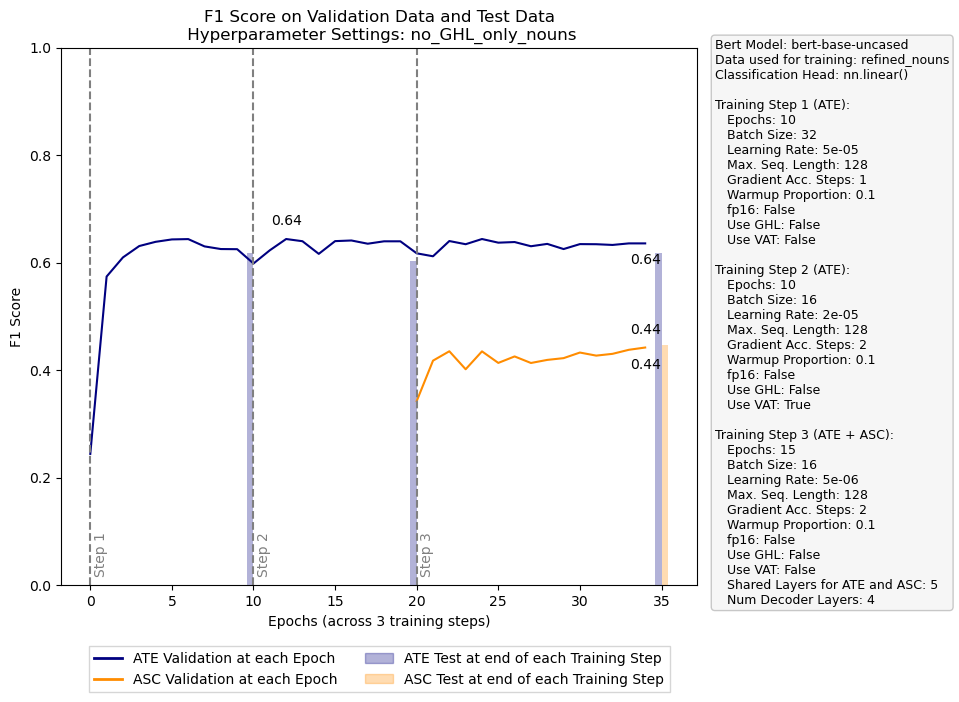

In [38]:
# NO GHL AND NOUNS ONLY DATASET

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'no_GHL_only_nouns'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

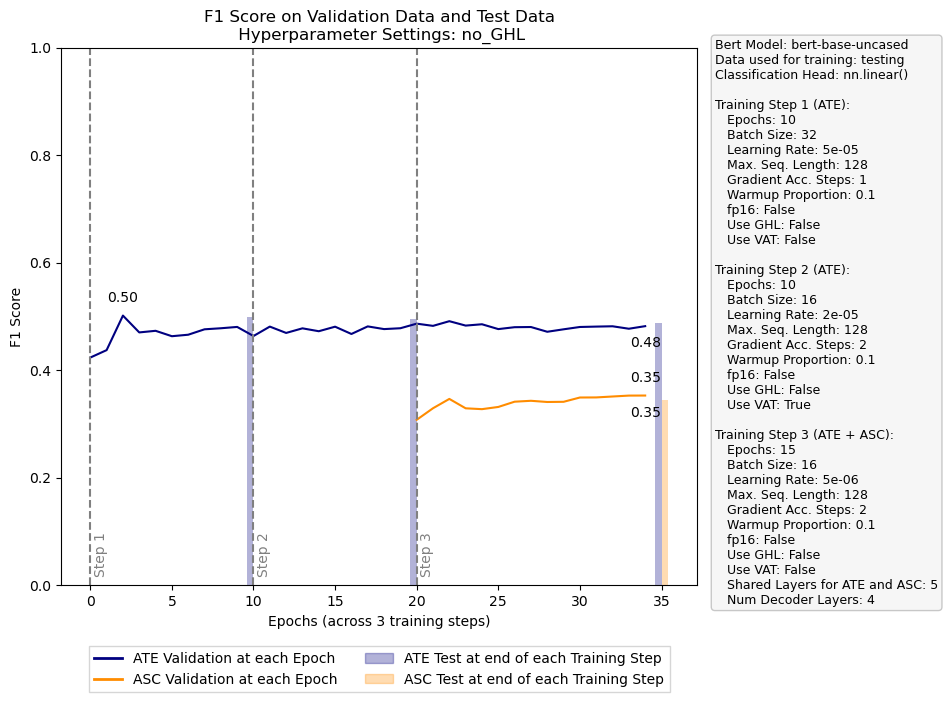

In [49]:
# NO GHL AND NOUNS ONLY DATASET

with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'no_GHL'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)

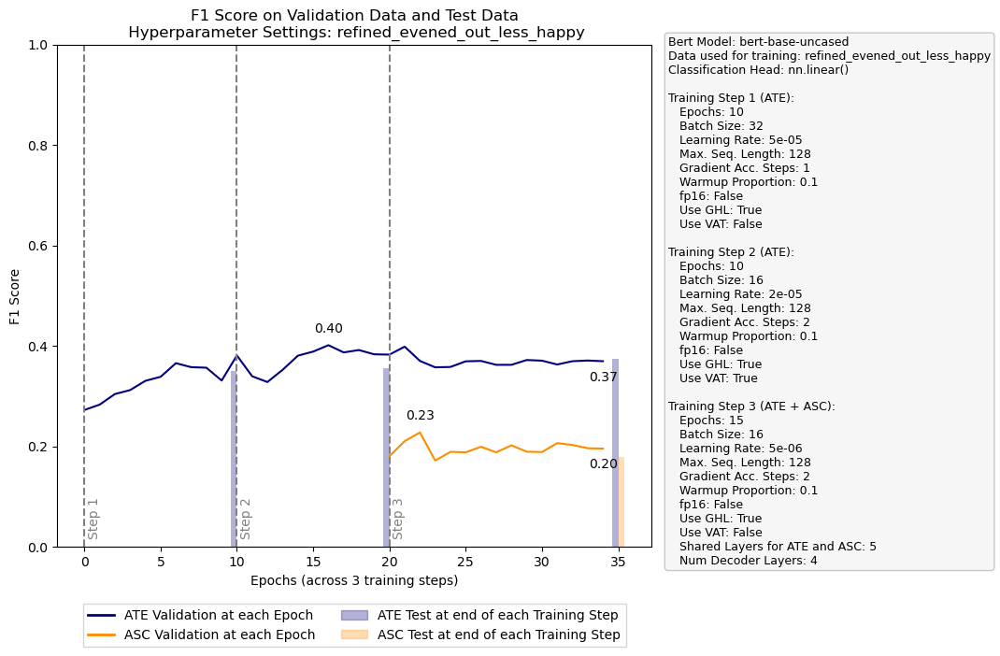

In [4]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'refined_evened_out_less_happy'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)


### Results: Original Dataset with Original Data Splitting (which has an error)

As the authors published their model on GitHub, the validation dataset equals the testing dataset!! 

ORIGINAL SPLIT OF ORIGINAL DATA:

| Data | Sentences | Percentage |
| --- | --- | --- |
| Train | 2116 | 90 |
| Validation | 2116	| 90 |
|Testing| 236| 10 |
|Totals|2352|100|




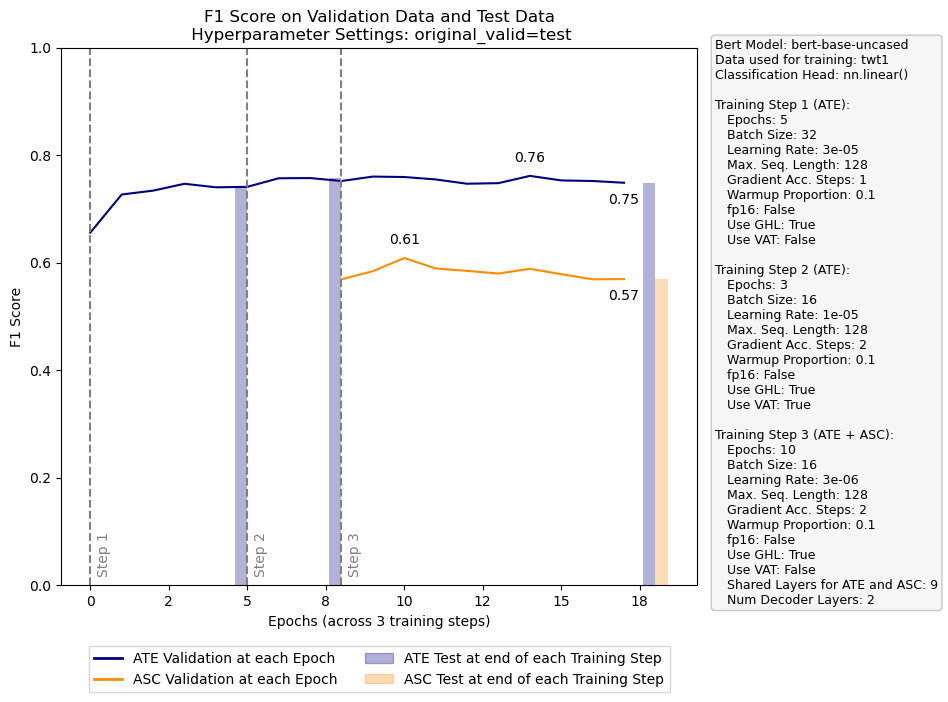

In [9]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'original_valid=test'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)


### Results: Original Data, with Proper Split

I re-merged and split the data anew: 

NEW SPLIT OF ORIGINAL DATA:

| Data | Sentences | Percentage |
| --- | --- | --- |
| Train | 1528 | 70 |
| Validation | 220	| 10 |
|Testing| 438| 20 |
|Totals|2186|100|




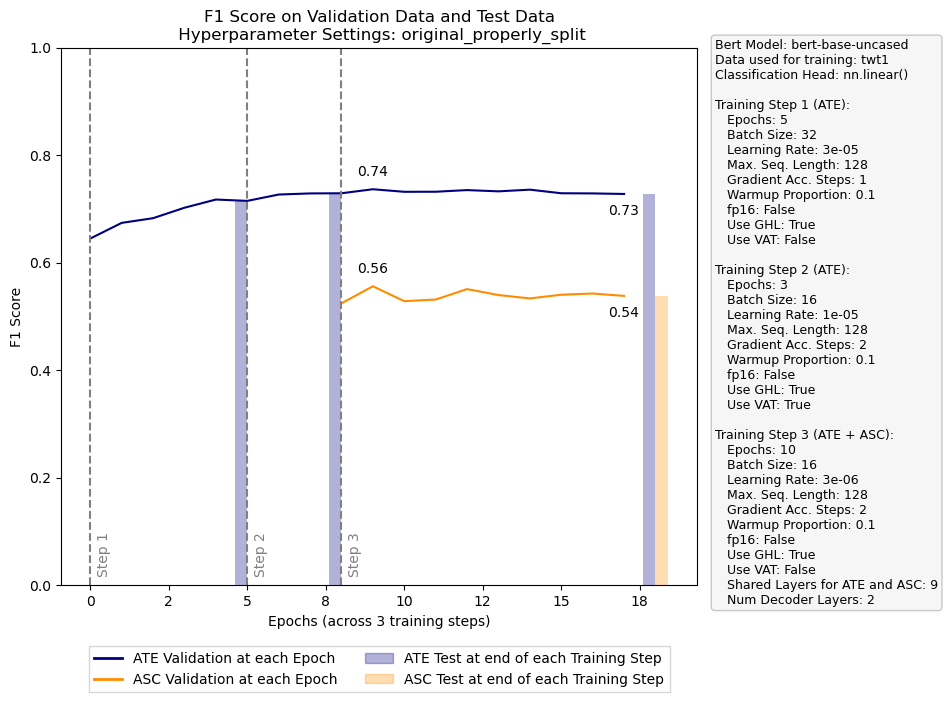

In [10]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'original_properly_split'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)


### Results for First ABEA Run 

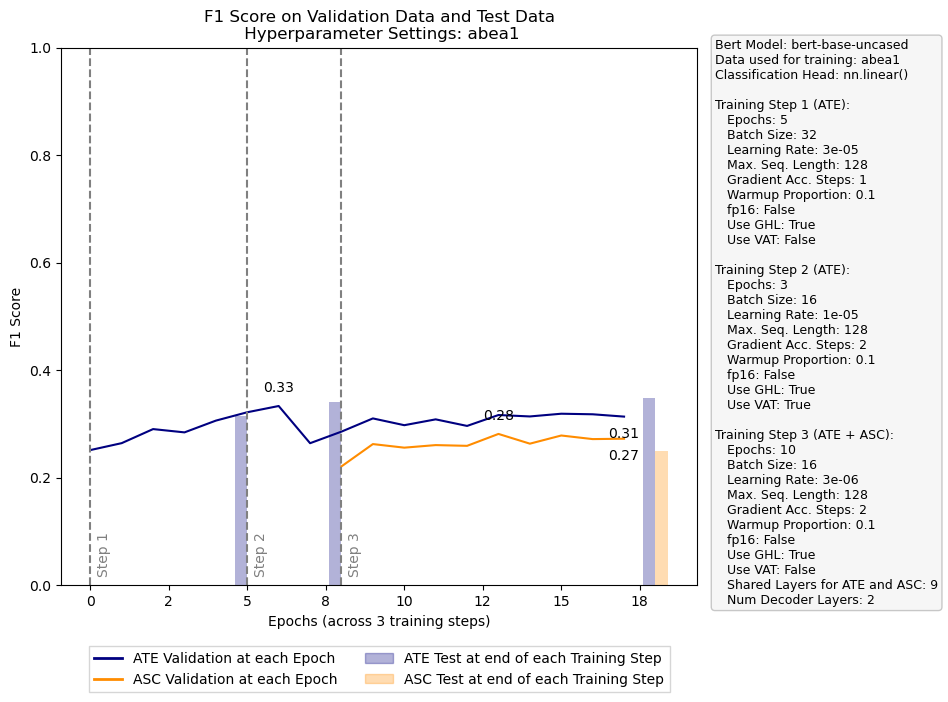

In [5]:
# Load the JSON data from the file
with open('GRACE/training_performance_01.json', 'r') as f:
    data = json.load(f)

data_name = 'abea1'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)


### 10-fold Cross Validation of the "best" settings

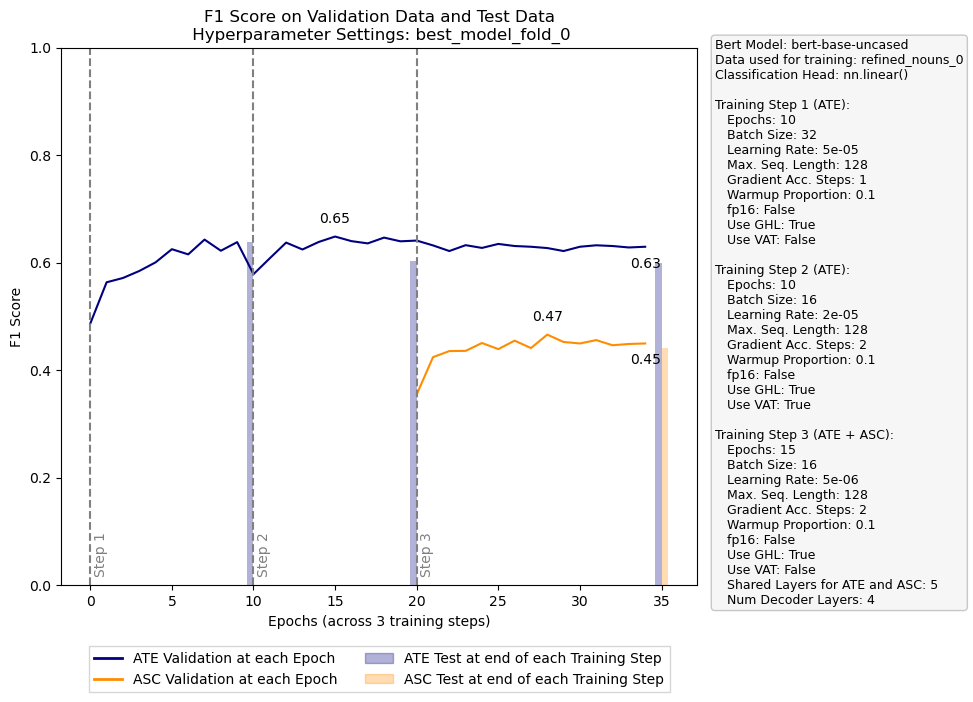

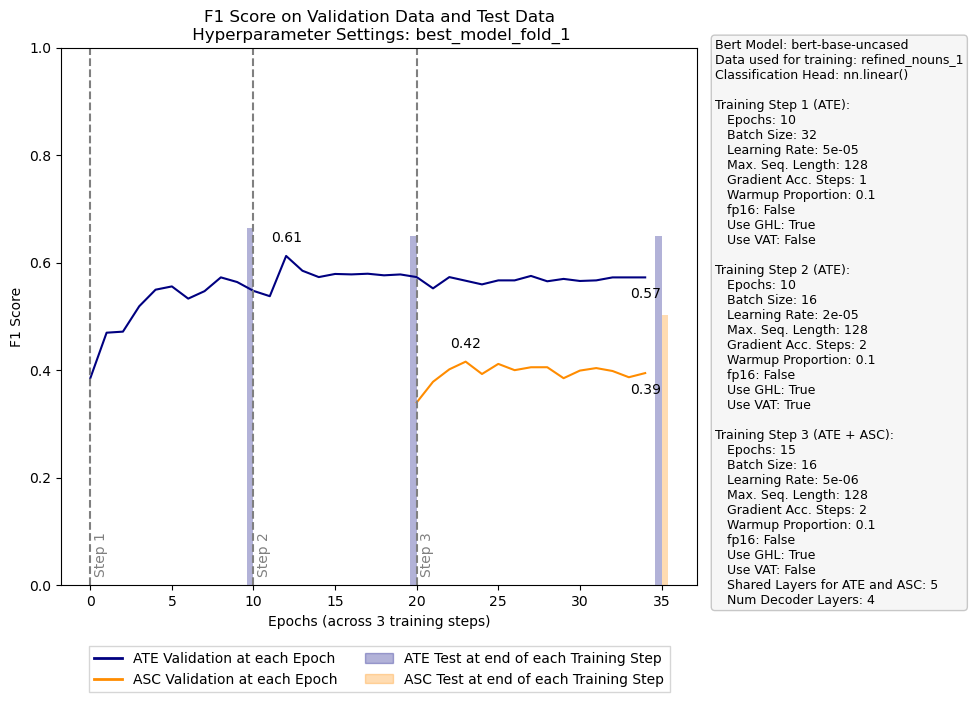

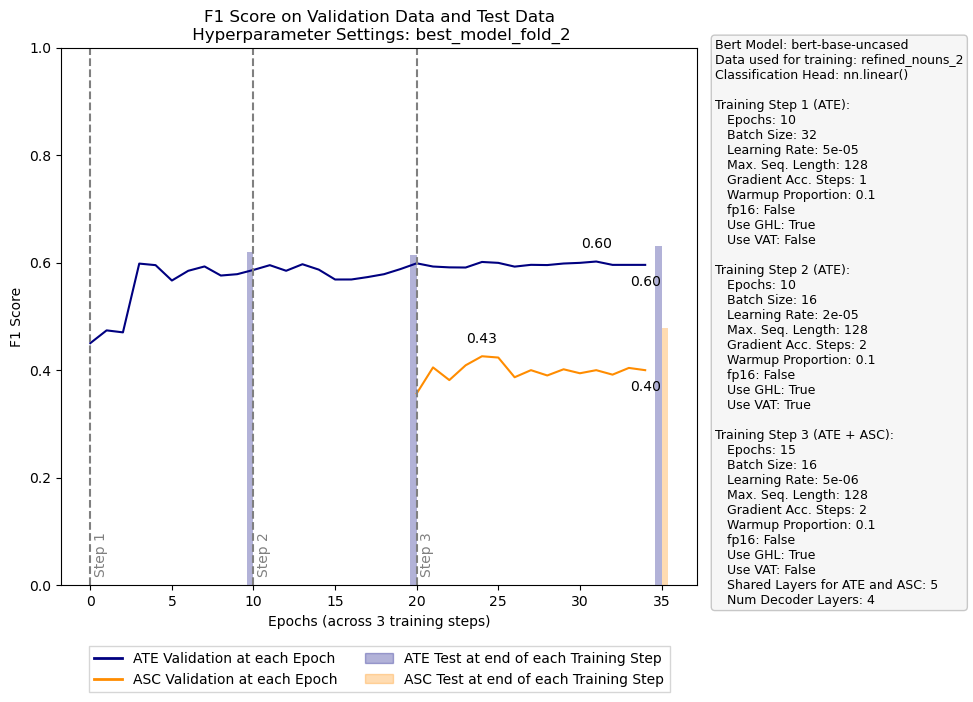

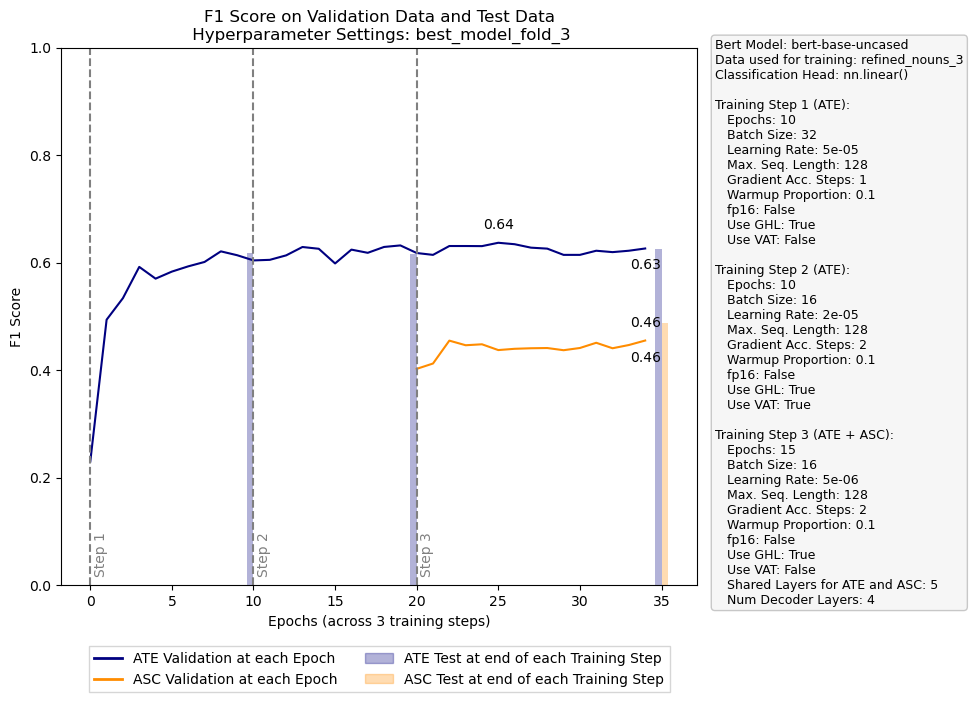

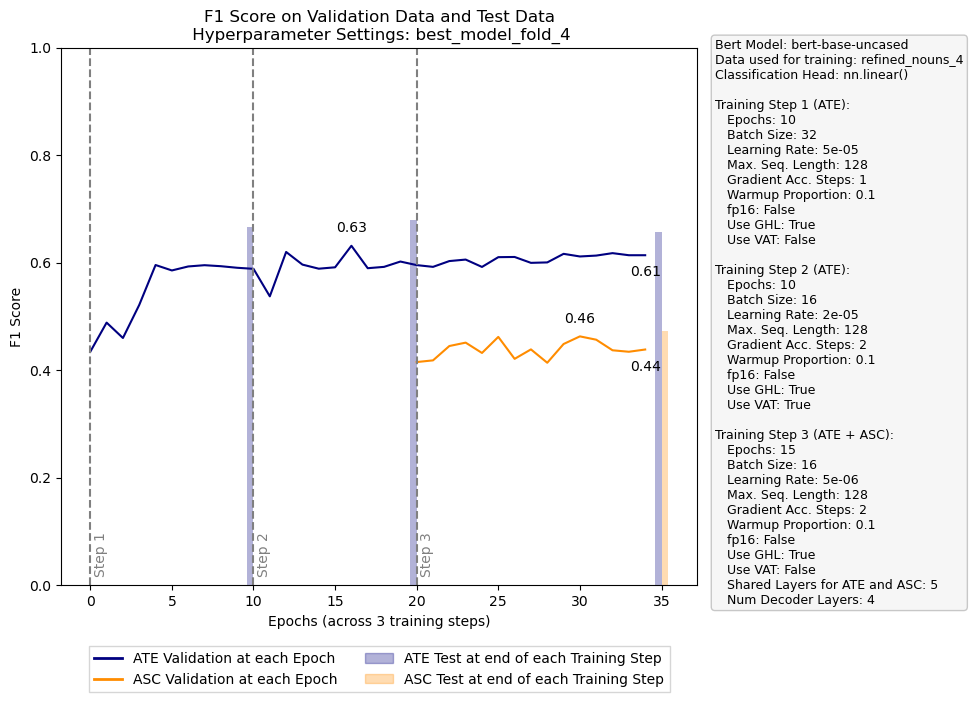

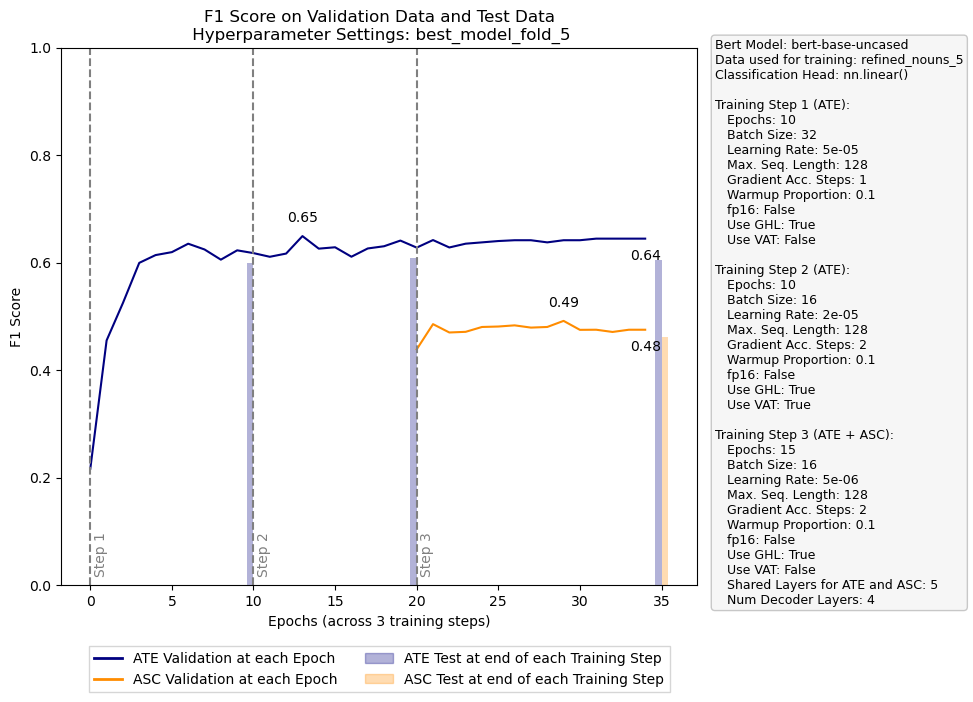

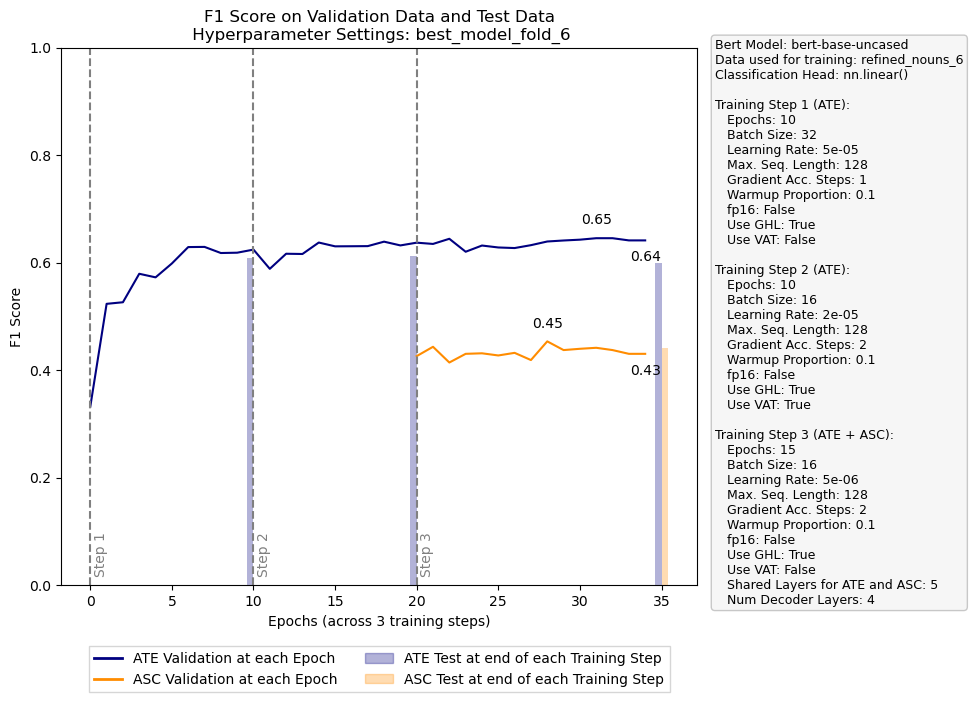

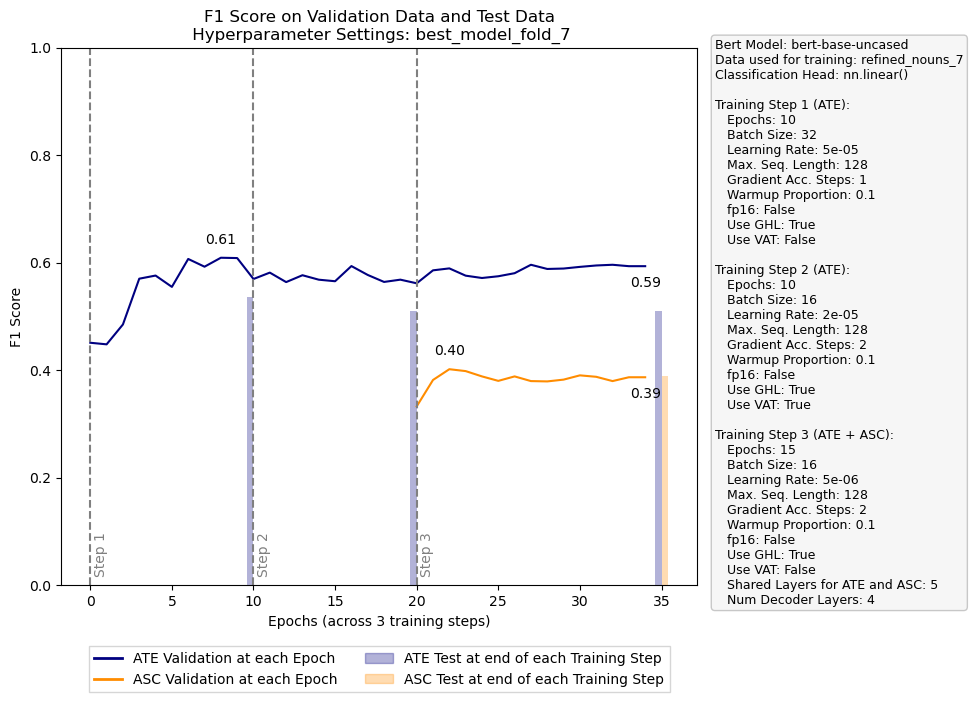

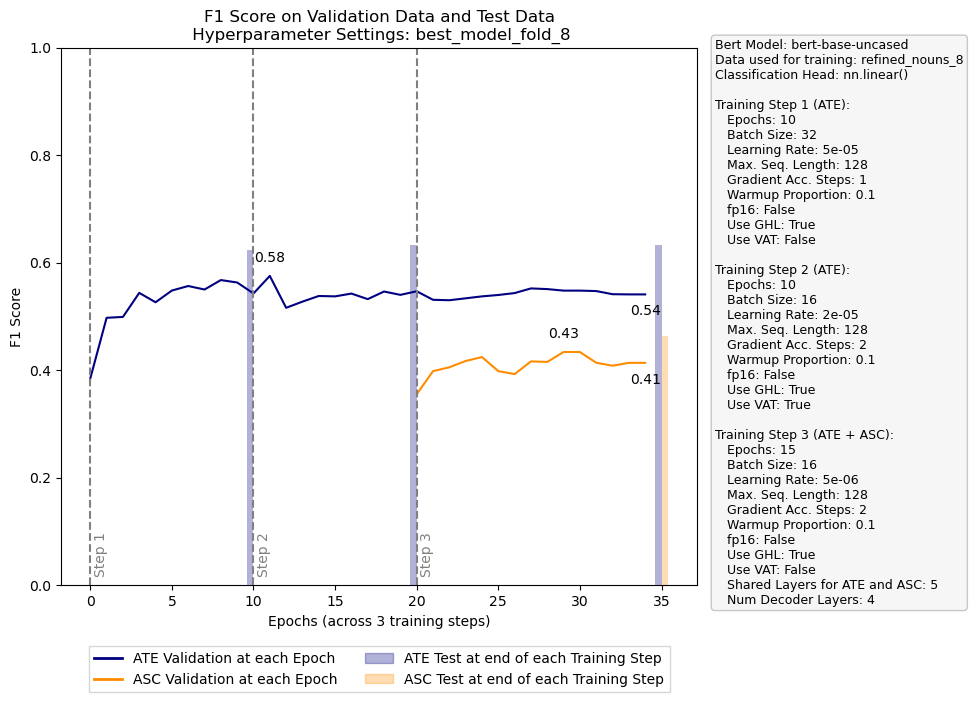

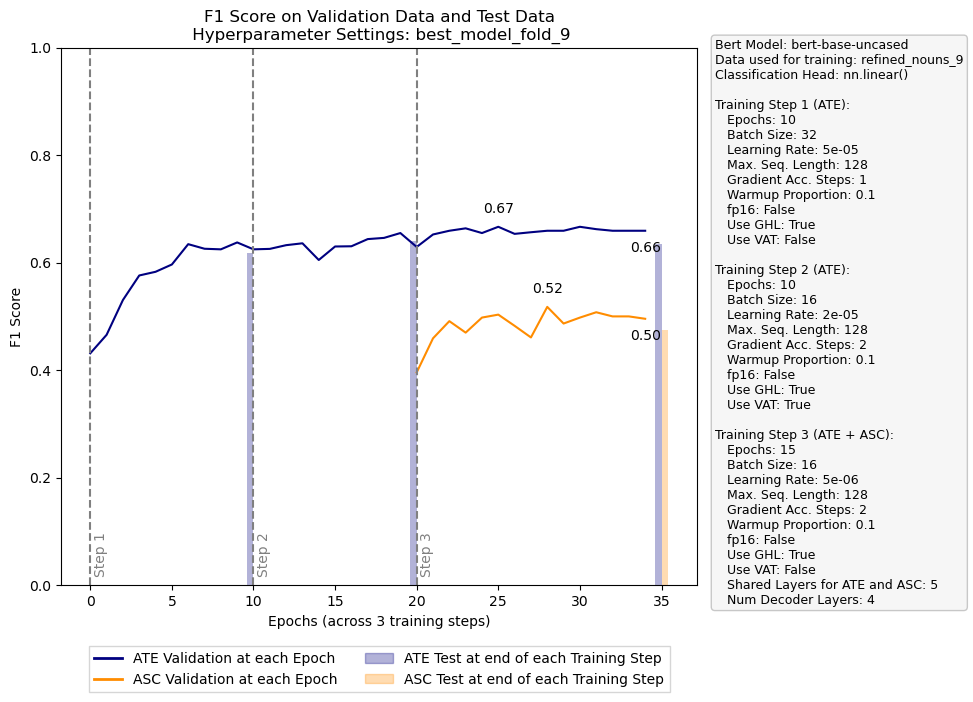

In [7]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

for i in range(10):

    data_name = f'best_model_fold_{i}'
    data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
    metric = "f1_score"

    create_performance_chart(data_to_plot, metric, data_name)


### 10 Fold Cross Valdiation with all Original ABEA Data

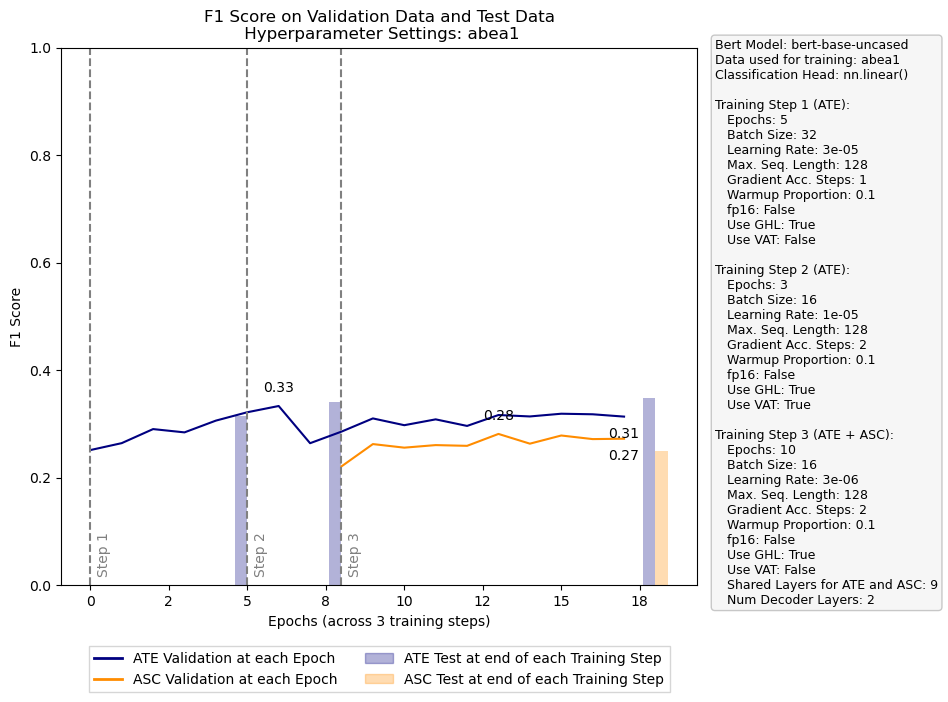

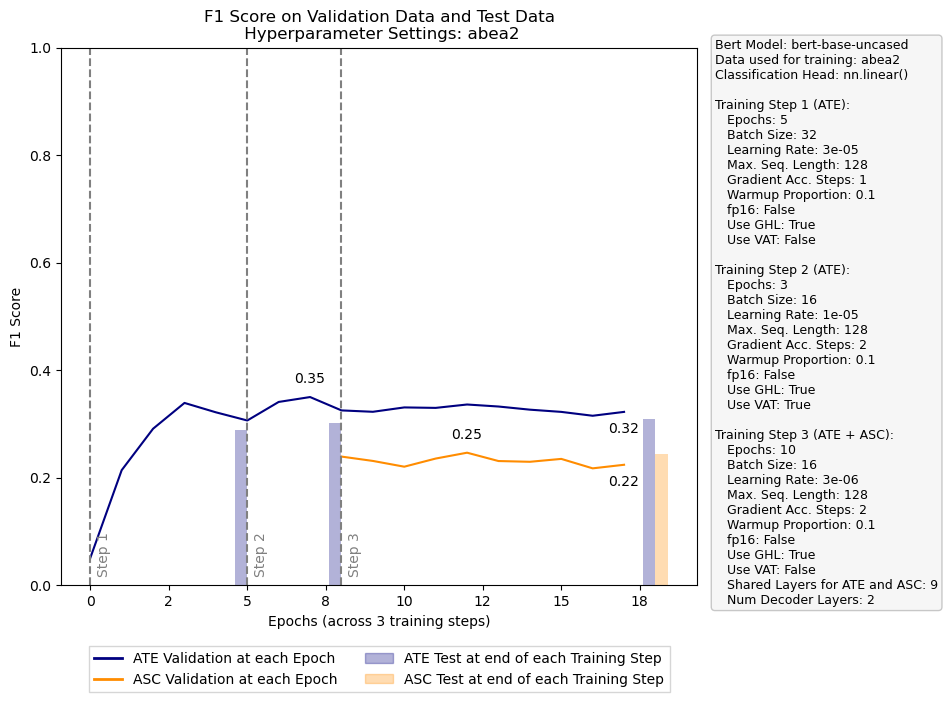

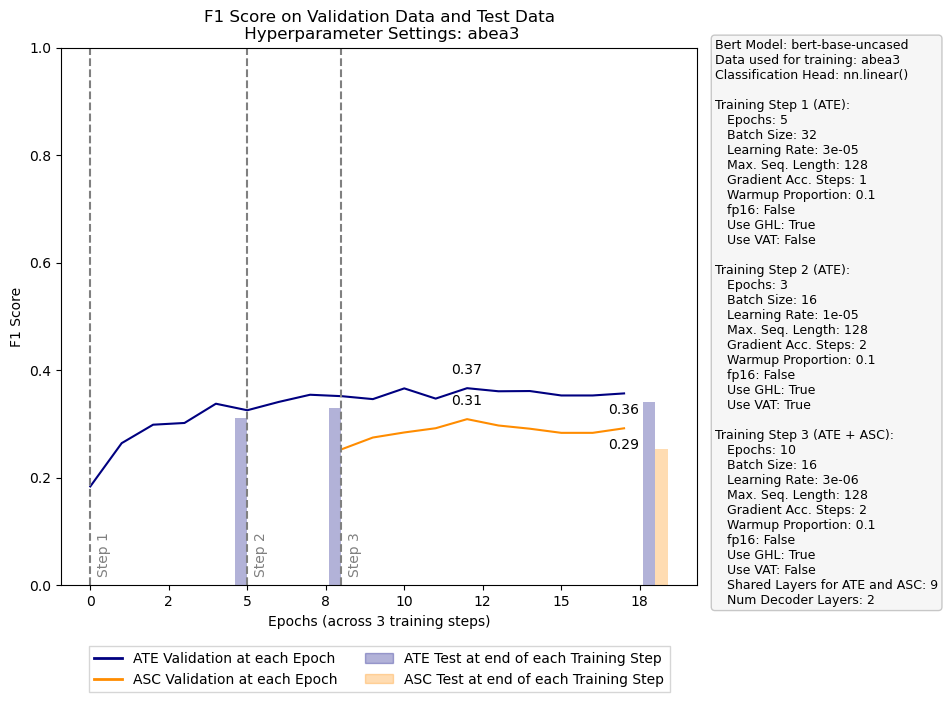

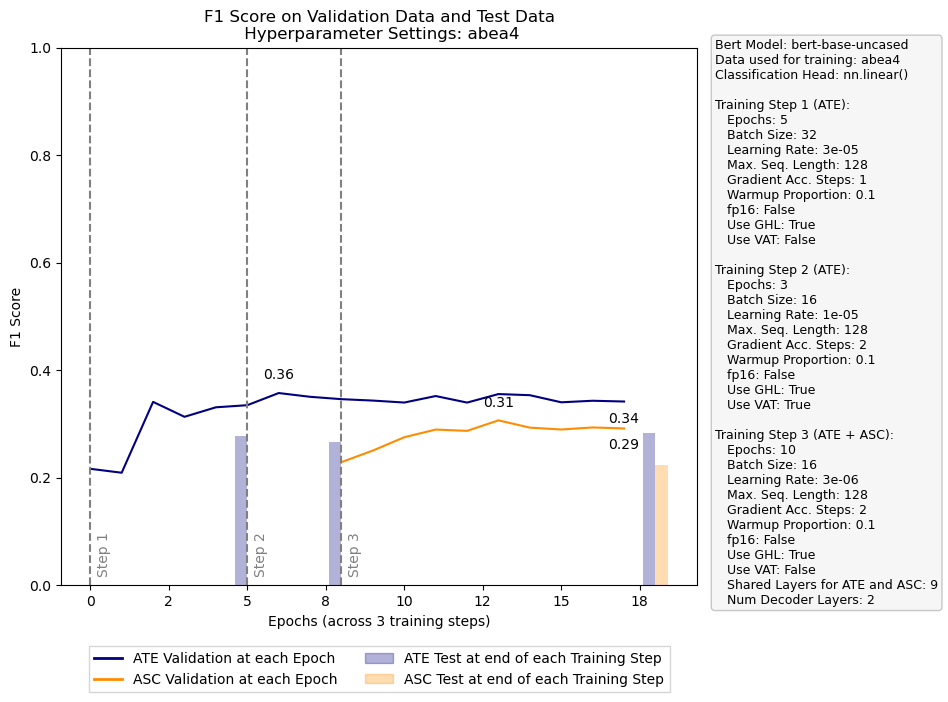

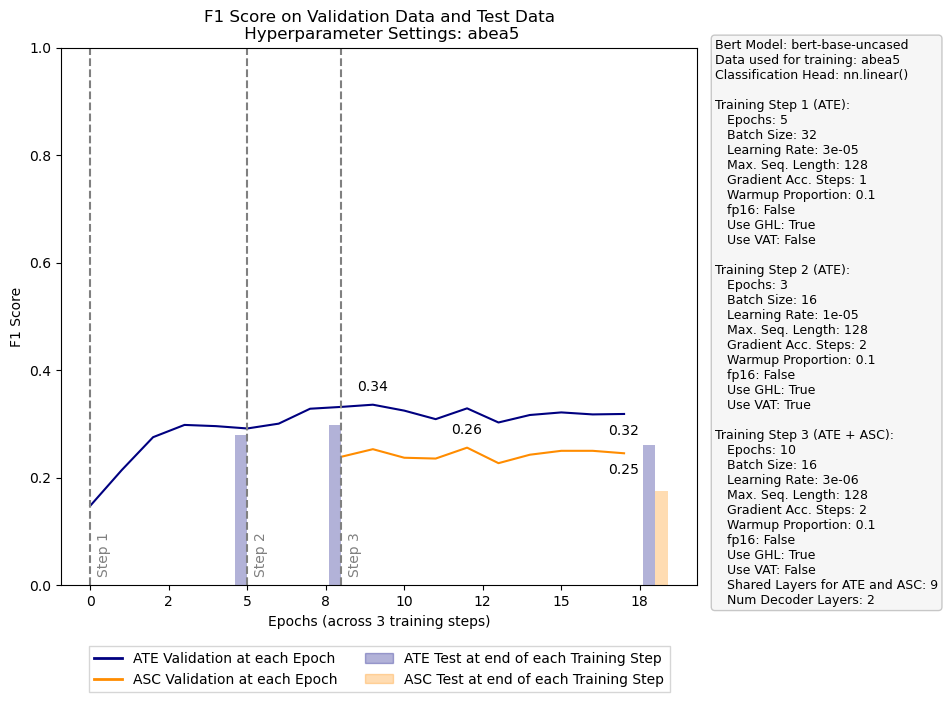

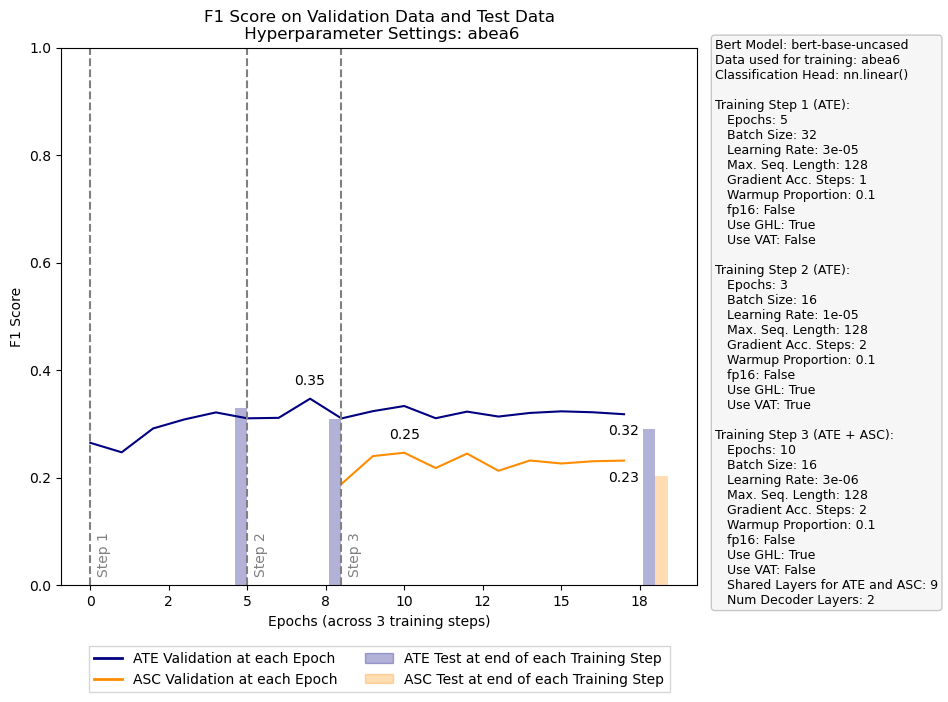

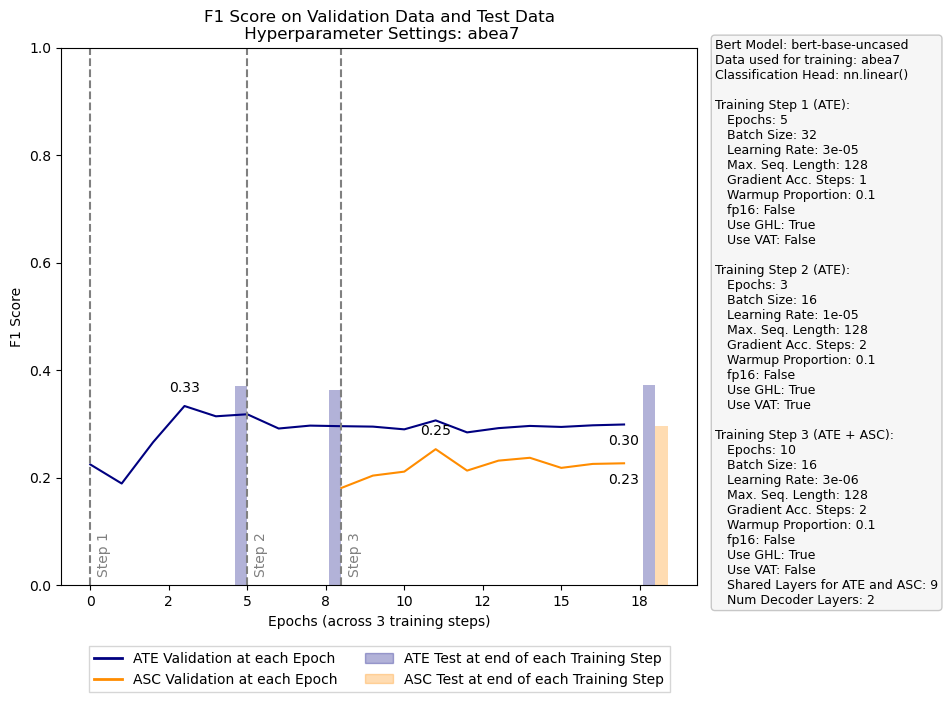

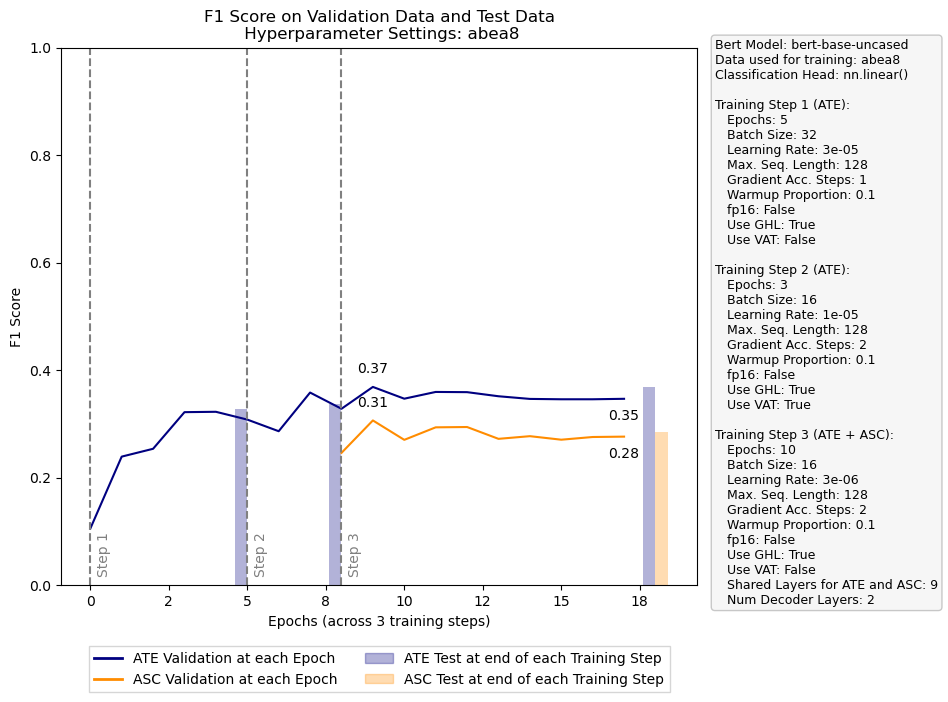

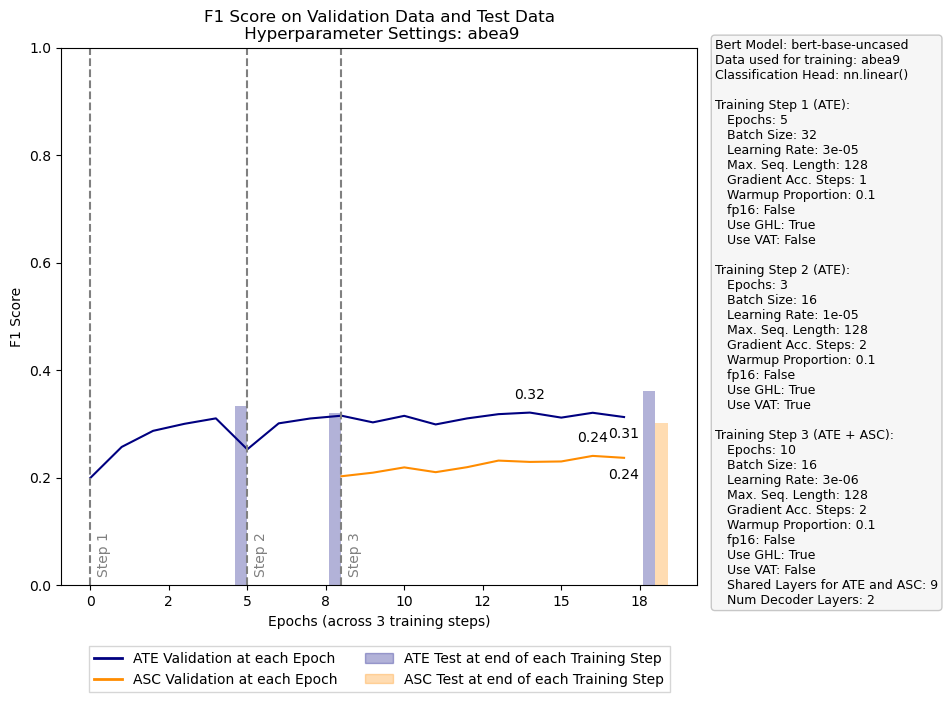

In [18]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

for i in range(1, 10):

    data_name = f'abea{i}'
    data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
    metric = "f1_score"

    create_performance_chart(data_to_plot, metric, data_name)


### Test on Subset 1: Only One Aspect Term per Tweet

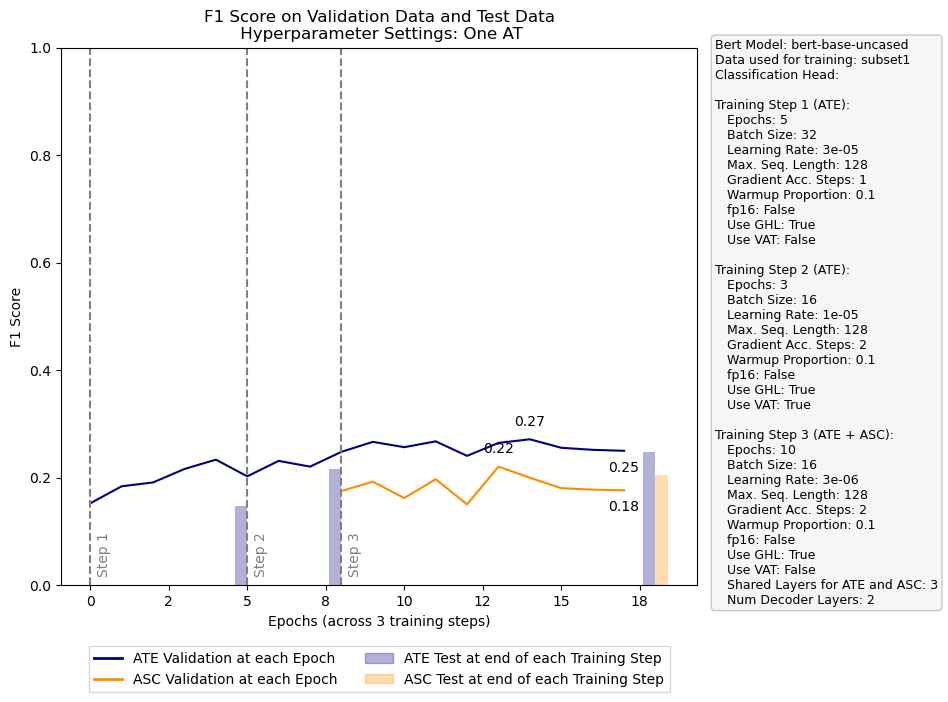

In [6]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'One AT'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)

### Test on Subset2: Aspect Terms Less than 40 Chars in Total

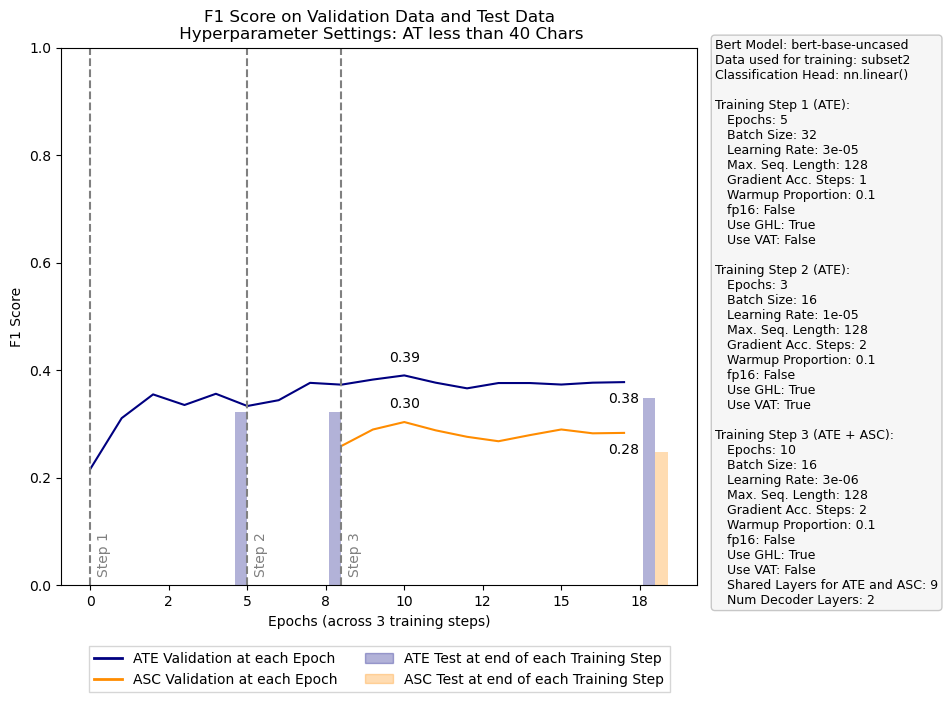

In [9]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'AT less than 40 Chars'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)

### Test on Subset3: Aspect Terms Less than 20 Chars in Total

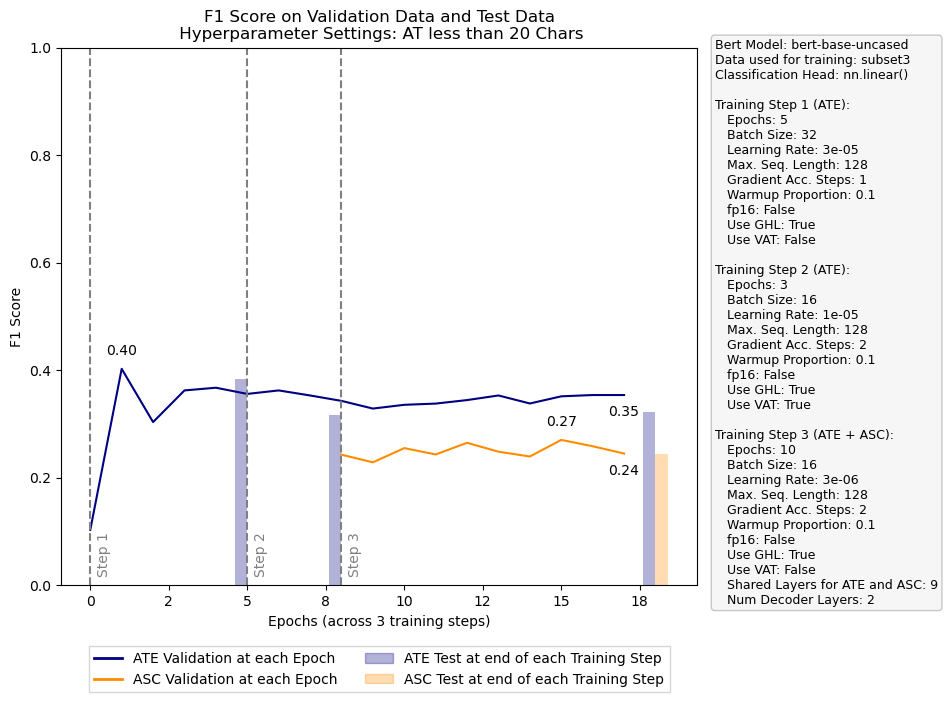

In [17]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'AT less than 20 Chars'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)

### Test on Subset4: Aspect Terms Less than 10 Chars in Total

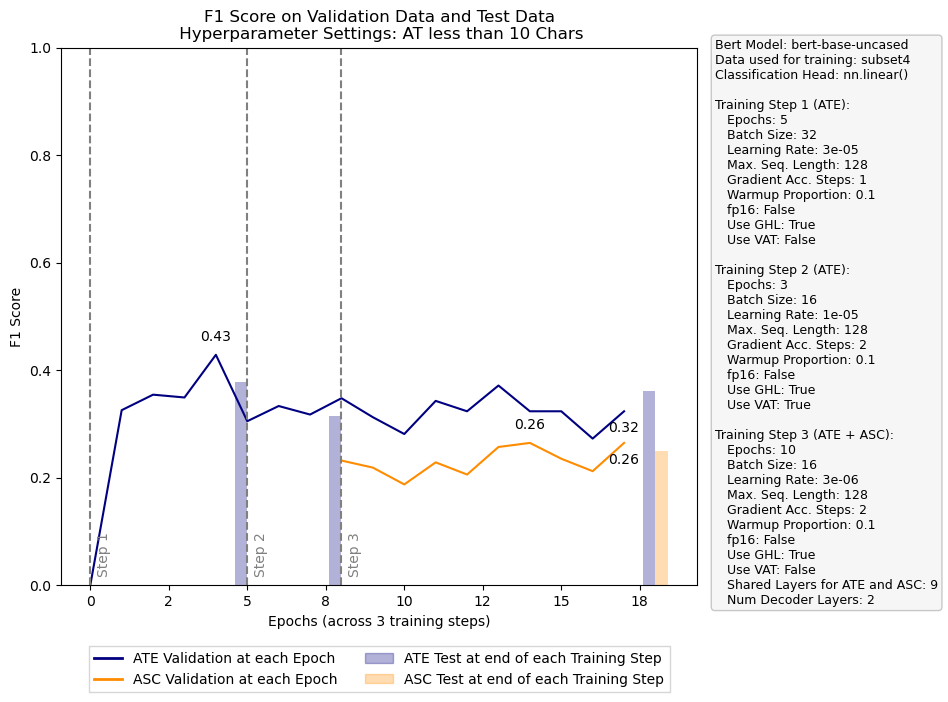

In [23]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'AT less than 10 Chars'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)

### Excluded the "None" Rows

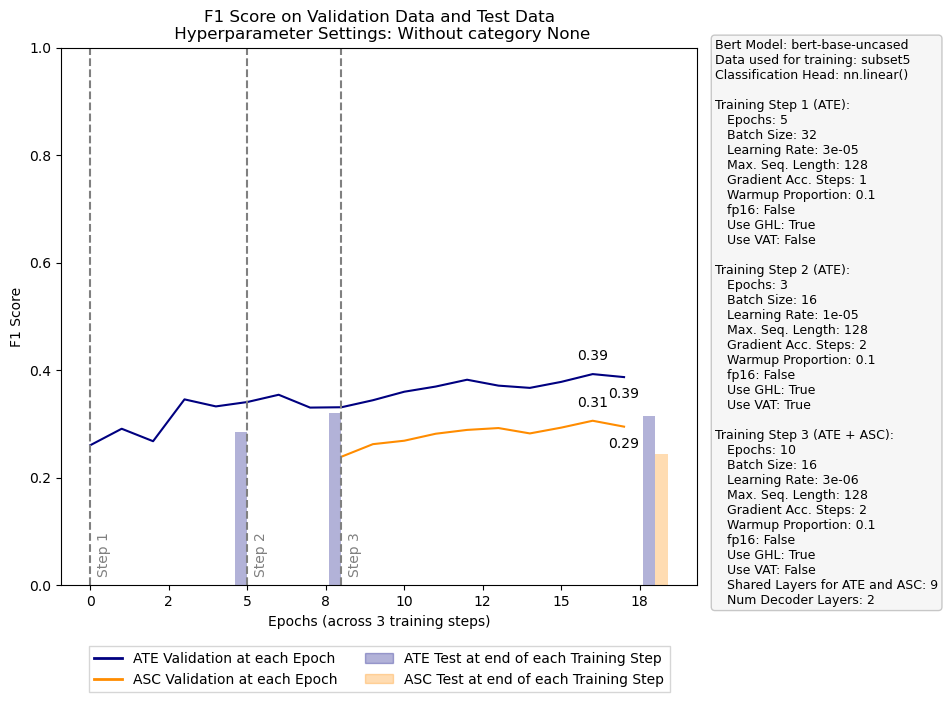

In [30]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'Without category None'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)

### Excluded "None" and Less than 30 Chars in Aspect Term

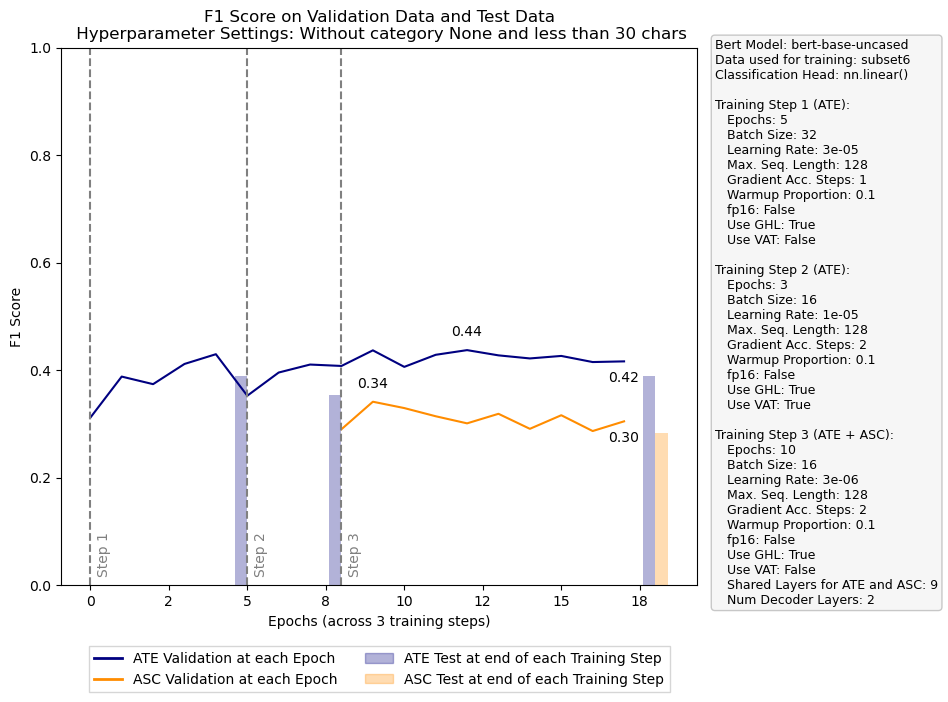

In [49]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'Without category None and less than 30 chars'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)

### Excluded "None" and Less than 30 Chars in Aspect Term, LR Down

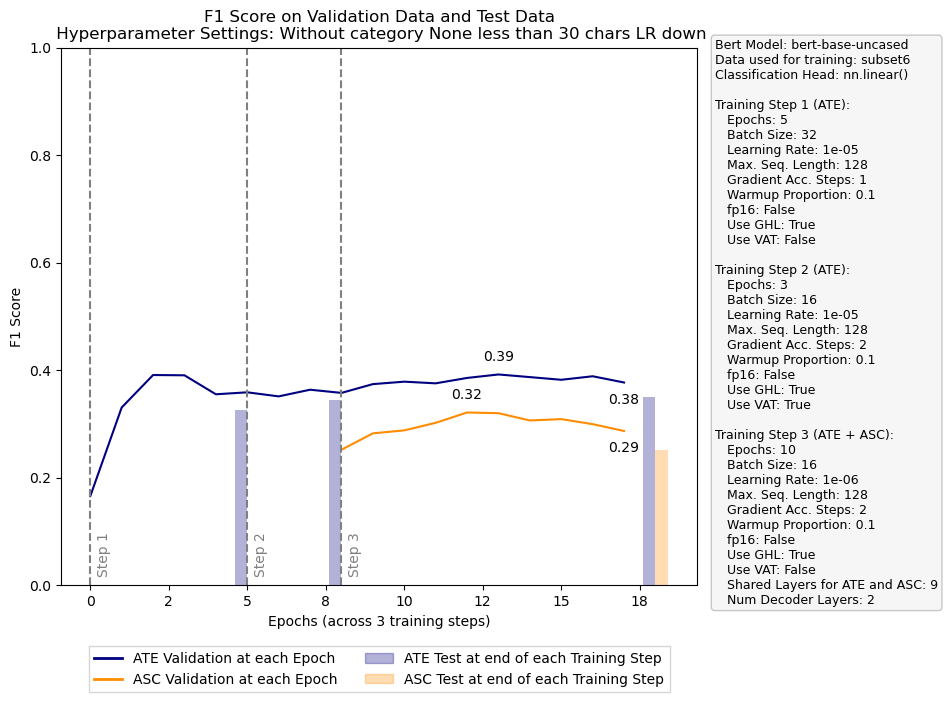

In [63]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'Without category None less than 30 chars LR down'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)

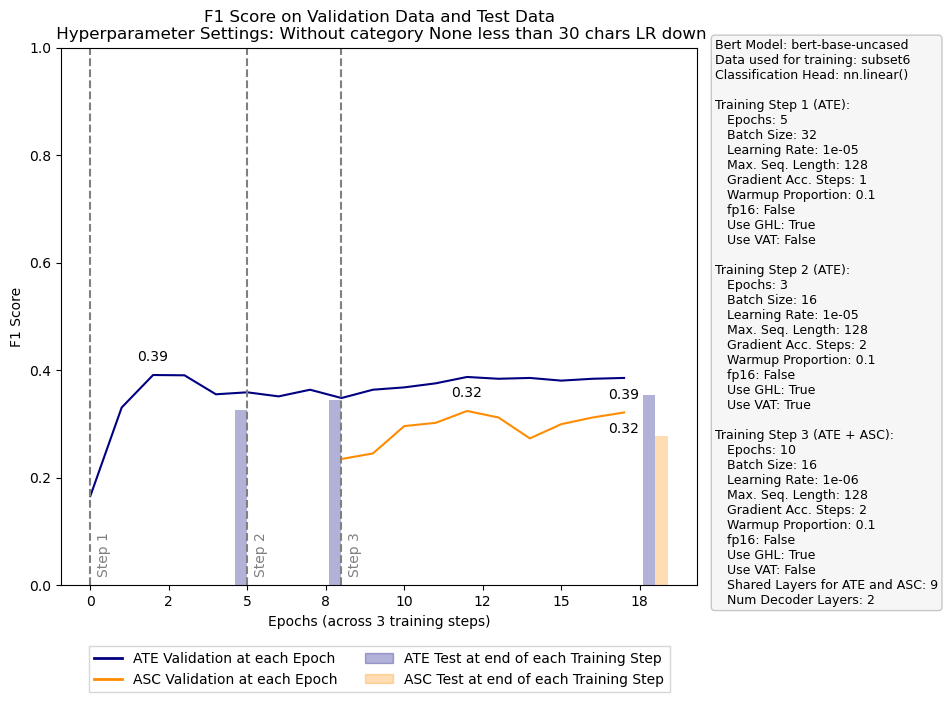

In [83]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

data_name = 'Without category None less than 30 chars LR down'
data_to_plot = next((item for item in data if item['settings']['name'] == data_name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, data_name)

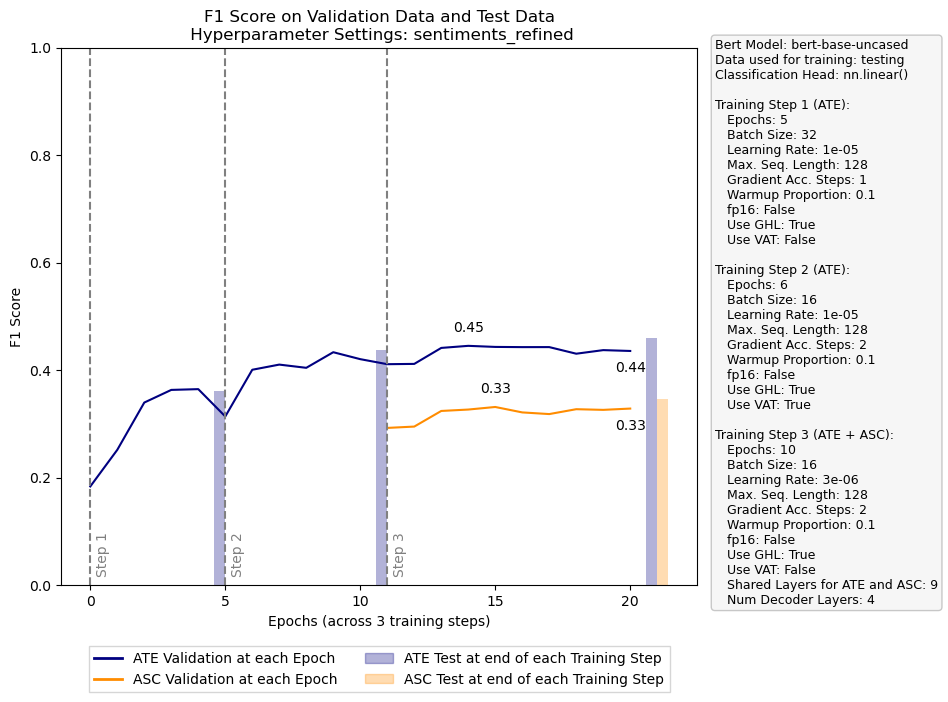

In [55]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'sentiments_refined'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)


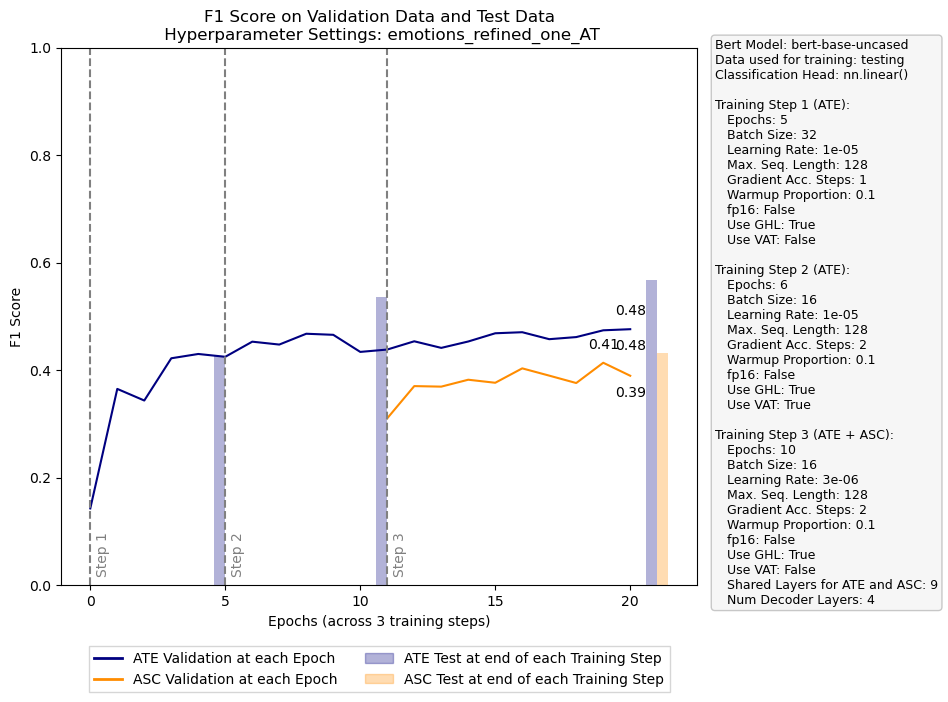

In [48]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'emotions_refined_one_AT'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)


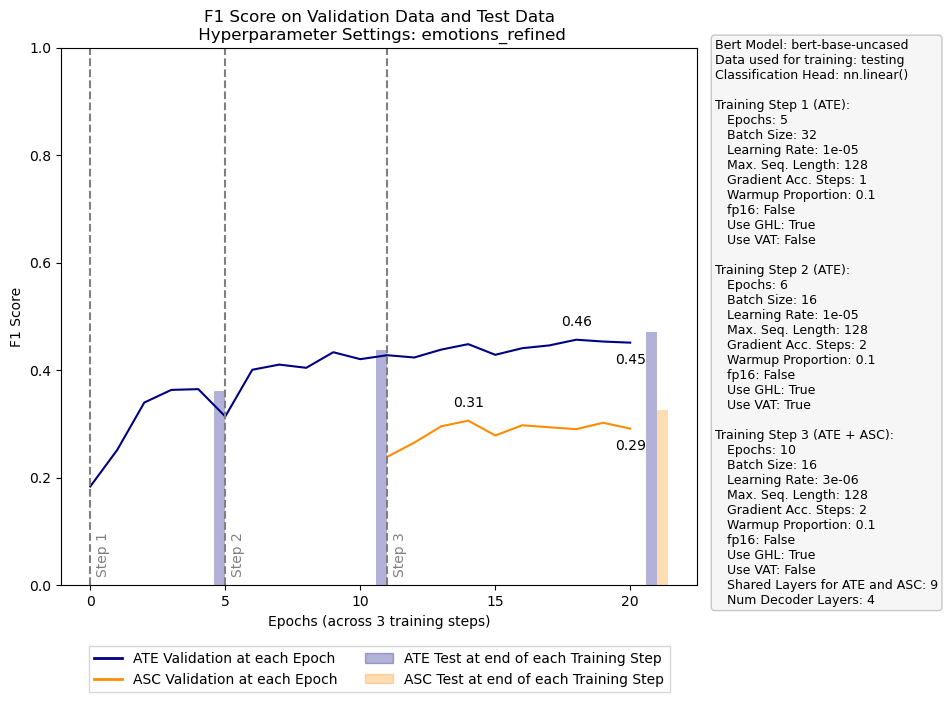

In [45]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'emotions_refined'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)


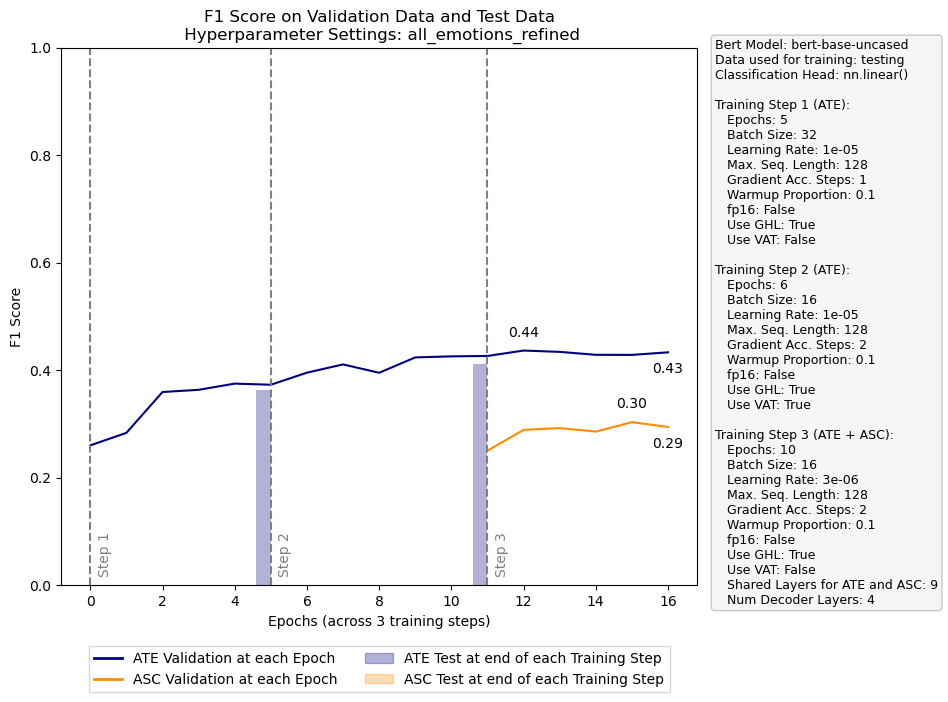

In [18]:
# Load the JSON data from the file
with open('GRACE/training_performance.json', 'r') as f:
    data = json.load(f)

name = 'all_emotions_refined'
data_to_plot = next((item for item in data if item['settings']['name'] == name), None)
metric = "f1_score"

create_performance_chart(data_to_plot, metric, name)
